In [1]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"   
os.environ["CUDA_VISIBLE_DEVICES"]="6"

import os
import torch
import torch.autograd as autograd
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as Data
torch.manual_seed(8)

import time
import numpy as np
import gc
import sys
sys.setrecursionlimit(50000)
import pickle
torch.backends.cudnn.benchmark = True
torch.set_default_tensor_type('torch.cuda.FloatTensor')
torch.nn.Module.dump_patches = True
import copy
import pandas as pd
from rdkit import Chem
from sklearn.metrics import r2_score, roc_auc_score, roc_curve, auc
from rdkit.Chem import rdMolDescriptors
from rdkit.Chem.Draw import SimilarityMaps
from rdkit import Chem
from rdkit.Chem import AllChem
from rdkit.Chem import rdDepictor, MolSurf
from rdkit.Chem.Draw import rdMolDraw2D, MolToFile, _moltoimg

#then import my own modules
from AttentiveFP import Fingerprint, Fingerprint_viz
from AttentiveFP.getFeatures import save_smiles_dicts, get_smiles_dicts, get_smiles_array, moltosvg_highlight

In [2]:
%matplotlib inline
from numpy.polynomial.polynomial import polyfit
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib
from IPython.display import SVG, display
import itertools
import random
import seaborn as sns; sns.set(color_codes=True)

number of all smiles:  2050
failed to process smiles:  O=N([O-])C1=C(CN=C1NCCSCc2ncccc2)Cc3ccccc3
failed to process smiles:  c1(nc(NC(N)=[NH2])sc1)CSCCNC(=[NH]C#N)NC
failed to process smiles:  Cc1nc(sc1)\[NH]=C(\N)N
failed to process smiles:  s1cc(CSCCN\C(NC)=[NH]\C#N)nc1\[NH]=C(\N)N
failed to process smiles:  c1c(c(ncc1)CSCCN\C(=[NH]\C#N)NCC)Br
failed to process smiles:  n1c(csc1\[NH]=C(\N)N)c1ccccc1
failed to process smiles:  n1c(csc1\[NH]=C(\N)N)c1cccc(c1)N
failed to process smiles:  n1c(csc1\[NH]=C(\N)N)c1cccc(c1)NC(C)=O
failed to process smiles:  n1c(csc1\[NH]=C(\N)N)c1cccc(c1)N\C(NC)=[NH]\C#N
failed to process smiles:  s1cc(nc1\[NH]=C(\N)N)C
failed to process smiles:  c1(cc(N\C(=[NH]\c2cccc(c2)CC)C)ccc1)CC
number of successfully processed smiles:  2039


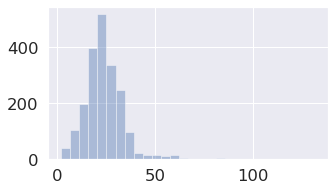

In [3]:
task_name = 'BBBP'
tasks = ['BBBP']
raw_filename = "../data/BBBP.csv"
feature_filename = raw_filename.replace('.csv','.pickle')
filename = raw_filename.replace('.csv','')
prefix_filename = raw_filename.split('/')[-1].replace('.csv','')
smiles_tasks_df = pd.read_csv(raw_filename)
smilesList = smiles_tasks_df.smiles.values
print("number of all smiles: ",len(smilesList))
atom_num_dist = []
remained_smiles = []
canonical_smiles_list = []
for smiles in smilesList:
    try:        
        mol = Chem.MolFromSmiles(smiles)
        atom_num_dist.append(len(mol.GetAtoms()))
        remained_smiles.append(smiles)
        canonical_smiles_list.append(Chem.MolToSmiles(Chem.MolFromSmiles(smiles), isomericSmiles=True))
    except:
        print("failed to process smiles: ", smiles)
        pass
print("number of successfully processed smiles: ", len(remained_smiles))
smiles_tasks_df = smiles_tasks_df[smiles_tasks_df["smiles"].isin(remained_smiles)]
# print(smiles_tasks_df)
smiles_tasks_df['cano_smiles'] =canonical_smiles_list
assert canonical_smiles_list[8]==Chem.MolToSmiles(Chem.MolFromSmiles(smiles_tasks_df['cano_smiles'][8]), isomericSmiles=True)

plt.figure(figsize=(5, 3))
sns.set(font_scale=1.5)
ax = sns.distplot(atom_num_dist, bins=28, kde=False)
plt.tight_layout()
# plt.savefig("atom_num_dist_"+prefix_filename+".png",dpi=200)
plt.show()
plt.close()

# print(len([i for i in atom_num_dist if i<51]),len([i for i in atom_num_dist if i>50]))

In [4]:
start_time = str(time.ctime()).replace(':','-').replace(' ','_')
start = time.time()

batch_size = 100
epochs = 800
p_dropout = 0.1
fingerprint_dim = 150

radius = 3
T = 2
weight_decay = 2.9 # also known as l2_regularization_lambda
learning_rate = 3.5
per_task_output_units_num = 2 # for classification model with 2 classes
output_units_num = len(tasks) * per_task_output_units_num

In [5]:
smilesList = [smiles for smiles in canonical_smiles_list if len(Chem.MolFromSmiles(smiles).GetAtoms())<101]
uncovered = [smiles for smiles in canonical_smiles_list if len(Chem.MolFromSmiles(smiles).GetAtoms())>100]

smiles_tasks_df = smiles_tasks_df[~smiles_tasks_df["cano_smiles"].isin(uncovered)]

if os.path.isfile(feature_filename):
    feature_dicts = pickle.load(open(feature_filename, "rb" ))
else:
    feature_dicts = save_smiles_dicts(smilesList,filename)
# feature_dicts = get_smiles_dicts(smilesList)

remained_df = smiles_tasks_df[smiles_tasks_df["cano_smiles"].isin(feature_dicts['smiles_to_atom_mask'].keys())]
uncovered_df = smiles_tasks_df.drop(remained_df.index)
remained_df = remained_df.reset_index(drop=True)
uncovered_df

,BBBP,smiles,cano_smiles
944,0,CC(C)C1OC(=O)C2=CCCN2C(=O)c3coc(CC(=O)CC(O)\C=...,C/C1=C/C(O)CC(=O)Cc2nc(co2)C(=O)N2CCC=C2C(=O)O...


In [6]:
remained_df[remained_df['cano_smiles'] == 'c1ccc2c(c1)Sc1ccccc1N2CC1CN2CCC1CC2']


,BBBP,smiles,cano_smiles
301,0,C1CN2CCC1C(C2)CN3c4ccccc4Sc5ccccc35,c1ccc2c(c1)Sc1ccccc1N2CC1CN2CCC1CC2
1342,1,C1=CC=CC2=C1SC5=C(N2CC3C4CCN(C3)CC4)C=CC=C5,c1ccc2c(c1)Sc1ccccc1N2CC1CN2CCC1CC2


In [7]:
from rdkit import Chem
from rdkit.Chem.Scaffolds import MurckoScaffold

class ScaffoldGenerator(object):
    """
    Generate molecular scaffolds.

    Parameters
    ----------
    include_chirality : : bool, optional (default False)
      Include chirality in scaffolds.
    """

    def __init__(self, include_chirality=False):
        self.include_chirality = include_chirality

    def get_scaffold(self, mol):
        """
        Get Murcko scaffolds for molecules.

        Murcko scaffolds are described in DOI: 10.1021/jm9602928. They are
        essentially that part of the molecule consisting of rings and the
        linker atoms between them.

        Parameters
        ----------
        mols : array_like
            Molecules.
        """
        return MurckoScaffold.MurckoScaffoldSmiles(mol=mol, includeChirality=self.include_chirality)


def generate_scaffold(smiles, include_chirality=False):
    mol = Chem.MolFromSmiles(smiles)
    engine = ScaffoldGenerator(include_chirality=include_chirality)
    scaffold = engine.get_scaffold(mol)
    return scaffold


In [8]:
weights = []
for i,task in enumerate(tasks):    
    negative_df = remained_df[remained_df[task] == 0][["smiles",task]]
    positive_df = remained_df[remained_df[task] == 1][["smiles",task]]
    weights.append([(positive_df.shape[0]+negative_df.shape[0])/negative_df.shape[0],\
                    (positive_df.shape[0]+negative_df.shape[0])/positive_df.shape[0]])
    
scaffold_list = []
all_scaffolds_dict = {}

for index, smiles in enumerate(remained_df['cano_smiles']):
    scaffold = generate_scaffold(smiles)
    scaffold_list.append(scaffold)
    if scaffold not in all_scaffolds_dict:
        all_scaffolds_dict[scaffold] = [index]
    else:
        all_scaffolds_dict[scaffold].append(index)
remained_df['scaffold'] = scaffold_list


In [9]:
scaffold_list = list(remained_df.groupby(['scaffold'])['scaffold'].count() \
                     .reset_index(name='count') \
                     .sort_values(['count'], ascending=False) \
                     .scaffold)

In [10]:
def scaffold_randomized_spliting(scaffolds_dict, sample_size, random_seed = 0): 
    count = 0
    minor_count = 0
    minor_class = np.argmax(weights[0]) # weights are inverse of the ratio
    minor_ratio= 1/weights[0][minor_class]
    optimal_count = 0.1*len(remained_df)
    while (count < optimal_count*0.95 or  count > optimal_count*1.05) \
        or (minor_count < minor_ratio*optimal_count*0.95 \
            or  minor_count > minor_ratio*optimal_count*1.05):
        random_seed +=1
        random.seed(random_seed)
        scaffold = random.sample(list(scaffolds_dict.keys()), sample_size)
        count = sum([len(scaffolds_dict[scaffold]) for scaffold in scaffold])
        index = [index for scaffold in scaffold for index in scaffolds_dict[scaffold]]
        minor_count = len(remained_df.iloc[index, :][remained_df[tasks[0]] == minor_class])
#     print(random)
    print(random_seed, count, minor_count, index)
    return scaffold, index

samples_size = int(len(all_scaffolds_dict.keys())*0.1)
print(samples_size)
test_scaffold, test_index = scaffold_randomized_spliting(all_scaffolds_dict, samples_size, random_seed=0)
training_scaffolds_dict = {x: all_scaffolds_dict[x] for x in all_scaffolds_dict.keys() if x not in test_scaffold}
valid_scaffold, valid_index = scaffold_randomized_spliting(training_scaffolds_dict, samples_size, random_seed=888)


102
76 206 47 [739, 923, 1921, 779, 301, 1342, 1805, 1877, 1886, 524, 69, 119, 365, 609, 646, 1074, 1075, 1122, 1481, 838, 1630, 376, 477, 543, 1462, 1627, 882, 974, 993, 362, 113, 1612, 1885, 640, 1647, 544, 665, 709, 1163, 1408, 1776, 1788, 355, 636, 1540, 1834, 1047, 76, 86, 335, 337, 614, 616, 1686, 7, 1293, 824, 1161, 1785, 1186, 1534, 769, 1441, 372, 1084, 1085, 1722, 1880, 635, 1067, 1782, 913, 27, 80, 285, 289, 1597, 1300, 1235, 1837, 810, 219, 531, 681, 1927, 141, 1181, 394, 1245, 1874, 1497, 1266, 121, 1439, 1394, 526, 696, 2010, 1327, 1137, 151, 1685, 1423, 1012, 1902, 14, 470, 578, 708, 851, 946, 967, 1049, 1155, 1274, 1370, 1606, 1693, 1697, 1703, 1708, 1725, 1741, 1857, 1887, 1917, 22, 660, 320, 1560, 1598, 1789, 990, 1867, 252, 1193, 1422, 1463, 1470, 1173, 1740, 817, 868, 869, 894, 1070, 879, 272, 925, 965, 996, 1323, 1792, 1799, 10, 66, 93, 264, 308, 387, 388, 1119, 1275, 948, 970, 1134, 1225, 1229, 1230, 1303, 1615, 1625, 1706, 1821, 1823, 1958, 2006, 2008, 755, 1747,

/data2/erikxiong/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  from ipykernel import kernelapp as app


1022 201 46 [208, 917, 1309, 799, 136, 556, 966, 1307, 1455, 1528, 1667, 1850, 1808, 871, 1192, 1451, 1431, 105, 155, 260, 323, 326, 374, 398, 411, 1106, 1226, 1227, 1278, 1279, 1280, 1281, 1335, 1506, 1604, 1605, 1664, 1669, 1846, 1847, 1848, 1561, 1945, 776, 425, 960, 1150, 1929, 2013, 79, 265, 563, 1645, 551, 1054, 1573, 1646, 566, 1875, 1562, 827, 689, 195, 239, 407, 634, 700, 940, 1092, 1271, 1675, 1705, 883, 1479, 1429, 1001, 88, 250, 243, 1925, 1267, 1607, 1913, 277, 45, 55, 166, 185, 186, 240, 442, 482, 483, 522, 628, 685, 686, 697, 1125, 1221, 1659, 1665, 1674, 1754, 1784, 1859, 1863, 1889, 1960, 2011, 673, 668, 1286, 1387, 202, 1156, 1503, 1802, 1024, 1025, 773, 1053, 1166, 998, 1318, 179, 324, 133, 1044, 1194, 1343, 1576, 1767, 1478, 161, 1835, 437, 626, 831, 1967, 1888, 1146, 1121, 1276, 211, 735, 792, 823, 352, 963, 181, 2025, 1613, 1265, 1590, 1998, 1389, 1915, 1260, 1391, 1732, 962, 1434, 1390, 725, 832, 881, 826, 1642, 729, 865, 364, 1464, 286, 1521, 602, 229, 1091, 119

In [11]:
test_df = remained_df.iloc[test_index,:] # test set
valid_df = remained_df.iloc[valid_index,:] # valid set
train_df = remained_df.drop(test_df.index).drop(valid_df.index) # train set
train_df = train_df.reset_index(drop=True)
valid_df = valid_df.reset_index(drop=True)
test_df = test_df.reset_index(drop=True)

In [12]:
x_atom, x_bonds, x_atom_index, x_bond_index, x_mask, smiles_to_rdkit_list = get_smiles_array([smilesList[0]],feature_dicts)
num_atom_features = x_atom.shape[-1]
num_bond_features = x_bonds.shape[-1]

loss_function = [nn.CrossEntropyLoss(torch.Tensor(weight),reduction='mean') for weight in weights]
model = Fingerprint(radius, T, num_atom_features,num_bond_features,
            fingerprint_dim, output_units_num, p_dropout)
model.cuda()
# tensorboard = SummaryWriter(log_dir="runs/"+start_time+"_"+prefix_filename+"_"+str(fingerprint_dim)+"_"+str(p_dropout))

# optimizer = optim.Adam(model.parameters(), learning_rate, weight_decay=weight_decay)
optimizer = optim.Adam(model.parameters(), 10**-learning_rate, weight_decay=10**-weight_decay)
model_parameters = filter(lambda p: p.requires_grad, model.parameters())
params = sum([np.prod(p.size()) for p in model_parameters])
print(params)
for name, param in model.named_parameters():
    if param.requires_grad:
        print(name, param.data.shape)
        

649206
atom_fc.weight torch.Size([150, 39])
atom_fc.bias torch.Size([150])
neighbor_fc.weight torch.Size([150, 49])
neighbor_fc.bias torch.Size([150])
GRUCell.0.weight_ih torch.Size([450, 150])
GRUCell.0.weight_hh torch.Size([450, 150])
GRUCell.0.bias_ih torch.Size([450])
GRUCell.0.bias_hh torch.Size([450])
GRUCell.1.weight_ih torch.Size([450, 150])
GRUCell.1.weight_hh torch.Size([450, 150])
GRUCell.1.bias_ih torch.Size([450])
GRUCell.1.bias_hh torch.Size([450])
GRUCell.2.weight_ih torch.Size([450, 150])
GRUCell.2.weight_hh torch.Size([450, 150])
GRUCell.2.bias_ih torch.Size([450])
GRUCell.2.bias_hh torch.Size([450])
align.0.weight torch.Size([1, 300])
align.0.bias torch.Size([1])
align.1.weight torch.Size([1, 300])
align.1.bias torch.Size([1])
align.2.weight torch.Size([1, 300])
align.2.bias torch.Size([1])
attend.0.weight torch.Size([150, 150])
attend.0.bias torch.Size([150])
attend.1.weight torch.Size([150, 150])
attend.1.bias torch.Size([150])
attend.2.weight torch.Size([150, 150])

In [13]:
def train(model, dataset, optimizer, loss_function):
    model.train()
    np.random.seed(epoch)
    valList = np.arange(0,dataset.shape[0])
    #shuffle them
    np.random.shuffle(valList)
    batch_list = []
    for i in range(0, dataset.shape[0], batch_size):
        batch = valList[i:i+batch_size]
        batch_list.append(batch)   
    for counter, train_batch in enumerate(batch_list):
        batch_df = dataset.loc[train_batch,:]
        smiles_list = batch_df.cano_smiles.values
        
        x_atom, x_bonds, x_atom_index, x_bond_index, x_mask, smiles_to_rdkit_list = get_smiles_array(smiles_list,feature_dicts)
        atoms_prediction, mol_prediction = model(torch.Tensor(x_atom),torch.Tensor(x_bonds),torch.cuda.LongTensor(x_atom_index),torch.cuda.LongTensor(x_bond_index),torch.Tensor(x_mask))
#         print(torch.Tensor(x_atom).size(),torch.Tensor(x_bonds).size(),torch.cuda.LongTensor(x_atom_index).size(),torch.cuda.LongTensor(x_bond_index).size(),torch.Tensor(x_mask).size())
        
        model.zero_grad()
        # Step 4. Compute your loss function. (Again, Torch wants the target wrapped in a variable)
        loss = 0.0
        for i,task in enumerate(tasks):
            y_pred = mol_prediction[:, i * per_task_output_units_num:(i + 1) *
                                    per_task_output_units_num]
            y_val = batch_df[task].values

            validInds = np.where((y_val==0) | (y_val==1))[0]
#             validInds = np.where(y_val != -1)[0]
            if len(validInds) == 0:
                continue
            y_val_adjust = np.array([y_val[v] for v in validInds]).astype(float)
            validInds = torch.cuda.LongTensor(validInds).squeeze()
            y_pred_adjust = torch.index_select(y_pred, 0, validInds)

            loss += loss_function[i](
                y_pred_adjust,
                torch.cuda.LongTensor(y_val_adjust))
        # Step 5. Do the backward pass and update the gradient
#             print(y_val,y_pred,validInds,y_val_adjust,y_pred_adjust)
        loss.backward()
        optimizer.step()
def eval(model, dataset):
    model.eval()
    y_val_list = {}
    y_pred_list = {}
    losses_list = []
    valList = np.arange(0,dataset.shape[0])
    batch_list = []
    for i in range(0, dataset.shape[0], batch_size):
        batch = valList[i:i+batch_size]
        batch_list.append(batch)   
    for counter, test_batch in enumerate(batch_list):
        batch_df = dataset.loc[test_batch,:]
        smiles_list = batch_df.cano_smiles.values
        
        x_atom, x_bonds, x_atom_index, x_bond_index, x_mask, smiles_to_rdkit_list = get_smiles_array(smiles_list,feature_dicts)
        atoms_prediction, mol_prediction = model(torch.Tensor(x_atom),torch.Tensor(x_bonds),torch.cuda.LongTensor(x_atom_index),torch.cuda.LongTensor(x_bond_index),torch.Tensor(x_mask))
        atom_pred = atoms_prediction.data[:,:,1].unsqueeze(2).cpu().numpy()
        for i,task in enumerate(tasks):
            y_pred = mol_prediction[:, i * per_task_output_units_num:(i + 1) *
                                    per_task_output_units_num]
            y_val = batch_df[task].values

            validInds = np.where((y_val==0) | (y_val==1))[0]
#             validInds = np.where((y_val=='0') | (y_val=='1'))[0]
#             print(validInds)
            if len(validInds) == 0:
                continue
            y_val_adjust = np.array([y_val[v] for v in validInds]).astype(float)
            validInds = torch.cuda.LongTensor(validInds).squeeze()
            y_pred_adjust = torch.index_select(y_pred, 0, validInds)
#             print(validInds)
            loss = loss_function[i](
                y_pred_adjust,
                torch.cuda.LongTensor(y_val_adjust))
#             print(y_pred_adjust)
            y_pred_adjust = F.softmax(y_pred_adjust,dim=-1).data.cpu().numpy()[:,1]
            losses_list.append(loss.cpu().detach().numpy())
            try:
                y_val_list[i].extend(y_val_adjust)
                y_pred_list[i].extend(y_pred_adjust)
            except:
                y_val_list[i] = []
                y_pred_list[i] = []
                y_val_list[i].extend(y_val_adjust)
                y_pred_list[i].extend(y_pred_adjust)
#             print(y_val,y_pred,validInds,y_val_adjust,y_pred_adjust)            
    test_roc = [roc_auc_score(y_val_list[i], y_pred_list[i]) for i in range(len(tasks))]
#     test_prc = [auc(precision_recall_curve(y_val_list[i], y_pred_list[i])[1],precision_recall_curve(y_val_list[i], y_pred_list[i])[0]) for i in range(len(tasks))]
# #     test_prc = auc(recall, precision)
#     test_precision = [precision_score(y_val_list[i],
#                                      (np.array(y_pred_list[i]) > 0.5).astype(int)) for i in range(len(tasks))]
#     test_recall = [recall_score(y_val_list[i],
#                                (np.array(y_pred_list[i]) > 0.5).astype(int)) for i in range(len(tasks))]
    test_loss = np.array(losses_list).mean()
    
    return test_roc, test_loss


In [14]:
best_param ={}
best_param["roc_epoch"] = 0
best_param["loss_epoch"] = 0
best_param["valid_roc"] = 0
best_param["valid_loss"] = 9e8

for epoch in range(epochs):    
    train_roc, train_loss = eval(model, train_df)
    valid_roc, valid_loss = eval(model, valid_df)
    train_roc_mean = np.array(train_roc).mean()
    valid_roc_mean = np.array(valid_roc).mean()
    
#     tensorboard.add_scalars('ROC',{'train_roc':train_roc_mean,'valid_roc':valid_roc_mean},epoch)
#     tensorboard.add_scalars('Losses',{'train_losses':train_loss,'valid_losses':valid_loss},epoch)

    if valid_roc_mean > best_param["valid_roc"]:
        best_param["roc_epoch"] = epoch
        best_param["valid_roc"] = valid_roc_mean
        if valid_roc_mean > 0.87:
             torch.save(model, 'saved_models/model_'+prefix_filename+'_'+start_time+'_'+str(epoch)+'.pt')             
    if valid_loss < best_param["valid_loss"]:
        best_param["loss_epoch"] = epoch
        best_param["valid_loss"] = valid_loss

    print("EPOCH:\t"+str(epoch)+'\n'\
        +"train_roc"+":"+str(train_roc)+'\n'\
        +"valid_roc"+":"+str(valid_roc)+'\n'\
#         +"train_roc_mean"+":"+str(train_roc_mean)+'\n'\
#         +"valid_roc_mean"+":"+str(valid_roc_mean)+'\n'\
        )
    if (epoch - best_param["roc_epoch"] >18) and (epoch - best_param["loss_epoch"] >28):        
        break
        
    train(model, train_df, optimizer, loss_function)


EPOCH:	0
train_roc:[0.6983215399225163]
valid_roc:[0.6854137447405331]

EPOCH:	1
train_roc:[0.7465134503710302]
valid_roc:[0.7391304347826086]

EPOCH:	2
train_roc:[0.7703383812493172]
valid_roc:[0.7537166900420758]

EPOCH:	3
train_roc:[0.7922892523089593]
valid_roc:[0.7823281907433379]

EPOCH:	4
train_roc:[0.7968735555873034]
valid_roc:[0.7914446002805049]

EPOCH:	5
train_roc:[0.8097650702142143]
valid_roc:[0.7768583450210378]

EPOCH:	6
train_roc:[0.8147905759162304]
valid_roc:[0.7879382889200561]

EPOCH:	7
train_roc:[0.8207657173111023]
valid_roc:[0.7907433380084151]

EPOCH:	8
train_roc:[0.8307200843747111]
valid_roc:[0.7813464235624124]

EPOCH:	9
train_roc:[0.8348968006521391]
valid_roc:[0.773352033660589]

EPOCH:	10
train_roc:[0.8365649660064037]
valid_roc:[0.7887798036465639]

EPOCH:	11
train_roc:[0.8466117754825914]
valid_roc:[0.7786816269284712]

EPOCH:	12
train_roc:[0.8501329910162783]
valid_roc:[0.7914446002805049]

EPOCH:	13
train_roc:[0.8540323800559697]
valid_roc:[0.80673211

EPOCH:	113
train_roc:[0.9264294958526973]
valid_roc:[0.870406732117812]

EPOCH:	114
train_roc:[0.9284842385686554]
valid_roc:[0.8729312762973351]

EPOCH:	115
train_roc:[0.9271438235862614]
valid_roc:[0.8775596072931277]

EPOCH:	116
train_roc:[0.9287405561671696]
valid_roc:[0.8834502103786817]

EPOCH:	117
train_roc:[0.9292300807610532]
valid_roc:[0.876577840112202]

EPOCH:	118
train_roc:[0.9303625003151446]
valid_roc:[0.8806451612903226]

EPOCH:	119
train_roc:[0.9301986251292093]
valid_roc:[0.8746143057503506]

EPOCH:	120
train_roc:[0.9309171547906179]
valid_roc:[0.8856942496493687]

EPOCH:	121
train_roc:[0.9316104728849597]
valid_roc:[0.8810659186535764]

EPOCH:	122
train_roc:[0.9316798046943937]
valid_roc:[0.8915848527349228]

EPOCH:	123
train_roc:[0.9322617717008563]
valid_roc:[0.8879382889200561]

EPOCH:	124
train_roc:[0.9308289143058835]
valid_roc:[0.8873772791023843]

EPOCH:	125
train_roc:[0.93154534300337]
valid_roc:[0.8747545582047687]

EPOCH:	126
train_roc:[0.9324508584538587]


EPOCH:	225
train_roc:[0.9571182758649669]
valid_roc:[0.9131837307152875]

EPOCH:	226
train_roc:[0.958698200734497]
valid_roc:[0.9155680224403927]

EPOCH:	227
train_roc:[0.9546223307253366]
valid_roc:[0.9115007012622721]

EPOCH:	228
train_roc:[0.9569796122460984]
valid_roc:[0.9109396914446003]

EPOCH:	229
train_roc:[0.9592255426789811]
valid_roc:[0.917531556802244]

EPOCH:	230
train_roc:[0.9585973544662291]
valid_roc:[0.9201963534361851]

EPOCH:	231
train_roc:[0.9553009420722227]
valid_roc:[0.9168302945301543]

EPOCH:	232
train_roc:[0.9565047943996706]
valid_roc:[0.9032258064516129]

EPOCH:	233
train_roc:[0.9587717344717758]
valid_roc:[0.9152875175315568]

EPOCH:	234
train_roc:[0.9582086761406133]
valid_roc:[0.9161290322580645]

EPOCH:	235
train_roc:[0.9590700713487348]
valid_roc:[0.9154277699859747]

EPOCH:	236
train_roc:[0.956618246451472]
valid_roc:[0.9218793828892005]

EPOCH:	237
train_roc:[0.9583767532543932]
valid_roc:[0.9112201963534363]

EPOCH:	238
train_roc:[0.9576414158816065]

In [19]:
# evaluate model
best_model = torch.load('saved_models/model_'+prefix_filename+'_'+start_time+'_'+str(best_param["roc_epoch"])+'.pt')     

best_model_dict = best_model.state_dict()
best_model_wts = copy.deepcopy(best_model_dict)

# model.load_state_dict(best_model_wts)
# (best_model.align[0].weight == model.align[0].weight).all()

test_roc, test_losses = eval(best_model, test_df)

print("best epoch:"+str(best_param["roc_epoch"])
      +"\n"+"test_roc:"+str(test_roc)
      +"\n"+"test_roc_mean:",str(np.array(test_roc).mean())
     )

best epoch:236
test_roc:[0.8416298675230831]
test_roc_mean: 0.8416298675230831


In [20]:
remained_df[remained_df['scaffold'] == scaffold_list[9]]['BBBP'].value_counts()

1    12
0     4
Name: BBBP, dtype: int64

In [16]:
# Feature visualization

model_for_viz = Fingerprint_viz(radius, T, num_atom_features, num_bond_features,
            fingerprint_dim, output_units_num, p_dropout)
model_for_viz.cuda()

model_for_viz.load_state_dict(best_model_wts)
(best_model.align[0].weight == model_for_viz.align[0].weight).all()


tensor(1, dtype=torch.uint8)

In [44]:
def min_max_norm(dataset):
    if isinstance(dataset, list):
        norm_list = list()
        min_value = min(dataset)
        max_value = max(dataset)

        for value in dataset:
            tmp = 1-(value - min_value) / (max_value - min_value)
            norm_list.append(tmp)
    return norm_list


In [47]:
top9_df = remained_df[remained_df['scaffold'] == scaffold_list[8]].reset_index()
list(remained_df[remained_df['scaffold'] == scaffold_list[8]]['cano_smiles'])[0] in list(train_df['cano_smiles'])

True

BBBP:1
prediction: [-0.4740054  0.2878019]
CC(C)NCC(O)COc1cccc2ccccc12.[Cl]


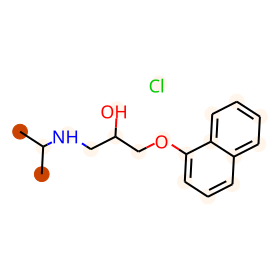

BBBP:1
prediction: [-1.556686   1.4224379]
CC(C)(C)OC(=O)CCCc1ccc(N(CCCl)CCCl)cc1


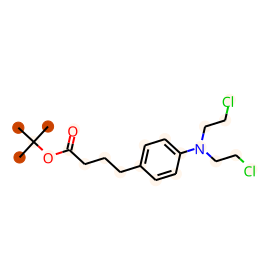

BBBP:1
prediction: [-0.06733445 -0.2844183 ]
CC1COc2c(N3CCN(C)CC3)c(F)cc3c(=O)c(C(=O)O)cn1c23


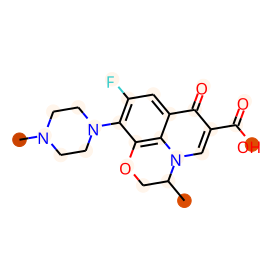

BBBP:1
prediction: [-1.8247463  1.7713941]
CC(=O)NCCCOc1cccc(CN2CCCCC2)c1


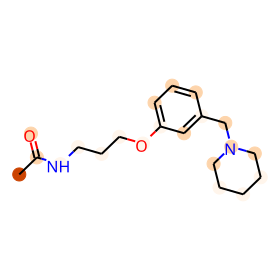

BBBP:1
prediction: [ 1.2687482 -1.8445296]
Cc1onc(-c2ccccc2Cl)c1C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12


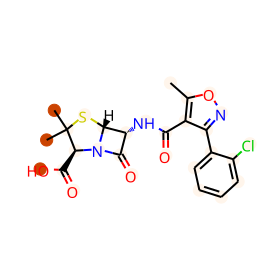

BBBP:1
prediction: [ 1.2516507 -1.8434713]
CCN1CCN(C(=O)N[C@@H](C(=O)N[C@@H]2C(=O)N3C(C(=O)O)=C(CSc4nnnn4C)CS[C@H]23)c2ccc(O)cc2)C(=O)C1=O


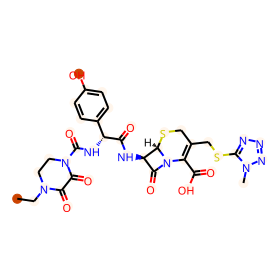

BBBP:1
prediction: [ 0.797248  -1.2944846]
CN(C)[C@@H]1C(=O)/C(=C(/O)NCN2CCCC2)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(O)cccc4[C@@](C)(O)[C@H]3C[C@@H]12


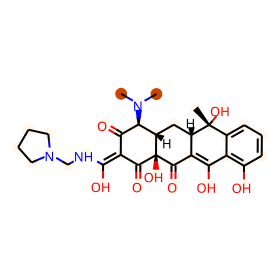

BBBP:1
prediction: [-1.2980884  1.0580764]
COc1ccc([C@@H]2Sc3ccccc3N(CCN(C)C)C(=O)[C@@H]2OC(C)=O)cc1


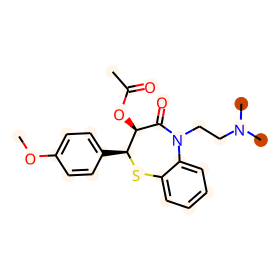

BBBP:1
prediction: [-0.4380682   0.30422604]
NC(N)=NC(=O)c1nc(Cl)c(N)nc1N


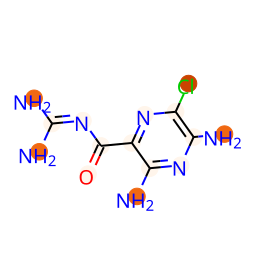

BBBP:1
prediction: [ 0.41351652 -0.69261277]
Cc1cn([C@H]2C[C@H](F)[C@@H](CO)O2)c(=O)[nH]c1=O


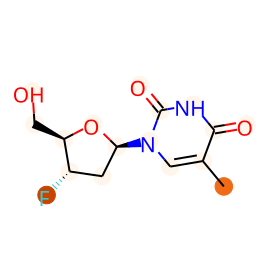

BBBP:1
prediction: [-1.3622227  1.3136945]
ClCCl


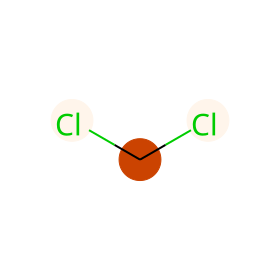

BBBP:1
prediction: [-0.9990068  0.5415026]
CC(C)(C)NC(=O)C1CC2CCCCC2CN1CC(O)C(Cc1ccccc1)NC(=O)C(CC(N)=O)NC(=O)c1ccc2ccccc2n1


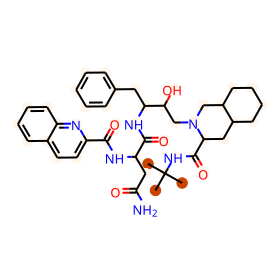

BBBP:1
prediction: [-2.3208492  2.1852803]
CCC(=O)N(c1ccccc1)C1(COC)CCN(CCn2nnn(CC)c2=O)CC1


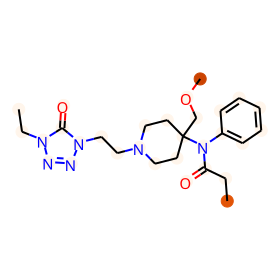

BBBP:1
prediction: [-1.5072452  1.3315245]
CN(C)C(=O)C(CCN1CCC(O)(c2ccc(Cl)cc2)CC1)(c1ccccc1)c1ccccc1


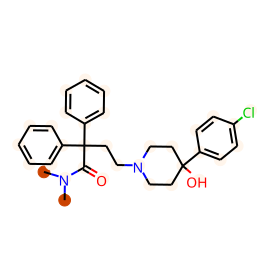

BBBP:1
prediction: [-0.88816476  0.7089603 ]
CN1C2CCC1CC(OC(=O)[C@H](CO)c1ccccc1)C2


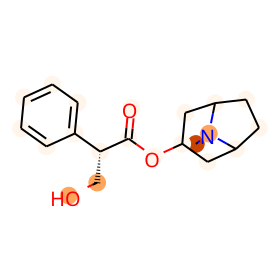

BBBP:1
prediction: [ 0.73770905 -1.0680487 ]
COc1ccc(Cl)cc1C(=O)NCCc1ccc(S(=O)(=O)NC(=O)NC2CCCCC2)cc1


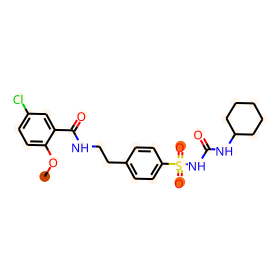

BBBP:1
prediction: [-0.93051535  0.8281789 ]
Nc1nnc(-c2cccc(Cl)c2Cl)c(N)n1


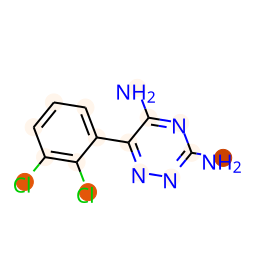

BBBP:1
prediction: [-1.4312433  1.3517647]
CCCC(C)C


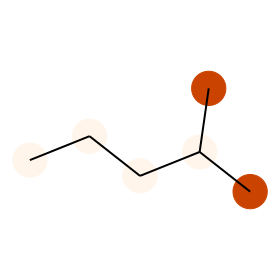

BBBP:1
prediction: [-1.3172431  1.2668339]
C[C@H](N)Cc1ccccc1


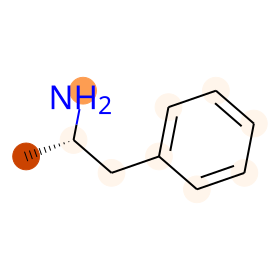

BBBP:0
prediction: [ 0.37926933 -0.57455343]
CCNC(=NC#N)NCCSCc1ncccc1Br


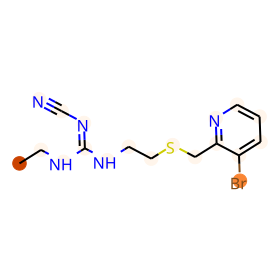

BBBP:1
prediction: [-2.2390513  2.1112964]
Cc1ccc(-c2nc3ccc(C)cn3c2CC(=O)N(C)C)cc1


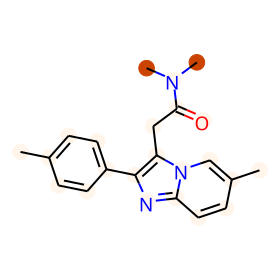

BBBP:1
prediction: [-2.4433289  2.3661082]
FC(F)(F)c1ccc(N2CCNCC2)nc1Cl


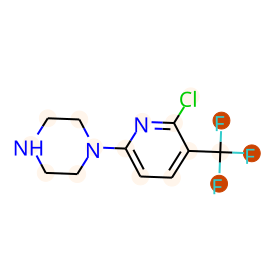

BBBP:1
prediction: [ 1.316293 -1.940006]
CCN1CCN(C(=O)N[C@@H](C(=O)N[C@@H]2C(=O)N3[C@@H](C(=O)O)C(C)(C)S[C@H]23)c2ccccc2)C(=O)C1=O.O


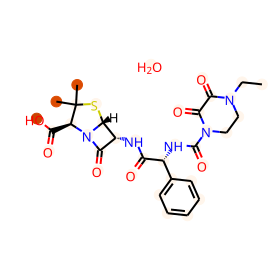

BBBP:1
prediction: [-1.3926605  1.261379 ]
CCCC(C)C1(CC)C(=O)NC(=O)NC1=O


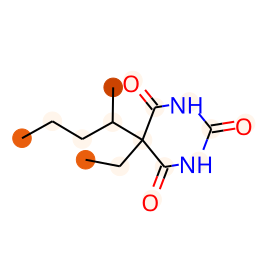

BBBP:1
prediction: [-0.02156371 -0.3341337 ]
C[C@H]1COc2c(N3CCN(C)CC3)c(F)cc3c(=O)c(C(=O)O)cn1c23


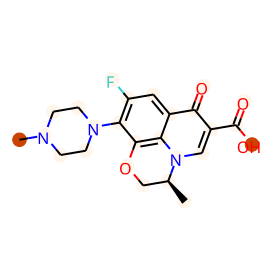

BBBP:1
prediction: [-1.9811305  1.9535365]
O=C(NCCCOc1cccc(CN2CCCCC2)c1)c1ccccc1


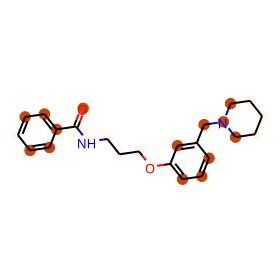

BBBP:1
prediction: [-3.0268257  2.9201224]
CN1Cc2c(C(=O)OC(C)(C)C)ncn2-c2ccsc2C1=O


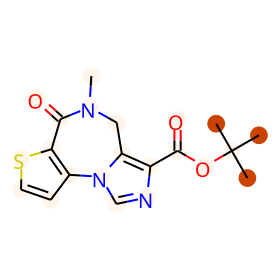

BBBP:1
prediction: [-2.2737794  2.248804 ]
CCC(=O)N(c1ccccc1)C1CCN(CCc2ccccc2)CC1


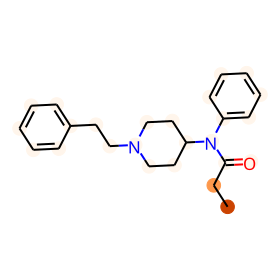

BBBP:1
prediction: [-1.353134  1.255692]
CCOC(=O)c1cncn1C(C)c1ccccc1


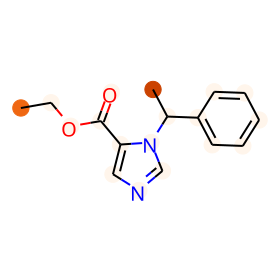

BBBP:0
prediction: [ 0.34613293 -0.5476356 ]
CN(C)c1cc(-c2nc(N)n[nH]2)ccn1


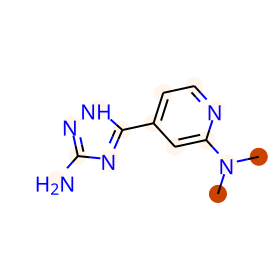

BBBP:1
prediction: [-3.3440242  3.3090806]
CN1CCN(CCCN2c3ccccc3Sc3ccc(Cl)cc32)CC1


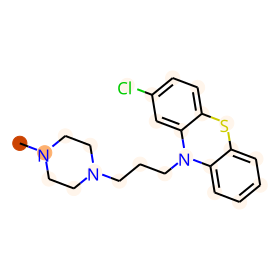

BBBP:1
prediction: [ 0.18318318 -0.37280682]
Nc1ccc(-c2nc3ccc(O)cc3s2)cc1I


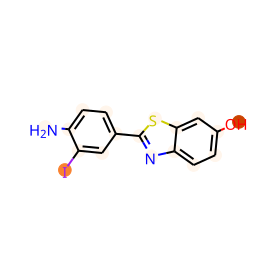

BBBP:0
prediction: [-0.16585968  0.00280434]
CC(=O)Nc1cccc(-c2csc(N=C(N)N)n2)c1


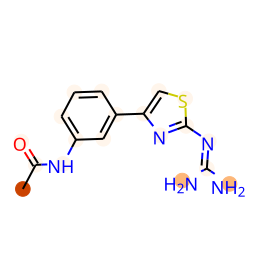

BBBP:1
prediction: [-2.960843   2.8691227]
CN1[C@H]2CCC[C@@H]1CC(NC(=O)c1nn(C)c3ccccc13)C2


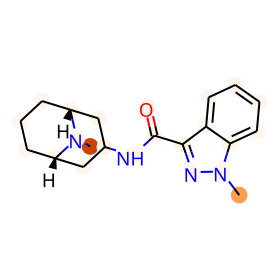

BBBP:1
prediction: [ 0.27162942 -0.58545315]
CS(=O)(=O)c1ccc([C@@H](O)[C@@H](CO)NC(=O)C(Cl)Cl)cc1


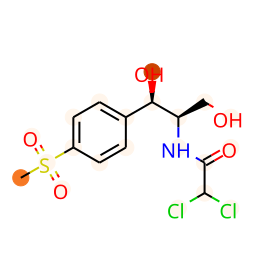

BBBP:1
prediction: [-0.40550458  0.30809912]
NC(N)=Nc1nc(-c2ccccc2)cs1


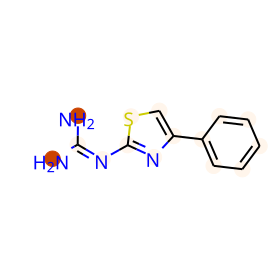

BBBP:1
prediction: [-1.963046   1.8810887]
Cc1cccc(C)c1OCC(C)N


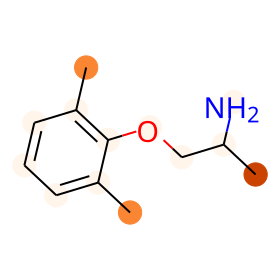

BBBP:1
prediction: [-1.3812444  1.1955818]
CCC(=O)O[C@](Cc1ccccc1)(c1ccccc1)[C@H](C)CN(C)C


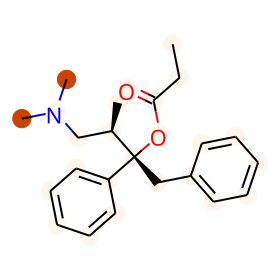

BBBP:1
prediction: [-1.6867467  1.5571723]
CN(C)Cc1ccc(-c2cccc(NC3N=CC=C3[N+](=O)[O-])c2)o1


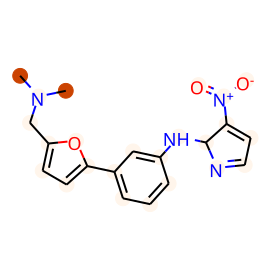

BBBP:1
prediction: [ 1.3596119 -2.0139709]
Cn1nnnc1SCC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)[C@H](O)c3ccccc3)[C@H]2SC1


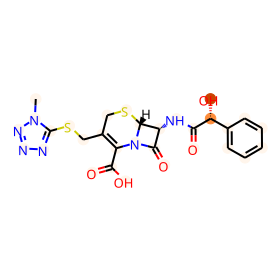

BBBP:1
prediction: [-1.7390083  1.7005937]
CN(C)CCc1ccccn1


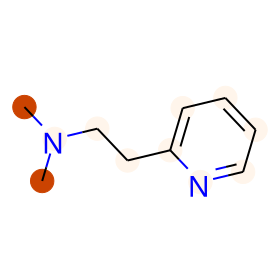

BBBP:1
prediction: [-2.1947005  2.0744832]
C=C[C@H]1CN2CC[C@H]1C[C@@H]2[C@@H](O)c1ccnc2ccc(OC)cc12


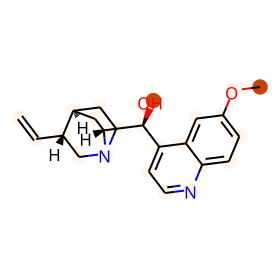

BBBP:1
prediction: [-1.5998652  1.5877942]
CCc1ccccc1


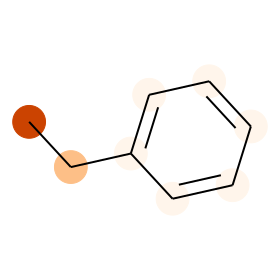

BBBP:1
prediction: [ 0.06285381 -0.20807493]
NC(N)=Nc1nc(-c2cccc(N)c2)cs1


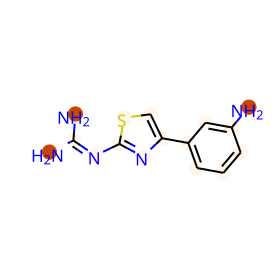

BBBP:1
prediction: [-2.3083897  1.7167304]
CC[C@]1(O)C[C@H]2CN(CCc3c([nH]c4ccccc34)[C@@](C(=O)OC)(c3cc4c(cc3OC)N(C)[C@H]3[C@@](O)(C(=O)OC)[C@H](OC(C)=O)[C@]5(CC)C=CCN6CC[C@]43[C@@H]65)C2)C1


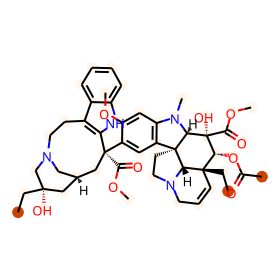

BBBP:1
prediction: [-0.00345742 -0.30364513]
CCCC(=O)Nc1ccc(OCC(O)CNC(C)C)c(C(C)=O)c1


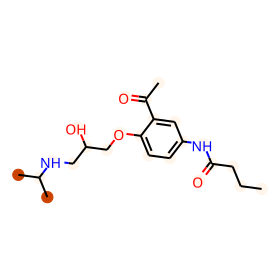

BBBP:1
prediction: [ 1.3119271 -1.6625819]
CN(C)Cc1ccc(CSCCNc2[nH]cc(Cc3ccccc3)c2[N+](=O)[O-])o1


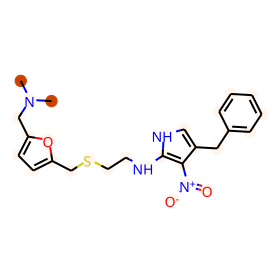

BBBP:0
prediction: [ 0.812459  -1.0505967]
CNC(=NC#N)Nc1cccc(-c2csc(N=C(N)N)n2)c1


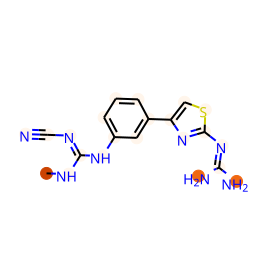

BBBP:1
prediction: [-1.3030425  1.2794163]
CNCCc1ccccn1


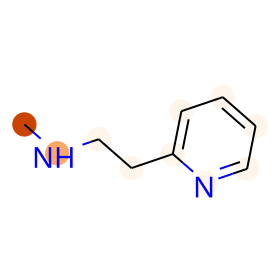

BBBP:1
prediction: [-2.4166226  2.3587322]
CN[C@H]1CC[C@@H](c2ccc(Cl)c(Cl)c2)c2ccccc21.[Cl-].[H+]


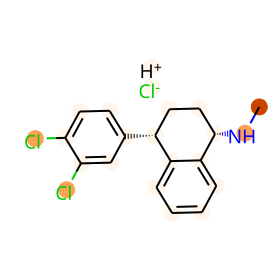

BBBP:1
prediction: [-2.43105    1.8635819]
CC[C@]1(O)C[C@H]2CN(CCc3c([nH]c4ccccc34)[C@@](C(=O)OC)(c3cc4c(cc3OC)N(C=O)[C@H]3[C@@](O)(C(=O)OC)[C@H](OC(C)=O)[C@]5(CC)C=CCN6CC[C@]43[C@@H]65)C2)C1


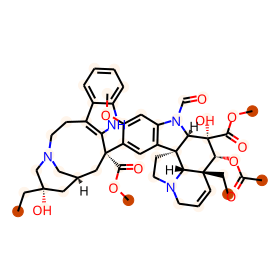

BBBP:1
prediction: [-2.4101646  2.3250372]
CCC(NC(=O)c1c(C)c(-c2ccccc2)nc2ccccc12)c1ccccc1


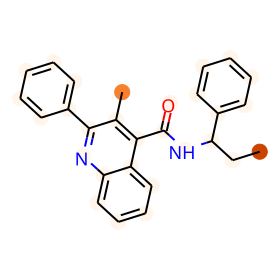

BBBP:1
prediction: [-1.8100337  1.6717086]
O=S(=O)(c1ccc2cc[nH]c2c1)N1CCCC1CCN1CCC(Oc2cccc(Cl)c2)CC1


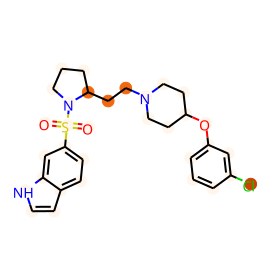

BBBP:1
prediction: [-1.7121254  1.5793128]
CN(C)Cc1ccnc(-c2cccc(NC3N=CC=C3[N+](=O)[O-])c2)c1


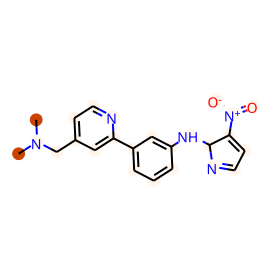

BBBP:1
prediction: [-2.8467474  2.8483522]
CNCCCC12CCC(c3ccccc31)c1ccccc12


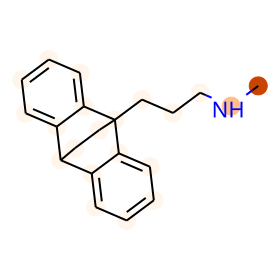

BBBP:1
prediction: [-1.2612988  1.2049987]
c1cc(CN2CCCCC2)cc(OCCCNc2nccs2)c1


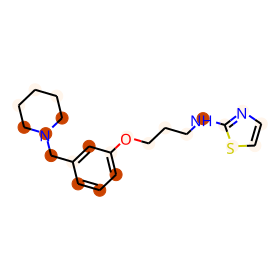

BBBP:1
prediction: [ 0.29294887 -0.6143023 ]
CO/N=C(\C(=O)N[C@H]1C(=O)N2C(C(=O)[O-])=C(COC(C)=O)CS[C@@H]12)c1csc(N)n1.[Na+]


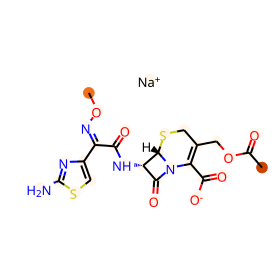

BBBP:1
prediction: [-2.8119683  2.8043952]
NC(=O)N1c2ccccc2C2OC2c2ccccc21


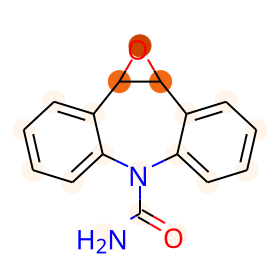

BBBP:1
prediction: [-0.24881677  0.12156069]
Cc1csc(N=C(N)N)n1


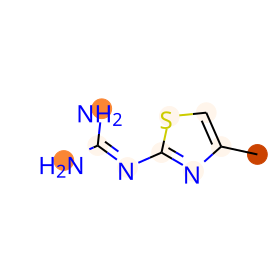

BBBP:1
prediction: [-1.0018206  0.867512 ]
CCCN(CCC)CCc1ccc(O)c2c1CC(=O)N2


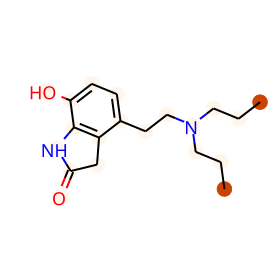

BBBP:1
prediction: [-2.777697   2.7268882]
CN1CC2c3ccccc3Oc3ccc(Cl)cc3C2C1


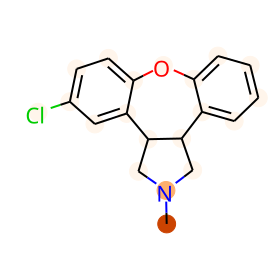

BBBP:0
prediction: [-0.513346   0.3147752]
CN(C)Cc1ccc(CSCCNC2N=CC=C2[N+](=O)[O-])o1


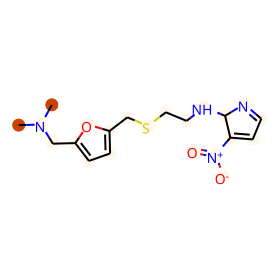

BBBP:1
prediction: [ 1.1160328 -1.5275083]
CO/N=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(COC(N)=O)CS[C@H]12)c1ccco1


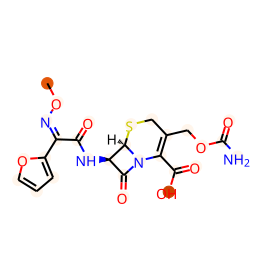

BBBP:1
prediction: [-1.4635736  1.3981634]
c1cc(CN2CCCCC2)cc(OCCCNc2nc3ccccc3o2)c1


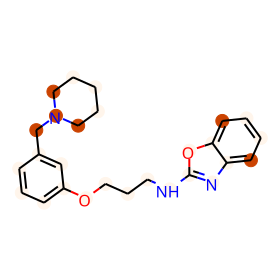

BBBP:1
prediction: [-0.54614437  0.43131495]
O=[N+]([O-])C1=CC=NC1NCCSCc1ccccn1


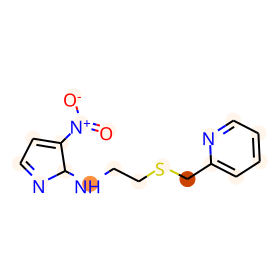

BBBP:1
prediction: [-0.8570943   0.74515045]
CCCSc1ccc2[nH]c(NC(=O)OC)nc2c1


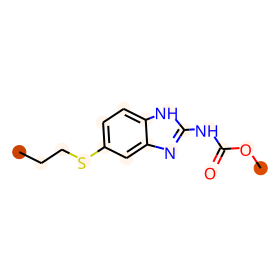

BBBP:1
prediction: [-2.049639   1.9919505]
CCCN(CCC)CCc1cccc2c1CC(=O)N2


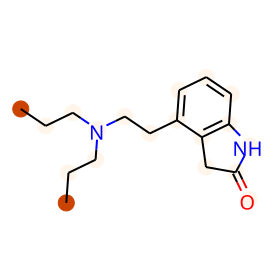

BBBP:1
prediction: [-2.477315   2.4685397]
Clc1ccc2c(c1)C1CNCC1c1ccccc1O2


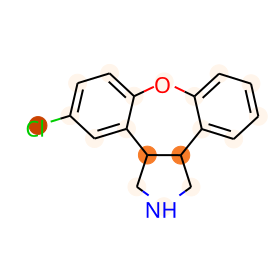

BBBP:1
prediction: [-2.6437654  2.6006577]
CN(C)CCC=C1c2ccccc2CCc2ccccc21


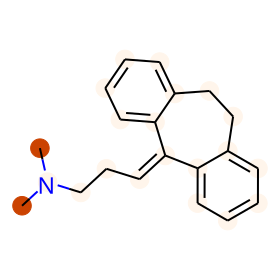

BBBP:1
prediction: [ 1.4340621 -2.0141764]
CO/N=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(CSc3nc(=O)c(=O)[nH]n3C)CS[C@H]12)c1csc(N)n1


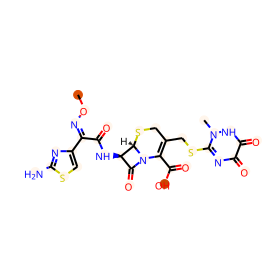

BBBP:1
prediction: [-1.2652918  1.2120924]
c1ccc(NCCCOc2cccc(CN3CCCCC3)c2)nc1


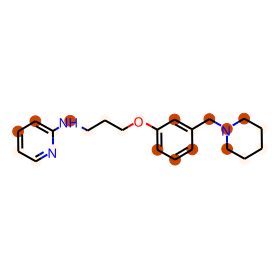

BBBP:1
prediction: [-0.96534336  0.85660565]
O=[N+]([O-])C1=CC=NC1NCCSCc1ncccc1Br


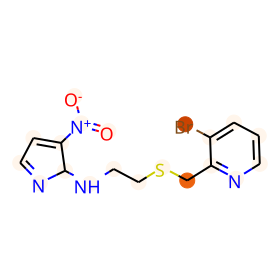

BBBP:1
prediction: [-1.1451471  1.0889192]
OCCCOc1cccc(CN2CCCCC2)c1


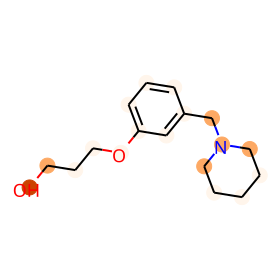

BBBP:1
prediction: [-1.8423041  1.8171791]
Cc1ncsc1CCCl


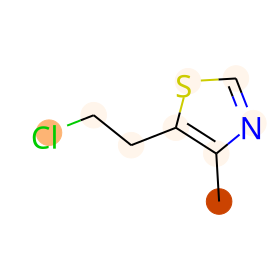

BBBP:1
prediction: [-0.03279257 -0.33650595]
CCN(CC)C(=O)Nc1ccc(OCC(O)CNC(C)(C)C)c(C(C)=O)c1


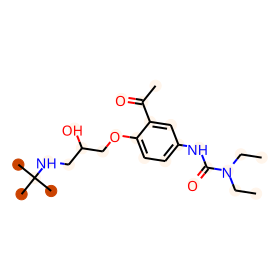

BBBP:1
prediction: [-2.4279368  2.3719962]
FC(F)(F)CCl


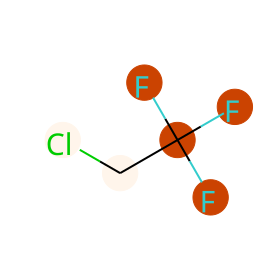

BBBP:1
prediction: [-1.2987562  1.2304711]
C=CCC(N)c1ccccc1-c1noc2ccccc12


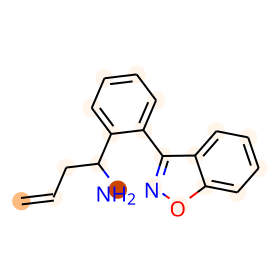

BBBP:1
prediction: [-3.0974636  2.9760983]
Cc1nc2n(c(=O)c1CCN1CCC(c3noc4cc(F)ccc34)CC1)CCCC2O


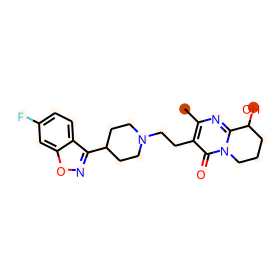

BBBP:1
prediction: [-0.39850882  0.2871987 ]
CC(=O)Nc1ccc(O)cc1


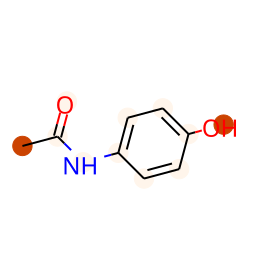

BBBP:0
prediction: [ 0.2790028  -0.48900044]
CC(=O)Oc1ccccc1C(=O)O


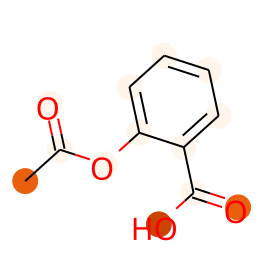

BBBP:0
prediction: [ 0.29166394 -0.4245683 ]
O=c1ncnc2[nH][nH]cc1-2


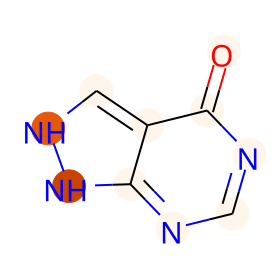

BBBP:0
prediction: [ 0.8237668 -1.1809759]
CCCCC[C@H](O)/C=C/[C@H]1[C@H](O)CC(=O)[C@@H]1CCCCCCC(=O)O


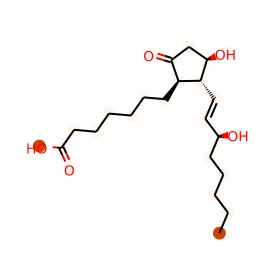

BBBP:0
prediction: [ 0.7053695 -1.0920858]
Cn1c(=O)c2[nH]cnc2n(C)c1=O.Cn1c(=O)c2[nH]cnc2n(C)c1=O.NCCN


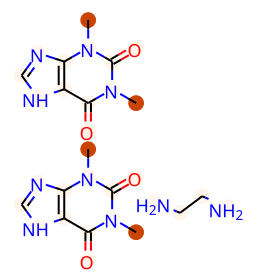

BBBP:0
prediction: [ 0.9023125 -1.2713693]
CCCCc1oc2ccccc2c1C(=O)c1cc(I)c(OCCN(CC)CC)c(I)c1


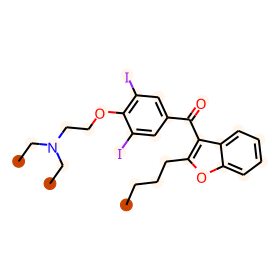

BBBP:0
prediction: [ 1.7396783 -2.4652102]
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](N)c3ccc(O)cc3)C(=O)N2[C@H]1C(=O)O.O.O.O


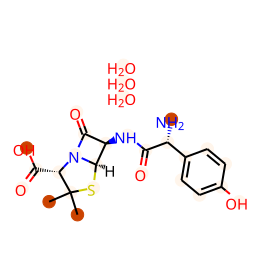

BBBP:0
prediction: [ 1.6110073 -2.286063 ]
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](N)c3ccccc3)C(=O)N2[C@H]1C(=O)O


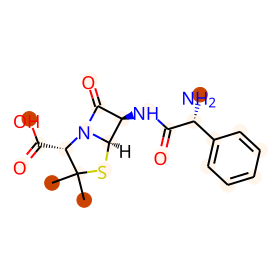

BBBP:1
prediction: [-0.45508486 -0.07391606]
FC(F)(F)c1ccc2c(c1)N(CCCN1CCN(CCC3OCCCO3)CC1)c1ccccc1S2.O=C(O)CCC(=O)O


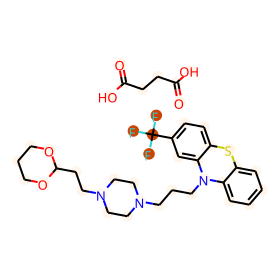

BBBP:1
prediction: [-2.102108  2.062149]
O=C1Nc2ccc(Cl)cc2C(c2ccccc2)=NC1O


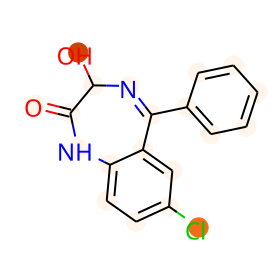

BBBP:1
prediction: [-1.4151286  1.3396821]
O=c1[nH]c2ccccc2n1C1CCN(CCOc2ccccc2)CC1


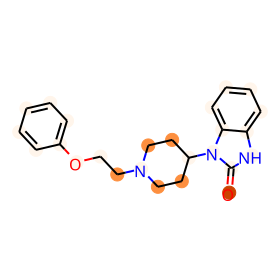

BBBP:1
prediction: [-3.1039863  3.001921 ]
COc1ccc2c3c1O[C@H]1C(=O)CC[C@@]4(O)[C@@H](C2)N(C)CC[C@]314


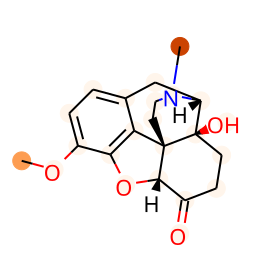

BBBP:1
prediction: [-2.036552   1.9076248]
CN1CC[C@]23c4c5ccc(O)c4O[C@H]2C(=O)CC[C@@]3(O)[C@H]1C5


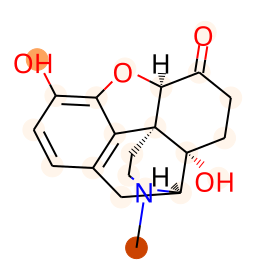

BBBP:1
prediction: [-2.9503253  2.9274309]
CN1CCCC(CN2c3ccccc3Sc3ccccc32)C1


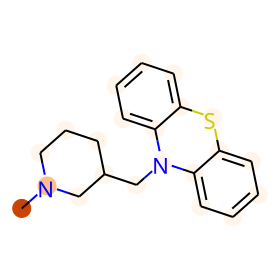

BBBP:1
prediction: [-1.6924669  1.6736643]
NC1=NC(=O)C(c2ccccc2)O1


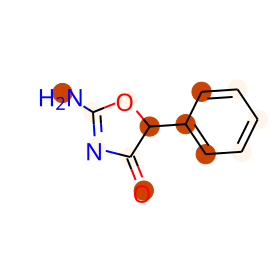

BBBP:1
prediction: [-1.6974999  1.669162 ]
CCc1cc(C(N)=S)ccn1


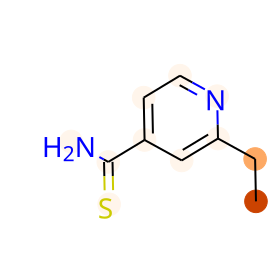

BBBP:0
prediction: [ 1.4278861 -2.1605587]
COc1cc([C@@H]2c3cc4c(cc3[C@@H](O[C@@H]3O[C@@H]5CO[C@@H](C)O[C@H]5[C@H](O)[C@H]3O)C3COC(=O)[C@@H]32)OCO4)cc(OC)c1O


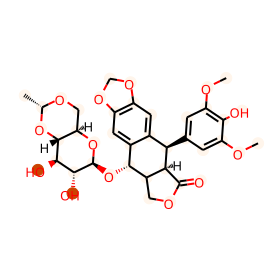

BBBP:1
prediction: [ 1.1019443 -1.5353882]
NC(N)=Nc1nc(CSCCC(N)=NS(N)(=O)=O)cs1


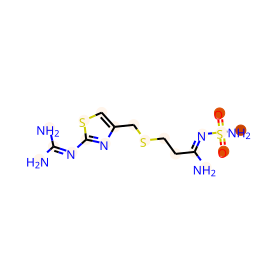

BBBP:1
prediction: [ 0.80481493 -1.0724726 ]
OC(Cn1cncn1)(Cn1cncn1)c1ccc(F)cc1F


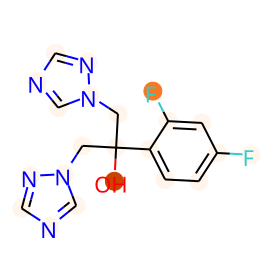

BBBP:1
prediction: [-2.1036775  2.0626543]
O=C([O-])P(=O)([O-])[O-].[Na+].[Na+].[Na+]


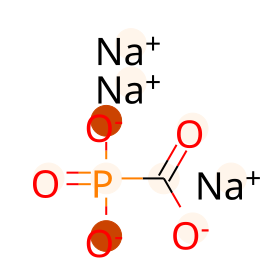

BBBP:0
prediction: [ 1.2882552 -1.7208132]
CCOc1ccc2ccccc2c1C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)[O-])C(C)(C)S[C@H]12.[Na+]


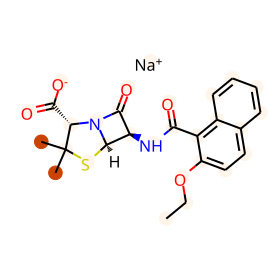

BBBP:0
prediction: [ 0.91604626 -1.4400826 ]
Cc1c(O)cccc1C(=O)N[C@@H](CSc1ccccc1)[C@H](O)CN1C[C@H]2CCCC[C@H]2C[C@H]1C(=O)NC(C)(C)C


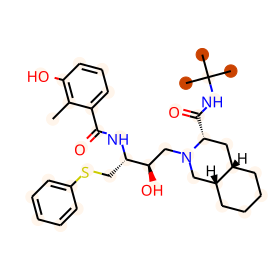

BBBP:0
prediction: [-1.2781866  1.1046529]
COc1ccc(CCN2CCC(Nc3nc4ccccc4n3Cc3ccc(F)cc3)CC2)cc1


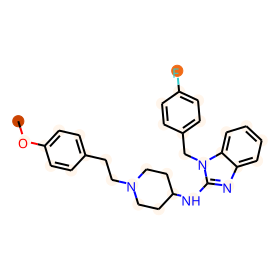

BBBP:0
prediction: [-0.37882635  0.152713  ]
CN1C2CCC1CC(OC(=O)C(CO)c1ccccc1)C2


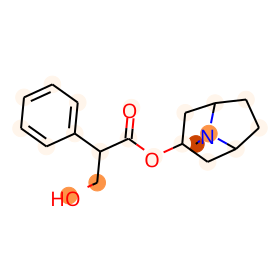

BBBP:0
prediction: [ 1.074636 -1.581423]
CN(C)[C@@H]1C(=O)/C(=C(\N)O)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(O)ccc(Cl)c4[C@@](C)(O)[C@H]3C[C@@H]12.[Cl-].[H+]


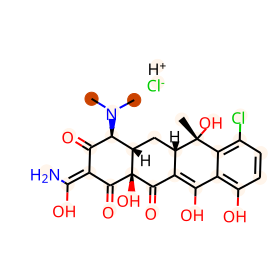

BBBP:0
prediction: [-0.5108353   0.10388453]
C[C@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)CO


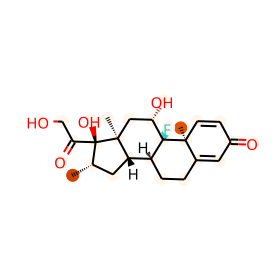

BBBP:0
prediction: [ 1.3924795 -2.1292198]
CC1(C)S[C@@H]2[C@H](NC(=O)C(C(=O)O)c3ccccc3)C(=O)N2[C@H]1C(=O)O


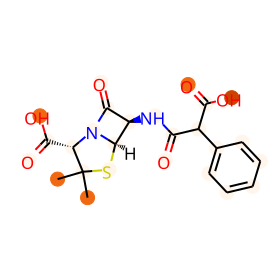

BBBP:0
prediction: [ 1.1585312 -1.6223078]
C[C@@](Cc1ccc(O)c(O)c1)(NN)C(=O)O


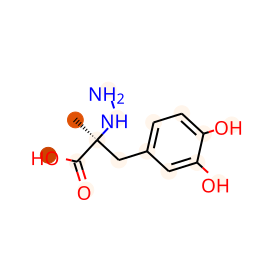

BBBP:0
prediction: [-0.21705595 -0.0188843 ]
CC(C)(C)NCC(O)COc1cccc2c1CCC(=O)N2


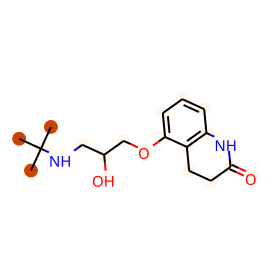

BBBP:0
prediction: [ 1.5168716 -1.9336174]
Cc1nnc(SCC2=C(C(=O)[O-])N3C(=O)[C@@H](NC(=O)Cn4cnnn4)[C@H]3SC2)s1.[Na+]


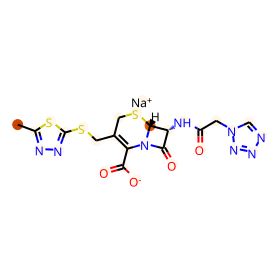

BBBP:0
prediction: [ 1.3543333 -1.7876778]
CC(=O)OCC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)CSc3ccncc3)[C@H]2SC1


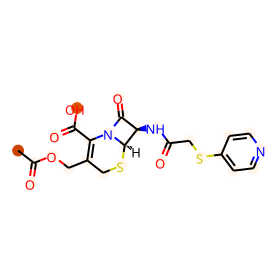

BBBP:0
prediction: [ 0.32136253 -0.5307759 ]
O=C(O)CCCc1ccc(N(CCCl)CCCl)cc1


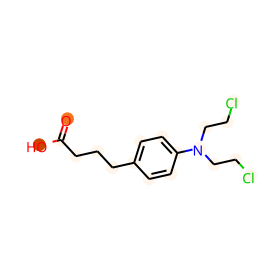

BBBP:1
prediction: [-3.0487733  3.0602481]
CN1CCN(C2=Nc3ccccc3Cc3ccccc32)CC1


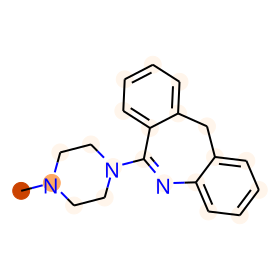

BBBP:1
prediction: [-2.927711   2.8963444]
OCCN1CCN(CCCN2c3ccccc3Sc3ccc(Cl)cc32)CC1


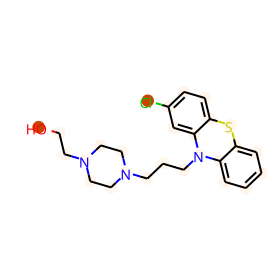

BBBP:1
prediction: [-2.2016268  2.1956751]
c1ccc(C2(N3CCCCC3)CCCCC2)cc1


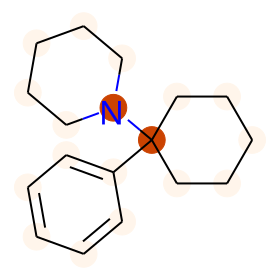

BBBP:1
prediction: [ 0.19803031 -0.42692402]
NNCCc1ccccc1.O=S(=O)(O)O


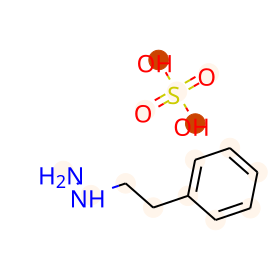

BBBP:1
prediction: [-1.4946004  1.4329178]
CCC1(c2ccccc2)C(=O)NC(=O)NC1=O


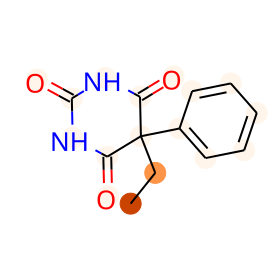

BBBP:1
prediction: [-1.5595189  1.5600688]
NC(=O)OCCCc1ccccc1


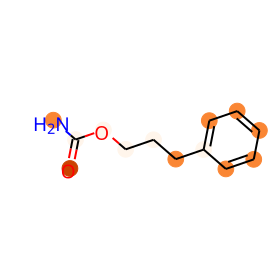

BBBP:0
prediction: [ 0.75233763 -1.1069698 ]
NCC(O)c1ccc(O)c(O)c1


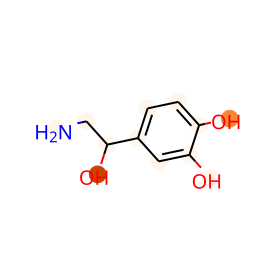

BBBP:0
prediction: [ 0.46927178 -0.8258555 ]
COc1ccc2nc(S(=O)Cc3ncc(C)c(OC)c3C)[nH]c2c1


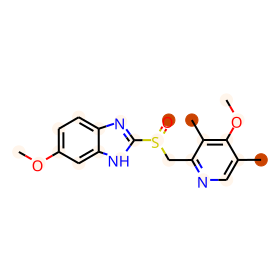

BBBP:0
prediction: [ 1.3101294 -1.8631601]
Cc1onc(-c2ccccc2)c1C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12


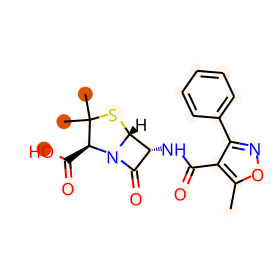

BBBP:0
prediction: [ 1.2026912 -1.5675409]
CC1(C)S[C@@H]2[C@H](NC(=O)COc3ccccc3)C(=O)N2[C@H]1C(=O)[O-]


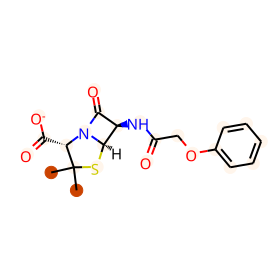

BBBP:0
prediction: [ 0.36175114 -0.6495811 ]
O=C(NC(CO)C(O)c1ccc([N+](=O)[O-])cc1)C(Cl)Cl


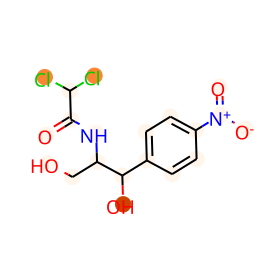

BBBP:0
prediction: [ 0.53696203 -0.78012836]
NS(=O)(=O)c1cc2c(cc1Cl)NC=NS2(=O)=O


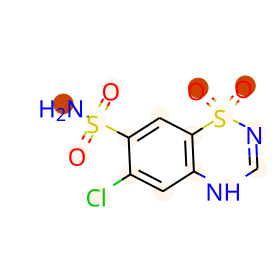

BBBP:0
prediction: [ 0.05335425 -0.23457506]
CCCNC(=O)NS(=O)(=O)c1ccc(Cl)cc1


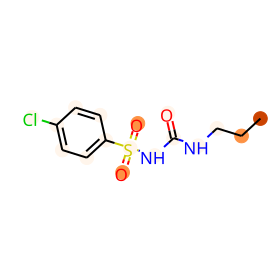

BBBP:0
prediction: [ 1.0471722 -1.5383418]
CN(C)[C@@H]1C(=O)/C(=C(\N)O)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(O)ccc(Cl)c4[C@@](C)(O)[C@H]3C[C@@H]12


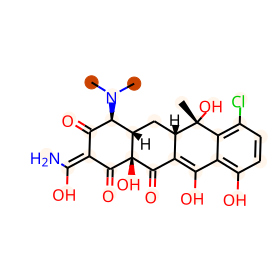

BBBP:0
prediction: [-1.8346481  1.7471389]
CCOC(=O)C(C)(C)Oc1ccc(Cl)cc1


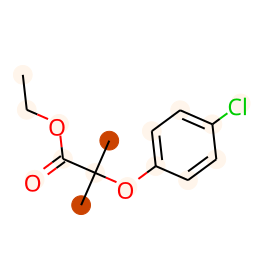

BBBP:0
prediction: [-0.03704968 -0.14993507]
CC(C)(Oc1ccc(Cl)cc1)C(=O)O


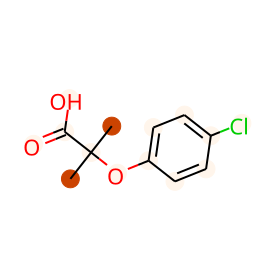

BBBP:0
prediction: [ 0.29424804 -0.4484348 ]
Clc1ccccc1C(c1ccccc1)(c1ccccc1)n1ccnc1


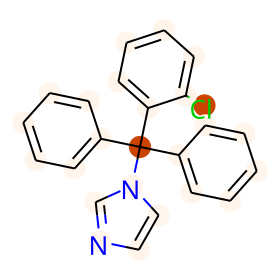

BBBP:0
prediction: [-0.74510837  0.46225408]
C[C@]12CC(=O)[C@H]3[C@@H](CCC4=CC(=O)CC[C@@]43C)[C@@H]1CC[C@]2(O)C(=O)CO


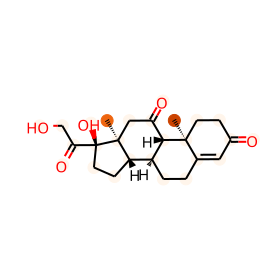

BBBP:1
prediction: [-3.7726784  3.624449 ]
OCCC1CCN(CC/C=C2\c3ccc(F)cc3Sc3ccc(C(F)(F)F)cc32)CC1


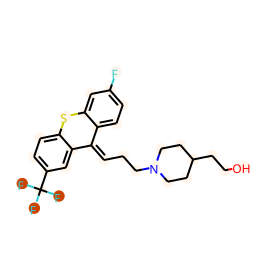

BBBP:1
prediction: [-2.684317   2.6438847]
OCCN1CCN(CC/C=C2/c3ccccc3COc3ccc(Cl)cc32)CC1


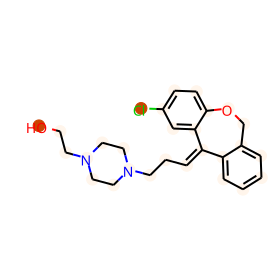

BBBP:1
prediction: [-2.6589458  2.5983503]
NC(=O)C1(N2CCCCC2)CCN(CCCC(=O)c2ccc(F)cc2)CC1


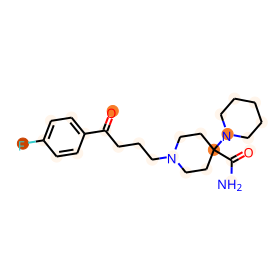

BBBP:1
prediction: [-0.62776667  0.366897  ]
CC(=O)[C@H]1CC[C@H]2[C@@H]3CC[C@@H]4C[C@H](O)CC[C@]4(C)[C@H]3CC[C@]12C


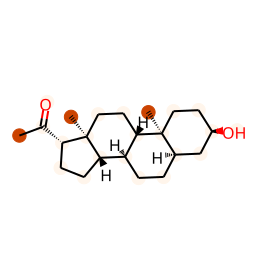

BBBP:1
prediction: [-1.6917472  1.6568542]
CCC1(c2ccccc2)C(=O)NCNC1=O


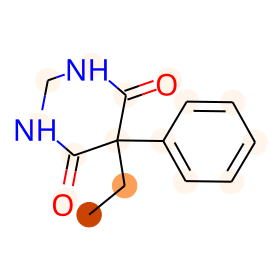

BBBP:1
prediction: [-1.5488471  1.4693804]
CCN(CC)CCOC(=O)c1ccc(N)cc1


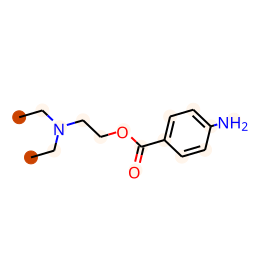

BBBP:1
prediction: [-1.5122627  1.4394419]
OC(CCN1CCCC1)(c1ccccc1)C1CCCCC1


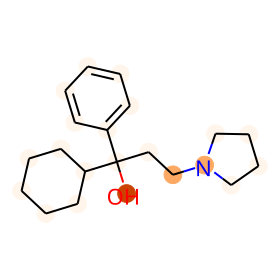

BBBP:1
prediction: [-0.3287474   0.14513731]
CC(C)NCC(O)COc1cccc2[nH]ccc12


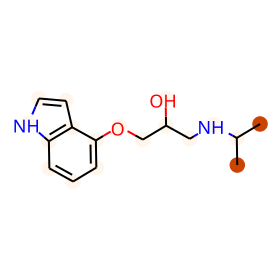

BBBP:1
prediction: [ 0.28394988 -1.5335541 ]
CO[C@H](C(=O)[C@@H](O)[C@@H](C)O)[C@@H]1Cc2cc3cc(O[C@H]4C[C@@H](O[C@H]5C[C@@H](O)[C@H](O)[C@@H](C)O5)[C@H](O)[C@@H](C)O4)c(C)c(O)c3c(O)c2C(=O)[C@H]1O[C@H]1C[C@@H](O[C@H]2C[C@@H](O[C@H]3C[C@](C)(O)[C@H](O)[C@@H](C)O3)[C@H](O)[C@@H](C)O2)[C@H](O)[C@@H](C)O1


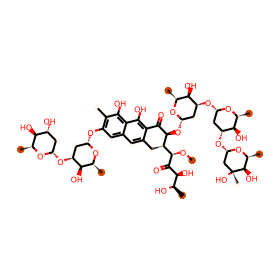

BBBP:0
prediction: [ 1.8866543 -2.6392043]
CC[C@H](C)C(=O)O[C@H]1C[C@H](O)C=C2C=C[C@H](C)[C@H](CC[C@@H](O)C[C@@H](O)CC(=O)O)[C@H]21


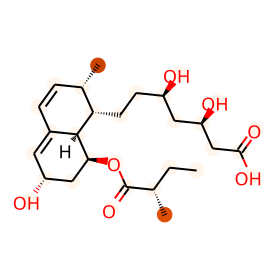

BBBP:1
prediction: [-1.6545938  1.6054583]
O=C(C1CCCCC1)N1CC(=O)N2CCc3ccccc3C2C1


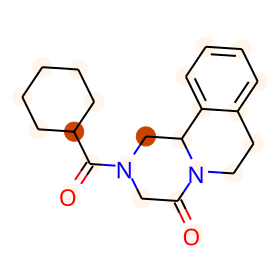

BBBP:1
prediction: [ 0.5670868 -0.8232461]
COc1cc(Cc2cnc(N)nc2N)cc(OC)c1OC


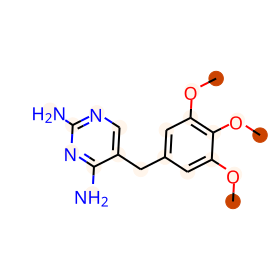

BBBP:0
prediction: [-0.02087537 -0.26402274]
COc1cc(NCc2ccc3nc(N)nc(N)c3c2C)cc(OC)c1OC


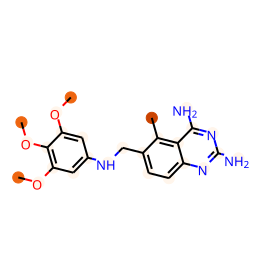

BBBP:0
prediction: [ 0.44776025 -0.6530712 ]
NC(CO)(CO)CO


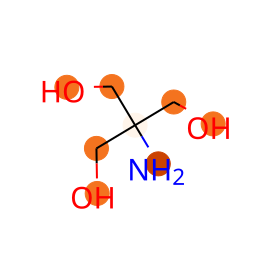

BBBP:1
prediction: [ 0.6338892 -1.1261854]
NC1[C@@H]2CN(c3nc4c(cc3F)c(=O)c(C(=O)O)cn4-c3ccc(F)cc3F)C[C@H]12


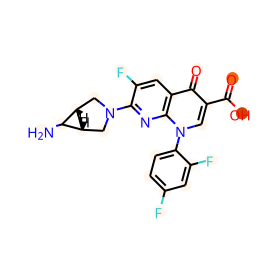

BBBP:1
prediction: [-0.845111    0.77945983]
NC(N)=O


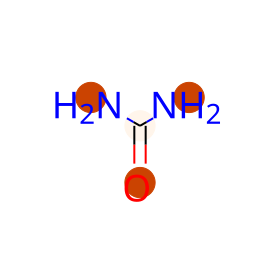

BBBP:0
prediction: [-1.3125142  1.2911495]
O=c1ccc2ccccc2o1


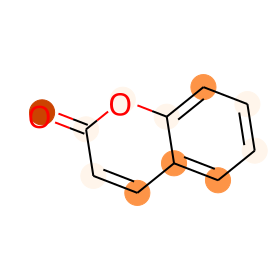

BBBP:0
prediction: [-0.00983427 -0.1350205 ]
Nc1ccc(S(=O)(=O)c2ccc(N)cc2)cc1


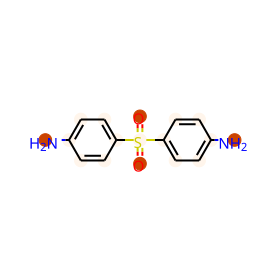

BBBP:0
prediction: [ 1.0090115 -1.511874 ]
C[C@H](CCC(=O)O)[C@H]1CC[C@H]2[C@@H]3C(=O)C[C@@H]4CC(=O)CC[C@]4(C)[C@H]3CC(=O)[C@@]21C


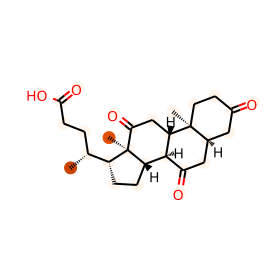

BBBP:0
prediction: [-2.0617542  1.9640002]
CCN(CC)CCOC(=O)C1(C2CCCCC2)CCCCC1


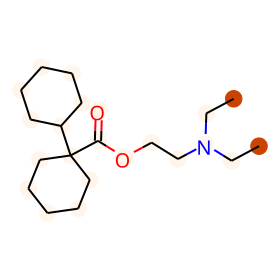

BBBP:0
prediction: [ 0.41842985 -1.2864373 ]
C[C@H]1O[C@@H](O[C@H]2[C@@H](O)C[C@H](O[C@H]3[C@@H](O)C[C@H](O[C@H]4CC[C@]5(C)[C@H]6CC[C@]7(C)[C@H](C8=CC(=O)OC8)CC[C@]7(O)[C@@H]6CC[C@@H]5C4)O[C@@H]3C)O[C@@H]2C)C[C@H](O)[C@@H]1O


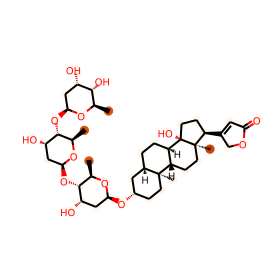

BBBP:0
prediction: [ 0.99589574 -1.9112587 ]
C[C@H]1O[C@@H](O[C@H]2[C@@H](O)C[C@H](O[C@H]3[C@@H](O)C[C@H](O[C@H]4CC[C@]5(C)[C@H]6C[C@@H](O)[C@]7(C)[C@@H](C8=CC(=O)OC8)CC[C@]7(O)[C@@H]6CC[C@@H]5C4)O[C@@H]3C)O[C@@H]2C)C[C@H](O)[C@@H]1O


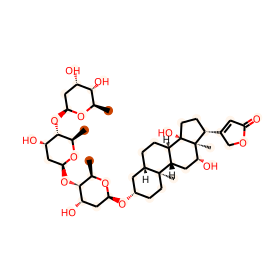

BBBP:0
prediction: [-0.6815948  0.4734712]
O=c1[nH]c2ccccc2n1CCCN1CCC(n2c(=O)[nH]c3cc(Cl)ccc32)CC1


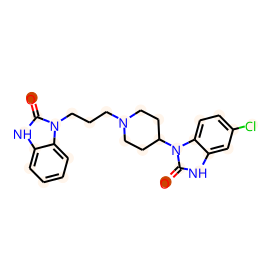

BBBP:1
prediction: [-0.73430336  0.5516548 ]
CC(C)c1cccc(C(C)C)c1O


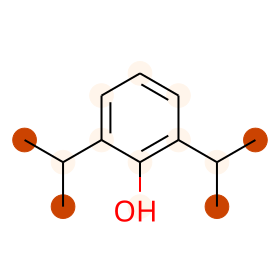

BBBP:1
prediction: [-2.498139  2.497123]
CNCCCC1c2ccccc2C=Cc2ccccc21


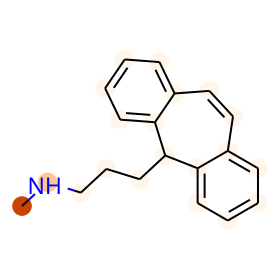

BBBP:1
prediction: [ 0.38457298 -0.5043305 ]
O=c1cc[nH]nc1


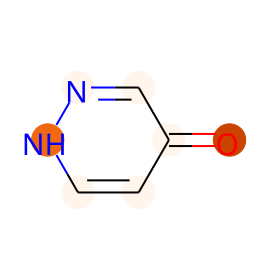

BBBP:1
prediction: [-4.1650043  4.0665274]
Fc1ccccc1C1=NCC(=S)N(CC(F)(F)F)c2ccc(Cl)cc21


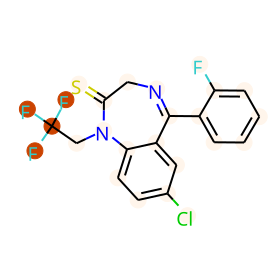

BBBP:1
prediction: [-1.4866852  1.0559667]
COC(=O)[C@H]1[C@H]2C[C@@H]3c4[nH]c5cc(OC)ccc5c4CCN3C[C@H]2C[C@@H](OC(=O)/C=C/c2cc(OC)c(OC)c(OC)c2)[C@@H]1OC


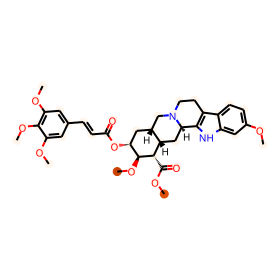

BBBP:1
prediction: [-1.9395627  1.5419753]
COC(=O)[C@H]1[C@H]2C[C@@H]3c4[nH]c5cc(OC)ccc5c4CCN3C[C@H]2C[C@@H](OC(=O)c2cc(OC)c(OC)c(OC)c2)[C@@H]1OC


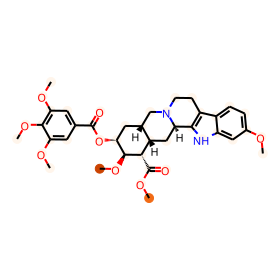

BBBP:1
prediction: [-1.5326649  1.4222091]
C=CCC1(C(C)CCC)C(=O)NC(=O)NC1=O


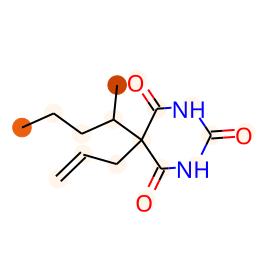

BBBP:1
prediction: [-2.4059312  2.3196485]
O=C1CSC2(CCN(CCCN3c4ccccc4Sc4ccc(Cl)cc43)CC2)N1.[Cl-].[H+]


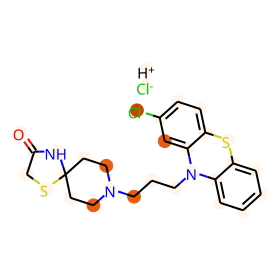

BBBP:0
prediction: [ 0.73874164 -1.0160232 ]
O=C(O)CCCCCCCC(=O)O


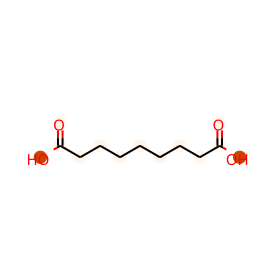

BBBP:0
prediction: [ 1.2568277 -2.4452007]
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)C(C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(O)C[C@@H](C)CN(C)[C@H](C)[C@@H](O)[C@]1(C)O


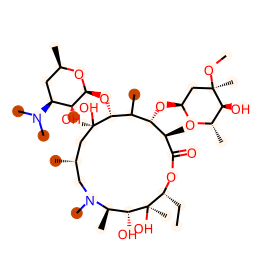

BBBP:0
prediction: [ 1.4805175 -2.107567 ]
CCC(C)C(N)C1=NC(C(=O)N[C@@H](CC(C)C)C(=O)N[C@H](CCC(=O)O)C(=O)N[C@H](C(=O)NCCCC[C@@H]2NC(=O)[C@H](CC(N)=O)NC(=O)[C@@H](CC(=O)O)NC(=O)[C@H](Cc3cnc[nH]3)NC(=O)[C@@H](Cc3ccccc3)NC(=O)[C@H]([C@@H](C)CC)NC(=O)[C@@H](CCCN)NC2=O)[C@@H](C)CC)CS1


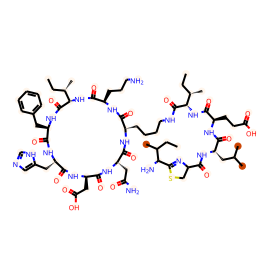

BBBP:0
prediction: [-0.25260955  0.03592237]
CC(C[N+](C)(C)C)OC(N)=O.[Cl-]


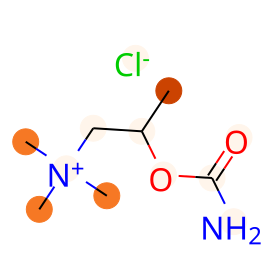

BBBP:0
prediction: [ 0.57199955 -1.0358013 ]
CC[N+](C)(C)Cc1ccccc1Br.Cc1ccc(S(=O)(=O)[O-])cc1


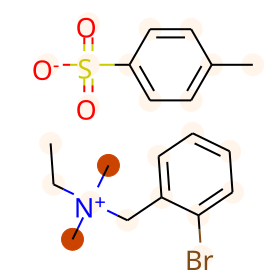

BBBP:0
prediction: [ 0.6770754 -1.3268685]
CC(C)C[C@H]1C(=O)N2CCC[C@H]2[C@]2(O)O[C@](NC(=O)[C@@H]3C=C4c5cccc6[nH]c(Br)c(c56)C[C@H]4N(C)C3)(C(C)C)C(=O)N12


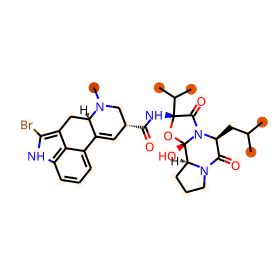

BBBP:0
prediction: [ 0.49607778 -0.7047228 ]
NCCc1ccc(O)c(O)c1


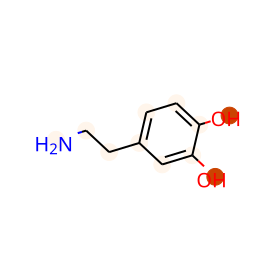

BBBP:0
prediction: [ 1.1922951 -1.7950549]
COc1cccc2c1C(=O)c1c(O)c3c(c(O)c1C2=O)C[C@@](O)(C(=O)CO)C[C@@H]3O[C@H]1C[C@H](N)[C@H](O)[C@H](C)O1


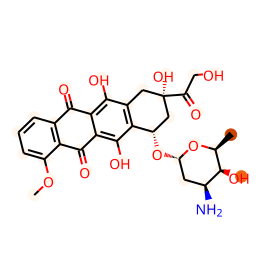

BBBP:0
prediction: [ 1.4807991 -2.0538824]
C[C@H]1c2cccc(O)c2C(O)=C2C(=O)[C@]3(O)C(=O)/C(=C(/N)O)C(=O)[C@@H](N(C)C)[C@@H]3[C@@H](O)[C@@H]21.O


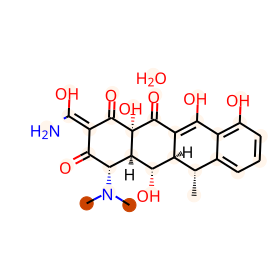

BBBP:0
prediction: [-1.2053648  1.1215063]
CCCCOc1ccc(C(=O)CCN2CCCCC2)cc1.[Cl]


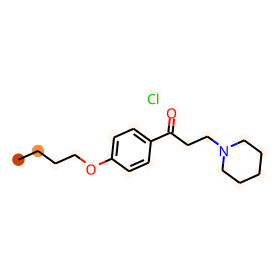

BBBP:0
prediction: [-0.17084493 -0.01752704]
Clc1ccc(COC(Cn2ccnc2)c2ccc(Cl)cc2Cl)cc1


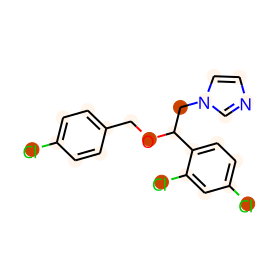

BBBP:0
prediction: [ 0.7681053 -1.0671045]
CN[C@@H](C)[C@H](O)c1ccccc1


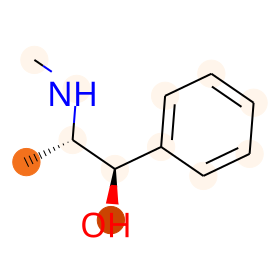

BBBP:0
prediction: [ 1.1316551 -1.5454167]
CNC[C@H](O)c1ccc(O)c(O)c1


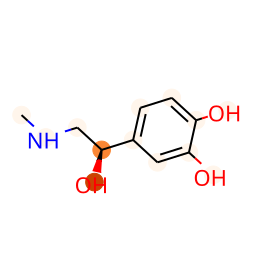

BBBP:0
prediction: [ 0.24465369 -0.4730147 ]
C[C@]12CC[C@@H]3c4ccc(O)cc4CC[C@H]3[C@@H]1CC[C@@H]2O


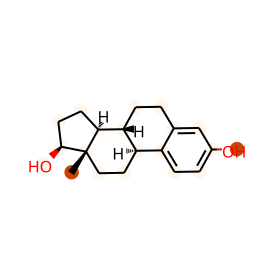

BBBP:1
prediction: [-2.0055733  2.0022717]
Nc1c2c(nc3ccccc13)CCCC2


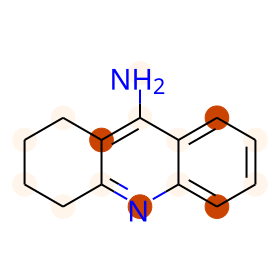

BBBP:1
prediction: [-2.5570574  2.5050063]
CN1C(=O)C(O)N=C(c2ccccc2)c2cc(Cl)ccc21


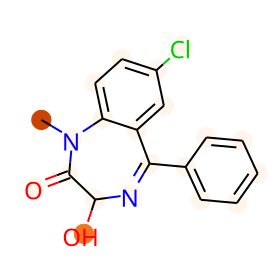

BBBP:1
prediction: [-2.7229319  2.5712156]
COc1cc2c(cc1OC)C1CC(=O)C(CC(C)C)CN1CC2


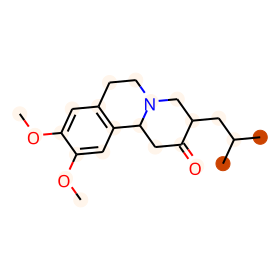

BBBP:1
prediction: [-1.6321087  1.4400682]
CCCCCc1cc(O)c2c(c1)OC(C)(C)[C@@H]1CCC(C)=C[C@@H]21


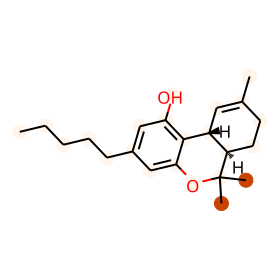

BBBP:1
prediction: [-3.184978  3.079714]
COC1=CC=C2[C@H]3Cc4ccc(OC)c5c4[C@@]2(CCN3C)[C@H]1O5


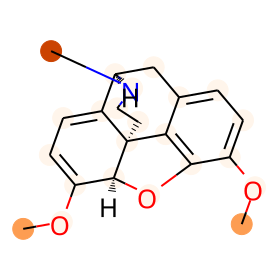

BBBP:1
prediction: [-3.2744994  3.220645 ]
CCSc1ccc2c(c1)N(CCCN1CCN(C)CC1)c1ccccc1S2


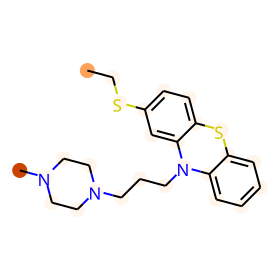

BBBP:1
prediction: [-2.693162   2.5237193]
CN1CCN(CC/C=C2\c3ccccc3Sc3ccc(S(=O)(=O)N(C)C)cc32)CC1


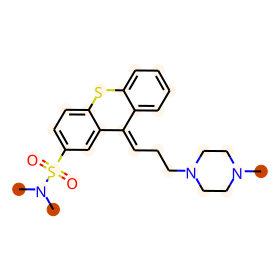

BBBP:1
prediction: [-0.49904954  0.40386793]
N[C@@H]1C[C@H]1c1ccccc1.[Cl-].[H+]


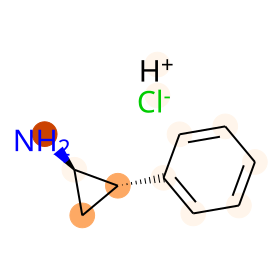

BBBP:1
prediction: [-2.592197  2.568821]
O=c1n(CCCN2CCN(c3cccc(Cl)c3)CC2)nc2ccccn12


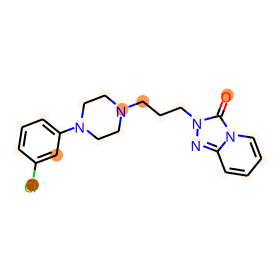

BBBP:1
prediction: [-1.6628543  1.5915504]
CS(=O)(=O)OCCCCOS(C)(=O)=O


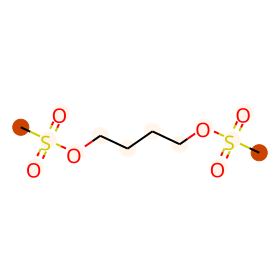

BBBP:1
prediction: [-2.3620107  2.2507467]
CCN(CC)CCCC(C)Nc1ccnc2cc(Cl)ccc12


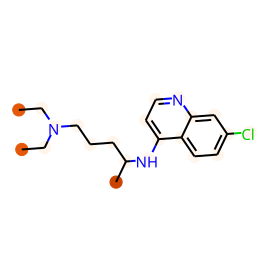

BBBP:1
prediction: [-2.3577123  2.1661346]
COc1cc(N)c(Cl)cc1C(=O)NC1CCN(CCCOc2ccc(F)cc2)CC1OC.O


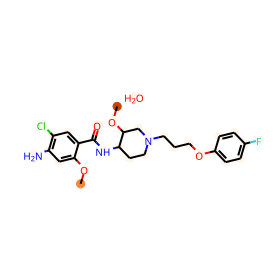

BBBP:1
prediction: [-0.37985027  0.16442311]
Nc1nc(Cl)nc2c1ncn2[C@H]1C[C@H](O)[C@@H](CO)O1


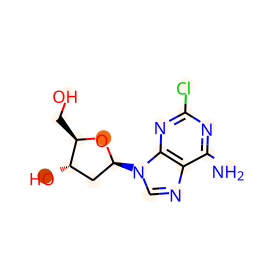

BBBP:0
prediction: [ 1.0313108 -1.4198474]
C[N+]12CCC(CC1)C(OC(=O)C(O)(c1ccccc1)c1ccccc1)C2.[Br-]


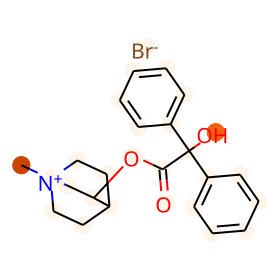

BBBP:0
prediction: [ 0.18427016 -0.42611736]
C=C(CC)C(=O)c1ccc(OCC(=O)O)c(Cl)c1Cl


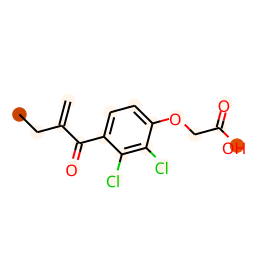

BBBP:0
prediction: [ 1.0616871 -1.3747691]
C#C[C@]1(O)CC[C@H]2[C@@H]3CCc4cc(O)ccc4[C@H]3CC[C@@]21C


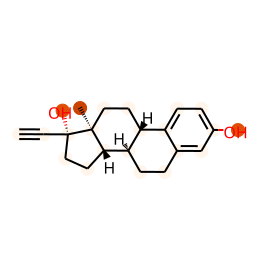

BBBP:0
prediction: [ 1.3012275 -1.7592082]
CC(Cc1ccc(O)cc1)NCC(O)c1cc(O)cc(O)c1


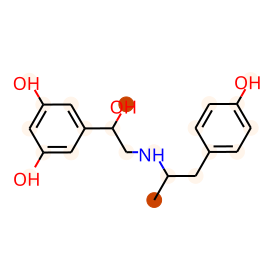

BBBP:0
prediction: [ 0.6347217 -0.9410515]
O=c1[nH]c(=O)n([C@H]2C[C@H](O)[C@@H](CO)O2)cc1F


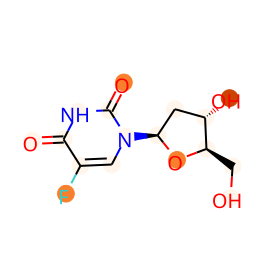

BBBP:0
prediction: [ 1.2024208 -1.8051306]
Cc1onc(-c2c(F)cccc2Cl)c1C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12


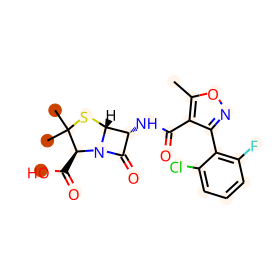

BBBP:0
prediction: [ 0.48397195 -0.71243286]
O=c1[nH]cc(F)c(=O)[nH]1


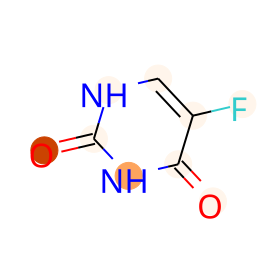

BBBP:0
prediction: [ 0.71241075 -1.0547105 ]
NS(=O)(=O)c1cc(C(=O)O)c(NCc2ccco2)cc1Cl


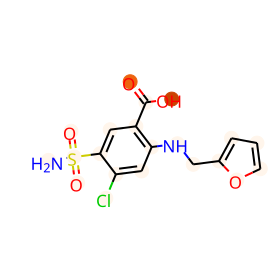

BBBP:0
prediction: [ 0.38599   -0.6398163]
Nc1nc(=O)c2ncn(COC(CO)CO)c2[nH]1


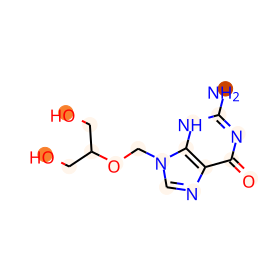

BBBP:0
prediction: [ 0.86386067 -1.2253498 ]
C[N+]1(C)CCC(OC(=O)C(O)(c2ccccc2)C2CCCC2)C1.[Br-]


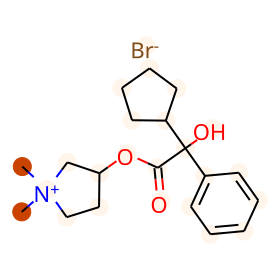

BBBP:1
prediction: [-4.497244  4.386575]
CN1CCN(CCCN2c3ccccc3Sc3ccc(C(F)(F)F)cc32)CC1


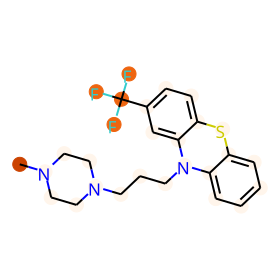

BBBP:1
prediction: [-1.4159313  1.330862 ]
OC(CCN1CCCCC1)(c1ccccc1)C1CCCCC1


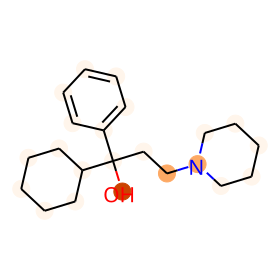

BBBP:1
prediction: [-2.667794  2.574927]
CC(CN(C)C)CN1c2ccccc2CCc2ccccc21


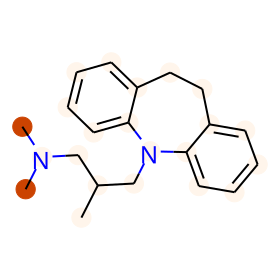

BBBP:1
prediction: [-2.1041641  2.0238497]
CCCCNC(=O)OCC(C)(CCC)COC(N)=O


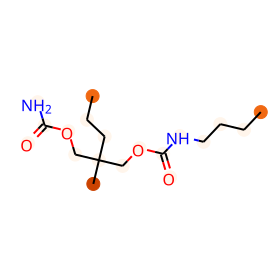

BBBP:1
prediction: [ 0.8823967 -1.3580916]
O=c1ccn(C2OC(CO)C(O)C2O)c(=O)[nH]1


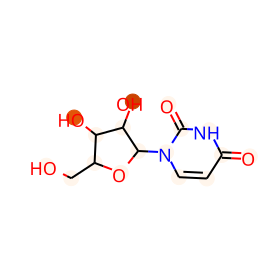

BBBP:1
prediction: [ 0.16714741 -0.35452366]
CCCC(CCC)C(=O)O


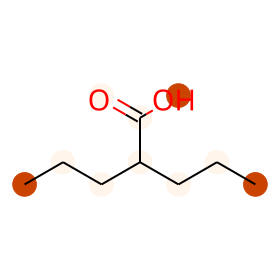

BBBP:1
prediction: [-2.1349616  2.0663116]
CN(C)C/C=C(/c1ccc(Br)cc1)c1cccnc1


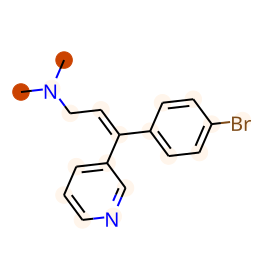

BBBP:0
prediction: [-0.46078283  0.17672971]
CC(C)N=c1cc2n(-c3ccc(Cl)cc3)c3ccccc3nc-2cc1Nc1ccc(Cl)cc1


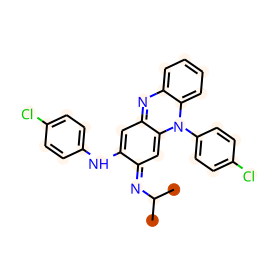

BBBP:0
prediction: [ 1.0926864 -1.6430621]
O=C(O)c1cc(=O)c2cc(OCC(O)COc3cccc4oc(C(=O)O)cc(=O)c34)ccc2o1


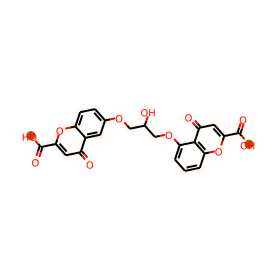

BBBP:1
prediction: [ 0.06810612 -0.2007516 ]
NC(=O)NO


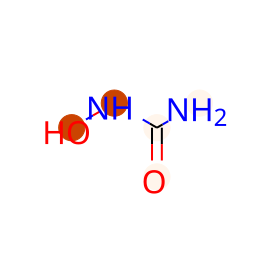

BBBP:0
prediction: [ 1.1350101 -1.6574056]
CC(C)[N+]1(C)C2CCC1CC(OC(=O)C(CO)c1ccccc1)C2.[Br-]


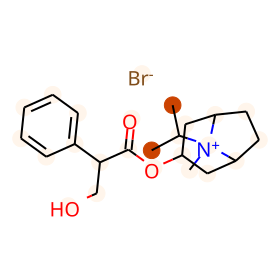

BBBP:0
prediction: [-0.20294659  0.07682582]
NC(N)=N/N=C/c1c(Cl)cccc1Cl


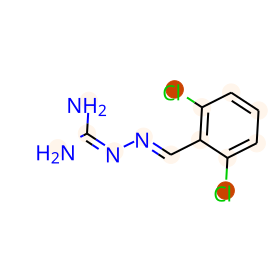

BBBP:0
prediction: [-0.530505    0.43904796]
NC(N)=NCCN1CCCCCCC1


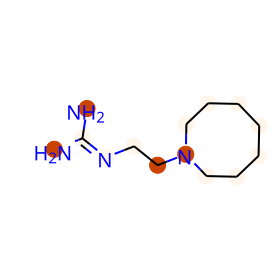

BBBP:0
prediction: [-0.16175456 -0.07653259]
CN1C2CCC1CC(OC(=O)C(O)c1ccccc1)C2


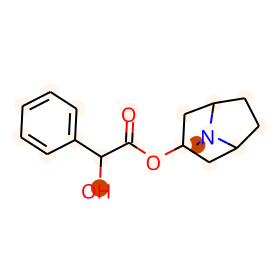

BBBP:0
prediction: [-0.21347328  0.10387824]
NNc1nncc2ccccc12


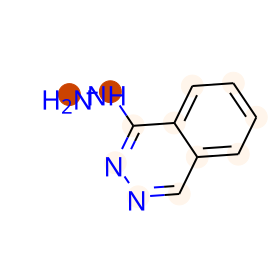

BBBP:0
prediction: [ 0.69667757 -0.98616797]
NS(=O)(=O)c1cc2c(cc1Cl)NCNS2(=O)=O


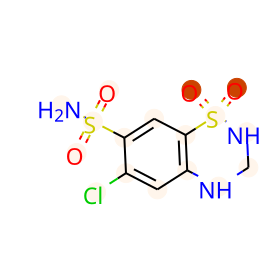

BBBP:0
prediction: [ 0.5988788  -0.95116806]
NS(=O)(=O)c1cc2c(cc1C(F)(F)F)NCNS2(=O)=O


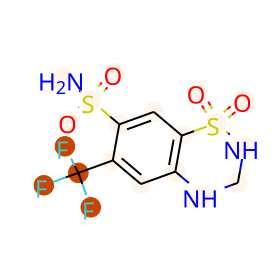

BBBP:0
prediction: [ 0.37282944 -0.65095615]
CC(C)Cc1ccc(C(C)C(=O)O)cc1


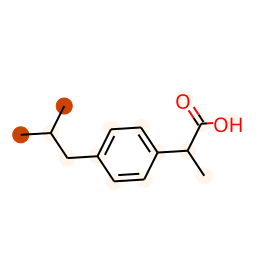

BBBP:0
prediction: [ 0.66207176 -1.0554487 ]
COc1ccc2c(c1)c(CC(=O)O)c(C)n2C(=O)c1ccc(Cl)cc1


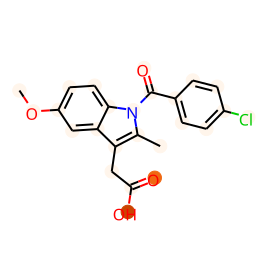

BBBP:1
prediction: [-1.0370549  0.9029144]
C=C1Cc2c(CCN(CCC)CCC)ccc(O)c2N1


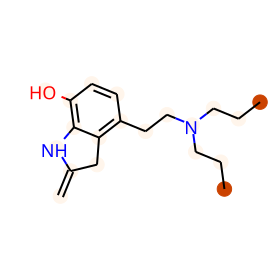

BBBP:1
prediction: [-1.8076714  1.6124488]
Cc1nc2n(c(=O)c1CCN1CCC(c3noc4cc(F)ccc34)CC1)CCC[C@H]2O


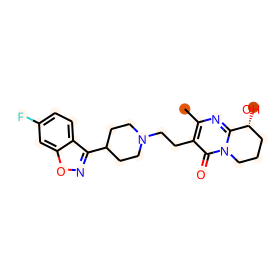

BBBP:1
prediction: [-2.8818789  2.860953 ]
Cc1nnc2n1-c1ccc(Cl)cc1C(c1ccccc1)=NC2


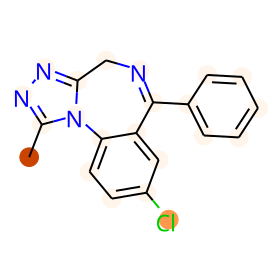

BBBP:1
prediction: [-1.9337763  1.9131417]
O=NN(CCCl)C(=O)NCCCl


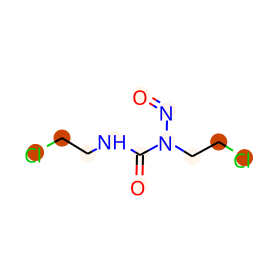

BBBP:0
prediction: [ 1.2046641 -1.6944985]
CCC(C)n1ncn(-c2ccc(N3CCN(c4ccc(OC[C@H]5CO[C@](Cn6cncn6)(c6ccc(Cl)cc6Cl)O5)cc4)CC3)cc2)c1=O


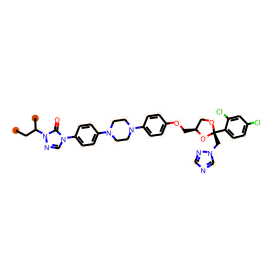

BBBP:0
prediction: [ 0.30688465 -0.51981276]
O=C(c1ccccc1)c1ccc2n1CCC2C(=O)O


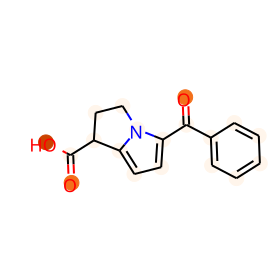

BBBP:0
prediction: [ 0.8645055 -1.2609103]
C[C@H](N)[C@H](O)c1cccc(O)c1


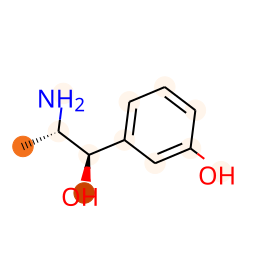

BBBP:0
prediction: [-0.652547   0.5935305]
NNC(=O)c1ccncc1


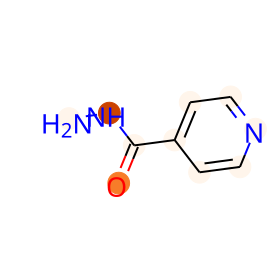

BBBP:0
prediction: [ 1.1829695 -1.571327 ]
CC(C)NCC(O)c1ccc(O)c(O)c1


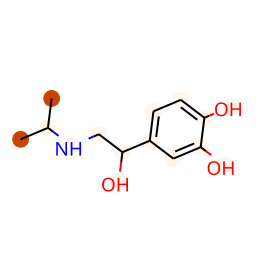

BBBP:0
prediction: [ 0.03581274 -0.3315125 ]
CC(=O)N1CCN(c2ccc(OC[C@H]3CO[C@](Cn4ccnc4)(c4ccc(Cl)cc4Cl)O3)cc2)CC1


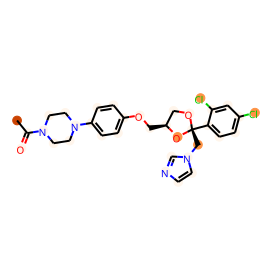

BBBP:0
prediction: [ 0.6987146 -1.0185729]
CC(CCc1ccccc1)NCC(O)c1ccc(O)c(C(N)=O)c1


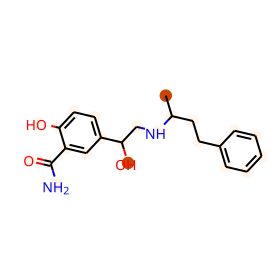

BBBP:0
prediction: [ 0.7698035 -1.218938 ]
N[C@@H](Cc1ccc(O)c(O)c1)C(=O)O


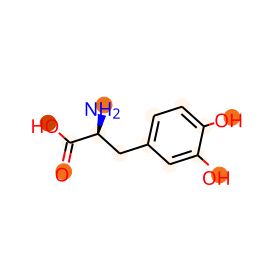

BBBP:0
prediction: [ 0.3983073 -1.0073401]
OCC(O)C(O)C(O)C(O)CO


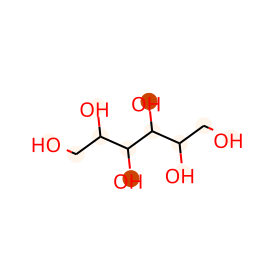

BBBP:0
prediction: [ 0.7183554 -1.242152 ]
C=C1c2c(Cl)ccc(O)c2C(O)=C2C(=O)C3(O)C(=O)/C(=C(/N)O)C(=O)C(N(C)C)C3C(O)C12


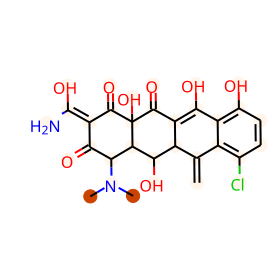

BBBP:0
prediction: [ 0.5209286  -0.81399643]
Cc1ccc(Cl)c(Nc2ccccc2C(=O)O)c1Cl


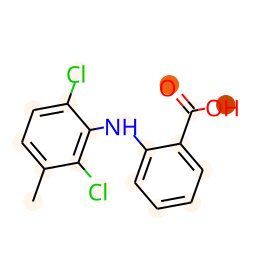

BBBP:0
prediction: [ 0.7576587 -1.0591815]
Cc1cccc(Nc2ccccc2C(=O)O)c1C


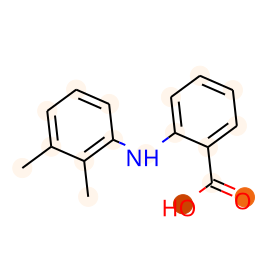

BBBP:0
prediction: [ 0.18526606 -0.37103912]
O=c1nc[nH]c2c1ncn2[C@H]1CC[C@@H](CO)O1


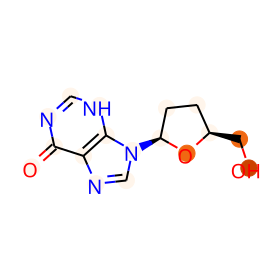

BBBP:1
prediction: [-0.21248406  0.0007489 ]
COCCc1ccc(OCC(O)CNC(C)C)cc1


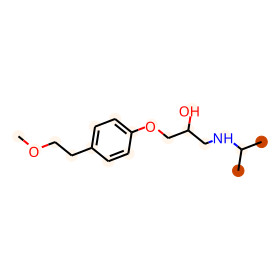

BBBP:0
prediction: [ 1.4290887 -1.9172949]
CC#C[C@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)CCC4=C3[C@@H](c3ccc(N(C)C)cc3)C[C@@]21C


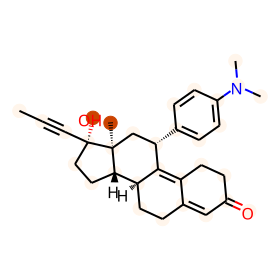

BBBP:1
prediction: [ 0.9923432 -1.4905896]
CN(C)c1ccc(O)c2c1C[C@H]1C[C@H]3[C@H](N(C)C)C(O)=C(C(N)=O)C(=O)[C@@]3(O)C(O)=C1C2=O


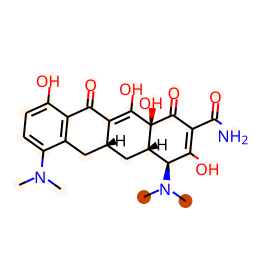

BBBP:1
prediction: [-2.2892609  2.2794101]
O=C(NCCN1CCOCC1)c1ccc(Cl)cc1


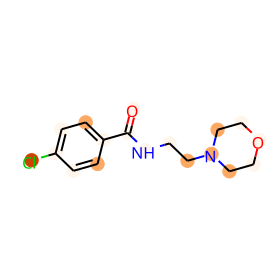

BBBP:0
prediction: [ 0.89368904 -1.4156934 ]
CC(C)[N+](C)(CCOC(=O)C1c2ccccc2Oc2ccccc21)C(C)C.[Br-]


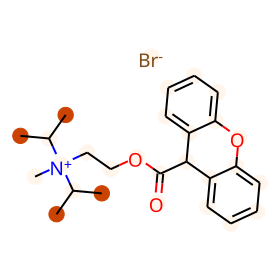

BBBP:1
prediction: [-1.175978   1.1431365]
NC(=O)c1cnccn1


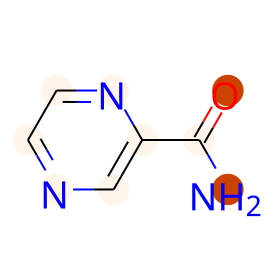

BBBP:1
prediction: [-1.7931578  1.7209952]
CN(C)C(=O)Oc1ccc[n+](C)c1.[Br-]


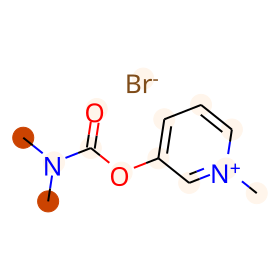

BBBP:1
prediction: [-0.8160485   0.69839466]
CCc1nc(N)nc(N)c1-c1ccc(Cl)cc1


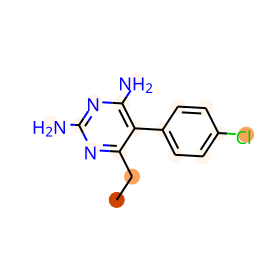

BBBP:0
prediction: [ 0.22350094 -0.5438024 ]
C=C[C@H]1CN2CC[C@@H]1C[C@H]2[C@H](O)c1ccnc2ccc(OC)cc12


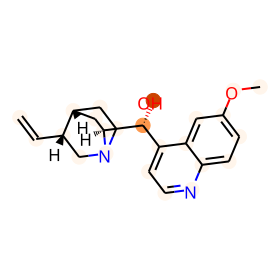

BBBP:0
prediction: [ 0.51782906 -0.8639927 ]
NC(Cc1ccc(N(CCCl)CCCl)cc1)C(=O)O


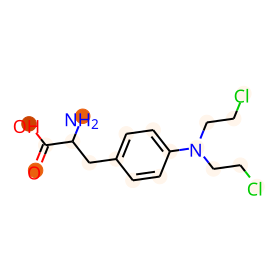

BBBP:0
prediction: [ 1.0495075 -1.4473865]
C[N+]1(C)CCCC(OC(=O)C(O)(c2ccccc2)c2ccccc2)C1.[Br-]


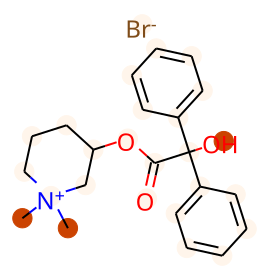

BBBP:0
prediction: [-0.53891253  0.37742874]
COc1ccc(CN(CCN(C)C)c2ccccn2)cc1


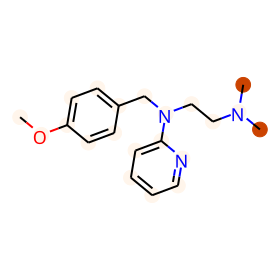

BBBP:0
prediction: [ 0.5382124  -0.81837577]
C#C[C@]1(O)CC[C@H]2[C@@H]3CCc4cc(OC)ccc4[C@H]3CC[C@@]21C


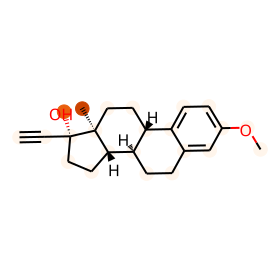

BBBP:0
prediction: [ 0.5859617 -1.0096078]
CC[N+](C)(CC)CCOC(=O)C1c2ccccc2Oc2ccccc21


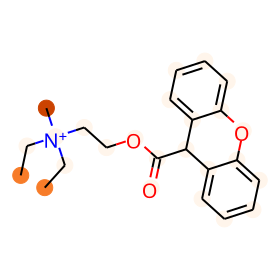

BBBP:0
prediction: [ 0.85679424 -1.3783724 ]
CN(Cc1cnc2nc(N)nc(N)c2n1)c1ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc1


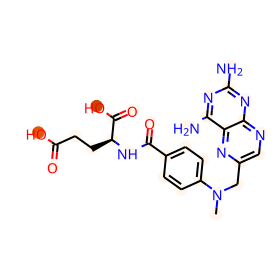

BBBP:0
prediction: [-0.09722859 -0.16351074]
CN1C(CCl)Nc2cc(Cl)c(S(N)(=O)=O)cc2S1(=O)=O


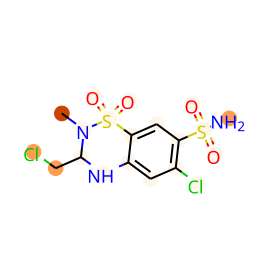

BBBP:0
prediction: [ 1.1079644 -1.5119154]
C[C@](N)(Cc1ccc(O)c(O)c1)C(=O)O


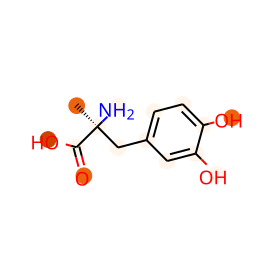

BBBP:0
prediction: [ 0.8480121 -1.1739376]
COc1cccnc1CCCCNc1ncc(Cc2ccc(C)nc2)c(=O)[nH]1.[Cl-].[Cl-].[Cl-].[H+].[H+].[H+]


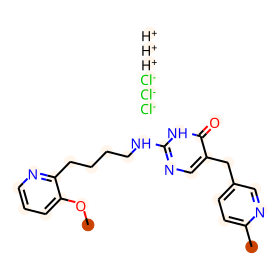

BBBP:0
prediction: [ 1.3377124 -1.773201 ]
Cc1ccc(Cc2cnc(NCCSCc3ccc(C(C)(C)N)o3)[nH]c2=O)cn1


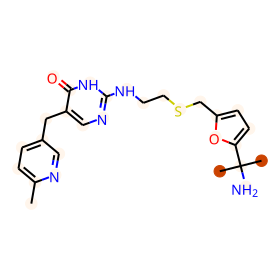

BBBP:1
prediction: [-2.839891   2.8367612]
CN1CCN2c3ccccc3Cc3ccccc3C2C1


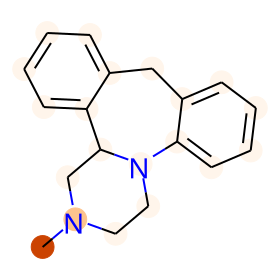

BBBP:1
prediction: [-3.0975878  3.0514762]
Cc1ncc2n1-c1ccc(Cl)cc1C(c1ccccc1F)=NC2


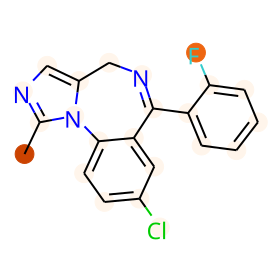

BBBP:0
prediction: [ 2.1261213 -2.7642696]
CC(C)c1nc(CN(C)C(=O)N[C@H](C(=O)N[C@@H](Cc2ccccc2)C[C@H](O)[C@H](Cc2ccccc2)NC(=O)OCc2cncs2)C(C)C)cs1


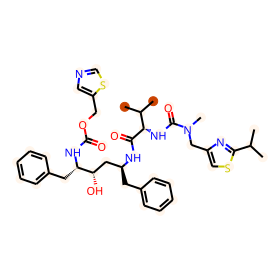

BBBP:0
prediction: [ 1.3342707 -1.9622123]
CC(C)(C)NC(=O)[C@@H]1C[C@@H]2CCCC[C@@H]2CN1C[C@@H](O)[C@H](Cc1ccccc1)NC(=O)[C@H](CC(N)=O)NC(=O)c1ccc2ccccc2n1


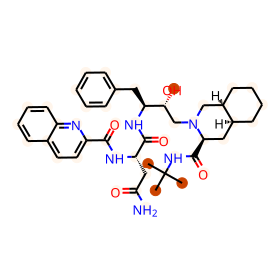

BBBP:1
prediction: [-4.0165224  3.9003923]
FCOC(C(F)(F)F)C(F)(F)F


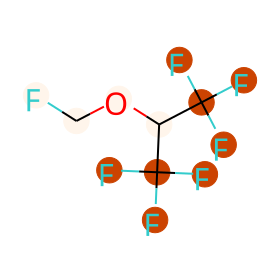

BBBP:0
prediction: [ 1.0535613 -1.4064531]
CC(=O)Nc1c(I)c(NC(C)=O)c(I)c(C(=O)[O-])c1I.[Na+]


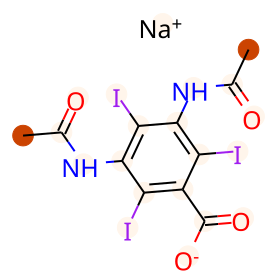

BBBP:1
prediction: [ 1.3172525 -1.6977801]
CC(C)NCC(O)c1ccc(NS(C)(=O)=O)cc1


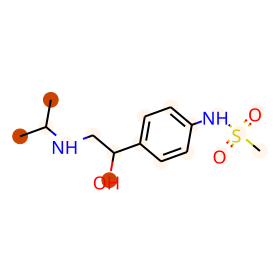

BBBP:1
prediction: [-0.00765677 -0.21584272]
Cc1cn([C@H]2C=C[C@@H](CO)O2)c(=O)[nH]c1=O


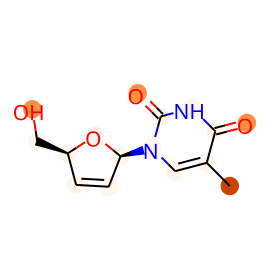

BBBP:0
prediction: [ 1.0464822 -2.2257855]
CN[C@@H]1[C@H](O[C@H]2[C@H](O[C@@H]3[C@@H](N=C(N)N)[C@H](O)[C@@H](N=C(N)N)[C@H](O)[C@H]3O)O[C@@H](C)[C@]2(O)C=O)O[C@@H](CO)[C@H](O)[C@H]1O


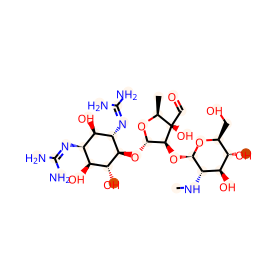

BBBP:1
prediction: [ 0.39752442 -0.5956176 ]
Nc1ccc(S(=O)(=O)Nc2ncccn2)cc1


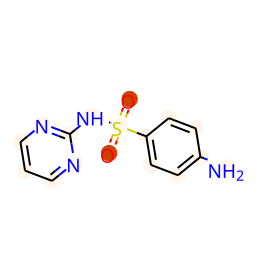

BBBP:0
prediction: [-0.6590549   0.29412434]
C[C@H]1C[C@H]2[C@@H]3CC[C@](O)(C(=O)CO)[C@@]3(C)C[C@H](O)[C@@H]2[C@@]2(C)C=CC(=O)C=C12


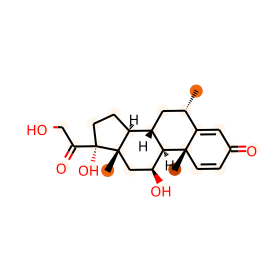

BBBP:0
prediction: [-0.4306718   0.23236194]
Clc1ccc(COC(Cn2ccnc2)c2ccc(Cl)cc2Cl)c(Cl)c1


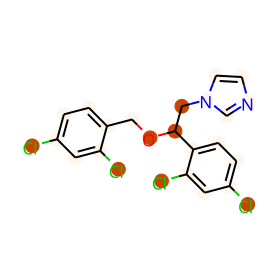

BBBP:0
prediction: [ 0.08187894 -0.21667528]
OCc1cccnc1


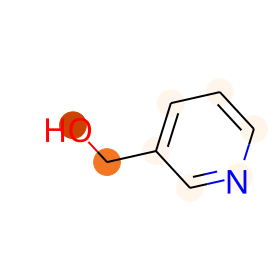

BBBP:0
prediction: [ 0.6330024 -0.9071961]
NCC(O)c1cccc(O)c1


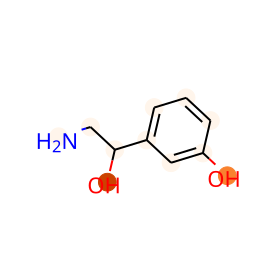

BBBP:0
prediction: [ 0.72566044 -1.0473061 ]
CC(CCc1ccccc1)NC(C)C(O)c1ccc(O)cc1


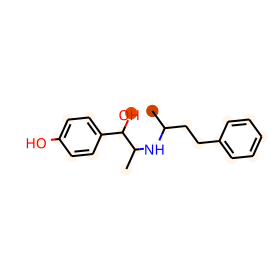

BBBP:0
prediction: [-0.07543083 -0.19375423]
C[C@]12COC(=O)C[C@@H]1CC[C@@H]1[C@@H]2CC[C@@]2(C)[C@H]1CC[C@]2(C)O


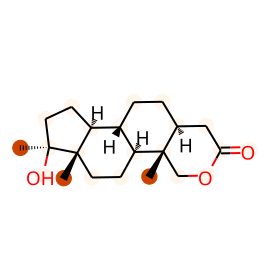

BBBP:0
prediction: [ 0.0811097  -0.28570464]
O=C(O)CCc1nc(-c2ccccc2)c(-c2ccccc2)o1


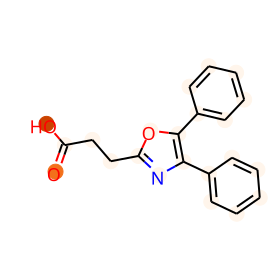

BBBP:1
prediction: [-2.926896  2.926133]
CN1CCN2c3ncccc3Cc3ccccc3C2C1


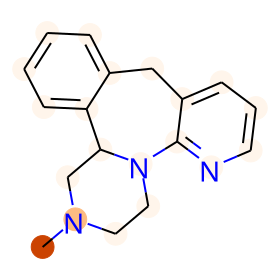

BBBP:1
prediction: [-2.8206859  2.8067229]
Cc1ccnc2c1NC(=O)c1cccnc1N2C1CC1


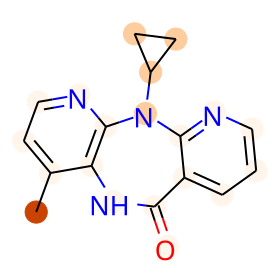

BBBP:1
prediction: [-2.4433289  2.3661082]
FC(F)(F)c1ccc(N2CCNCC2)nc1Cl


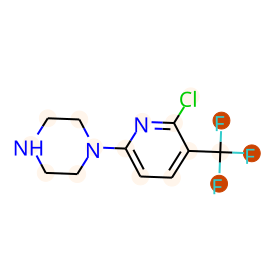

BBBP:1
prediction: [-1.4133312  1.3581288]
Clc1ccc2c(c1)[C@H]1CNC[C@H]1c1ccccc1O2


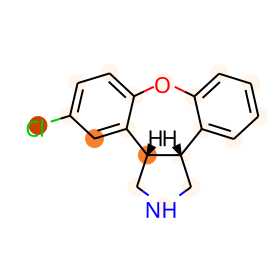

BBBP:1
prediction: [-1.8237512  1.7964098]
C=CC[C@H](N)c1ccccc1-c1noc2ccccc12


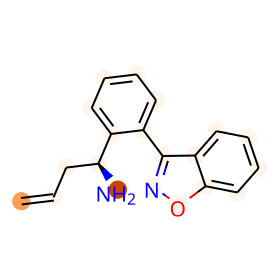

BBBP:1
prediction: [-2.40927    2.3528793]
CN1C[C@@H]2c3cc(Cl)ccc3Oc3ccccc3[C@@H]2C1


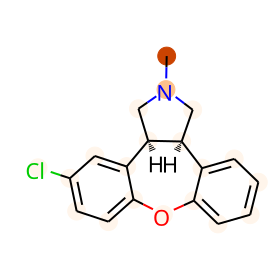

BBBP:0
prediction: [ 0.06569863 -0.30875856]
CN/C(=C\[N+](=O)[O-])NCCSCc1ccc(CN(C)C)o1


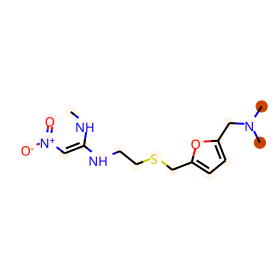

BBBP:1
prediction: [ 0.36648926 -0.58799815]
Cc1cc(NS(=O)(=O)c2ccc(N)cc2)no1


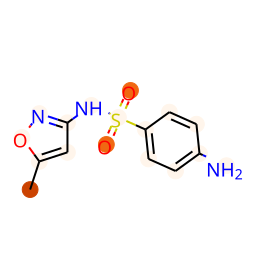

BBBP:1
prediction: [-1.7770306  1.6555414]
CC/C(=C(\c1ccccc1)c1ccc(OCCN(C)C)cc1)c1ccccc1


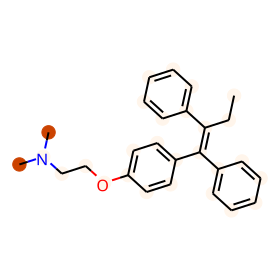

BBBP:1
prediction: [ 1.3931612 -1.9962174]
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](C(=O)[O-])c3ccsc3)C(=O)N2[C@H]1C(=O)[O-].[Na+].[Na+]


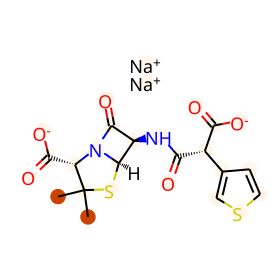

BBBP:1
prediction: [-0.9334077  0.6409682]
CC[C@@]1(O)C(=O)OCc2c1cc1n(c2=O)Cc2cc3c(CN(C)C)c(O)ccc3nc2-1


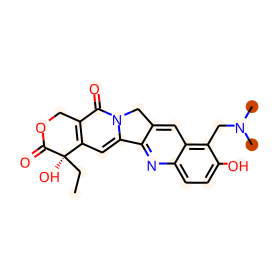

BBBP:1
prediction: [ 0.41279992 -0.6161574 ]
Nc1ccn([C@H]2CC[C@@H](CO)O2)c(=O)n1


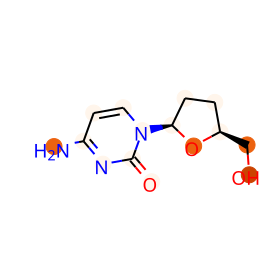

BBBP:1
prediction: [-0.42429233  0.28353262]
NS(=O)(=O)Cc1noc2ccccc12


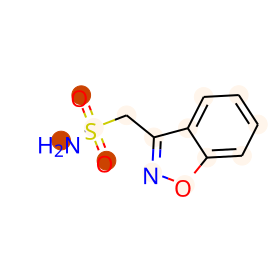

BBBP:0
prediction: [ 0.9957874 -2.1419907]
C[C@@H]1OC(=O)C[C@H](O)C[C@H](O)CC[C@@H](O)[C@H](O)C[C@H](O)C[C@]2(O)C[C@H](O)[C@@H](C(=O)O)[C@H](C[C@@H](O[C@@H]3O[C@H](C)[C@@H](O)[C@H](N)[C@@H]3O)/C=C\C=C/C=C\C=C/C=C\C=C/C=C\[C@H](C)[C@@H](O)[C@H]1C)O2


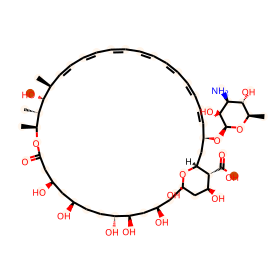

BBBP:1
prediction: [ 0.84523046 -1.1834682 ]
Nc1nc(=O)c2c([nH]1)NCC(CNc1ccc(C(=O)N[C@@H](CCC(=O)[O-])C(=O)[O-])cc1)N2C=O.[Ca+2]


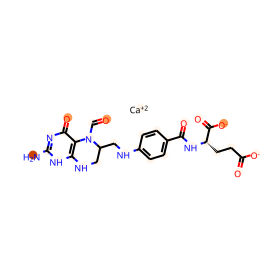

BBBP:0
prediction: [ 1.5777737 -2.1586108]
CN(C)[C@@H]1C(=O)/C(=C(\N)O)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(O)cccc4[C@@](C)(O)[C@H]3[C@H](O)[C@@H]12.O.O


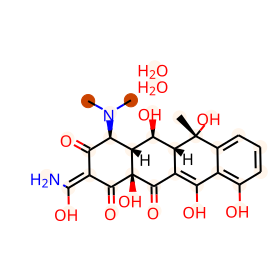

BBBP:0
prediction: [-0.4081694  0.1935544]
COc1ccc(Cc2nccc3cc(OC)c(OC)cc23)cc1OC


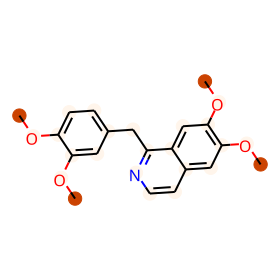

BBBP:0
prediction: [ 1.4665164 -1.9701695]
CC1(C)S[C@@H]2[C@H](NC(=O)Cc3ccccc3)C(=O)N2[C@H]1C(=O)O


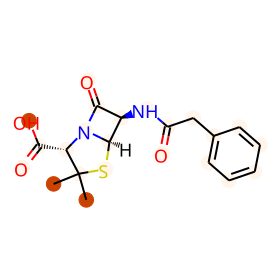

BBBP:0
prediction: [-1.4249007  1.3666744]
CCOc1ccc(NC(C)=O)cc1


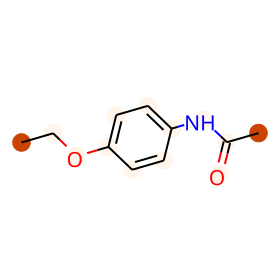

BBBP:0
prediction: [-0.09587494 -0.06893027]
CN(C)CCC(c1ccccc1)c1ccccn1


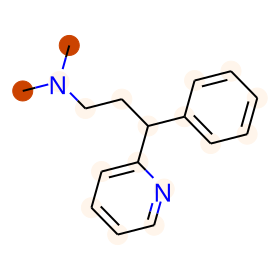

BBBP:0
prediction: [-0.22299798  0.04037593]
O=C1OC(c2ccc(O)cc2)(c2ccc(O)cc2)c2ccccc21


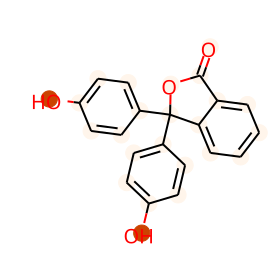

BBBP:0
prediction: [-0.03902655 -0.1178108 ]
CCCCC1C(=O)N(c2ccccc2)N(c2ccccc2)C1=O


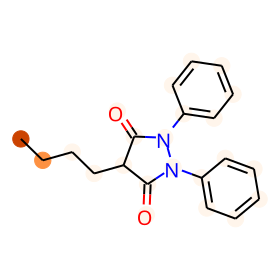

BBBP:0
prediction: [ 1.3742018 -1.8250077]
CC(C)(C)NCC(O)c1ccc(O)c(CO)n1


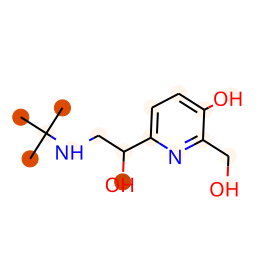

BBBP:1
prediction: [-3.2160096  3.1350138]
Cc1nc2n(c(=O)c1CCN1CCC(c3noc4cc(F)ccc34)CC1)CCCC2


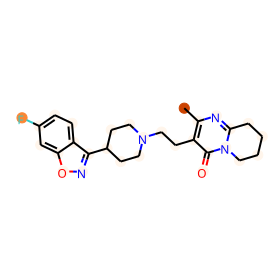

BBBP:1
prediction: [-1.437828   1.2526087]
CN1CC[C@@]2(C)c3cc(OC(=O)Nc4ccccc4)ccc3N(C)[C@@H]12


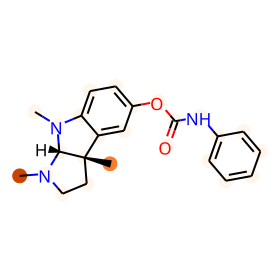

BBBP:0
prediction: [ 0.5671113 -0.868386 ]
Cc1ccc(Cc2cnc(NCCCCc3ncc(Br)cc3C)[nH]c2=O)cn1


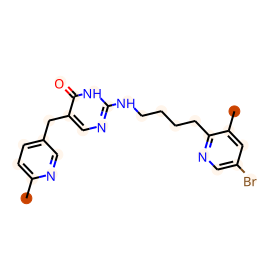

BBBP:1
prediction: [ 0.13245411 -0.40406567]
C#C[C@]1(O)CC[C@H]2[C@H]3[C@H](CC[C@@]21C)C1=C(CC(=O)CC1)C[C@H]3C


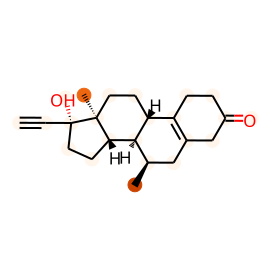

BBBP:1
prediction: [ 0.0655231 -0.2222412]
Nc1[nH]c(=O)ncc1F


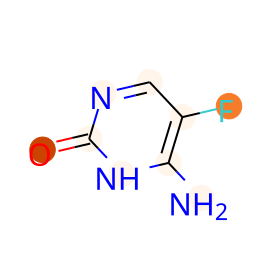

BBBP:0
prediction: [ 0.37481755 -0.58674735]
O=S(=O)([O-])CCS.[Na+]


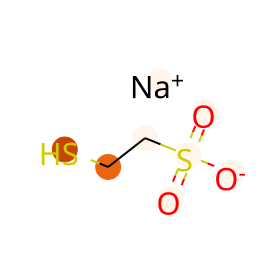

BBBP:1
prediction: [ 1.1554803 -1.8106081]
COc1cc([C@@H]2c3cc4c(cc3[C@@H](OC3OC5COC(c6cccs6)OC5C(O)C3O)[C@H]3COC(=O)[C@H]23)OCO4)cc(OC)c1O


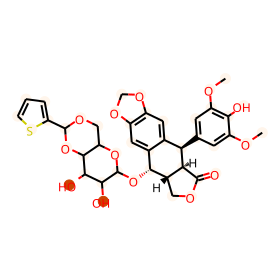

BBBP:1
prediction: [-3.0978985  3.1009967]
S=P(N1CC1)(N1CC1)N1CC1


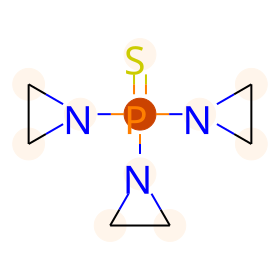

BBBP:0
prediction: [-0.03543137 -0.34471878]
CN1C(CSCC(F)(F)F)Nc2cc(Cl)c(S(N)(=O)=O)cc2S1(=O)=O


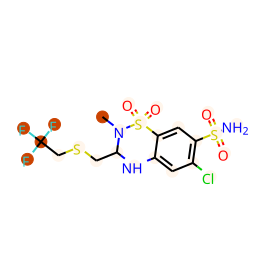

BBBP:0
prediction: [-0.79678965  0.48674592]
C[C@]12C[C@H](O)[C@H]3[C@@H](CCC4=CC(=O)C=C[C@@]43C)[C@@H]1CC[C@]2(O)C(=O)CO


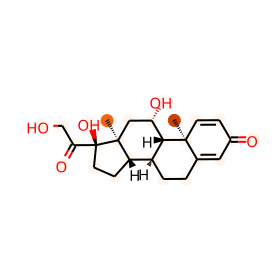

BBBP:0
prediction: [ 0.72835004 -1.0373679 ]
CCCN(CCC)S(=O)(=O)c1ccc(C(=O)O)cc1


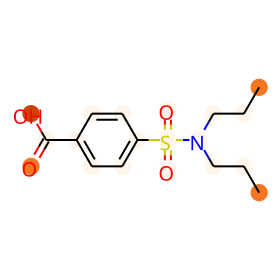

BBBP:0
prediction: [-0.6048381  0.4319089]
CC(C)NCC(O)COc1cccc2ccccc12


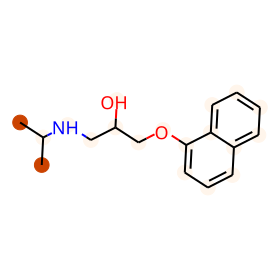

BBBP:0
prediction: [ 1.1475711 -1.7299805]
COc1ccc(C[C@H](N)C(=O)NC2[C@@H](CO)O[C@@H](n3cnc4c(N(C)C)ncnc43)[C@@H]2O)cc1


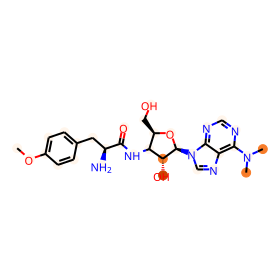

BBBP:0
prediction: [ 0.65937704 -1.0857924 ]
NC(=O)c1ncn([C@@H]2O[C@H](CO)[C@@H](O)[C@H]2O)n1


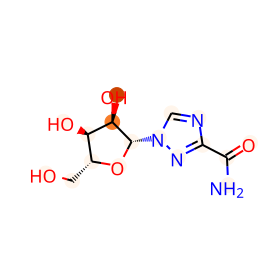

BBBP:1
prediction: [ 1.0611992 -1.3361534]
CN=C(NC#N)NCCSCc1csc(N=C(N)N)n1


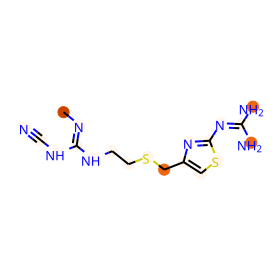

BBBP:1
prediction: [-1.155481   0.9473744]
O=C(O)/C=C\C(=O)O.O=C(O)/C=C\C(=O)O.c1cc(CN2CCCCC2)cc(OCCCNc2nc3ccccc3s2)c1


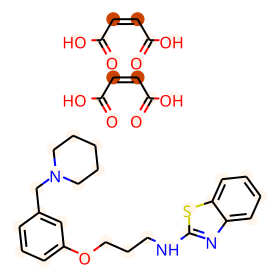

BBBP:1
prediction: [-1.1611648  0.9953426]
OCc1ncc2n1-c1ccc(Cl)cc1C(c1ccccc1F)=NC2


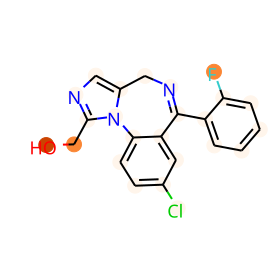

BBBP:1
prediction: [-2.0684822  2.0045192]
CC(Cl)(Cl)Cl


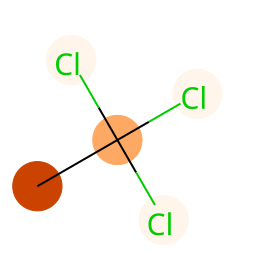

BBBP:1
prediction: [-2.4279368  2.3719962]
FC(F)(F)CCl


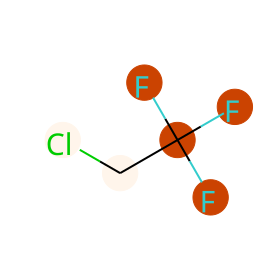

BBBP:1
prediction: [-0.8363236   0.73879325]
CC(C)CO


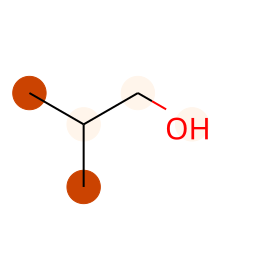

BBBP:1
prediction: [-1.5051464  1.4137523]
CCC(C)(C)C


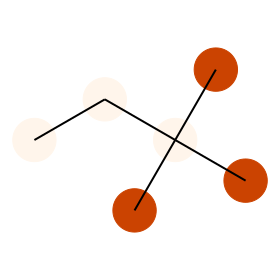

BBBP:1
prediction: [ 0.39722213 -0.7749114 ]
Nc1ncnc2c1ncn2C1OC(CO)C(O)C1O


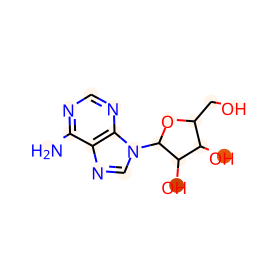

BBBP:1
prediction: [-0.66480166  0.57702756]
S=C(NC1CCCCC1)N1CCC(c2cnc[nH]2)CC1


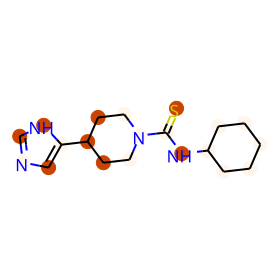

BBBP:0
prediction: [ 0.5041693 -1.4184593]
COC1C=COC2(C)Oc3c(C)c(O)c4c(c3C2=O)C(=O)C(=CNN2CCN(C)CC2)C(=C4O)NC(=O)C(C)=CC=CC(C)C(O)C(C)C(O)C(C)C(OC(C)=O)C1C


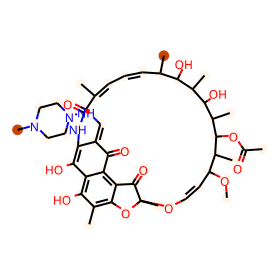

BBBP:0
prediction: [ 0.67632806 -0.91945887]
O=C(O)c1ccccc1O


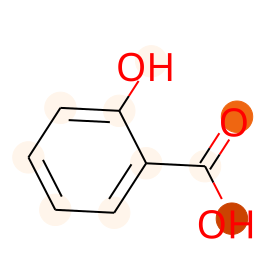

BBBP:0
prediction: [-0.49337527  0.2577225 ]
CN1[C@H]2CC(OC(=O)[C@H](CO)c3ccccc3)C[C@@H]1[C@H]1O[C@@H]21


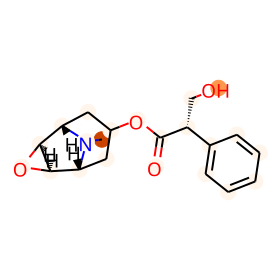

BBBP:0
prediction: [ 0.26315445 -0.6731492 ]
CC(=O)S[C@@H]1CC2=CC(=O)CC[C@]2(C)[C@H]2CC[C@@]3(C)[C@@H](CC[C@@]34CCC(=O)O4)[C@@H]21


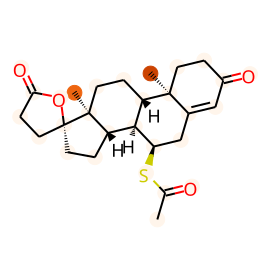

BBBP:0
prediction: [ 0.95233047 -1.2863653 ]
O=C(O)C1=C/C(=N\Nc2ccc(S(=O)(=O)Nc3ccccn3)cc2)C=CC1=O


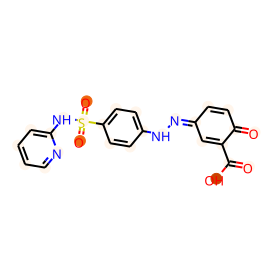

BBBP:0
prediction: [-0.11151877 -0.23056602]
CC(C)N1CCN(c2ccc(OC[C@H]3CO[C@](Cn4cncn4)(c4ccc(Cl)cc4Cl)O3)cc2)CC1


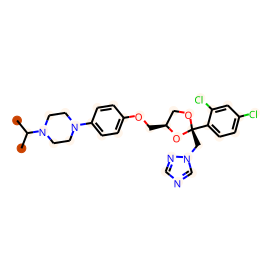

BBBP:0
prediction: [-0.15526357 -0.07357357]
C[C@]12CC[C@H]3[C@@H](CCC4=CC(=O)C=C[C@@]43C)[C@@H]1CCC(=O)O2


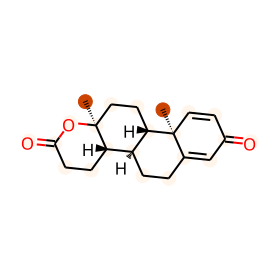

BBBP:0
prediction: [ 1.1600956 -1.6312953]
CN(C)[C@@H]1C(=O)/C(=C(\N)O)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(O)cccc4[C@@](C)(O)[C@H]3C[C@@H]12


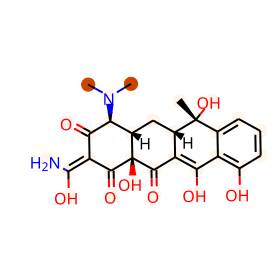

BBBP:1
prediction: [-1.5200528  1.4468279]
CCCC(C)CC


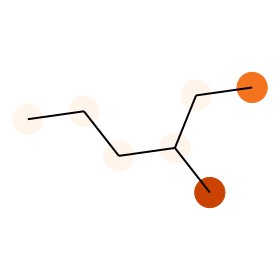

BBBP:1
prediction: [-1.4355141  1.358638 ]
CCC(C)CC


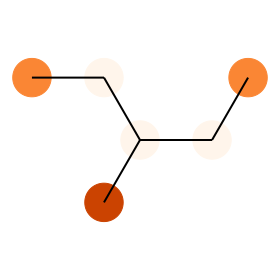

BBBP:1
prediction: [-3.1764088  3.0981815]
Cc1ncc2n1-c1ccc(Cl)cc1C(c1ccccc1F)=NC2O


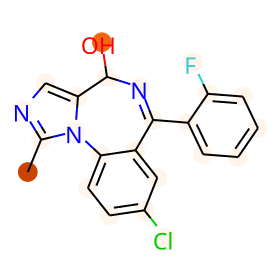

BBBP:1
prediction: [-2.006195   1.8969468]
Cc1c(N(C)C)c(=O)n(-c2ccccc2)n1C


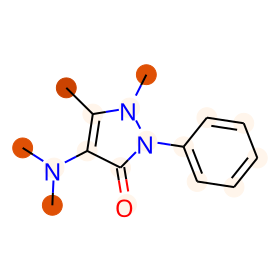

BBBP:0
prediction: [ 0.39990264 -0.6445304 ]
CC(C)NCC(O)COc1ccc(CC(N)=O)cc1


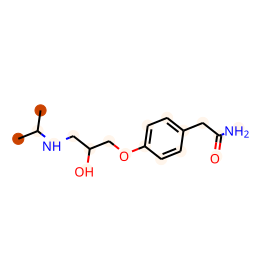

BBBP:1
prediction: [-1.4221648  1.4216255]
c1ccccc1


/data2/erikxiong/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in true_divide
  
/data2/erikxiong/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in less


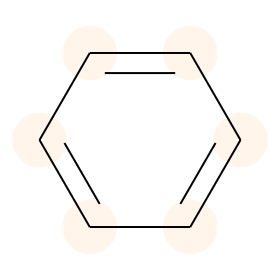

BBBP:1
prediction: [-2.5486984  2.4013417]
CC(C)(C)OC(=O)c1ncn2c1[C@@H]1CCCN1C(=O)c1c(Br)cccc1-2


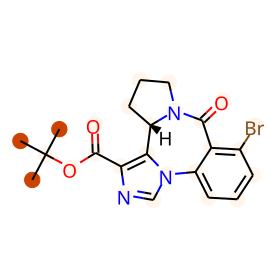

BBBP:1
prediction: [-2.3600142  2.058782 ]
OC(c1cc(C(F)(F)F)nc2c(C(F)(F)F)cccc12)C1CCCCN1


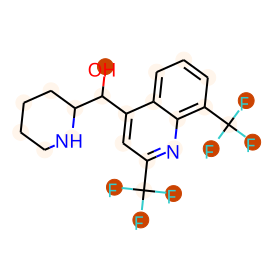

BBBP:1
prediction: [-0.06733445 -0.2844183 ]
CC1COc2c(N3CCN(C)CC3)c(F)cc3c(=O)c(C(=O)O)cn1c23


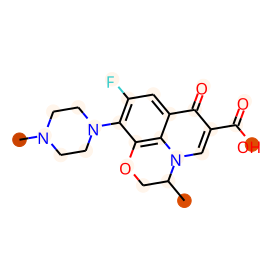

BBBP:1
prediction: [-2.3882926  2.3113918]
CN1c2ccccc2C(c2ccccc2F)=NCC1CNC(=O)c1ccsc1


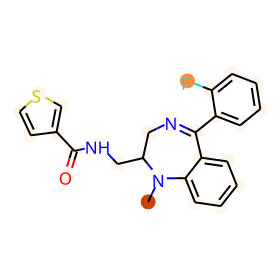

BBBP:1
prediction: [-1.0238887  0.901784 ]
O=C(Cc1ccc(Cl)c(Cl)c1)N1CCCC[C@H]1CN1CCCC1


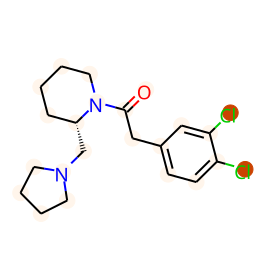

BBBP:1
prediction: [-1.7336448  1.6418729]
O=C(Cc1ccc(Cl)c(Cl)c1)N1CCc2ccccc2[C@H]1CN1CCCC1


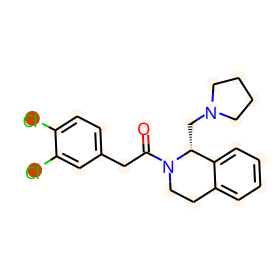

BBBP:1
prediction: [-1.7318287  1.5668044]
O=C(Cc1ccc(C(F)(F)F)cc1)N1CCCC[C@H]1CN1CCCC1


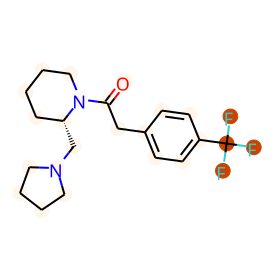

BBBP:1
prediction: [-1.7999374  1.7123051]
O=C(Cc1ccc(Cl)c(Cl)c1)N1CCc2sccc2[C@H]1CN1CCCC1


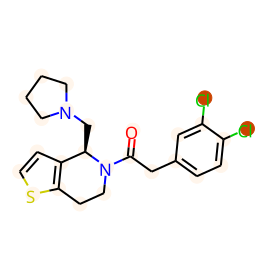

BBBP:0
prediction: [-0.93879175  0.82586455]
Cn1c(=O)c2[nH]cnc2n(C)c1=O


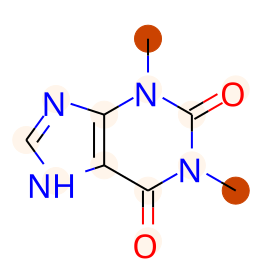

BBBP:0
prediction: [ 0.29331702 -0.43901983]
Nc1nc(=S)c2[nH]cnc2[nH]1


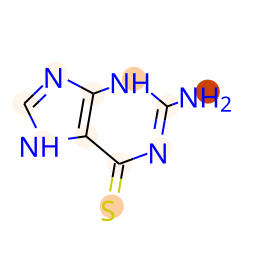

BBBP:0
prediction: [-0.06159294 -0.14181021]
Cc1ccc(S(=O)(=O)NC(=O)NN2CCCCCC2)cc1


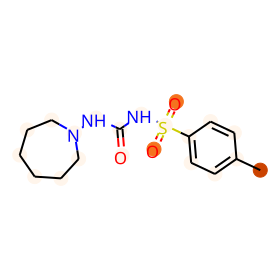

BBBP:0
prediction: [ 0.02803565 -0.22441736]
CCCCNC(=O)NS(=O)(=O)c1ccc(C)cc1


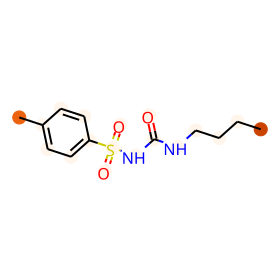

BBBP:0
prediction: [-0.17345218 -0.22890264]
C[C@]12C[C@H](O)[C@@]3(F)[C@@H](CCC4=CC(=O)C=C[C@@]43C)[C@@H]1C[C@@H](O)[C@]2(O)C(=O)CO


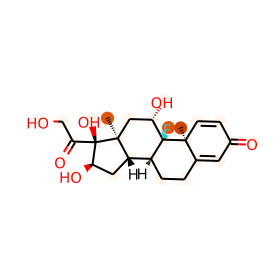

BBBP:0
prediction: [-0.6885566  0.5759   ]
Nc1nc(N)c2nc(-c3ccccc3)c(N)nc2n1


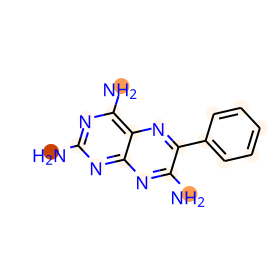

BBBP:0
prediction: [ 0.7971369 -1.1697854]
NS(=O)(=O)c1cc2c(cc1Cl)NC(C(Cl)Cl)NS2(=O)=O


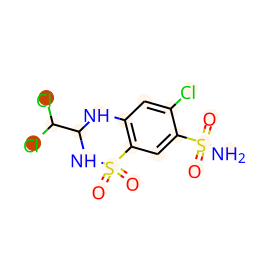

BBBP:0
prediction: [ 3.5688112 -4.9291368]
CC(C)C1NC(=O)[C@@H](C(C)C)OC(=O)[C@H](C(C)C)NC(=O)[C@H](C)OC(=O)[C@@H](C(C)C)NC(=O)[C@@H](C(C)C)OC(=O)[C@H](C(C)C)NC(=O)[C@H](C)OC(=O)[C@@H](C(C)C)NC(=O)[C@@H](C(C)C)OC(=O)[C@H](C(C)C)NC(=O)[C@H](C)OC1=O


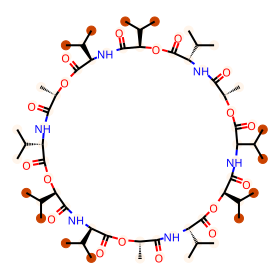

BBBP:0
prediction: [-0.623713    0.24786031]
COc1ccc(CCN(C)CCCC(C#N)(c2ccc(OC)c(OC)c2)C(C)C)cc1OC


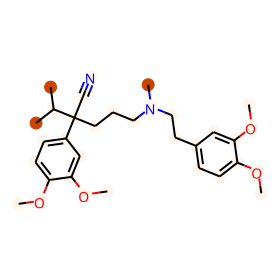

BBBP:1
prediction: [-1.3962371  1.3368838]
CCC(C)=O


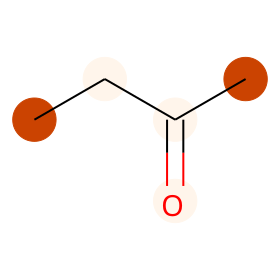

BBBP:1
prediction: [-0.8593521  0.8079449]
C1CC1


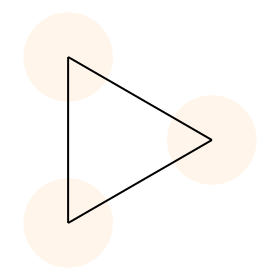

BBBP:1
prediction: [-2.3976812  2.42753  ]
NCCCN1c2ccccc2CCc2ccccc21


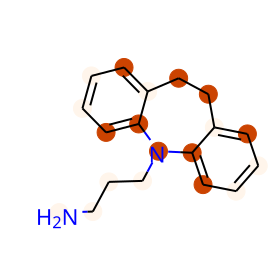

BBBP:1
prediction: [-1.3622227  1.3136945]
ClCCl


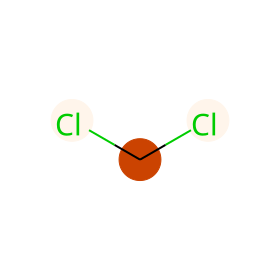

BBBP:1
prediction: [-1.4054087  1.3541777]
CCOCC


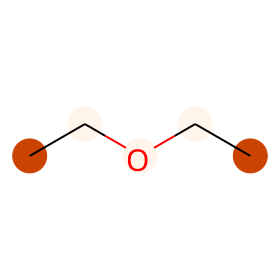

BBBP:1
prediction: [-1.3911135  1.3628118]
C=COC=C


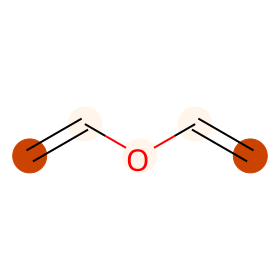

BBBP:1
prediction: [-3.3813586  3.2740963]
FC(F)OC(F)(F)C(F)Cl


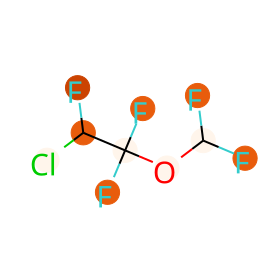

BBBP:0
prediction: [ 0.24586596 -0.4797049 ]
O=C(Cc1ccc(Cl)c(Cl)c1)N1CCc2[nH]cnc2[C@H]1CN1CCCC1


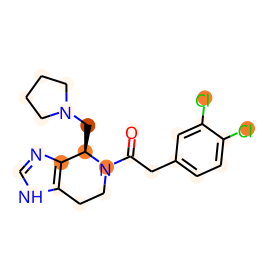

BBBP:1
prediction: [-0.5771005   0.34807736]
CC1(C)CCN(C(=O)Cc2ccc(Cl)c(Cl)c2)[C@@H](CN2CCCC2)C1


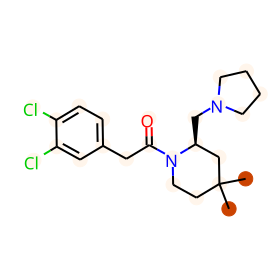

BBBP:0
prediction: [ 0.97574204 -1.364311  ]
CC(C)(C(=O)O)c1ccc(C(=O)CCCN2CCC(OC(c3ccccc3)c3ccccc3)CC2)cc1


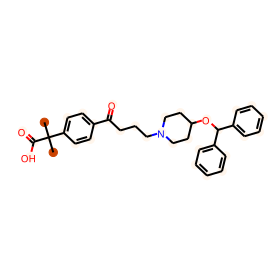

BBBP:0
prediction: [-0.22338767 -0.00826577]
O=C(O)COCCN1CCN(C(c2ccccc2)c2ccc(Cl)cc2)CC1


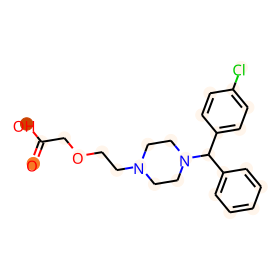

BBBP:0
prediction: [ 0.1380571  -0.31996158]
CCc1c(O)c(=O)ccn1CCO


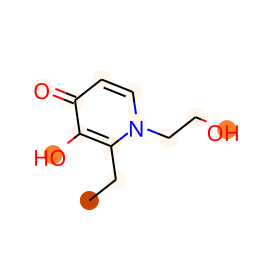

BBBP:0
prediction: [-0.18883564  0.0435712 ]
CCc1c(O)c(=O)ccn1CCCCO


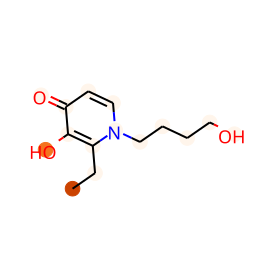

BBBP:0
prediction: [-0.08988471 -0.18982932]
COC(=O)[C@H]1[C@@H](O)CC[C@H]2CN3CCc4c([nH]c5ccccc45)[C@@H]3C[C@@H]21


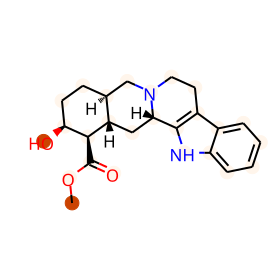

BBBP:0
prediction: [ 1.4199998 -1.8402406]
Cc1cn([C@H]2C[C@H](N=[N+]=[N-])[C@@H](CO)O2)c(=O)[nH]c1=O


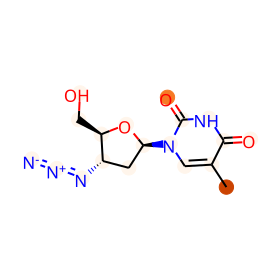

BBBP:1
prediction: [-2.974832   2.9122777]
CC(=O)c1ccc2c(c1)N(CCCN1CCN(CCO)CC1)c1ccccc1S2


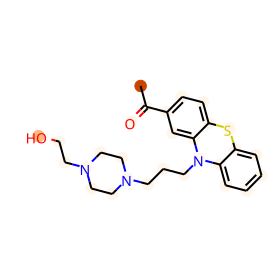

BBBP:1
prediction: [-0.26766232  0.10386714]
CC(=O)Nc1nnc(S(N)(=O)=O)s1


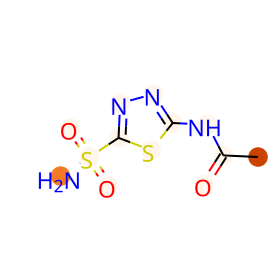

BBBP:1
prediction: [-1.6015273  1.555707 ]
C=CCC1(CC=C)C(=O)NC(=O)NC1=O


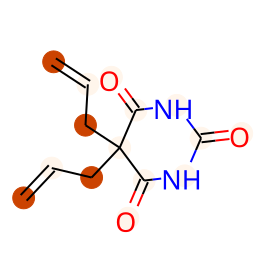

BBBP:1
prediction: [-1.7269578  1.6797892]
NC12CC3CC(CC(C3)C1)C2.[Cl-].[H+]


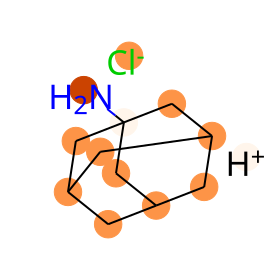

BBBP:1
prediction: [-2.6437654  2.6006577]
CN(C)CCC=C1c2ccccc2CCc2ccccc21


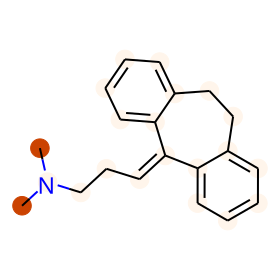

BBBP:1
prediction: [-1.3528457  1.218592 ]
CCC1(CCC(C)C)C(=O)NC(=O)NC1=O


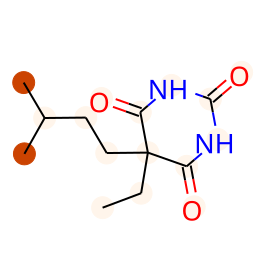

BBBP:1
prediction: [-1.5603949  1.5181291]
CC(N)Cc1ccccc1


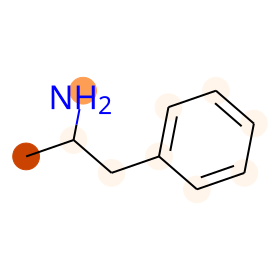

BBBP:1
prediction: [-1.1297196  1.0734749]
CCO


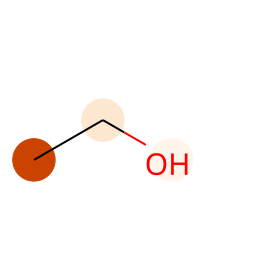

BBBP:1
prediction: [-1.5998652  1.5877942]
CCc1ccccc1


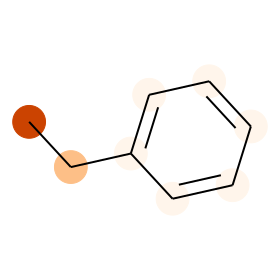

BBBP:1
prediction: [-3.304869   3.2535803]
CCOC(=O)c1ncn2c1CN(C)C(=O)c1cc(F)ccc1-2


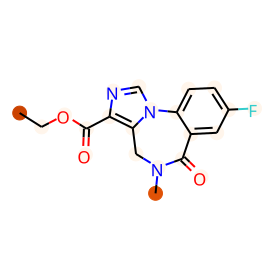

BBBP:1
prediction: [-2.5764804  2.522174 ]
CN1C(=O)CN=C(c2ccccc2F)c2cc([N+](=O)[O-])ccc21


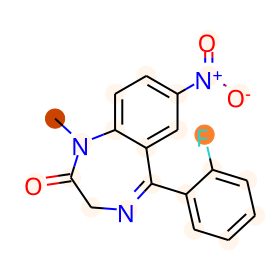

BBBP:1
prediction: [-2.537478   2.4945276]
C=COCC(F)(F)F


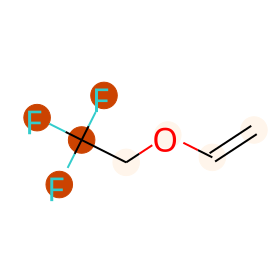

BBBP:1
prediction: [-2.7927957  2.7143574]
FC(F)(F)C(Cl)Br


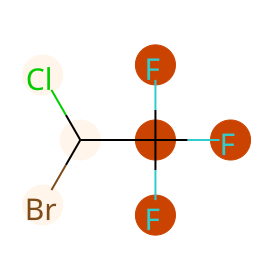

BBBP:1
prediction: [-1.5476965  1.5126119]
CCCCCCC


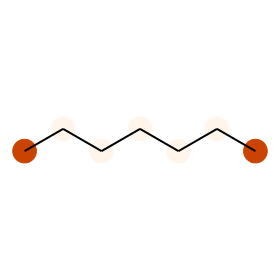

BBBP:1
prediction: [-1.4629759  1.4213226]
CCCCCC


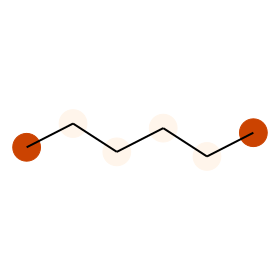

BBBP:1
prediction: [-0.6197314  0.4919689]
Cc1c(O)c(=O)ccn1C


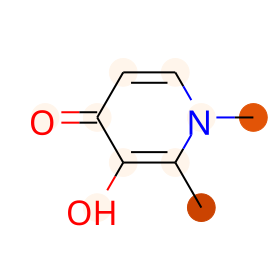

BBBP:1
prediction: [-0.6675985  0.5434642]
CCn1ccc(=O)c(O)c1C


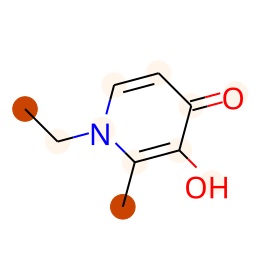

BBBP:1
prediction: [-0.72539645  0.6057198 ]
CCCCn1ccc(=O)c(O)c1C


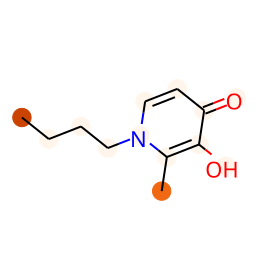

BBBP:1
prediction: [-0.74942625  0.6307287 ]
CCCCCn1ccc(=O)c(O)c1C


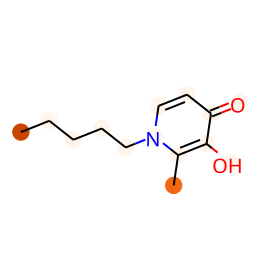

BBBP:1
prediction: [-0.74942625  0.6307287 ]
CCCCCn1ccc(=O)c(O)c1C


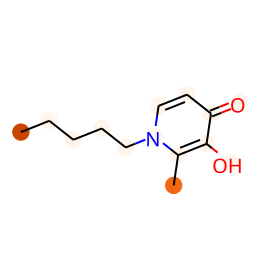

BBBP:0
prediction: [-0.08024556 -0.0793086 ]
Cc1c(O)c(=O)ccn1CCCO


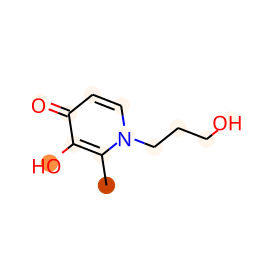

BBBP:1
prediction: [-0.6571008   0.53527343]
CCc1c(O)c(=O)ccn1CC


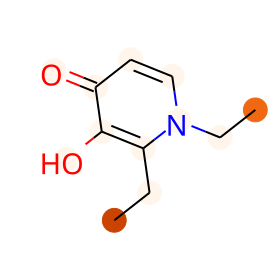

BBBP:0
prediction: [-0.2753597  -0.06766877]
CN1CCN(c2cc3c(cc2F)c(=O)c(C(=O)O)cn3-c2ccc(F)cc2)CC1


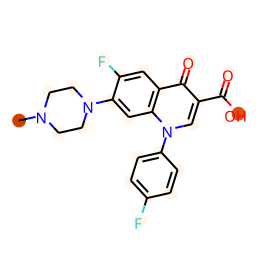

BBBP:1
prediction: [-1.799852   1.7433984]
Cc1cc(=O)n(-c2ccccc2)n1C


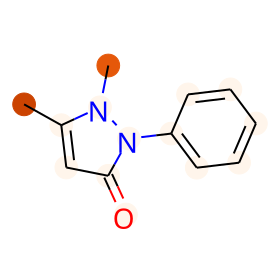

BBBP:1
prediction: [-0.7569949  0.5728587]
CN1CCc2cccc3c2[C@H]1Cc1ccc(O)c(O)c1-3


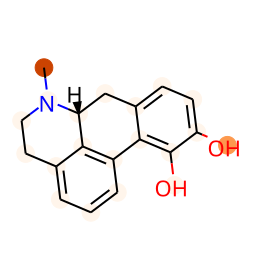

BBBP:1
prediction: [-1.9771688  1.9289958]
COC(=O)C1=CCCN(C)C1


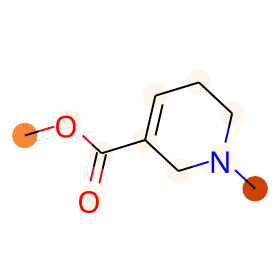

BBBP:1
prediction: [-2.4497209  2.442598 ]
O=C(CCCN1CCN(c2ccccn2)CC1)c1ccc(F)cc1


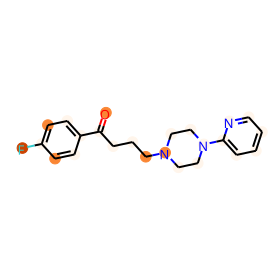

BBBP:1
prediction: [-1.3186959  1.1851711]
O=C(CCCN1CCC(n2c(=O)[nH]c3ccccc32)CC1)c1ccc(F)cc1


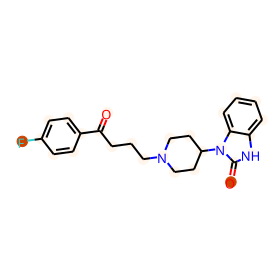

BBBP:1
prediction: [-1.2129211  1.1602458]
CCOC(=O)c1ccc(N)cc1


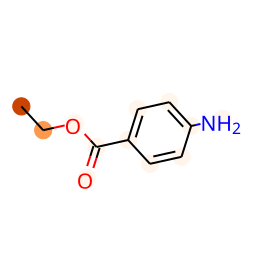

BBBP:1
prediction: [-3.080101   2.8868032]
CCN(CC)C(=O)C1CN2CCc3cc(OC)c(OC)cc3C2CC1OC(C)=O


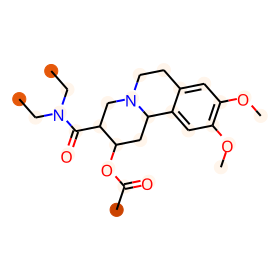

BBBP:1
prediction: [-0.01300229 -0.31692985]
CN1C2CCC1CC(OC(c1ccccc1)c1ccccc1)C2.O=S(=O)(O)O


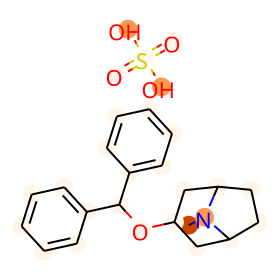

BBBP:1
prediction: [-2.1012492  2.0159705]
OC(CCN1CCCCC1)(c1ccccc1)C1CC2C=CC1C2


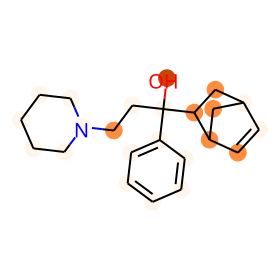

BBBP:1
prediction: [-2.285361   2.2056577]
CN1C(=O)NC(=O)C(C)(C2=CCCCC2)C1=O


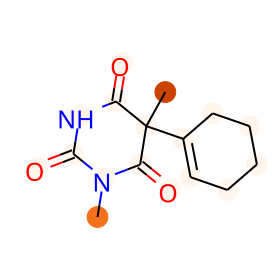

BBBP:1
prediction: [-3.3661752  3.2597842]
FC(F)OC(Cl)C(F)(F)F


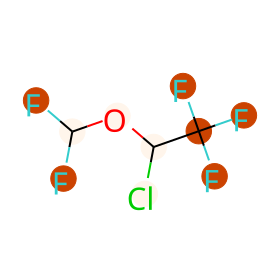

BBBP:1
prediction: [-1.2288939  1.070908 ]
C=CCC1(C(C)C#CCC)C(=O)NC(=O)N(C)C1=O


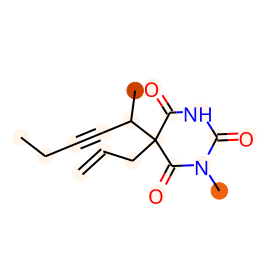

BBBP:1
prediction: [-2.6078143  2.528065 ]
COC(F)(F)C(Cl)Cl


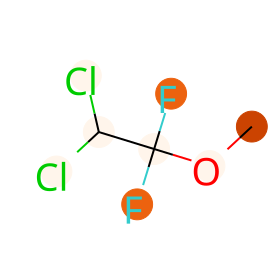

BBBP:1
prediction: [-1.2637693  1.2137074]
CC1CCCC1


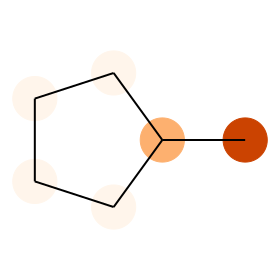

BBBP:1
prediction: [-2.679007   2.6054497]
CN(C)CCOC(C)(c1ccccc1)c1ccccn1


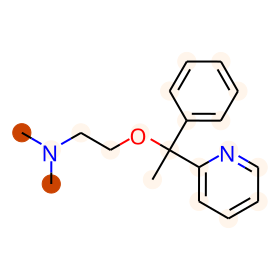

BBBP:0
prediction: [ 0.39225894 -0.6564164 ]
CN(C(=O)Cc1ccccc1N)[C@@H](CN1CC[C@@H](O)C1)c1ccccc1


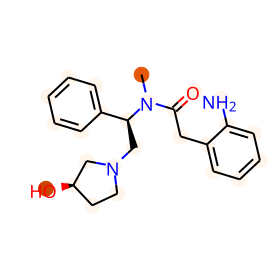

BBBP:0
prediction: [ 0.54503417 -0.86505884]
CCn1cc(C(=O)O)c(=O)c2cc(F)c(N3CCNCC3)nc21


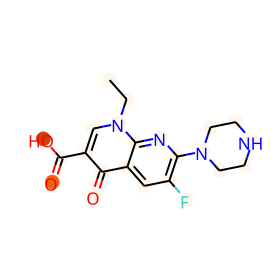

BBBP:0
prediction: [-0.50161994  0.17752072]
CN1CCN(c2c(F)cc3c(=O)c(C(=O)O)cn(CCF)c3c2F)CC1


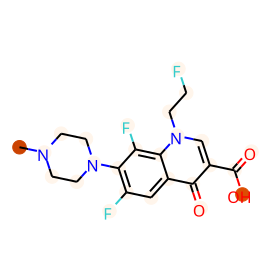

BBBP:1
prediction: [-0.16986777 -0.05302444]
CC(=O)N1CCN(C(=O)Cc2ccc(Cl)c(Cl)c2)[C@@H](CN2CCCC2)C1


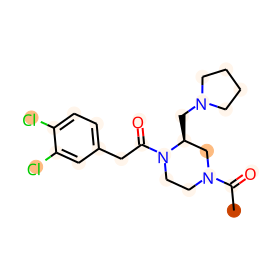

BBBP:1
prediction: [-1.7764889  1.6915917]
O=C(Cc1ccc(Cl)c(Cl)c1)N1CCc2occc2[C@H]1CN1CCCC1


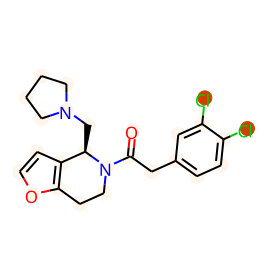

BBBP:1
prediction: [-0.09911279 -0.12866428]
COC(=O)N1CCN(C(=O)Cc2ccc(Cl)c(Cl)c2)[C@@H](CN2CCCC2)C1


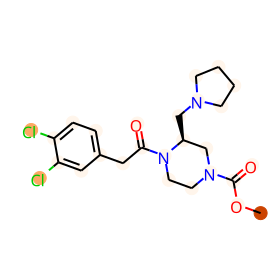

BBBP:1
prediction: [-1.9565212  1.9345417]
O=C1CN=C(c2ccccn2)c2cc(Br)ccc2N1


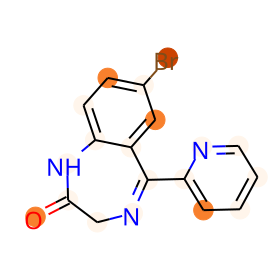

BBBP:1
prediction: [-2.2321591  2.0566103]
CC(C)(C)c1ccc(CN2CCN(C(c3ccccc3)c3ccc(Cl)cc3)CC2)cc1


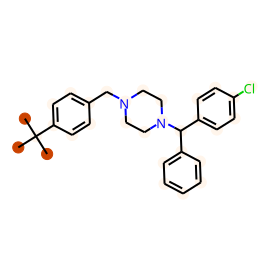

BBBP:1
prediction: [-0.70003986  0.5700017 ]
CN(C)CCc1c[nH]c2ccc(O)cc12


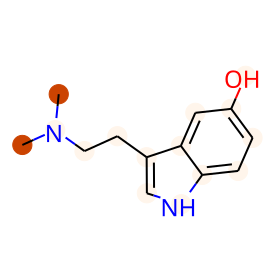

BBBP:1
prediction: [-1.3438799  1.1794615]
CC(NC(C)(C)C)C(=O)c1cccc(Cl)c1


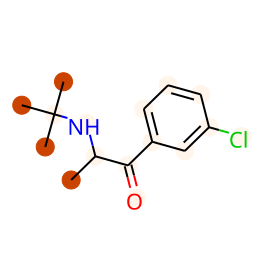

BBBP:1
prediction: [-1.1078395  1.0745351]
O=C(NCc1ccccc1)OCCO


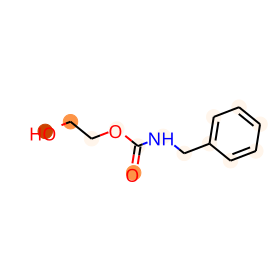

BBBP:1
prediction: [-1.3023995  1.1692797]
CCC(C)C1(CC)C(=O)NC(=O)NC1=O


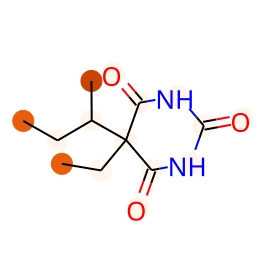

BBBP:1
prediction: [-1.7878749  1.6831526]
Cn1c(=O)c2c(ncn2C)n(C)c1=O


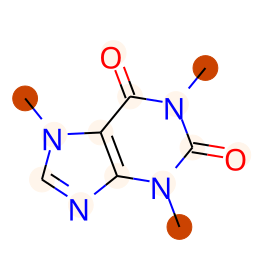

BBBP:1
prediction: [ 0.23525895 -0.5187266 ]
C=C(C)[C@@H]1CCC(C)=CC1c1c(O)cc(CCCCC)cc1O


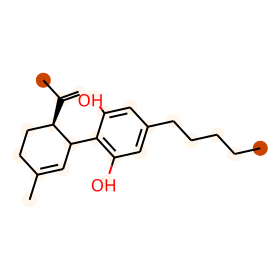

BBBP:1
prediction: [-1.4913534  1.3783875]
CCC(C)C(CC)C(=O)NC(N)=O


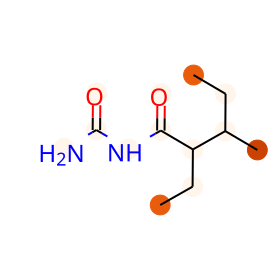

BBBP:1
prediction: [-2.6023645  2.6202147]
NC(=O)N1c2ccccc2C=Cc2ccccc21


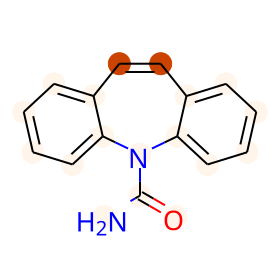

BBBP:1
prediction: [-2.593048   2.5585039]
CSc1ccc2c(c1)N(CCC1CCCNC1)c1ccccc1S2


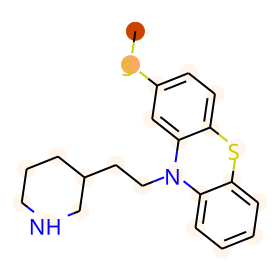

BBBP:1
prediction: [-0.8301528  0.7024781]
Cn1c(=O)[nH]c2ncn(C)c2c1=O


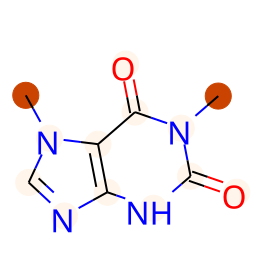

BBBP:1
prediction: [-1.3768829  1.328029 ]
CCCCC


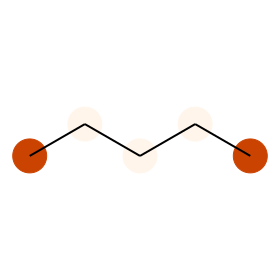

BBBP:1
prediction: [-0.79388505  0.72631615]
CCCO


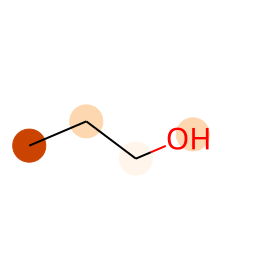

BBBP:1
prediction: [-1.3022271  1.2344285]
CC(C)=O


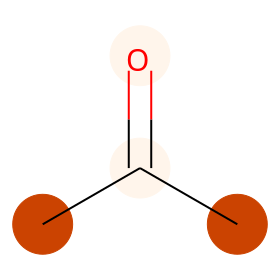

BBBP:1
prediction: [-0.12549691 -0.10600462]
CCOC(=O)N1CCN(C(=O)Cc2ccc(Cl)c(Cl)c2)[C@@H](CN2CCCC2)C1


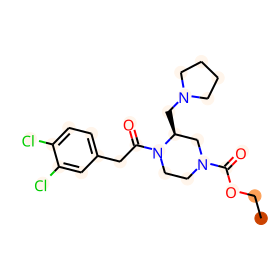

BBBP:1
prediction: [-0.10293254 -0.1359961 ]
CCCOC(=O)N1CCN(C(=O)Cc2ccc(Cl)c(Cl)c2)[C@@H](CN2CCCC2)C1


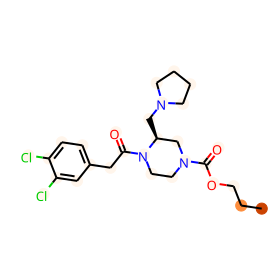

BBBP:1
prediction: [-1.2830378  1.139158 ]
O=C(Cc1ccc(Cl)c(Cl)c1)N1CCc2occc2[C@H]1CN1CC[C@@H](O)C1


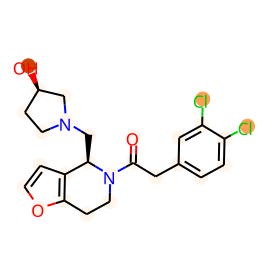

BBBP:0
prediction: [ 0.23766278 -0.51641905]
CC(=O)N1CCN(C(=O)Cc2ccc(Cl)c(Cl)c2)[C@@H](CN2CC[C@@H](O)C2)C1


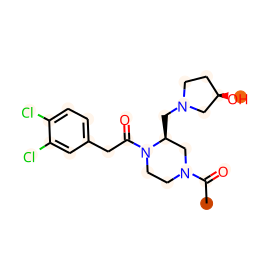

BBBP:0
prediction: [-0.25569427 -0.07473448]
CC(=O)N1CCN(C(=O)Cc2ccc(C(F)(F)F)cc2)[C@@H](CN2CC[C@@H](O)C2)C1


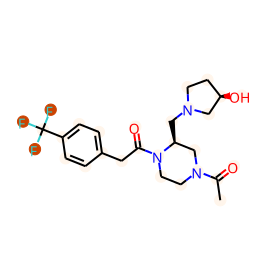

BBBP:0
prediction: [ 0.51516426 -0.8077165 ]
CSc1ccc(CC(=O)N2CCN(C(C)=O)C[C@@H]2CN2CC[C@@H](O)C2)cc1


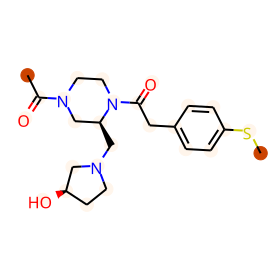

BBBP:0
prediction: [ 0.05435894 -0.33900845]
CC(=O)N1CCN(C(=O)Cc2cc(F)cc(F)c2)[C@@H](CN2CC[C@@H](O)C2)C1


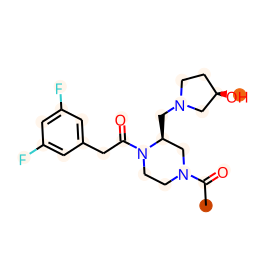

BBBP:0
prediction: [ 0.66734064 -0.9607036 ]
COc1cccc(CC(=O)N2CCN(C(C)=O)C[C@@H]2CN2CC[C@@H](O)C2)c1


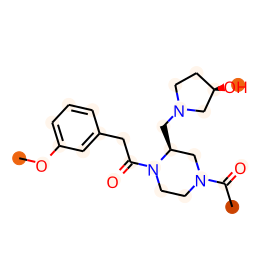

BBBP:0
prediction: [ 0.56046146 -0.8403702 ]
CC(=O)N1CCN(C(=O)Cc2ccc([N+](=O)[O-])cc2)[C@@H](CN2CC[C@H](O)C2)C1


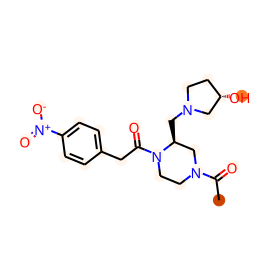

BBBP:0
prediction: [ 0.68509126 -0.9792574 ]
COc1ccc(CC(=O)N2CCN(C(C)=O)C[C@@H]2CN2CC[C@@H](O)C2)cc1


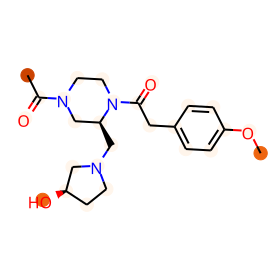

BBBP:1
prediction: [-2.5348444  2.452959 ]
CCC(=O)c1ccc2c(c1)N(CCCN1CCN(CCO)CC1)c1ccccc1S2


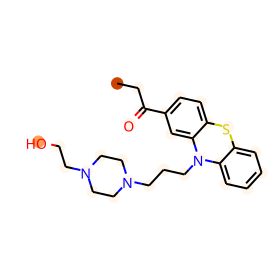

BBBP:1
prediction: [-2.335773  2.261586]
CCCCNc1c(C(=O)OCC)cnc2c1cnn2CC


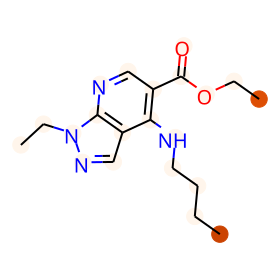

BBBP:1
prediction: [-1.8561598  1.8354892]
Nn1cnc2cc3ccccc3cc2c1=O


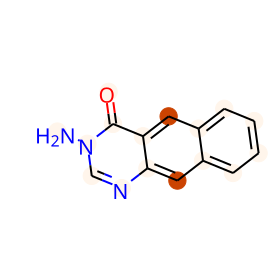

BBBP:1
prediction: [-0.90310705  0.7649496 ]
OC(O)C(Cl)(Cl)Cl


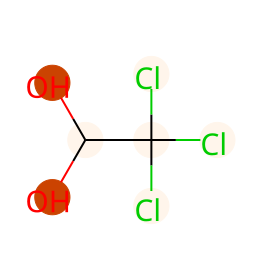

BBBP:1
prediction: [-1.1407212  1.0472646]
CN=C1CN(O)C(c2ccccc2)=c2cc(Cl)ccc2=N1


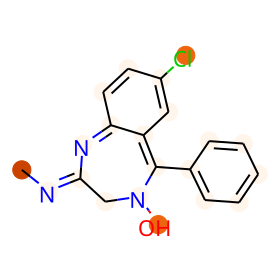

BBBP:1
prediction: [-2.6499088  2.578194 ]
CN(C)CC/C=C1/c2ccccc2Sc2ccc(Cl)cc21


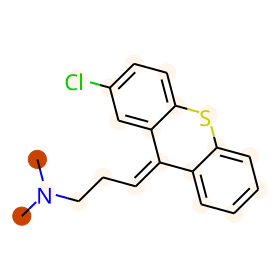

BBBP:1
prediction: [ 0.41601142 -0.7489135 ]
C[N+](C)(C)CCO


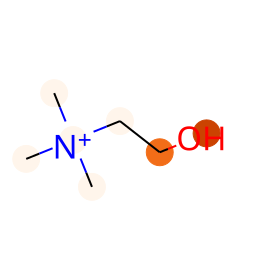

BBBP:1
prediction: [-3.0268257  2.9201224]
CN1Cc2c(C(=O)OC(C)(C)C)ncn2-c2ccsc2C1=O


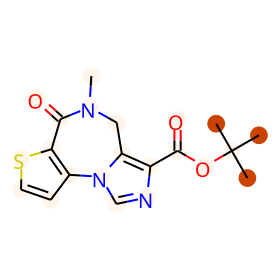

BBBP:1
prediction: [-2.049639   1.9919505]
CCCN(CCC)CCc1cccc2c1CC(=O)N2


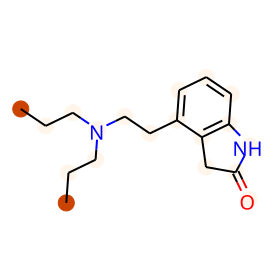

BBBP:1
prediction: [-1.0018206  0.867512 ]
CCCN(CCC)CCc1ccc(O)c2c1CC(=O)N2


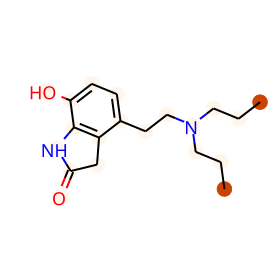

BBBP:1
prediction: [ 0.51820195 -0.7321316 ]
O=C(O)CNC(=O)c1ccccc1O


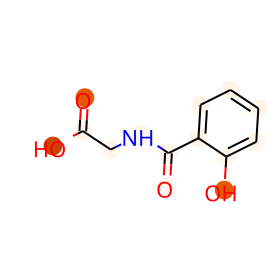

BBBP:1
prediction: [-2.8358512  2.754119 ]
FC(Br)C(F)(F)F


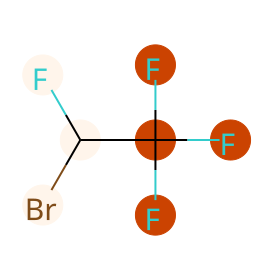

BBBP:1
prediction: [-0.5162479   0.36082405]
Cn1cnc2c1c(=O)[nH]c(=O)n2C


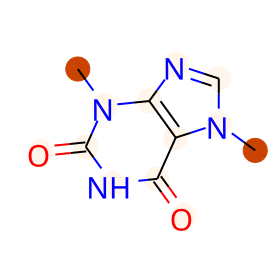

BBBP:0
prediction: [-1.5050733  1.3779942]
CCCC(C)C1(CC)C(=O)NC(=S)NC1=O


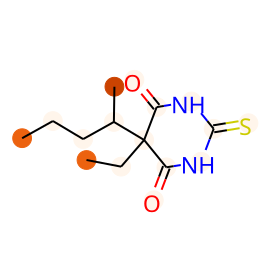

BBBP:1
prediction: [-1.514825   1.4929035]
Cc1ccccc1


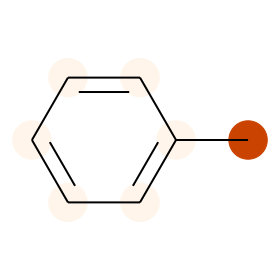

BBBP:1
prediction: [-3.0868974  3.0489533]
Cc1nnc2n1-c1ccc(Cl)cc1C(c1ccccc1Cl)=NC2


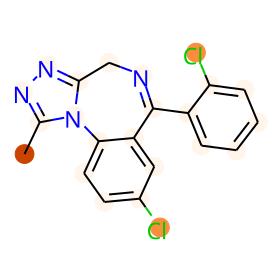

BBBP:0
prediction: [ 0.5399854 -0.8184873]
CC(=O)N1CCN(C(=O)Cc2cccc([N+](=O)[O-])c2)[C@@H](CN2CC[C@H](O)C2)C1


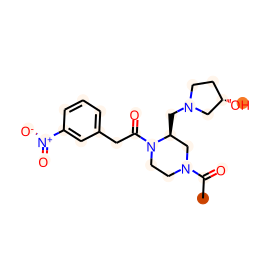

BBBP:0
prediction: [ 0.4400919 -0.6807065]
CC(=O)N1CCN(C(=O)Cc2ccccc2)[C@@H](CN2CC[C@@H](O)C2)C1


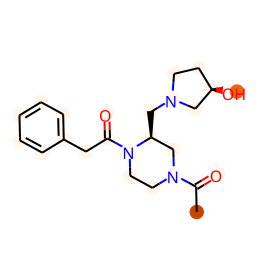

BBBP:0
prediction: [ 0.6410627 -0.9714426]
CC(=O)N1CCN(C(=O)Cc2ccc([S@@](C)=O)cc2)[C@@H](CN2CC[C@H](O)C2)C1


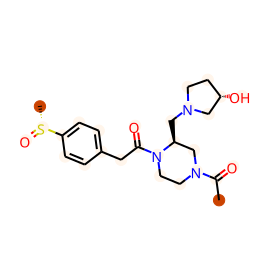

BBBP:0
prediction: [ 0.4224636 -0.7365603]
CC(=O)N1CCN(C(=O)Cc2ccc(S(C)(=O)=O)cc2)[C@@H](CN2CC[C@H](O)C2)C1


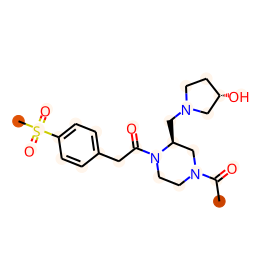

BBBP:1
prediction: [-1.9353123  1.762572 ]
CC(C)[C@@H](CN1CCCC1)N(C)C(=O)Cc1ccc(Cl)c(Cl)c1


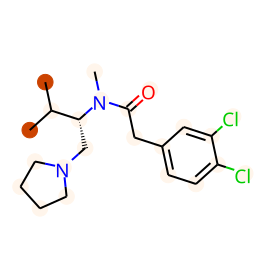

BBBP:1
prediction: [-0.42501396  0.21330568]
CN(C(=O)Cc1ccc(Cl)c(Cl)c1)[C@@H](CN1CCCC1)c1ccccc1


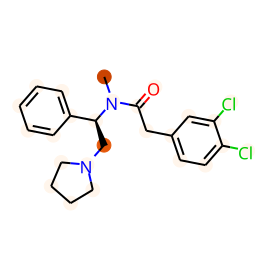

BBBP:0
prediction: [ 0.3614058  -0.74290335]
CCn1cc(C(=O)O)c(=O)c2cc(F)c(N3CCNC(C)C3)c(F)c21


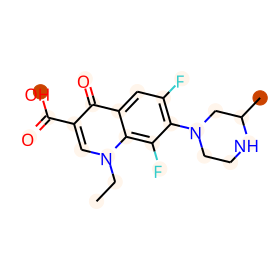

BBBP:0
prediction: [-1.5072452  1.3315245]
CN(C)C(=O)C(CCN1CCC(O)(c2ccc(Cl)cc2)CC1)(c1ccccc1)c1ccccc1


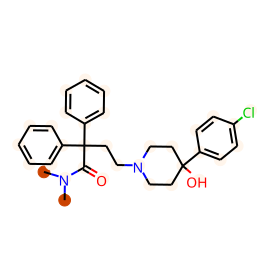

BBBP:1
prediction: [-2.7744179  2.7144425]
CN(C)CCCN1c2ccccc2CCc2ccc(Cl)cc21


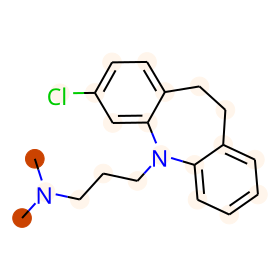

BBBP:1
prediction: [-1.535862   1.4678602]
O=C1CN=C(c2ccccc2Cl)c2cc([N+](=O)[O-])ccc2N1


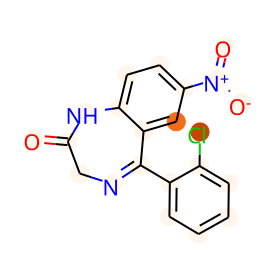

BBBP:1
prediction: [-2.7614646  2.7202978]
OCCN1CCN(CC/C=C2/c3ccccc3Sc3ccc(Cl)cc32)CC1


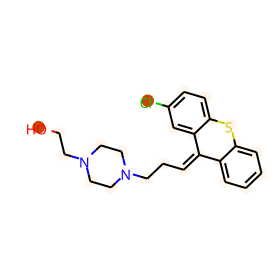

BBBP:1
prediction: [-3.565923   3.4634392]
COc1ccc2c3c1O[C@H]1[C@@H](O)C=C[C@H]4[C@@H](C2)N(C)CC[C@]314


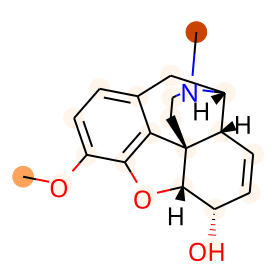

BBBP:1
prediction: [-1.7752334  1.6212755]
CC1C2Cc3ccc(O)cc3C1(C)CCN2CC1CC1


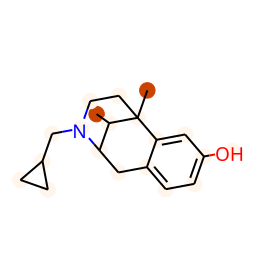

BBBP:1
prediction: [-4.679659  4.59149 ]
FC(F)(F)c1ccc2c(c1)N(CCCN1CCN(C3CC3)CC1)c1ccccc1S2


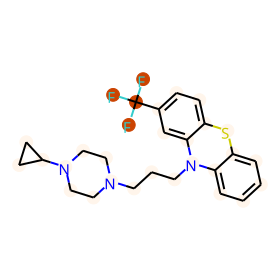

BBBP:1
prediction: [-1.0646567   0.98205507]
CN(C)CCO


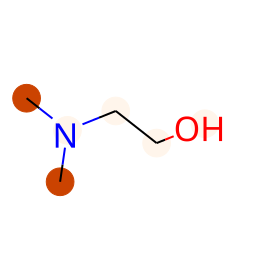

BBBP:1
prediction: [-1.833132   1.7904389]
ClC=C(Cl)Cl


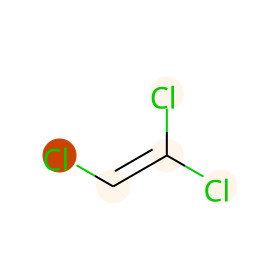

BBBP:1
prediction: [-1.6605804  1.6011043]
ClC(Cl)Cl


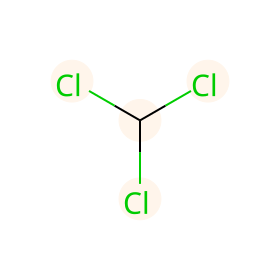

BBBP:1
prediction: [-1.3030425  1.2794163]
CNCCc1ccccn1


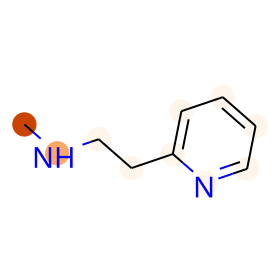

BBBP:1
prediction: [-1.7390083  1.7005937]
CN(C)CCc1ccccn1


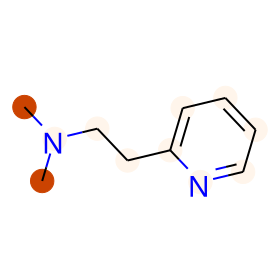

BBBP:1
prediction: [-0.5427633   0.47267678]
NCCc1nccs1


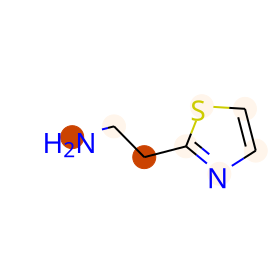

BBBP:0
prediction: [-0.879714    0.82617426]
NCCc1nc(-c2ccccc2)cs1


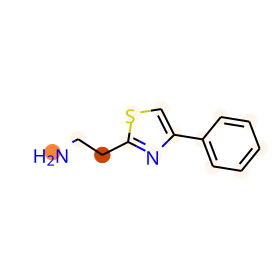

BBBP:1
prediction: [-1.5874825  1.5414727]
Cc1cccc(C)c1


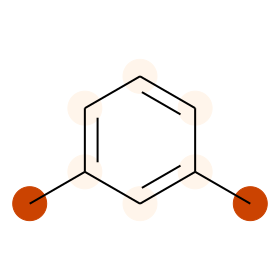

BBBP:0
prediction: [-2.8966956  2.8767722]
CCOC(=O)N1CCC(=C2c3ccc(Cl)cc3CCc3cccnc32)CC1


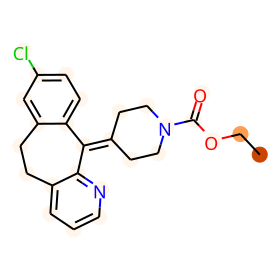

BBBP:1
prediction: [-2.736732  2.641093]
C=CCN1CC[C@]23c4c5ccc(O)c4O[C@H]2[C@@H](O)C=C[C@H]3[C@H]1C5


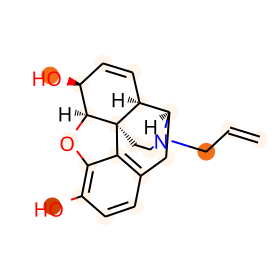

BBBP:1
prediction: [-2.2982974  2.1900127]
O=C1CC[C@@]2(O)[C@H]3Cc4ccc(O)c5c4[C@@]2(CCN3CC2CC2)[C@H]1O5


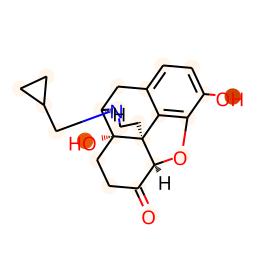

BBBP:0
prediction: [ 0.64446867 -0.96616405]
CCn1cc(C(=O)O)c(=O)c2cc(F)c(N3CCNCC3)cc21


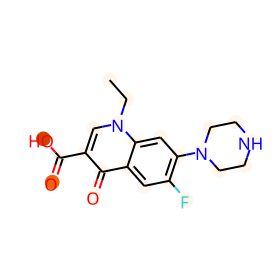

BBBP:0
prediction: [-0.03279548 -0.28599042]
CCn1cc(C(=O)O)c(=O)c2cc(F)c(N3CCN(C)CC3)cc21


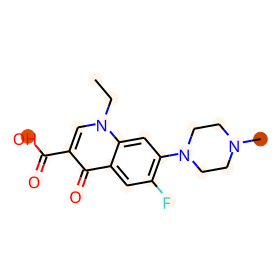

BBBP:0
prediction: [ 0.09545446 -0.31175968]
CN1/C(=C(/O)Nc2ccccn2)C(=O)c2ccccc2S1(=O)=O


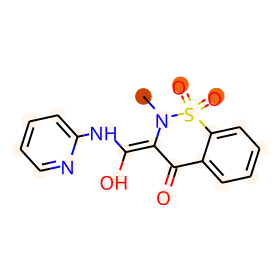

BBBP:1
prediction: [-0.72094417  0.51861095]
CS(=O)(=O)O.Oc1ccc2[nH]cc(CCCCN3CC=C(c4ccccc4)CC3)c2c1


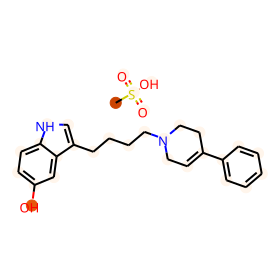

BBBP:1
prediction: [-2.2101564  1.8711815]
COC(=O)[C@H]1[C@H]2C[C@@H]3c4[nH]c5ccccc5c4CCN3C[C@H]2C[C@@H](OC(=O)c2cc(OC)c(OC)c(OC)c2)[C@@H]1OC


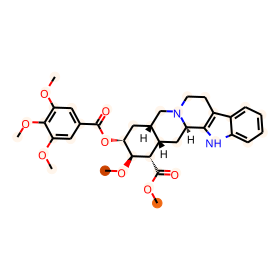

BBBP:1
prediction: [-2.6744723  2.6905375]
CNCCCN1c2ccccc2CCc2ccccc21


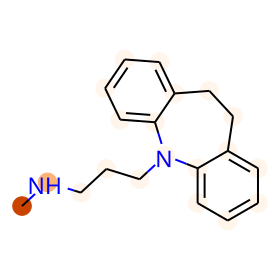

BBBP:1
prediction: [-2.603218   2.5841296]
CN1C(=O)CN=C(c2ccccc2)c2cc(Cl)ccc21


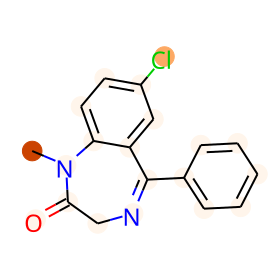

BBBP:1
prediction: [-3.3987784  3.301296 ]
COc1ccc2c3c1O[C@H]1[C@@H](O)CC[C@H]4[C@@H](C2)N(C)CC[C@]314


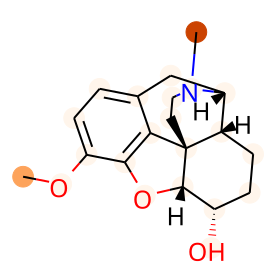

BBBP:1
prediction: [-2.1453679  1.9999764]
CN1CCC23c4c5ccc(O)c4OC2C(O)CCC3C1C5


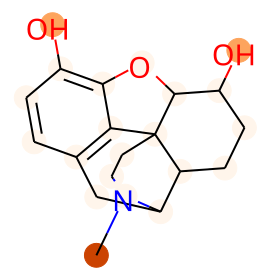

BBBP:1
prediction: [-1.5201904  1.4888421]
O=C1NC(=O)C(c2ccccc2)(c2ccccc2)N1


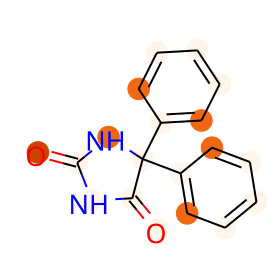

BBBP:1
prediction: [-2.7991786  2.7223308]
CC(CN1CCN(CCOCCO)CC1)CN1c2ccccc2Sc2ccccc21


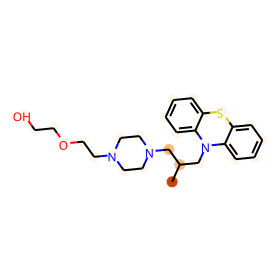

BBBP:1
prediction: [-1.9914235  1.9550868]
COC(=O)c1ccc(C(=O)OC)cc1


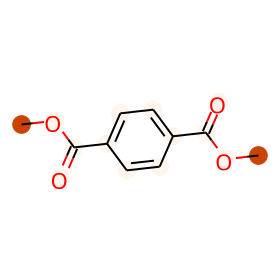

BBBP:1
prediction: [-1.7273291  1.690964 ]
Cc1ccccc1C


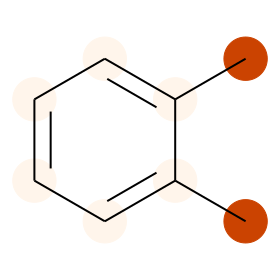

BBBP:1
prediction: [-1.5937334  1.5484715]
Cc1ccc(C)cc1


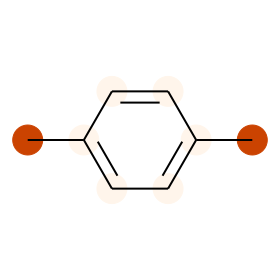

BBBP:1
prediction: [-1.1937492  1.1049843]
CC(C)O


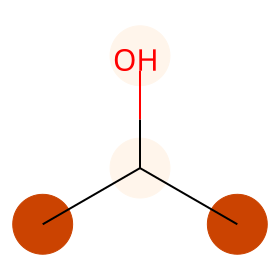

BBBP:1
prediction: [-2.8119683  2.8043952]
NC(=O)N1c2ccccc2C2OC2c2ccccc21


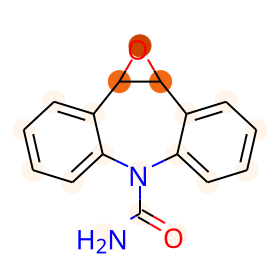

BBBP:1
prediction: [-2.0283031  1.9307781]
CC[C@H](NC(=O)c1c(C)c(-c2ccccc2)nc2ccccc12)c1ccccc1


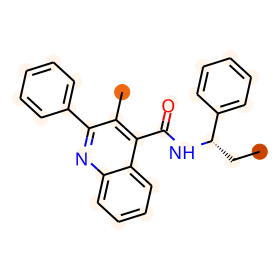

BBBP:1
prediction: [-1.556686   1.4224379]
CC(C)(C)OC(=O)CCCc1ccc(N(CCCl)CCCl)cc1


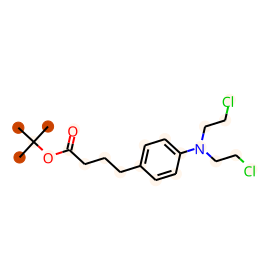

BBBP:0
prediction: [ 0.8501765 -1.2168176]
CC(C)Nc1cccnc1N1CCN(C(=O)c2cc3cc(NS(C)(=O)=O)ccc3[nH]2)CC1


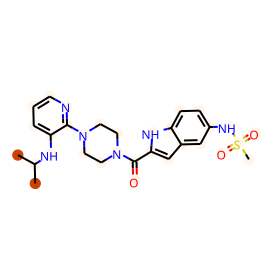

BBBP:0
prediction: [-0.07480753 -0.2197411 ]
CC(C)(C)c1ccc(C(=O)CCCN2CCC(OC(c3ccccc3)c3ccccc3)CC2)cc1


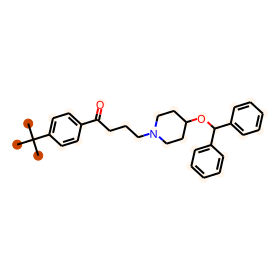

BBBP:1
prediction: [-3.1940174  3.1484382]
CN1CCN(CC(=O)N2c3ccccc3C(=O)Nc3cccnc32)CC1


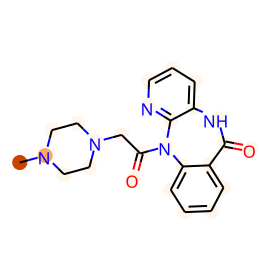

BBBP:1
prediction: [-2.6379437  2.5266519]
CCCNC(=O)c1ccc2c(c1)N([C@@H](C)CN1CCCC1)c1ccccc1S2


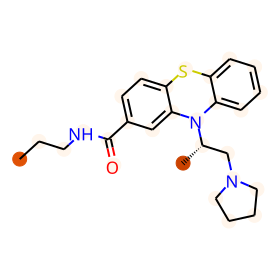

BBBP:0
prediction: [-0.2543026  -0.04095589]
CN1CCN(c2c(F)cc3c(=O)c(C(=O)O)cn4c3c2SCC4)CC1


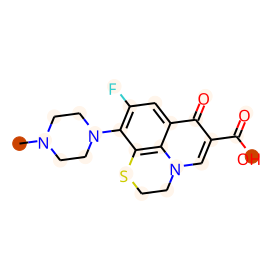

BBBP:0
prediction: [ 1.3659637 -1.8047056]
CC(C)(C)NCC(O)c1ccc(O)c(CO)c1


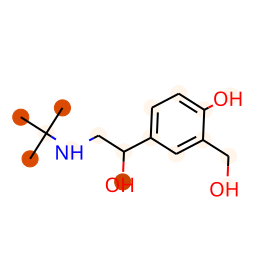

BBBP:1
prediction: [-0.91947633  0.7401478 ]
CN1CCN(C(=O)Cc2ccc(Cl)c(Cl)c2)[C@@H](CN2CCCC2)C1


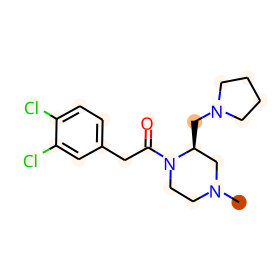

BBBP:1
prediction: [-0.32505983  0.12383305]
O=C(Cc1ccc(Cl)c(Cl)c1)N1CCn2ccnc2[C@H]1CN1CCCC1


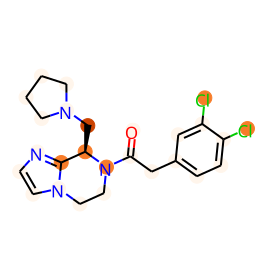

BBBP:0
prediction: [ 1.011281  -1.3448524]
O=C1NC(=O)[C@@]2(CCN(C(=O)Cc3ccc(Cl)c(Cl)c3)[C@@H](CN3CCCC3)C2)N1


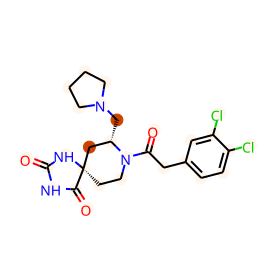

BBBP:0
prediction: [ 0.07516672 -0.33391967]
O=C(Cc1ccc(Cl)c(Cl)c1)N1CCn2ccnc2[C@H]1CN1CC[C@@H](O)C1


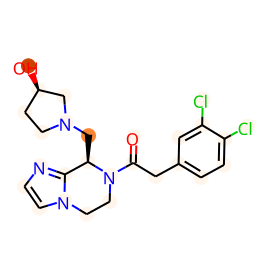

BBBP:1
prediction: [-0.30874187  0.10619981]
O=C(Cc1ccc(Cl)c(Cl)c1)N1CCn2ncnc2[C@H]1CN1CCCC1


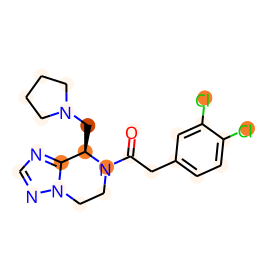

BBBP:0
prediction: [-0.0708392  -0.18532595]
O=C(Cc1ccc(Cl)c(Cl)c1)N1CCN(CCO)C[C@@H]1CN1CC[C@@H](O)C1


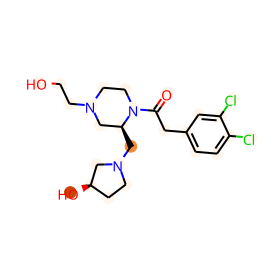

BBBP:1
prediction: [-2.577249  2.51979 ]
CN(C)CC/C=C1/c2ccccc2COc2ccccc21.[Cl-].[H+]


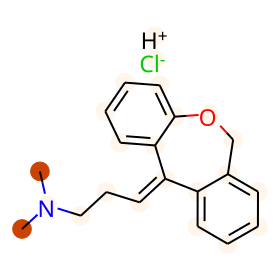

BBBP:1
prediction: [ 1.0002605 -1.4949772]
CN(C)CCOC(C)(c1ccccc1)c1ccccn1.O=C(O)CCC(=O)O


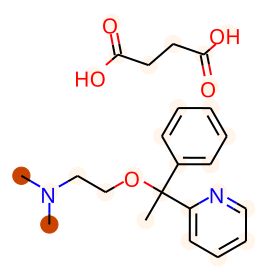

BBBP:1
prediction: [-1.4143897  1.3430464]
C/C=C(\CC)C(=O)NC(N)=O


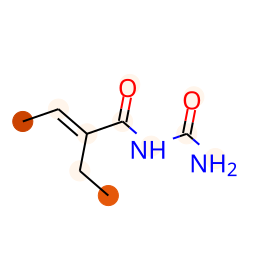

BBBP:1
prediction: [-1.6257805  1.5499027]
CCC(C)(CC)OC(N)=O


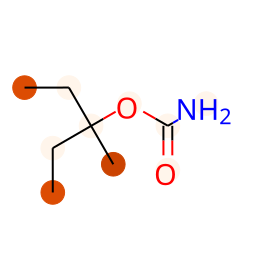

BBBP:1
prediction: [-2.4151134  2.4103923]
Clc1ccc2c(c1)C(c1ccccc1)=NCc1nncn1-2


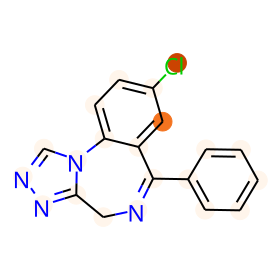

BBBP:1
prediction: [-2.1856217  2.1263664]
CCc1ccccc1-n1c(C)nc2ccccc2c1=O


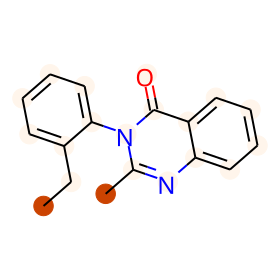

BBBP:1
prediction: [-2.670938   2.5815203]
CCOC(=O)c1cnc2c(cnn2CC)c1NN=C(C)C


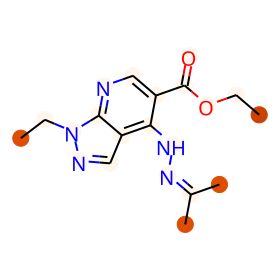

BBBP:1
prediction: [-1.5151399  1.445281 ]
C#CC(O)(/C=C/Cl)CC


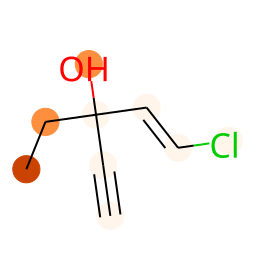

BBBP:1
prediction: [-1.3030425  1.2794163]
CNCCc1ccccn1


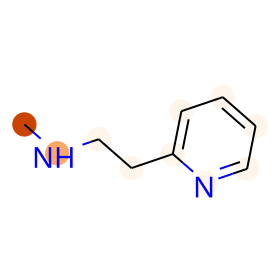

BBBP:1
prediction: [-1.7390083  1.7005937]
CN(C)CCc1ccccn1


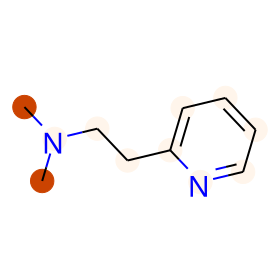

BBBP:1
prediction: [-0.5427633   0.47267678]
NCCc1nccs1


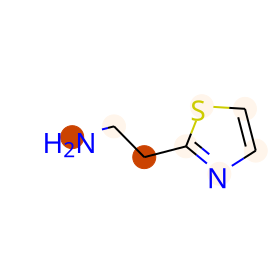

BBBP:1
prediction: [-0.9561422  0.8874975]
S=C(NC1CCCCC1)N1CCC(c2c[nH]cn2)CC1


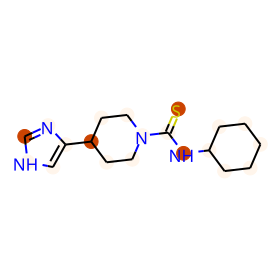

BBBP:0
prediction: [ 0.56546795 -0.8514161 ]
O=C(Cc1ccc(Cl)c(Cl)c1)N1CCc2[nH]cnc2[C@H]1CN1CC[C@@H](O)C1


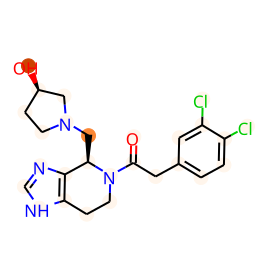

BBBP:1
prediction: [-0.7365465  0.5757427]
CC[C@H](NC(=O)c1c(O)c(-c2ccccc2)nc2ccccc12)c1ccccc1


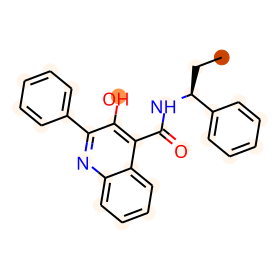

BBBP:1
prediction: [-1.7488071  1.5588121]
CC[C@H](NC(=O)c1c(OCCCN(C)C)c(-c2ccccc2)nc2ccccc12)c1ccccc1


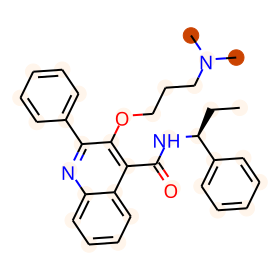

BBBP:0
prediction: [ 0.46708983 -0.7646672 ]
CC[C@H](NC(=O)c1c(OCC(=O)O)c(-c2ccccc2)nc2ccccc12)c1ccccc1


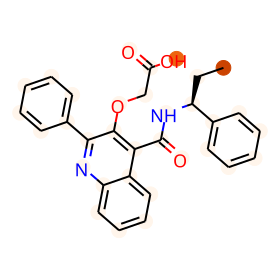

BBBP:0
prediction: [ 0.40801948 -0.7142185 ]
CC[C@H](NC(=O)c1c(OCCCC(=O)O)c(-c2ccccc2)nc2ccccc12)c1ccccc1


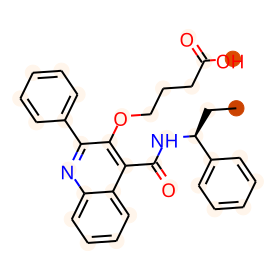

BBBP:0
prediction: [ 1.098772  -1.5131518]
CC[C@H](NC(=O)c1c(OCCNC(=O)Cc2ccccc2C(=O)O)c(-c2ccccc2)nc2ccccc12)c1ccccc1


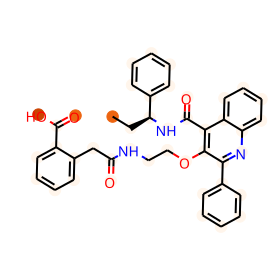

BBBP:0
prediction: [-0.4304698   0.21777973]
CC[C@H](NC(=O)c1c(OCCNC(=O)Cc2ccccn2)c(-c2ccccc2)nc2ccccc12)c1ccccc1


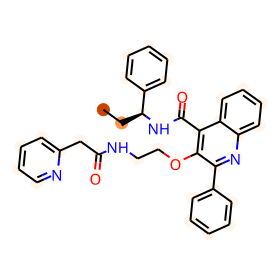

BBBP:0
prediction: [-0.51258886  0.29640478]
CC[C@H](NC(=O)c1c(OCCNC(=O)[C@@H]2CCCN2)c(-c2ccccc2)nc2ccccc12)c1ccccc1


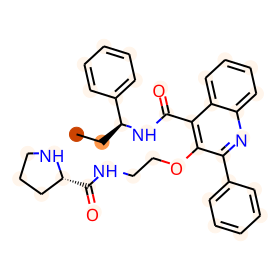

BBBP:0
prediction: [-0.02904506 -0.18182012]
CC[C@H](NC(=O)c1c(Cn2ccnc2)c(-c2ccccc2)nc2ccccc12)c1ccccc1


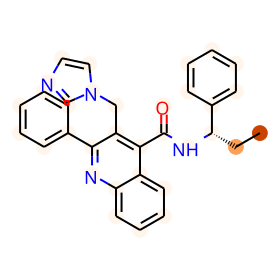

BBBP:1
prediction: [-1.5345622  1.4609022]
CCC1(C)CC(=O)NC1=O


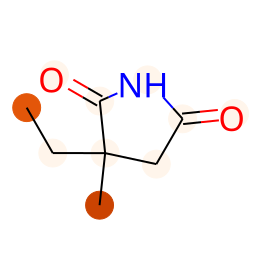

BBBP:1
prediction: [-3.9549093  3.846851 ]
OCCN1CCN(CC/C=C2/c3ccccc3Sc3ccc(C(F)(F)F)cc32)CC1


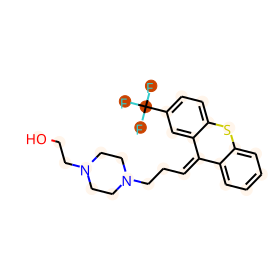

BBBP:1
prediction: [-4.102932  4.003986]
OCCN1CCN(CCCN2c3ccccc3Sc3ccc(C(F)(F)F)cc32)CC1


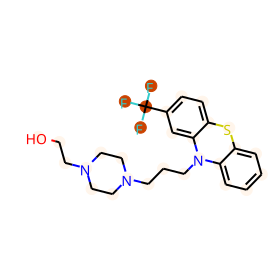

BBBP:1
prediction: [-3.2616143  3.167975 ]
CCN(CC)CCN1C(=O)CN=C(c2ccccc2F)c2cc(Cl)ccc21


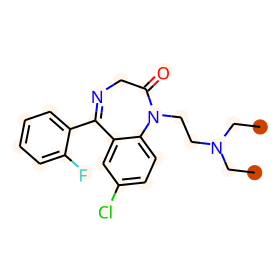

BBBP:1
prediction: [-1.9129043  1.774931 ]
COc1cc2c3c(c1O)C1(C=CC(=O)C=C1)CC3N(C)CC2


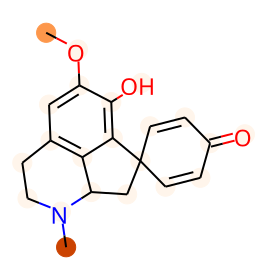

BBBP:1
prediction: [-1.9331381  1.9025494]
CCC1(c2ccccc2)CCC(=O)NC1=O


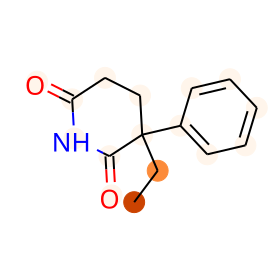

BBBP:1
prediction: [ 0.38399017 -0.55747736]
O=[N+]([O-])c1cc[nH]c1NCCSCc1ccccn1


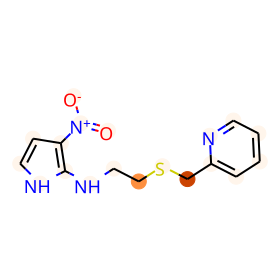

BBBP:1
prediction: [-1.2620369  0.9600555]
Cc1cc(C(C)(C)SC(C)(C)CNc2[nH]ccc2[N+](=O)[O-])nc(C)c1C


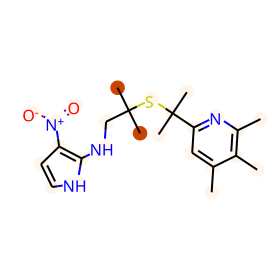

BBBP:1
prediction: [-2.5982199  2.2408984]
C[NH+]O.Cc1oc(C(C)(C)N(C(C)(C)N)C(C)(C)N)c(C)c1C.[OH-]


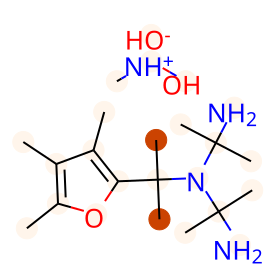

BBBP:1
prediction: [-0.95939225  0.83214366]
CCNCc1c(CSC)cnc(C)c1O


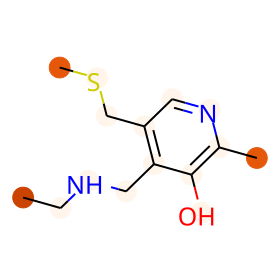

BBBP:0
prediction: [-0.00331593 -0.206375  ]
CN1/C(=C(\O)Nc2ccccn2)C(=O)c2sccc2S1(=O)=O


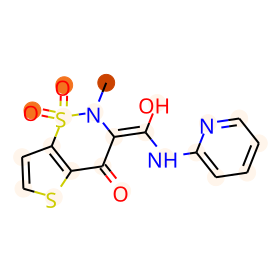

BBBP:0
prediction: [ 1.1793014 -1.6298406]
CC(C)(C)c1ccc(C(O)CCCN2CCC(C(O)(c3ccccc3)c3ccccc3)CC2)cc1


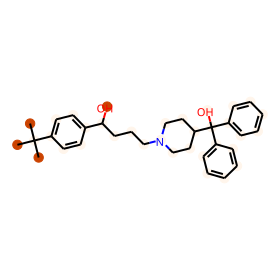

BBBP:1
prediction: [-2.398398   2.2925723]
CN(C(=O)Cc1ccc(Cl)c(Cl)c1)C1CCCC[C@H]1N1CCCC1


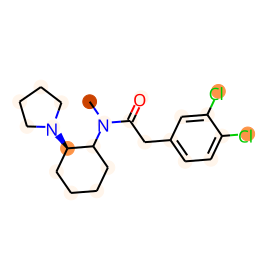

BBBP:1
prediction: [-3.7801762  3.6344783]
CC(=O)Oc1ccc2c3c1O[C@H]1[C@@H](OC(C)=O)C=C[C@H]4[C@@H](C2)N(C)CC[C@]314


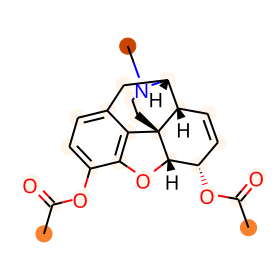

BBBP:1
prediction: [-4.003025   3.8653214]
OCCN1CCCN(CCCN2c3ccccc3Sc3cc(C(F)(F)F)ccc32)CC1.[Cl-].[Cl-].[H+].[H+]


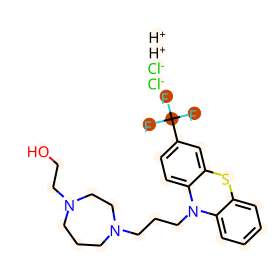

BBBP:1
prediction: [-3.6574855  3.586242 ]
COc1ccc2c3c1O[C@H]1C(=O)CC[C@H]4[C@@H](C2)N(C)CC[C@]314


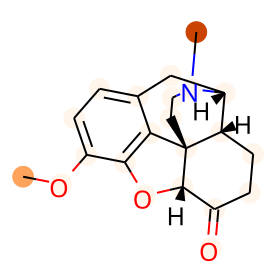

BBBP:1
prediction: [-1.2635084  1.1947938]
CCC(O)(COC(N)=O)c1ccccc1


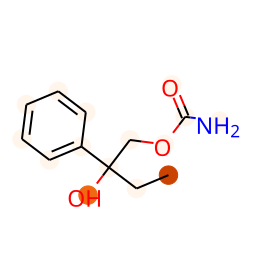

BBBP:1
prediction: [-1.9540619  1.8924749]
OCCOCCN1CCN(C(c2ccccc2)c2ccc(Cl)cc2)CC1


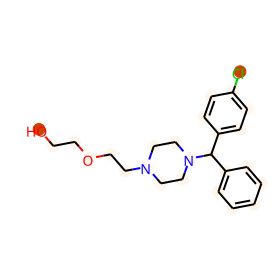

BBBP:1
prediction: [-2.7930462  2.7601564]
CN(C)CCCN1c2ccccc2CCc2ccccc21


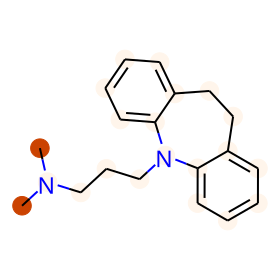

BBBP:1
prediction: [-2.4357     2.4088535]
CNC1(c2ccccc2Cl)CCCCC1=O


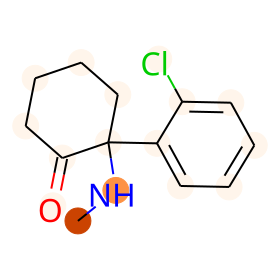

BBBP:1
prediction: [ 0.552899  -0.8045441]
O=C(O)c1cc(=O)c2ccccc2[nH]1


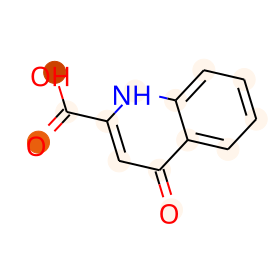

BBBP:1
prediction: [-1.8247463  1.7713941]
CC(=O)NCCCOc1cccc(CN2CCCCC2)c1


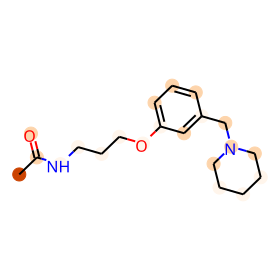

BBBP:1
prediction: [-1.9811305  1.9535365]
O=C(NCCCOc1cccc(CN2CCCCC2)c1)c1ccccc1


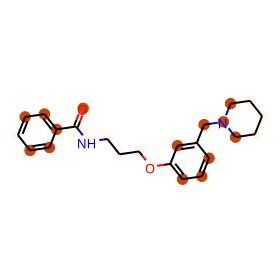

BBBP:1
prediction: [-1.1451471  1.0889192]
OCCCOc1cccc(CN2CCCCC2)c1


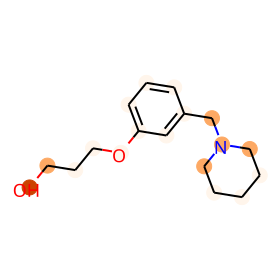

BBBP:1
prediction: [-1.2652918  1.2120924]
c1ccc(NCCCOc2cccc(CN3CCCCC3)c2)nc1


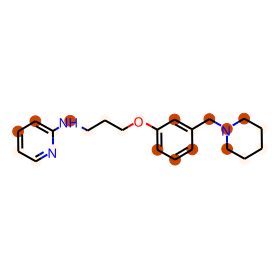

BBBP:1
prediction: [-1.2612988  1.2049987]
c1cc(CN2CCCCC2)cc(OCCCNc2nccs2)c1


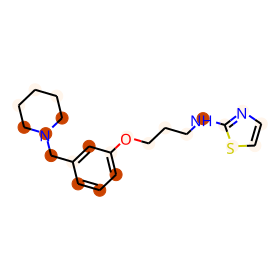

BBBP:1
prediction: [-1.4635736  1.3981634]
c1cc(CN2CCCCC2)cc(OCCCNc2nc3ccccc3o2)c1


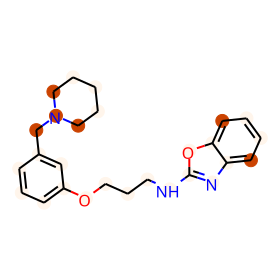

BBBP:0
prediction: [ 0.8473479 -1.178009 ]
Cc1ccc(CC2=CNC(NCCSCc3ccc(CN(C)C)o3)=NC2)cn1


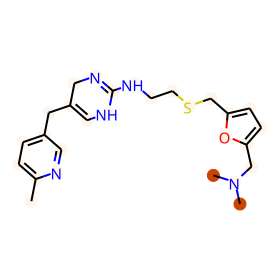

BBBP:0
prediction: [ 0.2584476  -0.45759144]
CN(C)c1cc(-c2n[nH]c(N)n2)ccn1


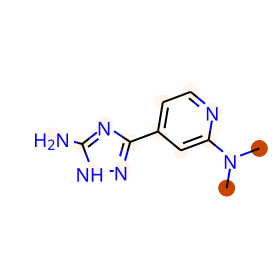

BBBP:1
prediction: [-0.95787    0.8470333]
Cn1c(=O)c2nc[nH]c2n(C)c1=O


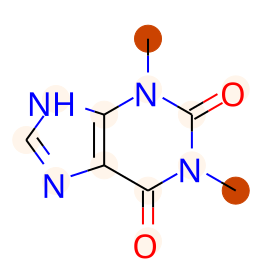

BBBP:1
prediction: [-2.0982115  2.0100782]
O=C(CCCN1CCC(C(=O)c2ccc(F)cc2)CC1)c1ccc(F)cc1


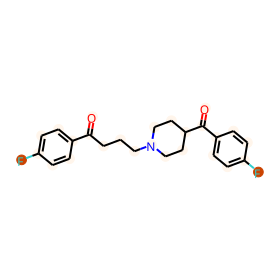

BBBP:1
prediction: [-2.266412  2.17182 ]
CCN(CC)CC(=O)Nc1c(C)cccc1C


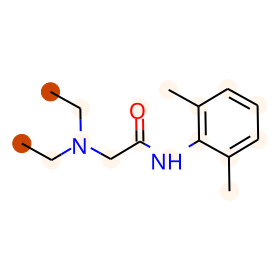

BBBP:1
prediction: [-2.3061614  2.251641 ]
O=C1Nc2ccc(Cl)cc2C(c2ccccc2Cl)=NC1O


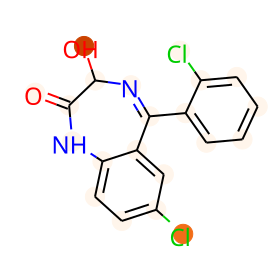

BBBP:1
prediction: [-1.892433   1.8200651]
CN(C)CCOC(=O)COc1ccc(Cl)cc1


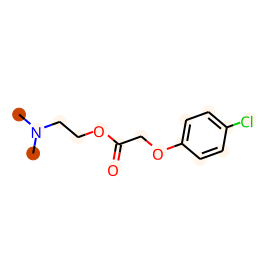

BBBP:1
prediction: [-2.2869594  2.2444963]
Cc1nc2ccccc2c(=O)n1-c1ccccc1Cl


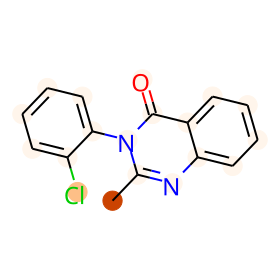

BBBP:1
prediction: [-2.3235683  2.3069246]
CN1CCN=C(c2ccccc2)c2cc(Cl)ccc21


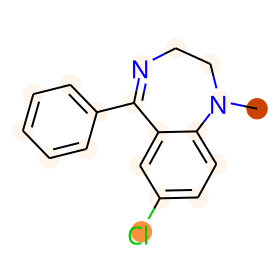

BBBP:1
prediction: [-2.0115108  1.9614536]
CCCC(C)(COC(N)=O)COC(N)=O


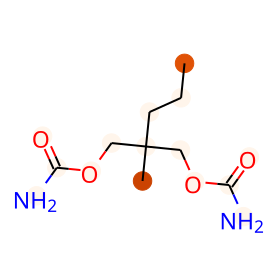

BBBP:1
prediction: [-1.6128582  1.5657576]
NCCn1ncc2cc(Cl)c(Cl)cc21


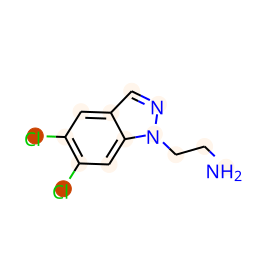

BBBP:1
prediction: [-0.8173942   0.65594506]
Nc1nc(NC2CC2)c2ncn([C@H]3C=C[C@@H](CO)C3)c2n1


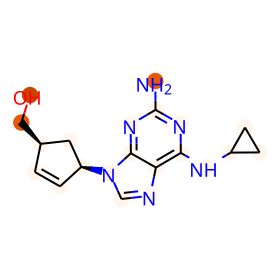

BBBP:1
prediction: [-0.00345742 -0.30364513]
CCCC(=O)Nc1ccc(OCC(O)CNC(C)C)c(C(C)=O)c1


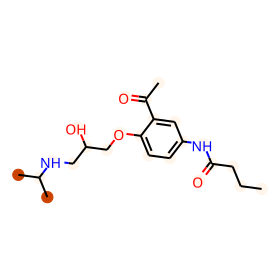

BBBP:1
prediction: [-0.0535439  -0.10072056]
Nc1nc(=O)c2ncn(COCCO)c2[nH]1


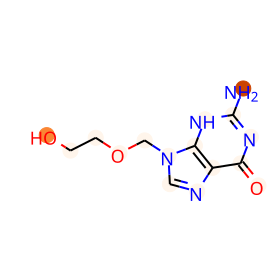

BBBP:1
prediction: [-0.84435654  0.7304321 ]
CCCSc1ccc2nc(NC(=O)OC)[nH]c2c1


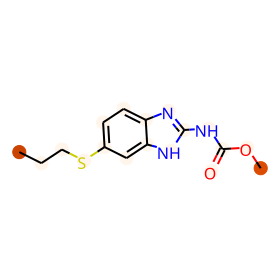

BBBP:0
prediction: [ 0.07759519 -0.20978397]
NCCCNCCSP(=O)(O)O


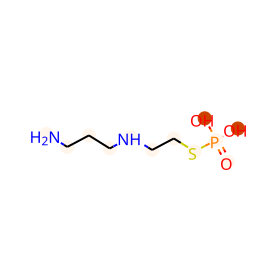

BBBP:1
prediction: [-0.70731455  0.57353544]
COc1cc(CCN)cc(OC)c1OC


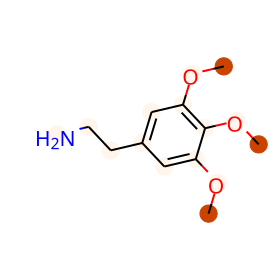

BBBP:1
prediction: [-1.3481003  1.2872299]
CN[C@@H](C)Cc1ccccc1


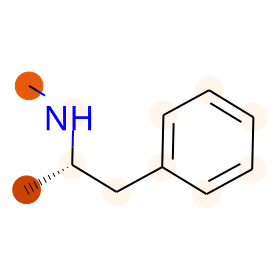

BBBP:1
prediction: [-2.176262   2.1164458]
Cc1ccccc1-n1c(C)nc2ccccc2c1=O


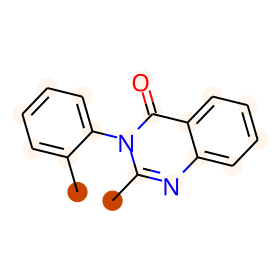

BBBP:1
prediction: [-0.8017705  0.6856644]
COc1ccccc1OCC(O)COC(N)=O


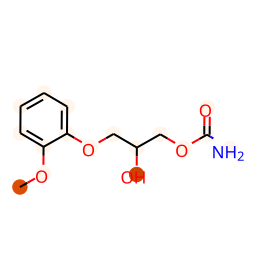

BBBP:1
prediction: [-1.2573661  1.1707232]
C#CC(C)(O)CC


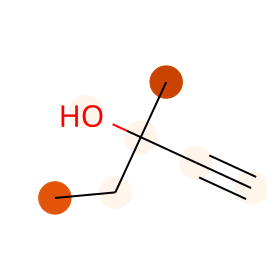

BBBP:1
prediction: [-0.70642745  0.61099327]
COC(=O)C(c1ccccc1)C1CCCCN1


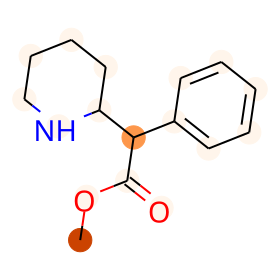

BBBP:0
prediction: [ 0.9158449 -1.1991831]
Nc1ccc(C(=O)O)c(O)c1


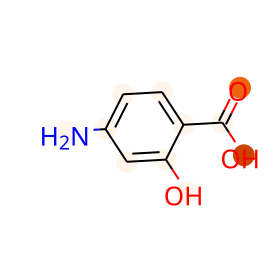

BBBP:1
prediction: [ 0.7626037 -1.170277 ]
Nc1ccn([C@@H]2O[C@H](CO)[C@@H](O)[C@@H]2O)c(=O)n1


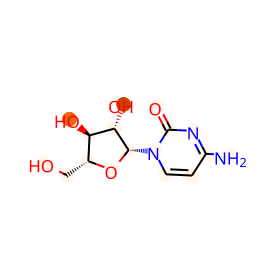

BBBP:1
prediction: [-1.3576627  1.2536378]
CN(C)N/N=C1/N=CN=C1C(N)=O


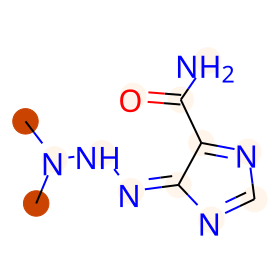

BBBP:0
prediction: [ 1.0779098 -1.6502242]
COc1cccc2c1C(=O)c1c(O)c3c(c(O)c1C2=O)C[C@@](O)(C(C)=O)C[C@@H]3O[C@H]1C[C@H](N)[C@H](O)[C@H](C)O1


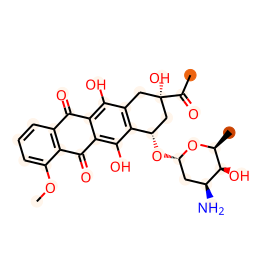

BBBP:0
prediction: [ 1.0498294 -1.5222766]
CN(C)[C@@H]1C(=O)/C(=C(\N)O)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(O)ccc(Cl)c4[C@@H](O)[C@H]3C[C@@H]12


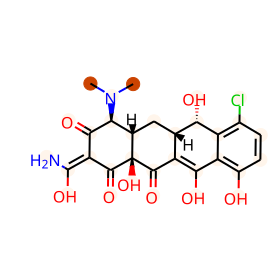

BBBP:0
prediction: [-1.0893027   0.95010316]
C[C@@H](CN1CC(=O)NC(=O)C1)N1CC(=O)NC(=O)C1


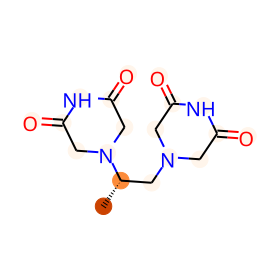

BBBP:1
prediction: [-3.1033013  2.9937756]
Cc1ncc2n1-c1ccc(Cl)cc1C(c1ccccc1F)=NC2.O=C(O)/C=C\C(=O)O


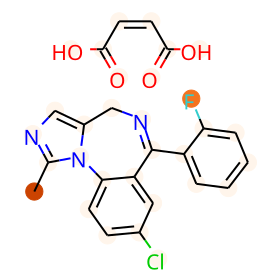

BBBP:1
prediction: [-2.8590565  2.7427661]
CN1CC[C@]23c4c5ccc(O)c4O[C@H]2C(O)C=C[C@H]3[C@H]1C5


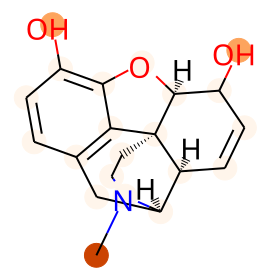

BBBP:1
prediction: [-2.2510643  2.2506557]
CN1CC=C(c2ccccc2)CC1


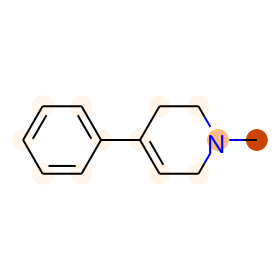

BBBP:1
prediction: [-2.2476711  2.1447551]
C=CCN1CC[C@]23c4c5ccc(O)c4O[C@H]2C(=O)CC[C@@]3(O)[C@H]1C5


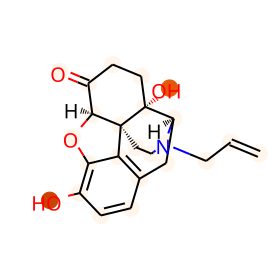

BBBP:1
prediction: [-1.6358877  1.6010296]
CN1CCC[C@H]1c1cccnc1


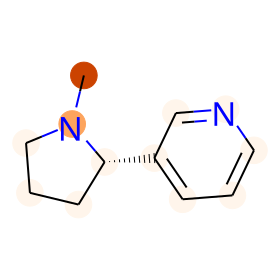

BBBP:1
prediction: [-1.3515159  1.2978232]
O=C1CN=C(c2ccccc2)c2cc([N+](=O)[O-])ccc2N1


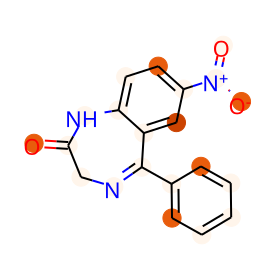

BBBP:1
prediction: [-1.7202382  1.6883044]
O=C1CN=C(c2ccccc2)c2cc(Cl)ccc2N1


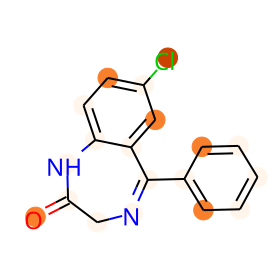

BBBP:1
prediction: [-2.542966  2.550648]
CNCCC=C1c2ccccc2CCc2ccccc21


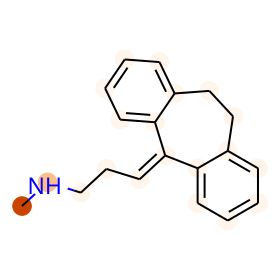

BBBP:0
prediction: [ 0.33328453 -0.8669406 ]
CN1C[C@H](C(=O)N[C@]2(C)O[C@@]3(O)[C@@H]4CCCN4C(=O)[C@H](Cc4ccccc4)N3C2=O)C[C@@H]2c3cccc4[nH]cc(c34)C[C@H]21


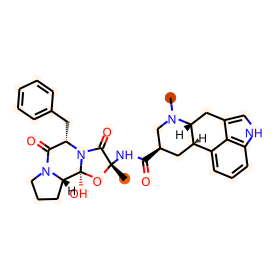

BBBP:1
prediction: [-1.320821   1.1993243]
CCN(CC)C(=S)SSC(=S)N(CC)CC


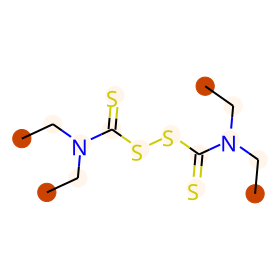

BBBP:0
prediction: [-0.27562848  0.02672604]
O=C1Nc2ccc(Cl)cc2[C@@](C#CC2CC2)(C(F)(F)F)O1


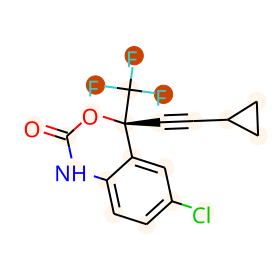

BBBP:0
prediction: [ 1.0562627 -1.4859326]
CCOC(=O)[C@H](CCc1ccccc1)N[C@@H](C)C(=O)N1CCC[C@H]1C(=O)O


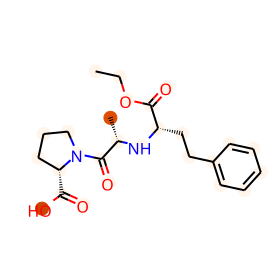

BBBP:0
prediction: [ 0.5422571  -0.77998537]
CC[C@@H](CO)NCCN[C@@H](CC)CO


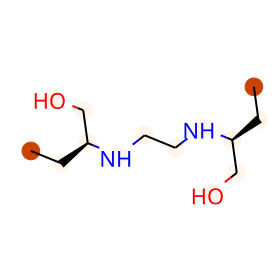

BBBP:0
prediction: [ 0.7374317 -1.5917698]
CC[C@@]1(O)C[C@H](OC2CC(N(C)C)C(OC3CC(O)C(OC4CCC(=O)C(C)O4)C(C)O3)C(C)O2)c2c(cc3c(c2O)C(=O)c2c(O)cccc2C3=O)[C@H]1C(=O)OC


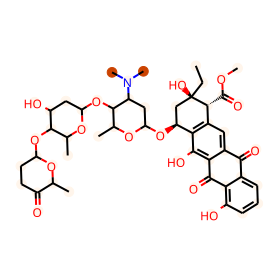

BBBP:0
prediction: [ 1.451475  -2.2003767]
CC1(C)S[C@@H]2[C@H](NC(=O)CCC[C@@H](N)C(=O)O)C(=O)N2[C@H]1C(=O)O


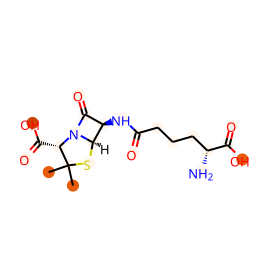

BBBP:0
prediction: [ 0.9247781 -1.243896 ]
CNCC(O)c1ccc(O)c(O)c1


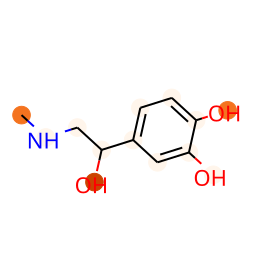

BBBP:0
prediction: [ 0.52841115 -0.8178199 ]
C=CCSCC(=O)NC1C(=O)N2C1SC(C)(C)C2C(=O)[O-].[Na+]


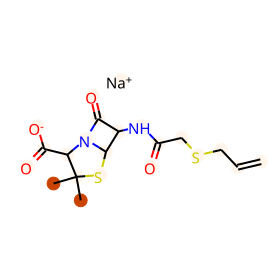

BBBP:0
prediction: [ 1.3715554 -1.9524586]
CC1(C)S[C@@H]2[C@H](NC(=O)C34C[C@@H]5C[C@@H](CC(N)(C5)C3)C4)C(=O)N2[C@H]1C(=O)O


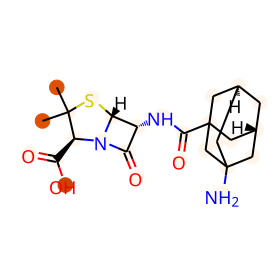

BBBP:0
prediction: [ 1.4564167 -1.9549763]
CC(C)(C)C(=O)OCOC(=O)C1N2C(=O)[C@@H](N=CN3CCCCCC3)[C@H]2SC1(C)C


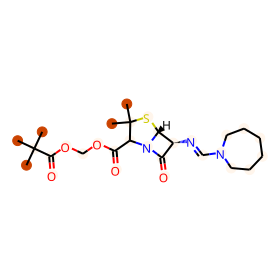

BBBP:0
prediction: [ 0.804664  -1.2260573]
CN(C)[C@@H]1C(=O)/C(=C(\N)O)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(ccc(N)c4O)C[C@H]3C[C@@H]12


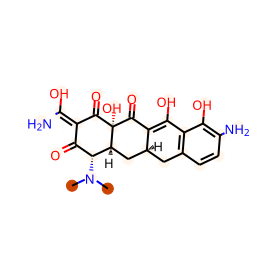

BBBP:0
prediction: [ 1.1137267 -1.6536067]
CC(=O)[C@]1(N)Cc2c(O)c3c(c(O)c2[C@@H](O[C@H]2C[C@H](O)[C@H](O)CO2)C1)C(=O)c1ccccc1C3=O.[Cl-].[H+]


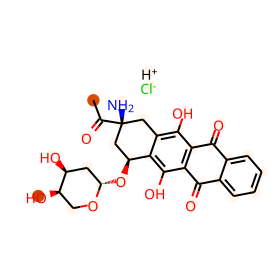

BBBP:0
prediction: [ 1.2790948 -1.895899 ]
CC1(C)S[C@@H]2C(NC(=O)[C@H](NC(=O)c3c[nH]c4cccnc4c3=O)c3ccccc3)C(=O)N2[C@H]1C(=O)O


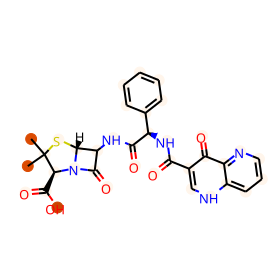

BBBP:0
prediction: [ 1.3161782 -2.4824011]
CN[C@@H]1[C@@H](O[C@H]2O[C@H](CO)[C@@H](N)[C@H](O)[C@H]2O)O[C@H]2C[C@@H](N)[C@H](O[C@@H]3[C@@H](N)C[C@@H](N)[C@H](O)[C@H]3O)O[C@@H]2[C@@H]1O


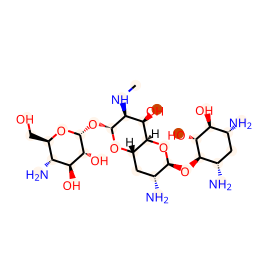

BBBP:0
prediction: [ 1.898518  -2.6456695]
CNC(=O)C[C@@H](N)C(=O)N[C@@H](C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12)c1ccc(O)cc1


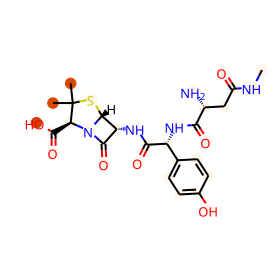

BBBP:0
prediction: [ 1.174224  -1.6716669]
C[C@H]1[C@H](NC(=O)/C(=N\OC(C)(C)C(=O)O)c2csc([NH3+])n2)C(=O)N1S(=O)(=O)[O-]


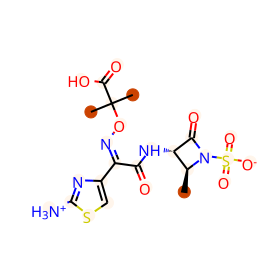

BBBP:0
prediction: [ 1.4101278 -1.882623 ]
CCOC(=O)OC(C)OC(=O)[C@@H]1N2C(=O)[C@@H](N=CN3CCCCCC3)[C@H]2SC1(C)C


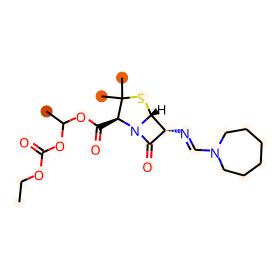

BBBP:0
prediction: [ 0.785049  -1.1771326]
NC(CO)C(=O)NNCc1ccc(O)c(O)c1O


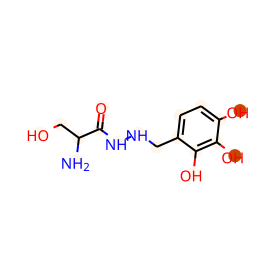

BBBP:0
prediction: [-0.86526835  0.6891564 ]
CC(C)COCC(CN(Cc1ccccc1)c1ccccc1)N1CCCC1


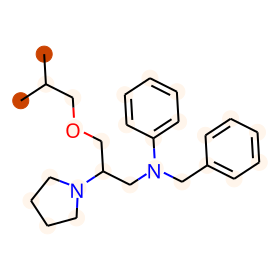

BBBP:0
prediction: [ 1.2645366 -1.6442747]
CC(C)(C)NCC(O)c1ccc(O)c(NC(N)=O)c1


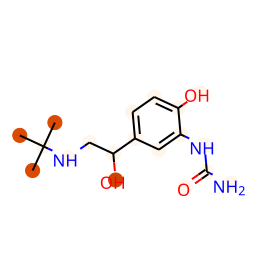

BBBP:0
prediction: [ 1.1291071 -1.6899981]
CC(=O)[C@]1(O)Cc2c(O)c3c(c(O)c2C(OC2CC(N)C(O)C(C)O2)C1)C(=O)c1c(O)cccc1C3=O


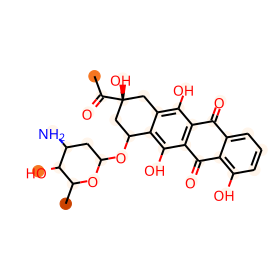

BBBP:0
prediction: [ 1.0408348 -1.5302627]
NC(=O)OCC1[C@H](NC(=O)/C(=N\OCC(=O)O)c2csc(N)n2)C(=O)N1S(=O)(=O)O


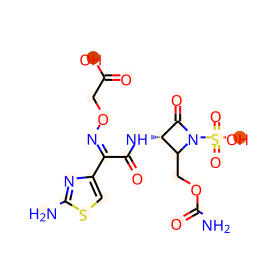

BBBP:0
prediction: [ 1.3949805 -1.9317207]
N[C@@H](C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(Cl)CS[C@H]12)c1ccccc1


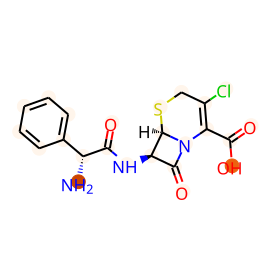

BBBP:0
prediction: [ 1.641795  -2.2483187]
CC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)[C@H](N)c3ccc(O)cc3)[C@H]2SC1


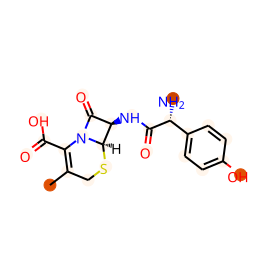

BBBP:0
prediction: [ 1.523409  -2.0778487]
CC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)[C@H](N)c3ccccc3)[C@H]2SC1


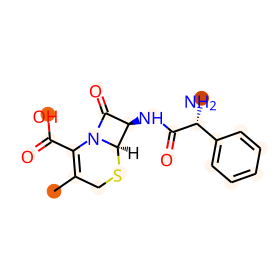

BBBP:0
prediction: [ 1.2702278 -1.6814178]
CC(=O)OCC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)Cc3ccccc3)[C@H]2SC1


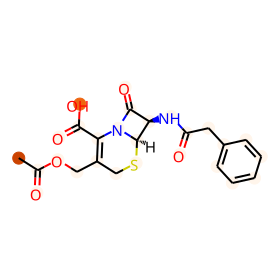

BBBP:0
prediction: [ 1.503363  -2.0880477]
Cc1nnc(SCC2=C(C(=O)O)N3C(=O)[C@@H](NC(=O)C(N)c4ccc(O)cc4)[C@H]3SC2)s1


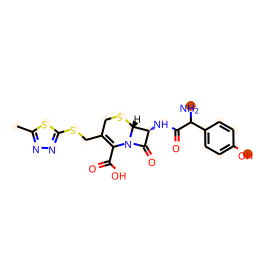

BBBP:0
prediction: [ 1.7036762 -2.3095753]
NC(C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(CSc3cn[nH]n3)CS[C@H]12)c1ccc(O)cc1


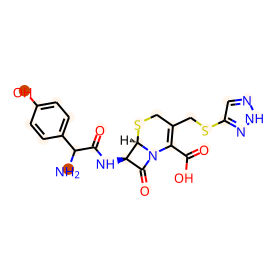

BBBP:0
prediction: [ 0.96333575 -1.4244384 ]
Cn1nnnc1SCC1=C(C(=O)[O-])N2C(=O)[C@@H](NC(=O)CSC(F)(F)F)[C@H]2SC1.[Na+]


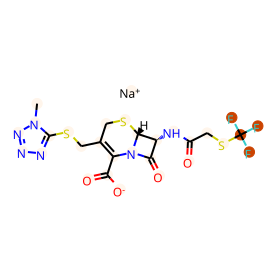

BBBP:0
prediction: [ 1.2497007 -1.773997 ]
Cc1nnc(SCC2=C(C(=O)O)N3C(=O)[C@@H](NC(=O)Cn4cc(Cl)c(=O)c(Cl)c4)[C@H]3SC2)s1


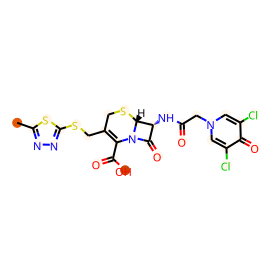

BBBP:0
prediction: [ 1.2610719 -1.9222182]
Cc1nnc(SCC2=C(C(=O)O)N3C(=O)[C@@H](NC(=O)[C@H](O)c4ccccc4)[C@H]3SC2)s1


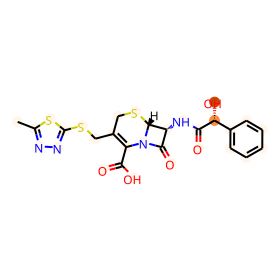

BBBP:0
prediction: [ 0.6866147 -1.1985106]
Cc1nnc(SCC2=C(C(=O)OCc3oc(=O)oc3C)N3C(=O)C(NC(=O)C(OC(=O)C(C)N)c4ccccc4)C3SC2)s1


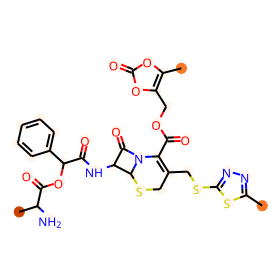

BBBP:0
prediction: [ 1.3414378 -1.8035095]
CC/C=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(COC(N)=O)CS[C@H]12)c1csc(N)n1


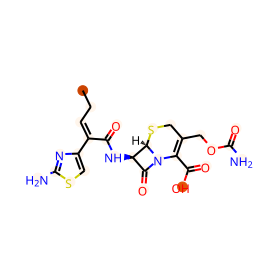

BBBP:0
prediction: [ 1.5969545 -2.0784907]
COCC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)/C(=N\O)c3csc(N)n3)[C@H]2SC1


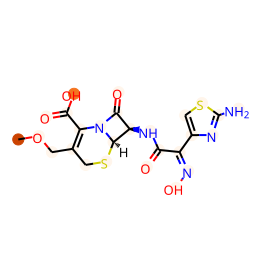

BBBP:0
prediction: [ 1.4926426 -1.9414878]
C=CC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)/C(=N\O)c3csc(N)n3)[C@H]2SC1


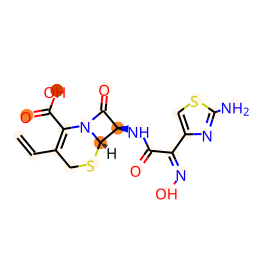

BBBP:0
prediction: [ 1.6098672 -2.2280939]
CC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)[C@H](N)c3ccc(O)c(Cl)c3)[C@H]2SC1


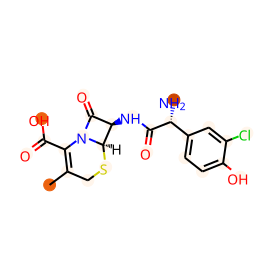

BBBP:0
prediction: [ 1.4268705 -1.8818474]
CO/N=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(C)CS[C@H]12)c1csc(N)n1


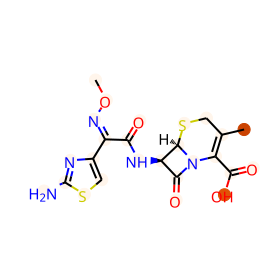

BBBP:0
prediction: [ 1.5481368 -2.0414474]
O=C(Cc1cccs1)N[C@@H]1C(=O)N2C(C(=O)O)=C(CSc3ncn[nH]3)CS[C@H]12


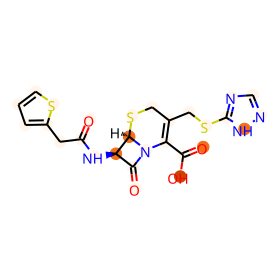

BBBP:0
prediction: [ 1.4261714 -1.8991662]
Cn1nnnc1SCC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)CS/C=C\C#N)[C@H]2SC1


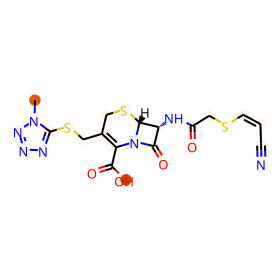

BBBP:0
prediction: [ 1.4322498 -1.9471846]
C=CC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)/C(=N\OCC(=O)O)c3csc(N)n3)[C@H]2SC1


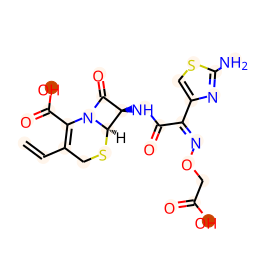

BBBP:0
prediction: [ 1.4869459 -2.0107803]
CO/N=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(CSc3nnnn3C)CS[C@H]12)c1csc(N)n1


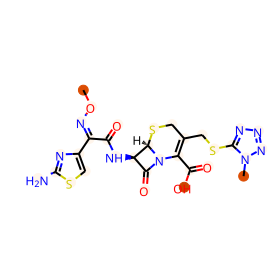

BBBP:0
prediction: [ 1.8334306 -2.3965805]
CO[C@@]1(NC(=O)CSCC#N)C(=O)N2C(C(=O)O)=C(CSc3nnnn3C)CS[C@@H]21


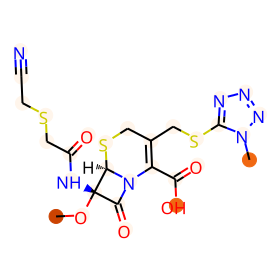

BBBP:0
prediction: [ 1.546472  -2.2738097]
CO[C@@]1(NC(=O)CSC[C@@H](N)C(=O)O)C(=O)N2C(C(=O)O)=C(CSc3nnnn3C)CS[C@@H]21


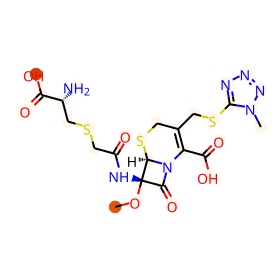

BBBP:0
prediction: [ 1.3236914 -2.011164 ]
CO/N=C(/C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(CSc3nc(C)c(CC(=O)O)s3)CS[C@H]12)c1csc(N)n1


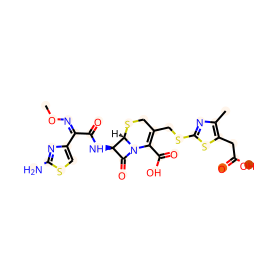

BBBP:0
prediction: [ 1.1950794 -1.8348   ]
O=C(O)C1=C(CSc2nnnn2CS(=O)(=O)O)CS[C@@H]2[C@H](NC(=O)C(O)c3ccccc3)C(=O)N12


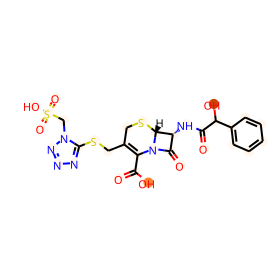

BBBP:0
prediction: [ 1.3377086 -1.952141 ]
NCc1ccccc1CC(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(CSc3nnnn3CC(=O)O)CS[C@H]12


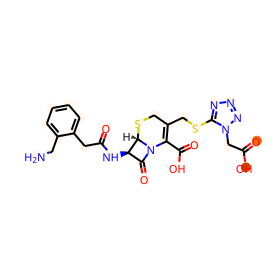

BBBP:0
prediction: [ 1.8440338 -2.492658 ]
CO[C@@]1(NC(=O)C2SC(=C(C(N)=O)C(=O)O)S2)C(=O)N2C(C(=O)O)=C(CSc3nnnn3C)CS[C@@H]21


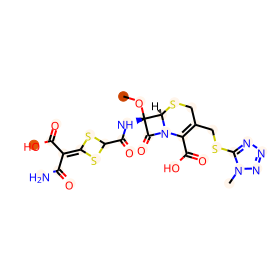

BBBP:0
prediction: [ 1.8531708 -2.4051874]
CN(C)CCn1nnnc1SCC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)Cc3csc(N)n3)[C@H]2SC1


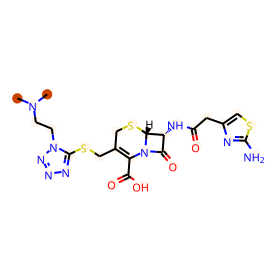

BBBP:0
prediction: [ 1.347637  -1.9586821]
Cc1cc(=O)c(C(=O)N[C@@H](C(=O)NC2C(=O)N3C(C(=O)O)=C(CSc4nnnn4C)CS[C@H]23)c2ccc(O)cc2)c[nH]1


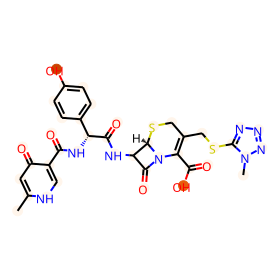

BBBP:0
prediction: [ 0.9909358 -1.3795326]
COCC1=C(C(=O)[O-])N2C(=O)[C@@H](NC(=O)/C(=N\OC)c3csc(N)n3)[C@H]2SC1.[Na+]


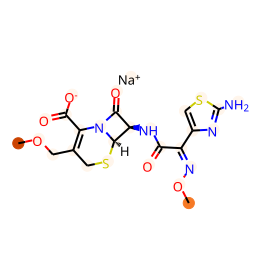

BBBP:0
prediction: [ 1.7674738 -2.3810337]
C/C=C/C1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)[C@H](N)c3ccc(O)cc3)[C@H]2SC1.O


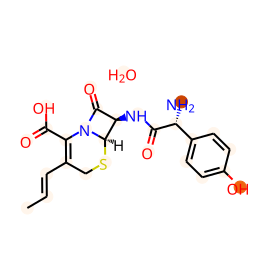

BBBP:0
prediction: [ 1.2506477 -1.6412472]
COC1=C(C(=O)O)N2C(=O)C(NC(=O)C(N)C3C=CCC=C3)C2SC1


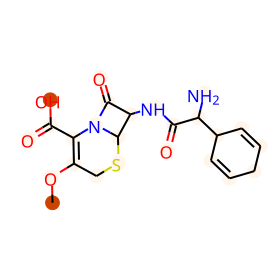

BBBP:0
prediction: [ 1.7613987 -2.4311278]
CC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)[C@H](N)c3cccc(NS(C)(=O)=O)c3)[C@H]2SC1


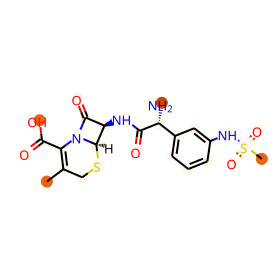

BBBP:0
prediction: [ 1.819527  -2.2661397]
O=C(Cn1cnnn1)N[C@@H]1C(=O)N2C(C(=O)O)=C(CSc3nncs3)CS[C@H]12


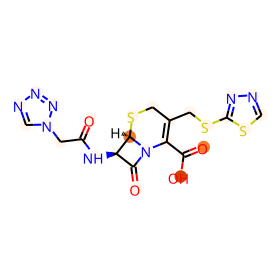

BBBP:0
prediction: [ 1.4604298 -1.9392133]
Nc1nc(/C(=C/CC(=O)O)C(=O)N[C@@H]2C(=O)N3C(C(=O)O)=CCS[C@H]23)cs1.O.O


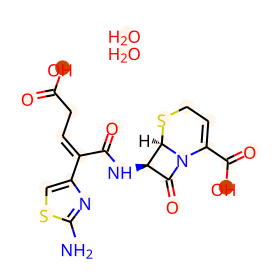

BBBP:0
prediction: [ 1.3714308 -1.9170047]
CO/N=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(/C=C/Sc3n[nH]c(=O)c(=O)n3CC=O)CS[C@H]12)c1csc(N)n1


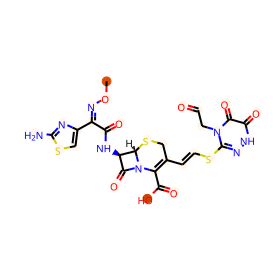

BBBP:0
prediction: [ 1.1903279 -1.7124679]
CO/N=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(COC(C)=O)CS(=O)[C@H]12)c1csc(N)n1


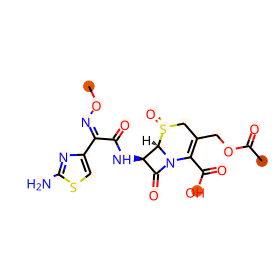

BBBP:0
prediction: [ 1.3387407 -1.7455671]
CO/N=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=CCS[C@H]12)c1csc(N)n1


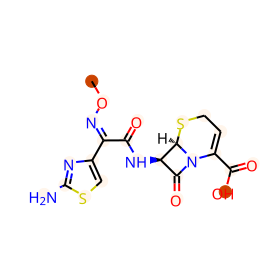

BBBP:0
prediction: [ 1.2263856 -1.6623621]
CO/N=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(COC(C)=O)CS[C@H]12)c1ccco1


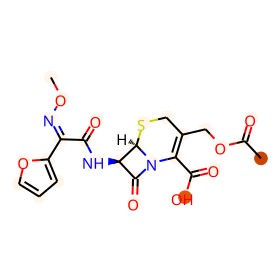

BBBP:0
prediction: [ 0.6850913 -1.1077521]
CO/N=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)OC(C)OC(C)=O)=C(COC(N)=O)CS[C@H]12)c1ccco1


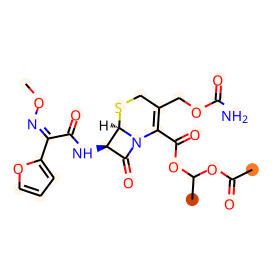

BBBP:0
prediction: [ 0.628582  -1.0632267]
COCCCC(=O)OC(C)OC(=O)C1=C(COC(N)=O)CS[C@@H]2[C@H](NC(=O)/C(=N\OC)c3ccco3)C(=O)N12


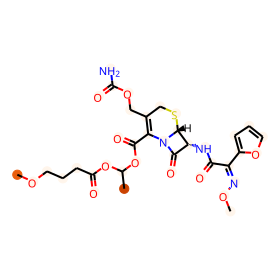

BBBP:0
prediction: [ 1.6069075 -2.0998352]
CO/N=C(\C(=O)N[C@@H]1C(=O)N2C(C(=O)O)=C(CSc3cnns3)CS[C@H]12)c1csc(N)n1


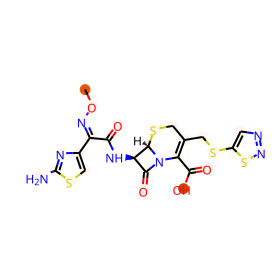

BBBP:0
prediction: [ 0.6297438 -0.9187192]
CC(=O)OCC1=C(C(=O)[O-])N2C(=O)[C@H](NC(=O)CC#N)[C@@H]2SC1.[Na+]


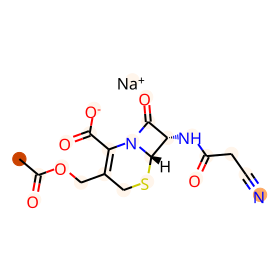

BBBP:0
prediction: [ 1.4492849 -2.0263686]
CC(=O)OCC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)[C@H](N)c3ccccc3)[C@H]2SC1.O.O


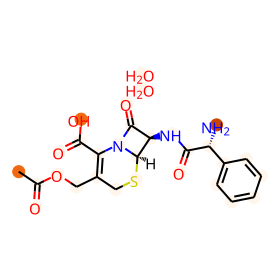

BBBP:0
prediction: [ 1.2571778 -1.904161 ]
CC(=O)OCC1=C(C(=O)O)N2C(=O)[C@@H](NC(=O)CCC[C@@H](N)C(=O)O)[C@H]2SC1


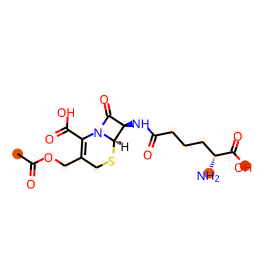

BBBP:0
prediction: [ 1.4295576 -2.0279691]
CC(=O)C1=C(O)[C@@]2(O)C(=O)c3c(c(C)c4ccc(C)c(O)c4c3O)C[C@H]2[C@@H](N)C1=O


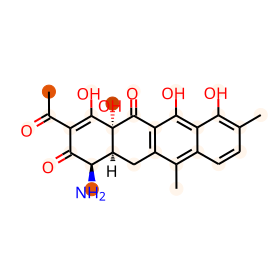

BBBP:0
prediction: [ 1.2941277 -2.048829 ]
CCC[C@@H]1C[C@@H](C(=O)NC(C(C)Cl)[C@H]2O[C@H](SC)[C@H](O)[C@@H](O)[C@H]2O)N(C)C1


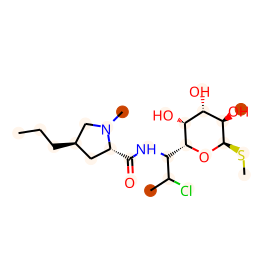

BBBP:0
prediction: [ 1.4400128 -2.1465662]
CCC[C@@H]1C[C@@H](C(=O)NC(C(C)Cl)[C@H]2O[C@H](SC)[C@H](OP(=O)(O)O)[C@@H](O)[C@H]2O)N(C)C1


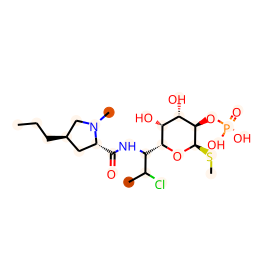

BBBP:0
prediction: [ 1.6027836 -2.2060978]
COC(C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12)c1ccc(Cl)c(Cl)c1


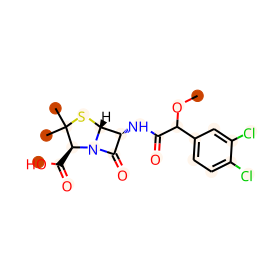

BBBP:0
prediction: [ 0.8831444 -1.3773988]
CN(C)[C@@H]1C(=O)/C(=C(/O)NCO)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(O)ccc(Cl)c4[C@@](C)(O)[C@H]3C[C@@H]12


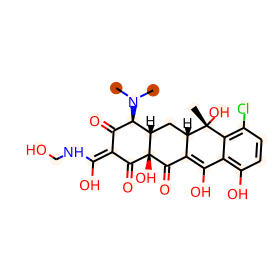

BBBP:0
prediction: [ 1.5039067 -2.030695 ]
CC1(C)S[C@@H]2[C@H](NC(=O)C3(N)CCCCC3)C(=O)N2[C@H]1C(=O)O


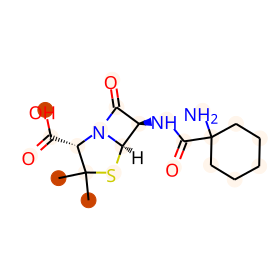

BBBP:0
prediction: [ 4.4001946 -5.7546363]
CC=CCC(C)C(O)C1C(=O)NC(CC)C(=O)N(C)CC(=O)N(C)C(CC(C)C)C(=O)NC(C(C)C)C(=O)N(C)C(CC(C)C)C(=O)NC(C)C(=O)NC(C)C(=O)N(C)C(CC(C)C)C(=O)N(C)C(CC(C)C)C(=O)N(C)C(C(C)C)C(=O)N1C


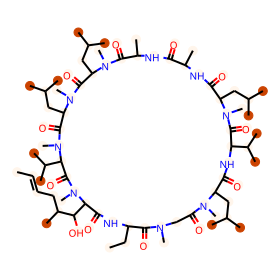

BBBP:0
prediction: [ 1.1444603 -1.5975091]
CN(C)[C@@H]1C(=O)/C(=C(\N)O)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(O)cccc4[C@@H](O)[C@H]3C[C@@H]12


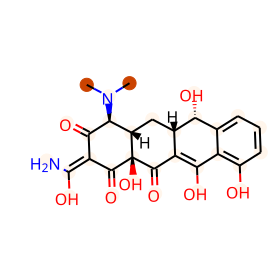

BBBP:0
prediction: [ 0.33609152 -0.94417644]
CCOC(OCC)C(=O)OCC(=O)C1(O)Cc2c(O)c3c(c(O)c2C(OC2CC(N)C(O)C(C)O2)C1)C(=O)c1c(OC)cccc1C3=O


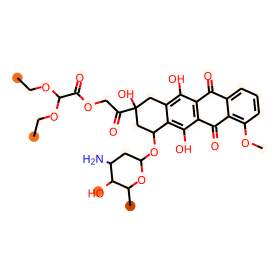

BBBP:0
prediction: [ 1.2318571 -1.8291411]
Cc1onc(-c2c(Cl)cccc2Cl)c1C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12


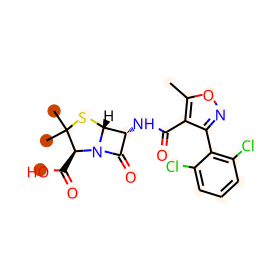

BBBP:0
prediction: [ 1.0247233 -2.2231967]
CN[C@@H]1[C@H](O[C@H]2[C@H](O[C@@H]3[C@@H](O)[C@H](O)[C@@H](N=C(N)N)[C@H](O)[C@H]3N=C(N)N)O[C@@H](C)[C@]2(O)CO)O[C@@H](CO)[C@H](O)[C@H]1O


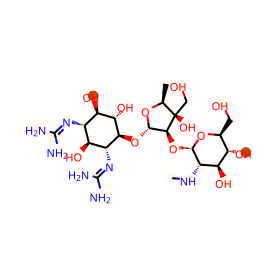

BBBP:0
prediction: [ 0.6083118 -1.6646838]
COc1ccc(-c2cc(=O)c3c(O)cc(O[C@@H]4O[C@H](CO[C@@H]5O[C@@H](C)[C@H](O)[C@@H](O)[C@H]5O)[C@@H](O)[C@H](O)[C@H]4O)cc3o2)cc1O


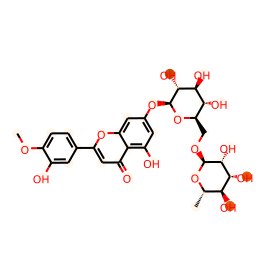

BBBP:0
prediction: [ 0.6749971 -1.1096506]
CNCC(O)c1ccc(OC(=O)C(C)(C)C)c(OC(=O)C(C)(C)C)c1


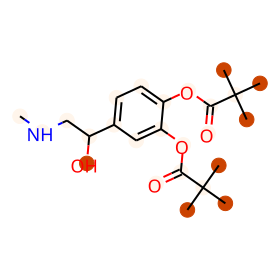

BBBP:0
prediction: [ 2.415521  -3.4971235]
CCC(=O)O[C@H]1[C@H](C)O[C@@H](O[C@@H]2C(C)C(=O)O[C@H](C)[C@H](C)[C@H](OC(=O)CC)[C@@H](C)C(=O)[C@]3(CO3)CC(C)[C@H](O[C@@H]3O[C@H](C)C[C@H](N(C)C)[C@H]3O)[C@H]2C)C[C@@H]1OC


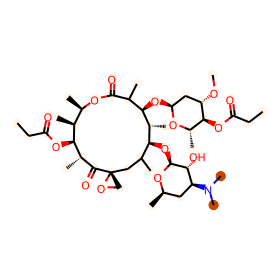

BBBP:0
prediction: [ 0.5686318  -0.98811615]
OCCN(CCO)c1nc(N2CCCCC2)c2nc(N(CCO)CCO)nc(N3CCCCC3)c2n1


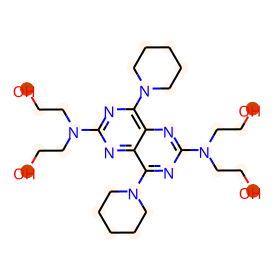

BBBP:0
prediction: [ 1.5333459 -2.7482135]
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(O)C[C@@H](C)[C@@H]2N[C@@H](COCCOC)O[C@H]([C@H]2C)[C@]1(C)O


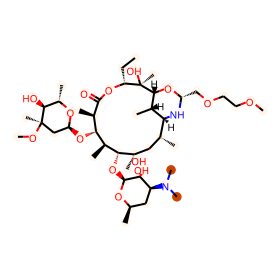

BBBP:0
prediction: [ 3.348207 -4.645848]
C/C=C/C=C/C1OC(O)(C(CC)C(=O)NC/C=C/C=C(\C)C(OC)C(C)C2OC(/C=C/C=C/C=C(\C)C(=O)c3c(O)n(C)ccc3=O)C(O)C2O)C(O)C(OC2OC(C)C(OC3OC(C)C(OC)C(O)C3OC)C(OC)C2O)C1(C)C


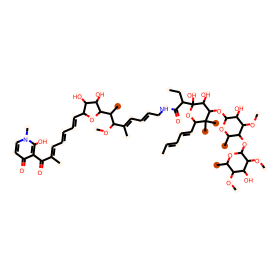

BBBP:0
prediction: [-0.5022605   0.14597169]
CC[C@H]1CN2CCc3cc(OC)c(OC)cc3[C@@H]2C[C@@H]1C[C@H]1NCCc2cc(OC)c(OC)cc21.[Cl]


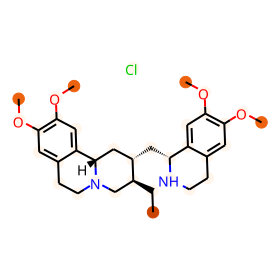

BBBP:0
prediction: [ 1.7639838 -2.4103858]
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](N)C3=CCC=CC3)C(=O)N2[C@H]1C(=O)O


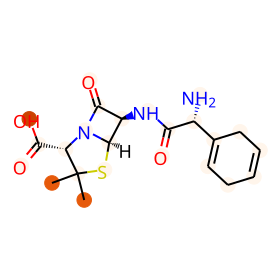

BBBP:0
prediction: [ 0.7857065 -1.3254483]
COc1cccc2c1C(=O)c1c(O)c3c(c(O)c1C2=O)C[C@](O)(C(=O)CO)C[C@H]3OC1CC(N)CC(C)O1


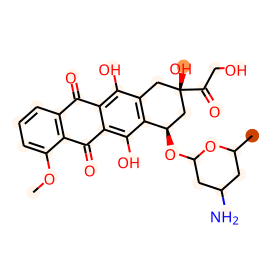

BBBP:0
prediction: [ 2.5105543 -3.4045422]
CN(CCN(C)CN/C(O)=C1\C(=O)[C@@H](N(C)C)[C@@H]2C[C@H]3C(=C(O)c4c(O)cccc4[C@@]3(C)O)C(=O)[C@]2(O)C1=O)CN/C(O)=C1\C(=O)[C@@H](N(C)C)[C@@H]2C[C@H]3C(=C(O)c4c(O)cccc4[C@@]3(C)O)C(=O)[C@]2(O)C1=O


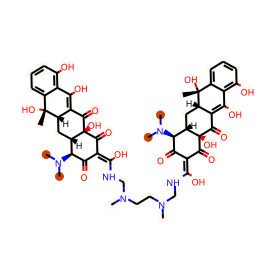

BBBP:0
prediction: [ 0.7103261  -0.95937425]
CCNCC(O)c1cccc(O)c1


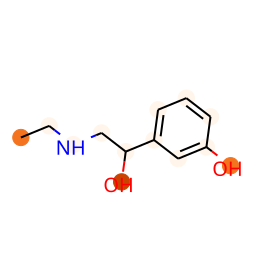

BBBP:0
prediction: [ 1.4164933 -1.9547694]
CC1(C)S[C@@H]2[C@H](NC(=O)C(Oc3ccccc3)c3ccccc3)C(=O)N2[C@H]1C(=O)O


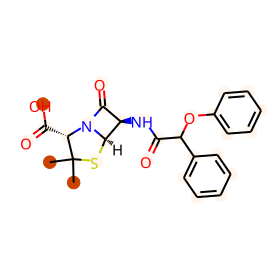

BBBP:0
prediction: [-0.52720404  0.3965796 ]
CC(C)c1ccccc1OCC1=NCCN1


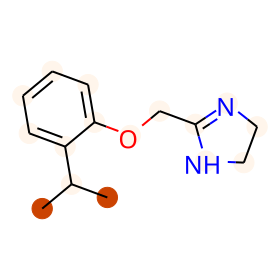

BBBP:0
prediction: [ 1.3036635 -1.8052983]
CC(C)(C(=O)O)c1ccc(C(O)CCCN2CCC(C(O)(c3ccccc3)c3ccccc3)CC2)cc1


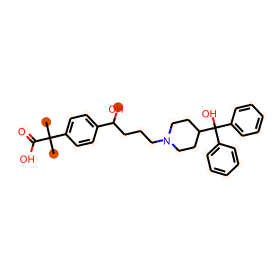

BBBP:0
prediction: [ 1.7632796 -2.4412043]
CC(C)(Oc1ccc(Cl)cc1)C(=O)N[C@@H](C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12)c1ccccc1


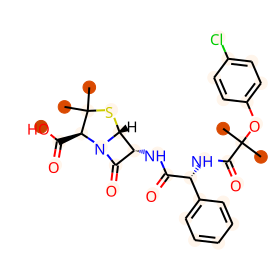

BBBP:0
prediction: [ 1.1953648 -1.7392715]
CO[C@@]1(NC(=O)CSC(F)(F)F)C(=O)N2C(C(=O)O)=C(CSc3nnnn3CCO)CO[C@@H]21.[Na]


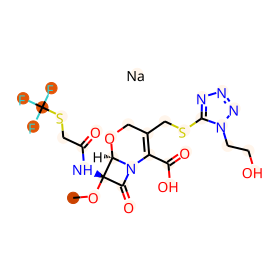

BBBP:0
prediction: [ 1.4498173 -2.0306964]
CC1(C)S[C@@H]2[C@H](NC(=O)[C@@H](N=Cc3ccco3)c3ccc(O)cc3)C(=O)N2[C@H]1C(=O)O


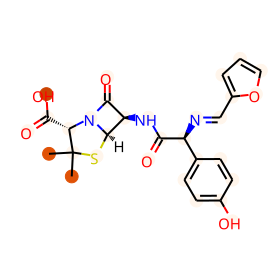

BBBP:0
prediction: [-0.26229486 -0.09697175]
CO/N=C(\C(=O)N[C@@H]1C(=O)N(OCC(=O)OCC(=O)OC(C)(C)C)[C@H]1C)c1csc(N)n1


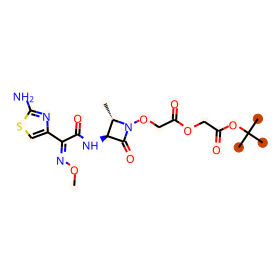

BBBP:0
prediction: [ 3.2269197 -4.0234566]
CC(C)CC1NC(=O)C(CCCN)NC(=O)C(C(C)C)NC(=O)C2CCCN2C(=O)C(Cc2ccccc2)NC(=O)C(CC(C)C)NC(=O)C(CCCN)NC(=O)C(C(C)C)NC(=O)C2CCCN2C(=O)C(Cc2ccccc2)NC1=O


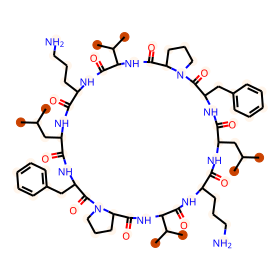

BBBP:0
prediction: [ 1.9029878 -2.630821 ]
CC1(C)S[C@@H]2[C@H](N3C(=O)[C@@H](c4ccccc4)NC3(C)C)C(=O)N2[C@H]1C(=O)O


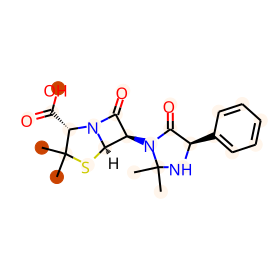

BBBP:0
prediction: [-0.68820757  0.59091634]
CC(Cc1ccccc1)NO


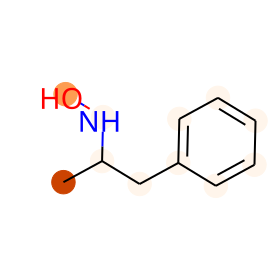

BBBP:0
prediction: [ 0.60108256 -0.8566457 ]
CNC(C)C(O)c1ccc(O)cc1


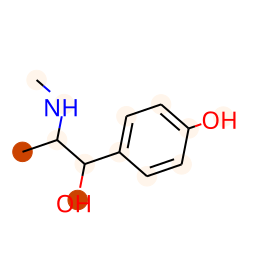

BBBP:0
prediction: [-0.34061134  0.20935273]
Cc1cc(=O)oc2cc(O)ccc12


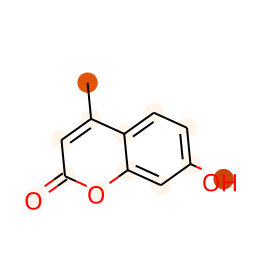

BBBP:0
prediction: [ 0.9187958 -1.4459283]
CC(=O)[C@]1(O)Cc2c(O)c3c(c(O)c2[C@@H](O[C@H]2C[C@H](N)[C@H](O)[C@H](C)O2)C1)C(=O)c1ccccc1C3=O


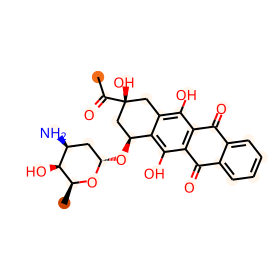

BBBP:0
prediction: [ 1.7137272 -2.2916374]
CC(C)(Oc1ccccc1)C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12


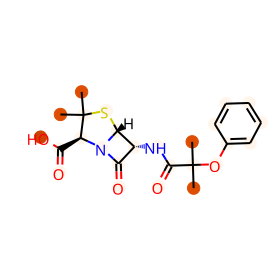

BBBP:0
prediction: [ 2.5422363 -3.610816 ]
CO[C@@H]1[C@@H](O[C@@H]2O[C@H](C)[C@@H](O[C@H]3C[C@@](C)(O)[C@@H](OC(=O)CC(C)C)[C@H](C)O3)[C@H](N(C)C)[C@H]2O)[C@@H](CC=O)C[C@@H](C)[C@@H](O)/C=C/C=C/C[C@@H](C)OC(=O)C[C@H]1OC(C)=O


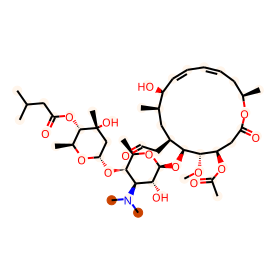

BBBP:0
prediction: [ 1.5837977 -2.1895516]
Cc1oc(=O)oc1COC(=O)[C@@H]1N2C(=O)[C@@H](NC(=O)[C@H](N)c3ccccc3)[C@H]2SC1(C)C


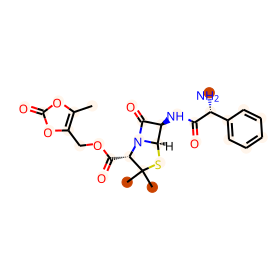

BBBP:0
prediction: [ 1.964787  -2.7089298]
CNCC[C@@H](O)[C@@H]1C[C@H](SC2=C(C(=O)O)N3C(=O)[C@H]([C@@H](C)O)[C@H]3[C@H]2C)CN1


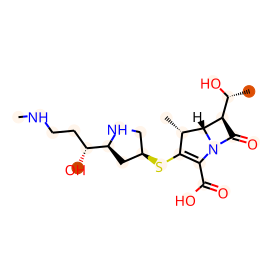

BBBP:0
prediction: [ 1.7649796 -2.4989383]
COc1cccc2c1C(=O)c1c(O)c3c(c(O)c1C2=O)C[C@@](O)(C(=O)CO)C[C@@H]3O[C@H]1C[C@H](NC(=O)[C@@H](N)CC(C)C)[C@H](O)[C@H](C)O1


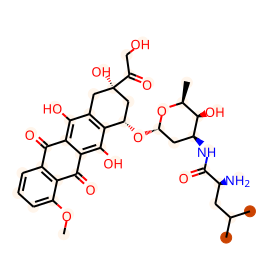

BBBP:0
prediction: [ 1.4993399 -2.6753309]
CC[C@H]1OC(=O)[C@H](C)[C@@H](OC2CC(C)(OC)C(O)C(C)O2)C(C)[C@@H](OC2OC(C)CC(N(C)C)C2O)[C@](C)(O)C[C@@H](C)/C(=N\OC)[C@H](C)[C@@H](O)[C@]1(C)O


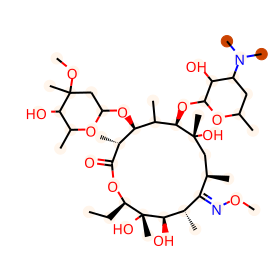

BBBP:0
prediction: [ 1.0365094 -1.727025 ]
CCCC1CC(C(=O)NC(C(C)O)C2OC(SC)C(O)C(O)C2O)N(C)C1


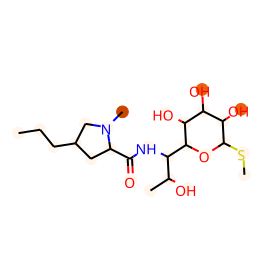

BBBP:0
prediction: [ 0.9205642 -1.3517153]
N[C@@H](C(=O)NC1C(=O)N2C(C(=O)O)=C(Cl)CCC12)c1ccccc1.O


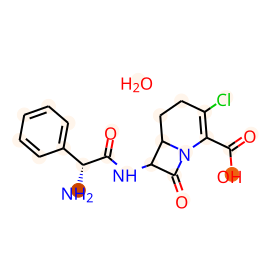

BBBP:0
prediction: [ 1.051965  -1.4552861]
CCCCc1nc(Cl)c(CO)n1Cc1ccc(-c2ccccc2-c2nn[nH]n2)cc1


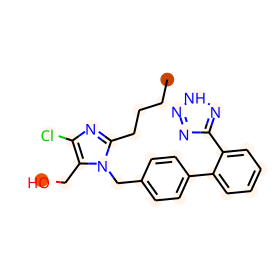

BBBP:0
prediction: [ 0.94786865 -1.4477336 ]
CN(C)[C@@H]1C(=O)/C(=C(/N)O)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(O)ccc(Cl)c4[C@@](C)(O)[C@H]3C[C@@H]12.[Cl-].[H+]


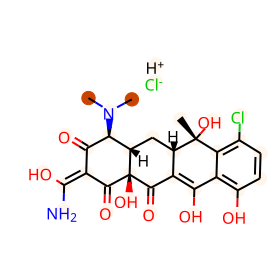

BBBP:0
prediction: [ 1.4948059 -1.9981134]
CC1(C)S[C@@H]2[C@H](N=CN3CCCCCC3)C(=O)N2[C@H]1C(=O)O


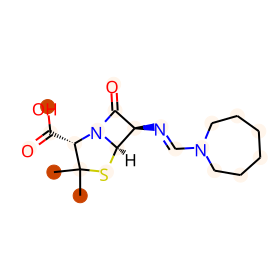

BBBP:0
prediction: [ 0.6114246 -1.1315513]
CC1OC(OC2CC(O)(C(=O)CO)Cc3c(O)c4c(c(O)c32)C(=O)c2ccccc2C4=O)CC(N)C1O


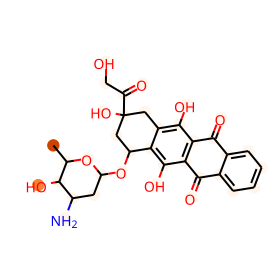

BBBP:0
prediction: [ 1.9872388 -2.5481822]
C[C@H](O)C1C(=O)N2C(C(=O)O)=C(S[C@@H]3CN[C@H](C(=O)N(C)C)C3)[C@H](C)C12.O.O.O


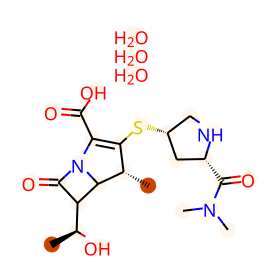

BBBP:0
prediction: [ 1.0702804 -1.5087655]
C=NC(C(=O)NC1C(=O)N2C1SC(C)(C)C2C(=O)O)c1ccccc1


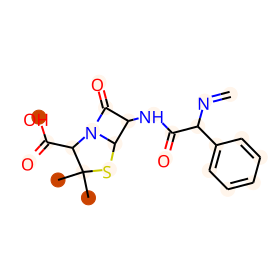

BBBP:0
prediction: [ 1.4916877 -2.049696 ]
C=C1c2cccc(O)c2C(O)=C2C(=O)[C@]3(O)C(=O)/C(=C(/N)O)C(=O)[C@@H](N(C)C)[C@@H]3[C@@H](O)[C@H]12


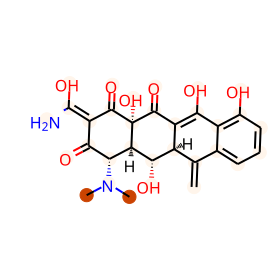

BBBP:0
prediction: [-1.1928304  1.0795431]
CNC(C)C(=O)c1ccc(OC)cc1


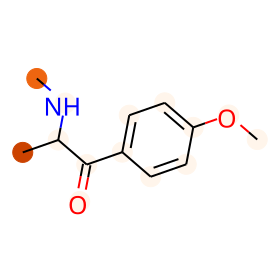

BBBP:0
prediction: [ 1.6740724 -2.2449944]
COc1cccc(OC)c1C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12


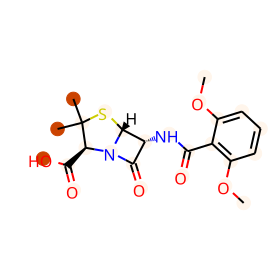

BBBP:0
prediction: [ 1.402013  -2.0529504]
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](NC(=O)N3CCN(S(C)(=O)=O)C3=O)c3ccccc3)C(=O)N2[C@H]1C(=O)O


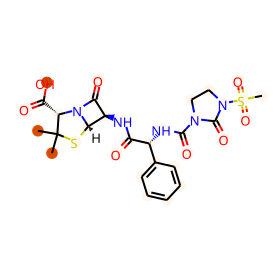

BBBP:0
prediction: [-0.56828    0.2210159]
COCC(=O)O[C@]1(CCN(C)CCCc2nc3ccccc3[nH]2)CCc2cc(F)ccc2[C@@H]1C(C)C


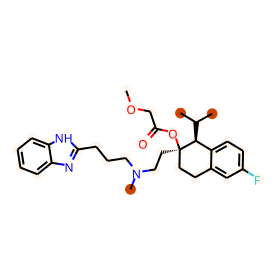

BBBP:0
prediction: [ 1.9081928 -2.9190304]
CCC(=O)OC1CC(=O)OC(C)C/C=C/C=C\C(O)C(C)CC(CC=O)C(O[C@@H]2O[C@H](C)[C@@H](O[C@H]3C[C@@](C)(O)[C@H](OC(=O)CC)[C@@H](C)O3)[C@H](N(C)C)[C@H]2O)C1OC


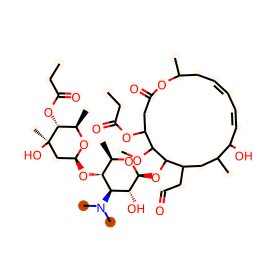

BBBP:0
prediction: [ 1.5422815 -2.1884193]
CCC1NC(=O)C(NC(=O)c2ncccc2O)C(C)OC(=O)C(c2ccccc2)NC(=O)C2CC(=O)CCN2C(=O)C(Cc2ccc(N(C)C)cc2)N(C)C(=O)C2CCCN2C1=O


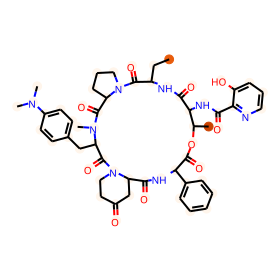

BBBP:0
prediction: [ 0.78535485 -1.4081984 ]
CCCCCC1CNC(C(=O)NC(C(C)Cl)C2OC(SC)C(O)C(O)C2O)C1


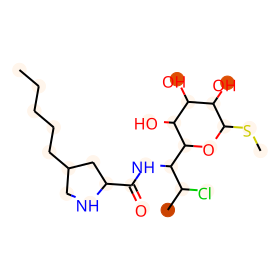

BBBP:0
prediction: [ 0.79577553 -1.1946228 ]
CO[C@@]12[C@H](COC(N)=O)C3=C(C(=O)C(C)=C(N)C3=O)N1C[C@@H]1N[C@@H]12


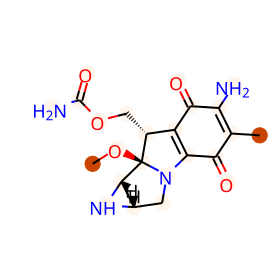

BBBP:0
prediction: [ 1.2827396 -1.9490039]
CO[C@@]1(NC(=O)C(C(=O)O)c2ccc(O)cc2)C(=O)N2C(C(=O)O)=C(CSc3nnnn3C)CO[C@@H]21


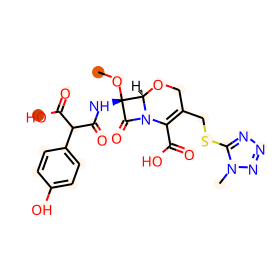

BBBP:0
prediction: [-0.66285884  0.35988227]
COC(=O)C1=C(C)NC(C)=C(C(=O)OCCN(C)Cc2ccccc2)C1c1cccc([N+](=O)[O-])c1


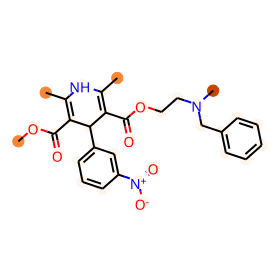

BBBP:0
prediction: [ 0.7055906 -1.1276655]
CN(C)[C@@H]1C(=O)/C(=C(\N)O)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(O)ccc([N+](=O)[O-])c4C[C@H]3C[C@@H]12


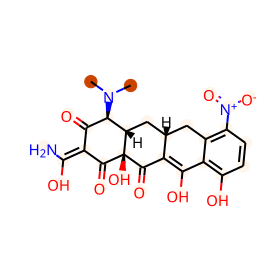

BBBP:0
prediction: [ 2.33574   -3.3899467]
COC1CC(O[C@@H]2[C@@H](C)C(=O)O[C@H](C)[C@H](C)[C@H](O)[C@@H](C)C(=O)[C@@]3(CO3)C[C@H](C)[C@H](OC3OC(C)CC(N(C)C)C3O)[C@H]2C)OC(C)C1O


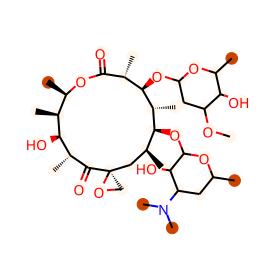

BBBP:0
prediction: [ 1.9580792 -2.687291 ]
CC1(C)S[C@@H]2[C@H]([NH+]3C(=O)C(c4ccc(O)cc4)NC3(C)C)C(=O)N2[C@H]1C(=O)O


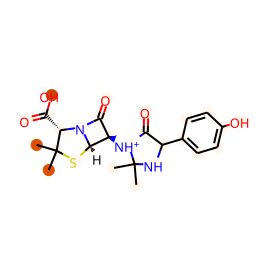

BBBP:0
prediction: [ 0.701831  -1.0608008]
CO/N=C(\C(=O)NC1C(=O)N(OCC(=O)O)[C@H]1C)c1csc(N)n1


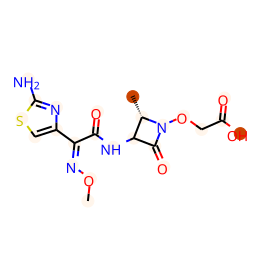

BBBP:0
prediction: [ 1.3183379 -2.1351492]
CC(=O)O[C@H]1C(=O)[C@@]2(C)C([C@H](OC(=O)c3ccccc3)[C@]3(O)C[C@H](OC(=O)[C@H](O)[C@@H](NC(=O)c4ccccc4)c4ccccc4)C(C)=C1C3(C)C)[C@]1(OC(C)=O)CO[C@@H]1C[C@@H]2O


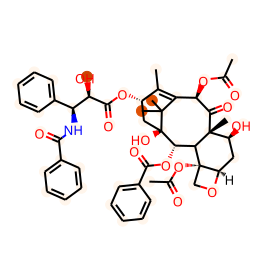

BBBP:0
prediction: [ 1.5107664 -2.1219378]
CN(C)[C@@H]1C(=O)/C(=C(/O)NCN2CCCC(C(=O)O)C2)C(=O)[C@@]2(O)C(=O)C3=C(O)c4c(O)cccc4[C@@](C)(O)[C@H]3C[C@@H]12


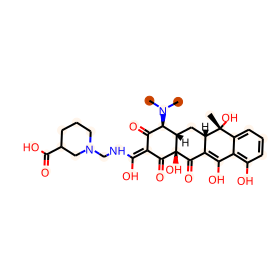

BBBP:0
prediction: [ 0.20175509 -0.51456684]
CC(=O)OCOC(=O)C1N2C(=O)C(NC(=O)Cc3ccccc3)C2SC1(C)C


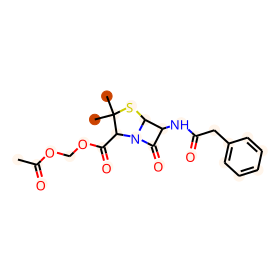

BBBP:0
prediction: [ 1.2158098 -1.6459   ]
CC1(C)SC2C(NC(=O)Cc3ccccc3)C(=O)N2C1C(=O)O.[Na]


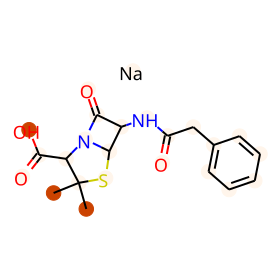

BBBP:0
prediction: [ 1.2508378 -1.723177 ]
CC(Oc1ccccc1)C(=O)NC1C(=O)N2C1SC(C)(C)C2C(=O)O


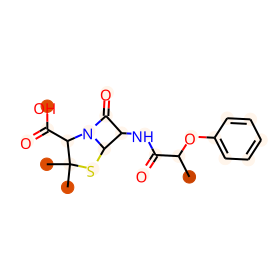

BBBP:0
prediction: [ 1.3578258 -1.955184 ]
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](NC(=O)c3ccc(-c4ccc(S(=O)(=O)N(CCO)CCO)cc4)[nH]c3=O)c3ccc(O)cc3)C(=O)N2[C@H]1C(=O)[O-].[Na+]


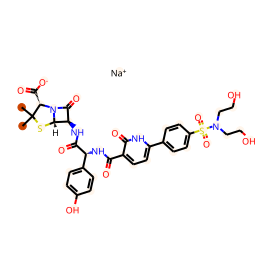

BBBP:0
prediction: [ 1.4703836 -2.2081773]
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](NC(=O)Nc3cnc(Nc4ccc(S(N)(=O)=O)cc4)[nH]c3=O)c3ccc(O)cc3)C(=O)N2[C@H]1C(=O)O


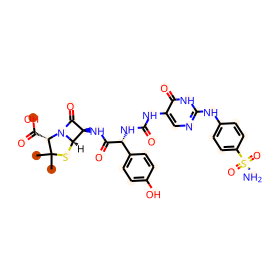

BBBP:0
prediction: [ 2.0398962 -2.7077835]
CC(C)(C)C(=O)OCOC(=O)[C@@H]1N2C(=O)[C@@H](NC(=O)[C@H](N)c3ccccc3)[C@H]2SC1(C)C


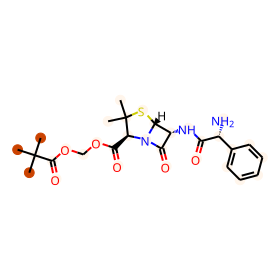

BBBP:0
prediction: [ 0.39879003 -0.6851769 ]
CNCC(O)c1cccc(OC(=O)C(C)(C)C)c1


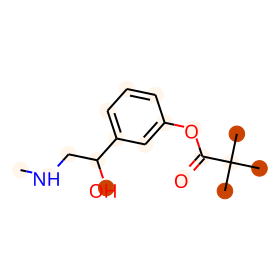

BBBP:0
prediction: [ 1.1866297 -1.7885875]
Cc1cnn(-c2c(Cl)cccc2Cl)c1C(=O)N[C@@H]1C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@H]12


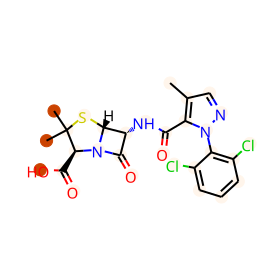

BBBP:0
prediction: [ 1.4975446 -2.156604 ]
CC1NC(=O)C(NC(=O)c2ncccc2O)C(C)OC(=O)C(c2ccccc2)NC(=O)C2CC(=O)CCN2C(=O)C(Cc2ccc(N(C)C)cc2)N(C)C(=O)C2CCCN2C1=O


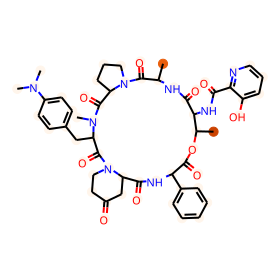

BBBP:0
prediction: [ 0.24679084 -0.45888278]
CCCNCC(O)COc1ccccc1C(=O)CCc1ccccc1


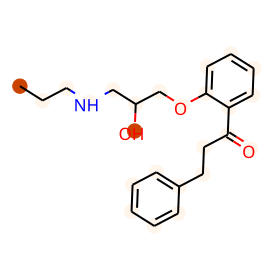

BBBP:0
prediction: [ 1.2537344 -1.7265563]
CCC(Oc1ccccc1)C(=O)NC1C(=O)N2C1SC(C)(C)C2C(=O)O


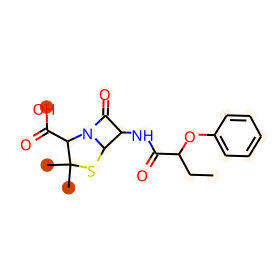

BBBP:0
prediction: [ 1.422856  -2.0982482]
CC1(C)S[C@@H]2[C@H](NC(=O)c3nc4ccccc4nc3C(=O)O)C(=O)N2[C@H]1C(=O)O


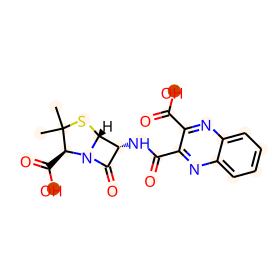

BBBP:0
prediction: [ 2.1848106 -3.194729 ]
CCN(CC)C(C)=NN=Cc1c2c(O)c3c(O)c(C)c4c(c3c1O)C(=O)C(C)(OC=CC(OC)C(C)C(OC(C)=O)C(C)C(O)C(C)C(O)C(C)C=CC=C(C)C(=O)N2)O4


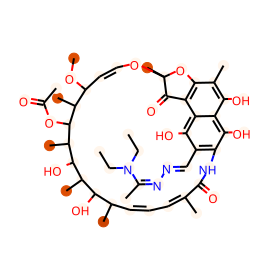

BBBP:0
prediction: [ 2.5705886 -3.5895584]
CCN(CC)c1nc2c(s1)c1c(O)c3c(O)c(C)c4c(c32)C(=O)[C@@](C)(O/C=C/[C@H](OC)[C@@H](C)[C@@H](OC(C)=O)[C@H](C)[C@H](O)[C@H](C)[C@@H](O)[C@@H](C)/C=C/C=C(/C)C(=O)N1)O4


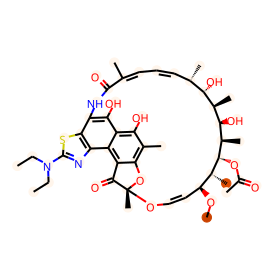

BBBP:0
prediction: [ 2.6481104 -3.6617656]
CCN(CC)C(=O)COc1cc2c(O)c3c(O)c(C)c4c(c13)C(=O)[C@@](C)(O/C=C/[C@H](OC)[C@@H](C)[C@@H](OC(C)=O)[C@H](C)[C@H](O)[C@H](C)[C@@H](O)[C@@H](C)/C=C/C=C(/C)C(=O)N2)O4


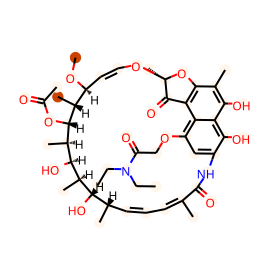

BBBP:0
prediction: [ 1.8230501 -2.7809918]
COC1C=COC2(C)Oc3c(C)c(O)c4c(O)c(c(C=NN5CCN(C)CC5)c(O)c4c3C2=O)NC(=O)C(C)=CC=CC(C)C(O)C(C)C(O)C(C)C(OC(C)=O)C1C


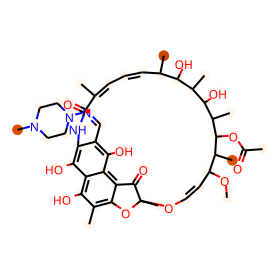

BBBP:0
prediction: [ 2.598578  -3.5739048]
CO[C@H]1/C=C/O[C@@]2(C)Oc3c(C)c(O)c4c(O)c(cc(O)c4c3C2=O)NC(=O)/C(C)=C\C=C\[C@H](C)[C@H](O)[C@@H](C)[C@@H](O)[C@@H](C)[C@H](OC(C)=O)[C@@H]1C


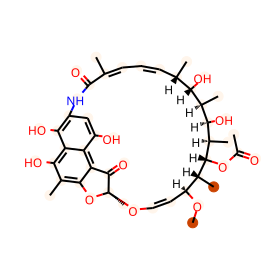

BBBP:0
prediction: [ 2.1587138 -3.137225 ]
CO[C@H]1/C=C/O[C@@]2(C)Oc3c(C)c(O)c4c(c3C2=O)C(=O)/C(=C/NN2CCN(C3CCCC3)CC2)C(=C4O)NC(=O)/C(C)=C\C=C\[C@H](C)[C@H](O)[C@@H](C)[C@@H](O)[C@@H](C)[C@H](OC(C)=O)[C@@H]1C


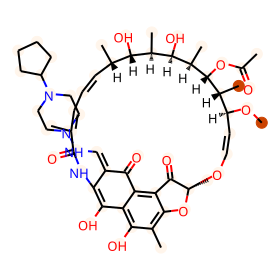

BBBP:0
prediction: [ 2.432716  -3.4565005]
CO[C@H]1/C=C/O[C@@]2(C)Oc3c(C)c(O)c4c(O)c(c5c(nc6cc(C)ccn65)c4c3C2=O)NC(=O)/C(C)=C\C=C\[C@H](C)[C@H](O)[C@@H](C)[C@@H](O)[C@@H](C)[C@H](OC(C)=O)[C@@H]1C


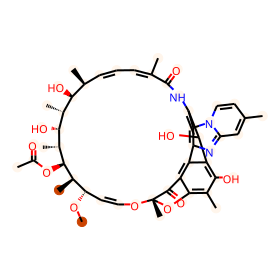

BBBP:0
prediction: [ 1.0769831 -1.4541192]
C[C@@H](O)[C@H]1C(=O)N2C(C(=O)[O-])=C(COC(N)=O)S[C@H]12.[Na+]


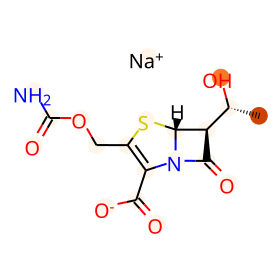

BBBP:0
prediction: [ 2.140153  -3.1860495]
CC[C@@]1(O)C[C@H](O[C@H]2C[C@H](N(C)C)[C@H](O[C@H]3C[C@@H]4O[C@H]5CC(=O)[C@H](C)O[C@H]5O[C@@H]4[C@H](C)O3)[C@H](C)O2)c2c(O)c3c(c(O)c2[C@H]1O[C@H]1C[C@H](N(C)C)[C@H](O)[C@H](C)O1)C(=O)c1cccc(O)c1C3=O


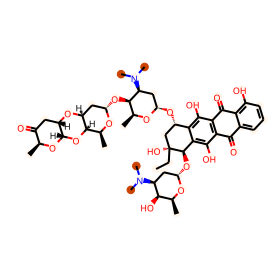

BBBP:0
prediction: [ 1.6590773 -2.2691514]
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](NC(=O)Cc3ccc(C4=NCCCN4)cc3)c3ccccc3)C(=O)N2[C@H]1C(=O)O


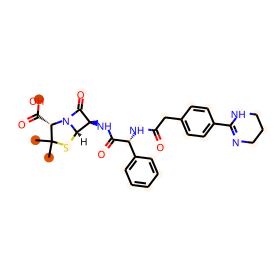

BBBP:0
prediction: [ 1.9759204 -3.1757588]
CC[C@H]1OC(=O)[C@H](C)[C@@H](O[C@H]2C[C@@](C)(OC)[C@@H](O)[C@H](C)O2)[C@H](C)[C@@H](O[C@@H]2O[C@H](C)C[C@H](N(C)C)[C@H]2O)[C@](C)(O)C[C@@H](C)/C(=N/OCOCCOC)[C@H](C)[C@@H](O)[C@]1(C)O


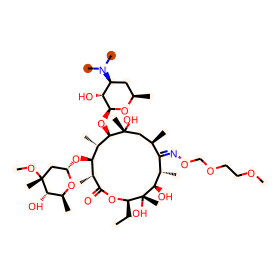

BBBP:0
prediction: [-0.2406884  -0.01447461]
COC1CCCC2C1=C(C(=O)[O-])N1C(=O)C(C(C)O)C21


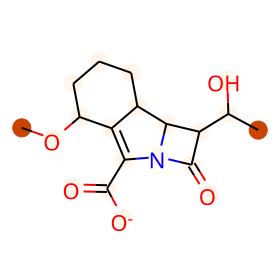

BBBP:0
prediction: [ 1.7495962 -2.2957013]
COCOC(=O)C1N2C(=O)C(N3C(=O)C(c4ccc(O)cc4)NC3(C)C)C2SC1(C)C


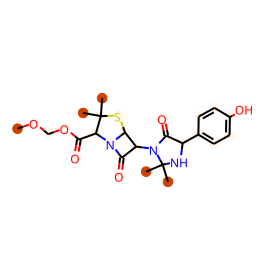

BBBP:0
prediction: [ 1.8293597 -2.3979247]
COCOC(=O)[C@@H]1N2C(=O)[C@@H](N3C(=O)C(c4ccccc4)NC3(C)C)[C@H]2SC1(C)C


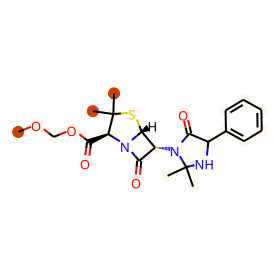

BBBP:0
prediction: [ 0.15056606 -0.7197027 ]
CC(=O)OC1/C=C/C(C)=C/CC(O)/C=C/C(C)=C/C(NC(=O)C(C)=O)C2(C)C(=O)OC(C1)C(C)C2=O


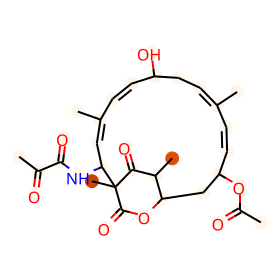

BBBP:0
prediction: [ 1.2400664 -1.9088358]
CC1(C)S[C@@H]2[C@H](NC(=O)C(c3ccccc3)S(=O)(=O)O)C(=O)N2[C@H]1C(=O)O


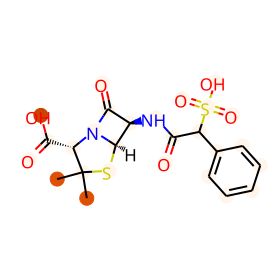

BBBP:0
prediction: [ 1.6291081 -2.703313 ]
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](N)c3ccccc3)C(=O)N2[C@H]1C(=O)O.CC1(C)[C@H](C(=O)O)N2C(=O)C[C@H]2S1(=O)=O


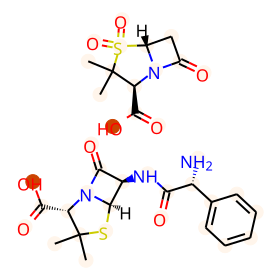

BBBP:0
prediction: [ 1.7036246 -2.2663739]
CC1(C)S[C@@H]2[C@H](NC(=O)[C@H](NS(=O)(=O)[O-])c3ccccc3)C(=O)N2[C@H]1C(=O)[O-].[Na+].[Na+]


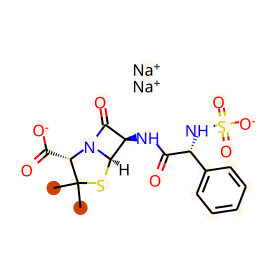

BBBP:0
prediction: [ 1.959788  -2.8537266]
C=CC[C@@H]1/C=C(\C)C[C@H](C)C[C@H](OC)[C@H]2O[C@@](O)(C(=O)C(=O)N3CCCC[C@H]3C(=O)O[C@H](/C(C)=C/[C@@H]3CC[C@@H](O)[C@H](OC)C3)[C@H](C)[C@@H](O)CC1=O)[C@H](C)C[C@@H]2OC


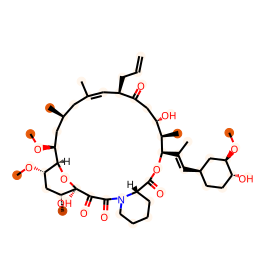

BBBP:0
prediction: [ 1.1005794 -1.6781007]
C[C@]1(Cn2ccnn2)[C@H](C(=O)O)N2C(=O)C[C@H]2S1(=O)=O


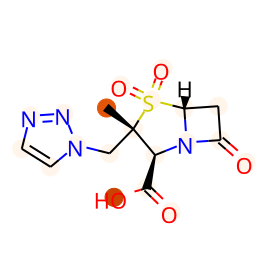

BBBP:0
prediction: [ 1.6857488 -2.445309 ]
CO[C@@]1(NC(=O)C(C(=O)O)c2ccsc2)C(=O)N2[C@@H](C(=O)O)C(C)(C)S[C@@H]21


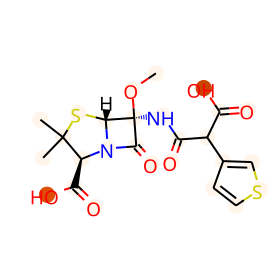

BBBP:0
prediction: [ 0.80169666 -1.2802866 ]
Cn1c(=O)c2c(ncn2CCNCC(O)c2ccc(O)c(O)c2)n(C)c1=O


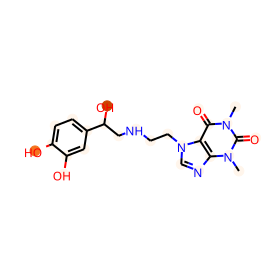

BBBP:0
prediction: [ 1.2265868 -1.6752646]
CC1(C)SC2C(NC(=O)CSc3ccccc3)C(=O)N2C1C(=O)O


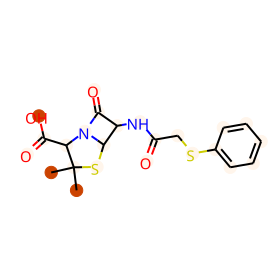

BBBP:0
prediction: [ 0.89088714 -1.3326991 ]
CC1(C)[C@H](NC(=O)/C(=N\OCC(=O)O)c2csc(N)n2)C(=O)N1OS(=O)(=O)O


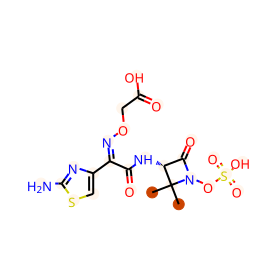

BBBP:0
prediction: [ 0.8907399 -1.9436107]
CO[C@H]1C[C@H](O[C@@H]2[C@@H](C)C(=O)O[C@H](C)[C@H](C)[C@H](OC(C)=O)[C@@H](C)C(=O)[C@]3(CO3)C[C@H](C)[C@H](O[C@@H]3O[C@H](C)C[C@H](N(C)C)[C@H]3OC(C)=O)[C@H]2C)O[C@@H](C)[C@@H]1OC(C)=O


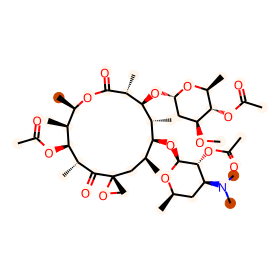

BBBP:0
prediction: [ 1.4207243 -1.9767519]
CCCC[C@@H]1CC(=O)[C@]2(O)O[C@@H]3[C@@H](NC)[C@@H](O)[C@@H](NC)[C@H](O)[C@H]3O[C@@H]2O1


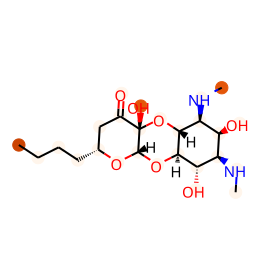

BBBP:0
prediction: [-0.4960525   0.32604966]
Cc1ccc(C(C)C)c(OCC2=NCCN2)c1


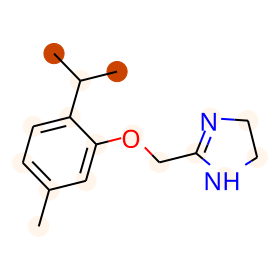

BBBP:0
prediction: [-1.0103381  0.4028257]
CC[C@]1(O)C[C@H]2CN(CCc3c([nH]c4ccccc34)[C@@](C(=O)OC)(c3cc4c(cc3OC)N(C)[C@H]3[C@@](O)(C(N)=O)[C@H](O)[C@]5(CC)C=CCN6CC[C@]43[C@@H]65)C2)C1


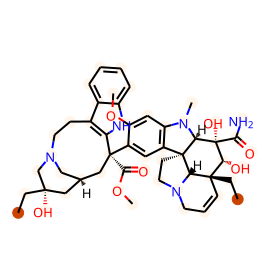

BBBP:0
prediction: [ 0.96654135 -1.2183267 ]
[C-]#[N+]C(=C\c1ccc(O)cc1)/C(=C/c1ccc(O)cc1)[N+]#[C-]


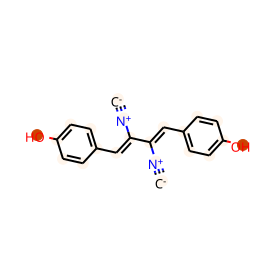

BBBP:0
prediction: [ 1.4462914 -2.0901234]
COc1cccc2c1C(=O)c1c(O)c3c(c(O)c1C2=O)C[C@@](O)(/C(C)=N/NC(=O)c1ccccc1)C[C@@H]3O[C@H]1C[C@H](N)[C@H](O)[C@H](C)O1.[Cl-].[H+]


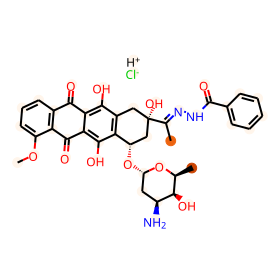

BBBP:1
prediction: [-3.4037828  3.3239524]
FC(F)(Cl)C(F)(F)Cl


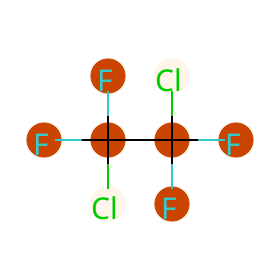

BBBP:1
prediction: [-2.0963569  2.0316179]
C[C@H]1CCCC[C@@]1(c1cccs1)N1CCCCC1


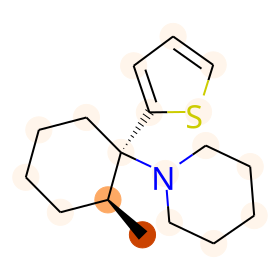

BBBP:1
prediction: [-1.6933109  1.5154326]
CC(Cc1ccccc1)NCCn1cnc2c1c(=O)n(C)c(=O)n2C.[Cl-].[H+]


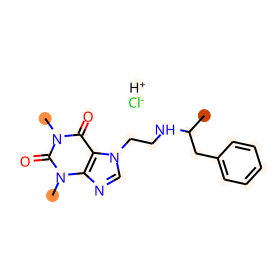

BBBP:1
prediction: [-2.7249994  2.6927676]
CC(=O)NCCCN1CCN(c2cc(Cl)ccc2Cl)CC1


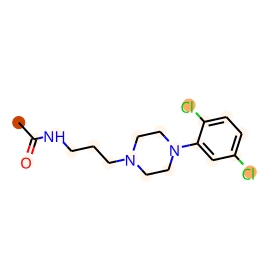

BBBP:1
prediction: [-4.2258544  3.8278906]
CC(=O)OC1CC[C@@]2(C)C([C@@H]1Br)[C@H](Br)C[C@@H]1[C@@H]2CC[C@@]2(C)[C@H]1CC[C@@H]2[C@H](C)CCCC(C)C


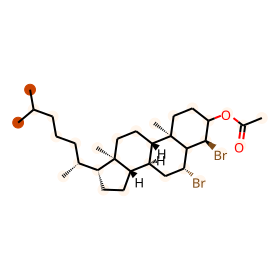

BBBP:1
prediction: [-2.1715937  2.0769238]
CCC(Br)(CC)C(=O)NC(=O)NC(C)=O


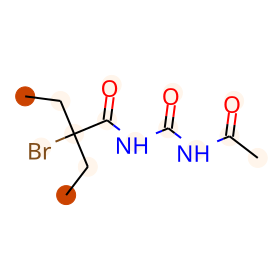

BBBP:1
prediction: [-0.53290117  0.24681932]
CC(=O)OCC(=O)OCC/C(SC(=O)c1ccco1)=C(/C)N(C=O)Cc1cnc(C)nc1N


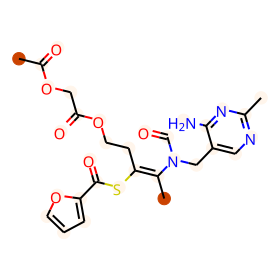

BBBP:1
prediction: [-0.08156982 -0.09447335]
CC(=O)NC(CCC(N)=O)C(=O)O


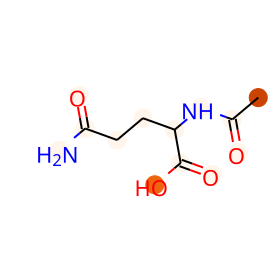

BBBP:1
prediction: [-0.6182611   0.49187377]
CC(=O)Nc1ccc(OC(=O)c2ccccc2O)cc1


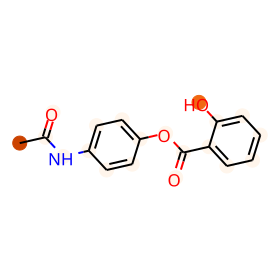

BBBP:1
prediction: [-0.26766232  0.10386714]
CC(=O)Nc1nnc(S(N)(=O)=O)s1


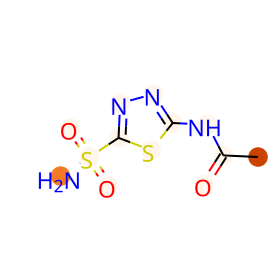

BBBP:1
prediction: [-2.4065568  2.2639208]
CC(=O)OCC/C(SC(C)=O)=C(/C)N(C=O)Cc1cnc(C)nc1N


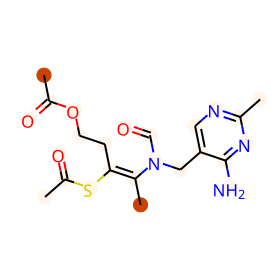

BBBP:1
prediction: [-0.86162406  0.7248393 ]
CC(=O)SCC(Cc1ccccc1)C(=O)NCC(=O)OCc1ccccc1


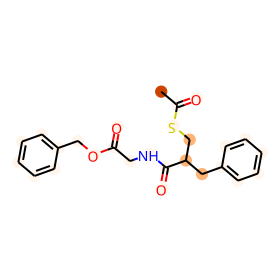

BBBP:1
prediction: [-4.685649   4.3870206]
CCC[C@@](C)(O)[C@H]1CC23C=CC1(OC)[C@H]1Oc4c(OC(C)=O)ccc5c4C12CCN(C)C3C5


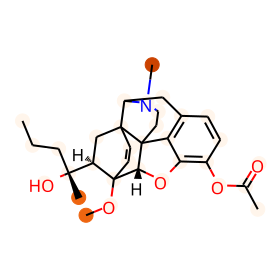

BBBP:1
prediction: [-2.1833873  1.8536527]
CC(=O)OCC1=CO[C@@H](OC(=O)CC(C)C)[C@H]2C1=C[C@H](OC(=O)CC(C)(C)OC(C)=O)[C@]21CO1


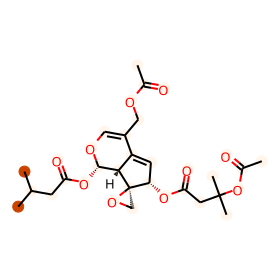

BBBP:1
prediction: [-0.0535439  -0.10072056]
Nc1nc(=O)c2ncn(COCCO)c2[nH]1


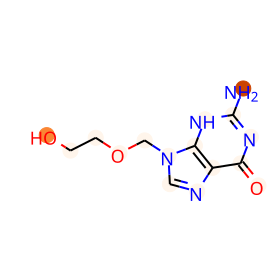

BBBP:1
prediction: [-2.0737267  2.011873 ]
O=C(COc1ccc(Cl)cc1)OCCNC12CC3CC(CC(C3)C1)C2


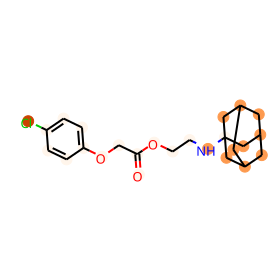

BBBP:1
prediction: [-3.0550027  3.038833 ]
O=C(NCCN1CCN(c2ncccn2)CC1)C12CC3CC(CC(C3)C1)C2


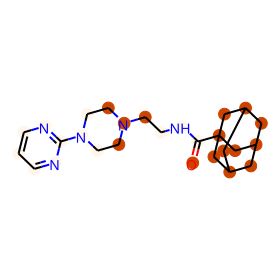

BBBP:1
prediction: [-1.815038   1.6881442]
CC(N)C(=O)OC(C)(C)Cc1ccc(Cl)cc1


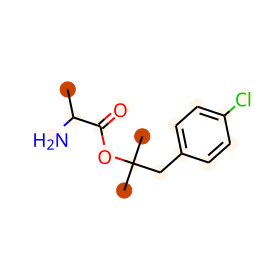

BBBP:1
prediction: [-4.2708616  3.9364808]
CCC(=O)OCC(=O)[C@@]1(OC(=O)CC)[C@H](C)C[C@H]2[C@H]3[C@H]([C@@H](O)C[C@@]21C)[C@@]1(C)C=CC(=O)C=C1C[C@H]3Cl


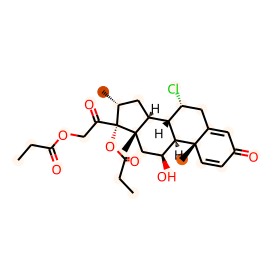

BBBP:1
prediction: [-1.3677263  1.2317506]
CCCN(CCC)C1Cc2cccc3cc(O)cc(c23)C1


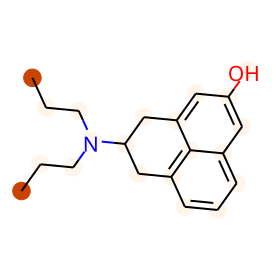

BBBP:1
prediction: [-1.3146924  1.0716298]
CC12CC(=O)[C@H]3C(CC[C@H]4C[C@H](O)CCC43C)[C@@H]1CCC2C(=O)CO


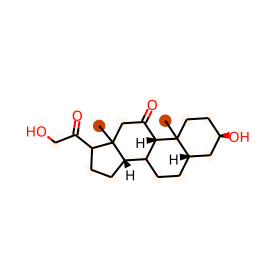

BBBP:1
prediction: [-1.0604864  0.828881 ]
CC(=O)[C@H]1CC[C@H]2[C@@H]3CC[C@H]4C[C@H](O)CC[C@]4(C)[C@H]3C(=O)C[C@]12C


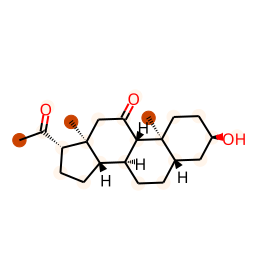

BBBP:1
prediction: [-4.3769484  4.123062 ]
CC(=O)C12OC(C)(C)OC1CC1C3CCC4=CC(=O)CCC4(C)C3CCC12C


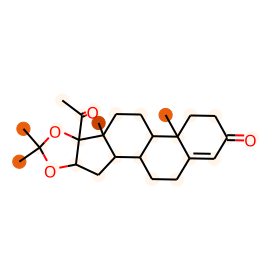

BBBP:1
prediction: [-4.058443   3.9495342]
COC1(F)C(F)(F)C1(F)Cl


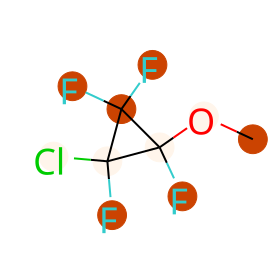

BBBP:1
prediction: [-3.4400358  3.1582508]
C=CCN1CCC23c4c5ccc(O)c4OC2C2(OC)C=CC3(CC2[C@](C)(O)CCC)C1C5


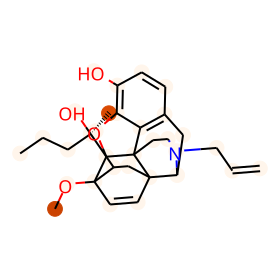

BBBP:1
prediction: [-2.2332284  2.1819975]
CNC[C@@H]1CN(c2ccc(OCc3cccc(Cl)c3)cc2)C(=O)O1


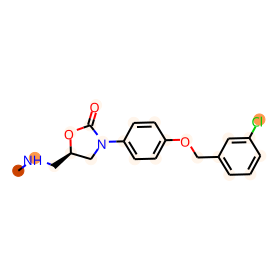

BBBP:1
prediction: [-1.903703   1.8201382]
CC(=O)NCCn1c(C)cc(C=O)c1C


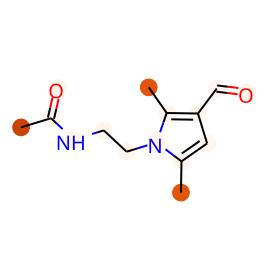

BBBP:1
prediction: [-0.89981186  0.68778336]
C=CCN1CCCC1CNC(=O)c1cc(S(=O)(=O)NC)c(N)cc1OC


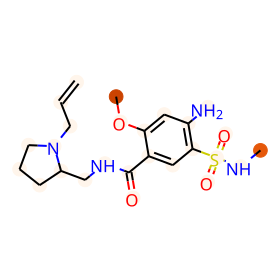

BBBP:1
prediction: [-0.4054612   0.23541173]
O=C(O)CN1C(=O)c2cccc3cccc(c23)C1=O


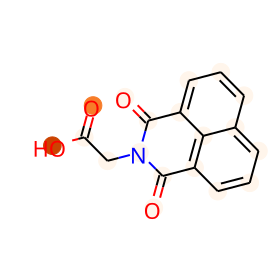

BBBP:1
prediction: [-3.9948168  3.6589952]
CC12C[C@H](O)[C@@]3(F)C(CCC4=CC(=O)C=CC43C)[C@@H]1C[C@H]1O[C@@](C)(c3ccccc3)O[C@]12C(=O)CO


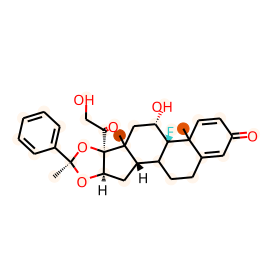

BBBP:1
prediction: [-3.7221231  3.4460785]
CC(=O)OCC(=O)[C@@]12OC3(CCCC3)O[C@@H]1C[C@H]1[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]12C


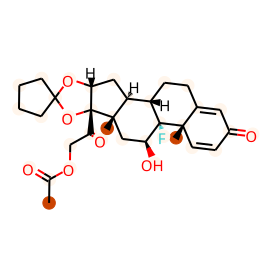

BBBP:1
prediction: [-3.518571  3.204485]
CCC(=O)O[C@]1(C(=O)COC)[C@@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


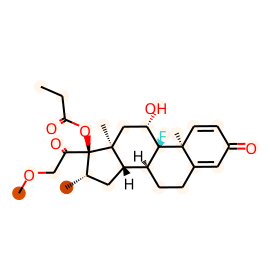

BBBP:1
prediction: [-2.7923942  2.5759592]
CC(C)n1cc2c3c(cccc31)C1C[C@@H](C(=O)NC3CCCCC3)CN(C)C1C2


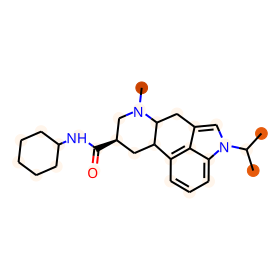

BBBP:1
prediction: [-0.618177   0.4904898]
CC(Cc1ccccc1)NC(C#N)c1ccccc1


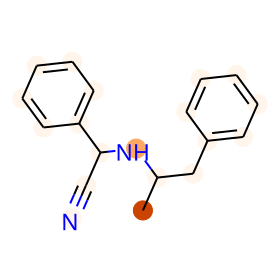

BBBP:1
prediction: [-0.27987975  0.10193988]
O=C(O)CCCCCC[NH2+]C1c2ccccc2CCc2ccccc21.[Cl-]


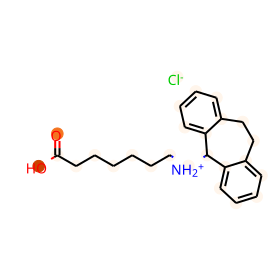

BBBP:1
prediction: [-1.3698014  1.187542 ]
CCN1CCCC1CNC(=O)c1cc(S(=O)(=O)CC)c(N)cc1OC


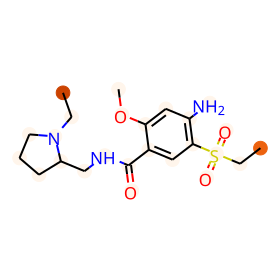

BBBP:1
prediction: [-0.40265244  0.15236425]
C[N+](C)([O-])CCC=C1c2ccccc2CCc2ccccc21


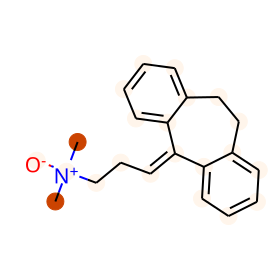

BBBP:1
prediction: [-1.5148822  1.4109373]
CC(C)CCOC(CN1CCCC1)c1ccccc1


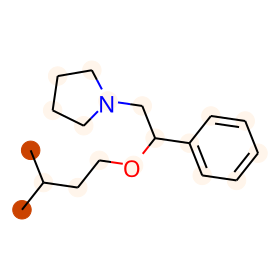

BBBP:1
prediction: [-1.901839   1.7713225]
CCNC(=O)N1CCN(CCCC(c2ccc(F)cc2)c2ccc(F)cc2)CC1


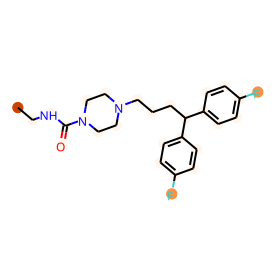

BBBP:1
prediction: [-0.9523171   0.89721626]
Nc1cccc(-n2ccccc2=O)c1


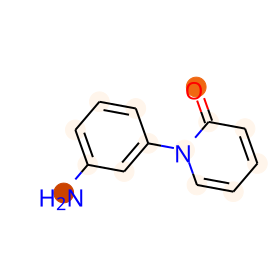

BBBP:1
prediction: [-1.469695   1.4235237]
CN(C)c1cnccn1


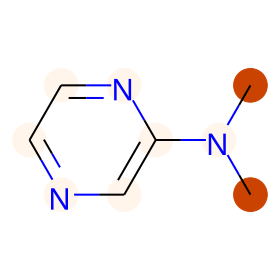

BBBP:1
prediction: [-1.4339229  1.3508135]
CCC(C)(C)O


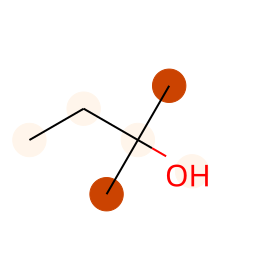

BBBP:1
prediction: [-1.9905392  1.9341383]
CCOC(=O)C1(c2ccccc2)CCN(CCc2ccc(N)cc2)CC1


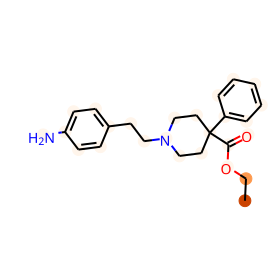

BBBP:1
prediction: [-2.1320195  2.1158433]
COc1ccc(C(=O)N2CCCC2=O)cc1


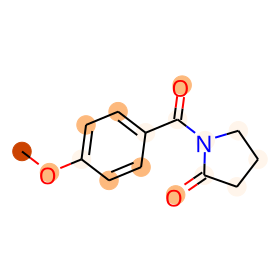

BBBP:1
prediction: [-2.143458   1.9643812]
COc1cc2oc(=O)c(C)c(C)c2cc1OCCCN1CCN(c2ccccc2OC)CC1


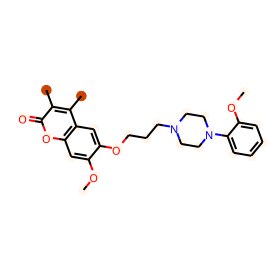

BBBP:1
prediction: [-2.447689   2.3206384]
CCCNC(=O)c1ccc2c(c1)N([C@H](C)CN1CCCC1)c1ccccc1S2


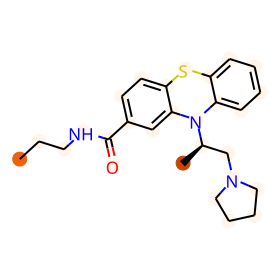

BBBP:1
prediction: [-1.3307555  1.2145878]
C=CCC1(C(C)C)C(=O)NC(=O)NC1=O


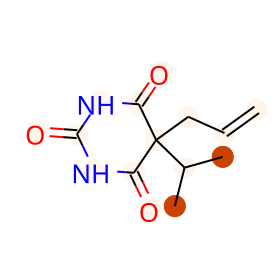

BBBP:1
prediction: [-0.13681142 -0.04641809]
O=C1C(O)=C(O)OC1C(O)CO


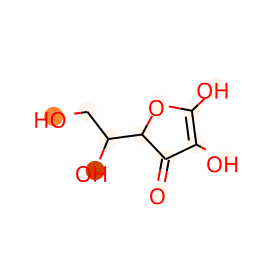

BBBP:1
prediction: [ 0.2790028  -0.48900044]
CC(=O)Oc1ccccc1C(=O)O


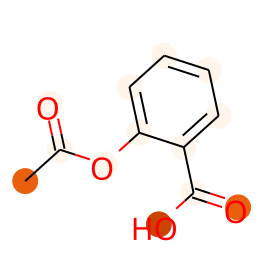

BBBP:1
prediction: [-2.7629118  2.6674263]
CN1C2CCC1CC(OC(=O)C(C)(CO)c1ccccc1)C2


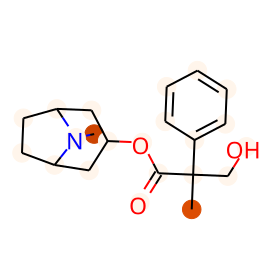

BBBP:1
prediction: [ 0.66388977 -1.0923665 ]
C[N+]1([O-])C2CCC1CC(OC(=O)C(CO)c1ccccc1)C2


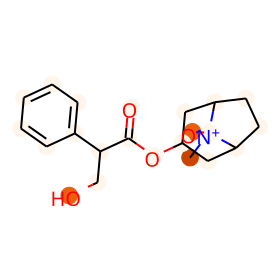

BBBP:1
prediction: [-1.6431137  1.5245221]
O=c1[nH]c2cc(Cl)ccc2n1C1CCN(CC2COc3ccccc3O2)CC1


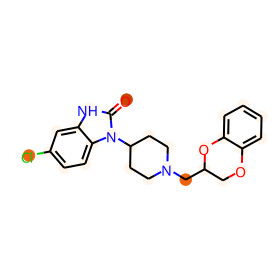

BBBP:1
prediction: [-2.6140985  2.5833018]
O=C(CCCN1CCN2CCCC2C1)c1ccc(F)cc1


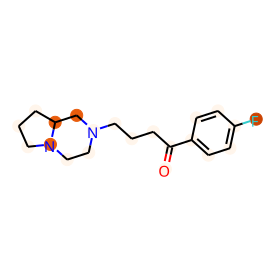

BBBP:1
prediction: [-0.45059943  0.34918424]
OC(c1ccccc1)(c1ccccc1)C1CCNCC1


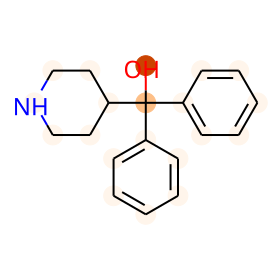

BBBP:1
prediction: [-2.395218   2.4114282]
c1ccc2c(c1)CCN1CCNCC21


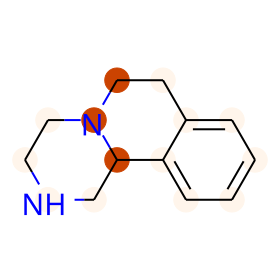

BBBP:1
prediction: [-1.9939548  2.0049934]
c1ccc2c(c1)cc1n2CCCNC1


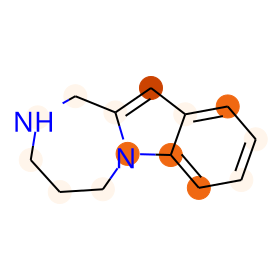

BBBP:1
prediction: [-2.9536629  2.9255762]
CN(CCc1cc2cccc3c2n1-c1ccccc1CC3)Cc1ccccc1


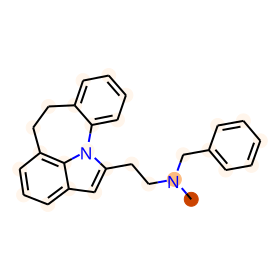

BBBP:1
prediction: [-0.21027881 -0.0340184 ]
O=c1[nH]c2ccccc2c(=O)n1CCN1C[C@H]2C[C@H](c3ccc(F)cc3)[C@H]2C1


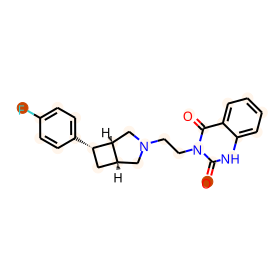

BBBP:1
prediction: [-0.1676793  -0.11921247]
CCN(CCO)CCn1c(Cc2ccccc2)nc2c1c(=O)n(C)c(=O)n2C


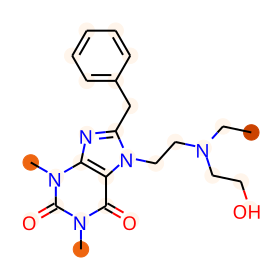

BBBP:1
prediction: [-1.2939142  1.203694 ]
CCC1(CC)C(=O)NC(=O)NC1=O


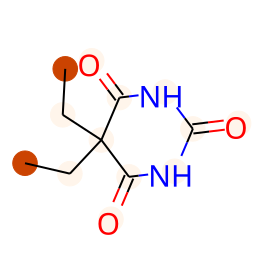

BBBP:1
prediction: [-3.435998   3.4151897]
Cc1nc2n(n1)C(N1CCN(C)CC1)=Nc1ccccc1C2


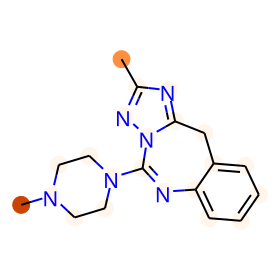

BBBP:1
prediction: [-1.9047884  1.9097699]
O=C(CCCl)NCc1ccccc1


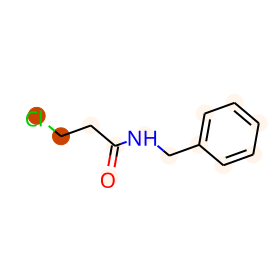

BBBP:1
prediction: [-0.4654826   0.06170255]
C[C@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(Cl)[C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)CO


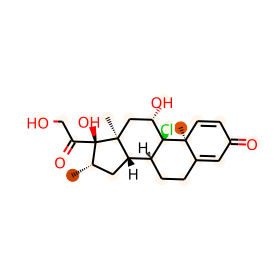

BBBP:1
prediction: [-1.7493314  1.5346211]
COC[C@H]1CN(c2ccc(OCC[C@@H](O)C(F)(F)F)cc2)C(=O)O1


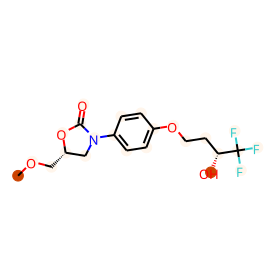

BBBP:1
prediction: [-0.19877954 -0.10712405]
C/C(=C(\CCOP(=O)(O)O)SC(=O)c1ccccc1)N(C=O)Cc1cnc(C)nc1N


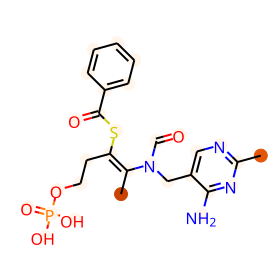

BBBP:1
prediction: [-1.6651584  1.5728755]
CC(=O)Nc1ccc(OC(=O)c2ccccc2OC(C)=O)cc1


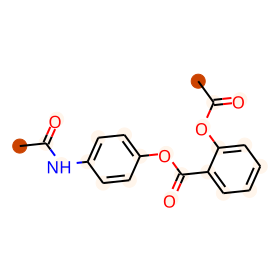

BBBP:1
prediction: [-2.128125   2.1201546]
O=C1CNC(c2ccccc2)=c2c3c(sc2=N1)CCCC3


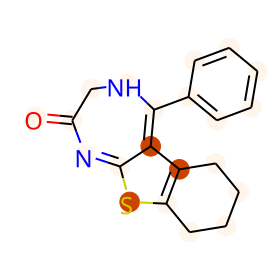

BBBP:1
prediction: [-0.23364408 -0.04905593]
C/C(=C(\CCOC(=O)c1ccccc1)SC(=O)c1ccccc1)N(C=O)Cc1cnc(C)nc1N


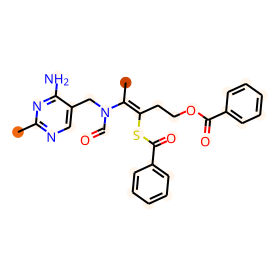

BBBP:1
prediction: [-0.50105053  0.23202667]
C[N+](C)([O-])CC/C=C1/c2ccccc2C=Cc2c(Cl)cccc21


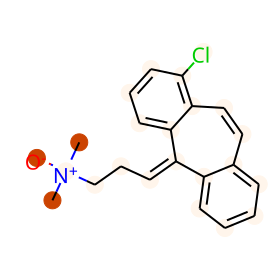

BBBP:1
prediction: [-0.327169    0.23003706]
[Cl].c1ccc(Cn2cc(CCc3ccncc3)c3ccccc32)cc1


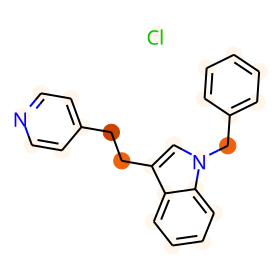

BBBP:1
prediction: [-0.24842572  0.13839576]
OCc1ccccc1


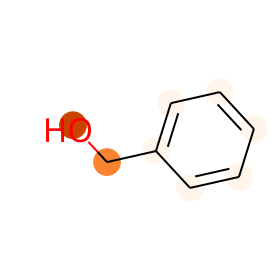

BBBP:1
prediction: [-1.9000506  1.7751982]
CN1CCc2cc(Cl)c(O)cc2[C@@H](c2cc(Br)cc3c2OCC3)C1


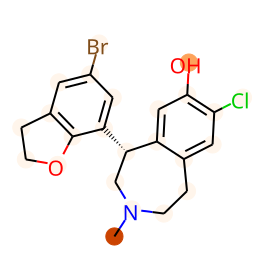

BBBP:1
prediction: [-1.5791377  1.3576458]
CCOC(=O)C[C@@H](O)C[C@@H](O)/C=C/C1=C(c2ccc(F)cc2)c2ccccc2OC12CCCC2


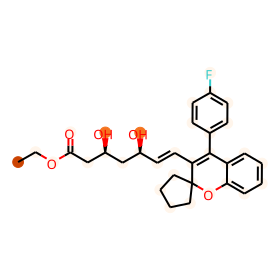

BBBP:1
prediction: [-2.2183523  1.8700793]
C[C@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@@]1(OC(=O)c1ccccc1)C(=O)CO


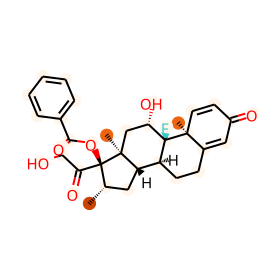

BBBP:1
prediction: [-2.3030252  1.9527409]
CCCCC(=O)O[C@]1(C(=O)CO)[C@@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


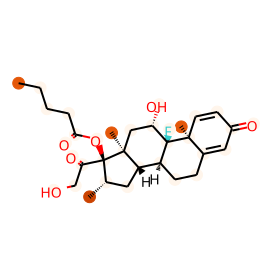

BBBP:1
prediction: [-2.9237742  2.8656633]
O=C(CCCN1CCN2Cc3[nH]c4ccccc4c3CC2C1)c1ccc(F)cc1


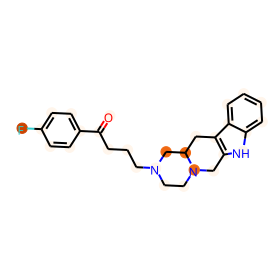

BBBP:1
prediction: [-1.8482333  1.5126107]
C/C(=C(/CCOC(=O)c1ccccc1)SS/C(CCOC(=O)c1ccccc1)=C(\C)N(C=O)Cc1cnc(C)nc1N)N(C=O)Cc1cnc(C)nc1N


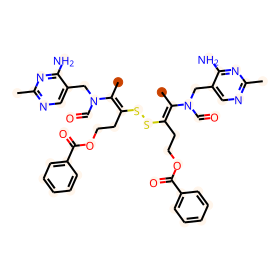

BBBP:1
prediction: [ 0.46601167 -0.7277376 ]
CC(=O)NCCC[C@H](NC(C)=O)C(=O)O


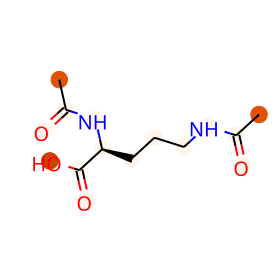

BBBP:1
prediction: [-2.8098772  2.7477872]
CCN1CCN(c2cc(-c3ccc(F)cc3)c3c(n2)CCCCCC3)CC1


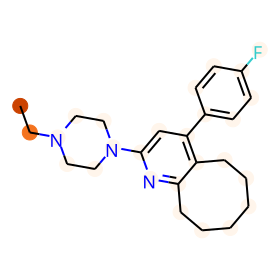

BBBP:1
prediction: [-1.6565913  1.465147 ]
CC[C@]12CCN(CC3(O)CC3)[C@H](Cc3ccc(O)cc31)C2(C)C


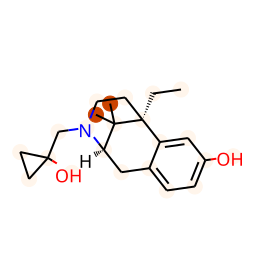

BBBP:1
prediction: [-1.7219249  1.639766 ]
CC1(C)OC(=O)Nc2ccc(Br)cc21


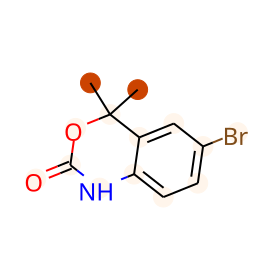

BBBP:1
prediction: [-1.5053811  1.3949783]
CC(C)C(Br)C(=O)NC(N)=O


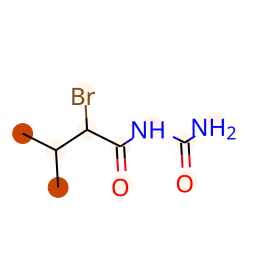

BBBP:1
prediction: [-1.5643262  1.4992926]
BrC(Br)Br


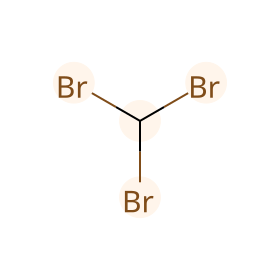

BBBP:1
prediction: [-1.0022178  0.897961 ]
Cc1cc(Br)cc(C(N)=O)c1O


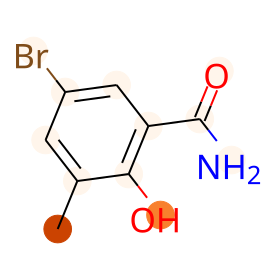

BBBP:1
prediction: [-1.3568174  1.3061652]
O=C1CC(c2cccc(Br)c2)C(=O)N1


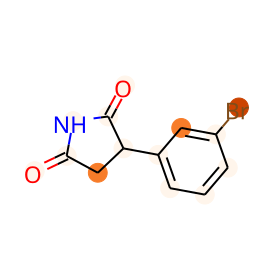

BBBP:1
prediction: [-3.23696    3.2044852]
Cc1nnc2n1-c1sc(Br)cc1C(c1ccccc1Cl)=NC2


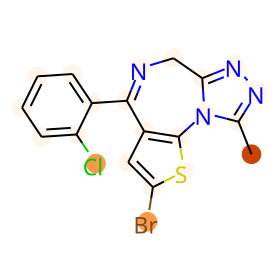

BBBP:1
prediction: [ 0.60641366 -0.93420434]
Nc1nc(=O)c2ncn(CC[C@@H](O)CO)c2[nH]1


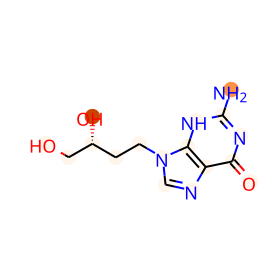

BBBP:1
prediction: [-1.4841107  1.3645077]
CC(=O)Nc1ccc(OC(C)(C)C)cc1


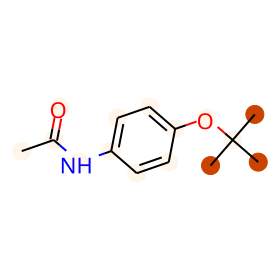

BBBP:1
prediction: [-2.1177447  1.9369382]
CC(C)(C)[C@]1(O)CCN2C[C@H]3c4ccccc4CCc4cccc(c43)[C@@H]2C1.[Cl-].[H+]


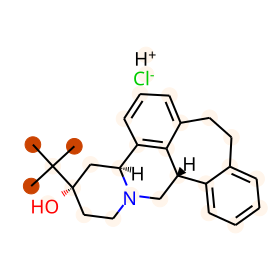

BBBP:1
prediction: [-2.8079975  2.7205317]
CCCC(=O)c1ccc2c(c1)N(CCCN1CCN(C)CC1)c1ccccc1S2


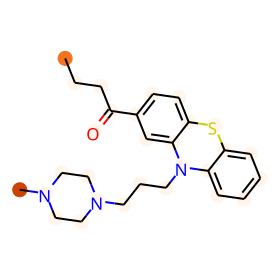

BBBP:1
prediction: [-1.627964  1.515589]
CCCCC(CC)CNC(=O)CC(C)O


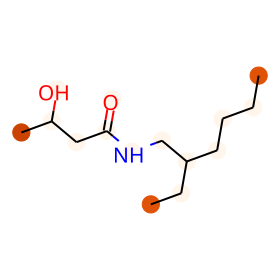

BBBP:1
prediction: [-0.8488686   0.67220044]
Oc1ccc2c(c1)[C@@]13CCCC[C@@]1(O)[C@@H](C2)N(CC1CCC1)CC3


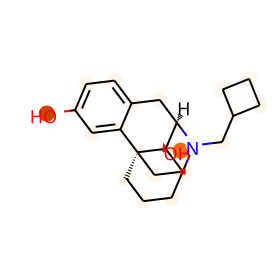

BBBP:1
prediction: [-0.11657097 -0.20877132]
CC(NCCn1cnc2c1c(=O)n(C)c(=O)n2C)C(O)c1ccccc1


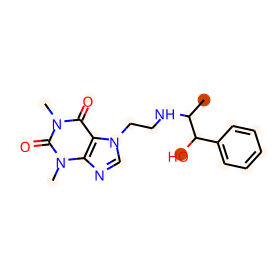

BBBP:1
prediction: [-2.8686233  2.7627084]
CN(C)C(=O)OC1N=C(c2ccccc2)c2cc(Cl)ccc2N(C)C1=O


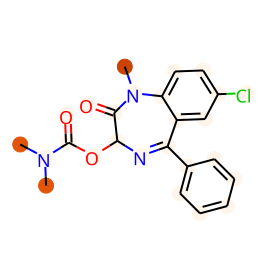

BBBP:1
prediction: [-1.4863375  1.4141048]
CCCCC/C(=N/OCCN)c1ccc(C)c(N)c1


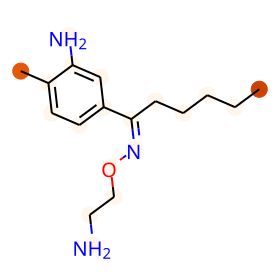

BBBP:1
prediction: [-1.5855161  1.5106525]
CCCCC1(CCOC(N)=O)C(=O)NC(=O)NC1=O


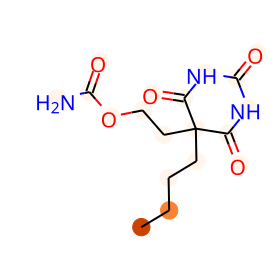

BBBP:1
prediction: [-1.0722612  0.9438609]
CN1C(=O)CN(C(N)=O)C(c2ccccc2)c2cc(Cl)ccc21


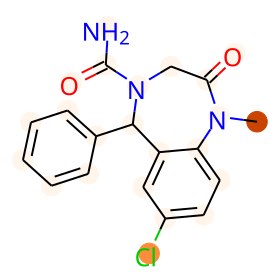

BBBP:1
prediction: [-1.7111459  1.6933384]
C#CC(OC(N)=O)c1ccccc1


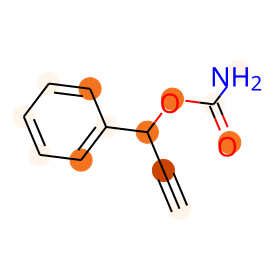

BBBP:1
prediction: [-1.8410436  1.6961963]
CC(C)NC(=O)OC1CCN(CCCC(=O)c2ccc(F)cc2)CC1


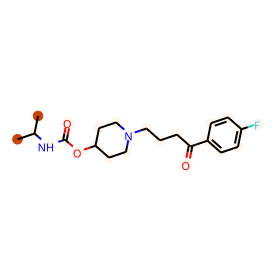

BBBP:1
prediction: [-2.5348444  2.452959 ]
CCC(=O)c1ccc2c(c1)N(CCCN1CCN(CCO)CC1)c1ccccc1S2


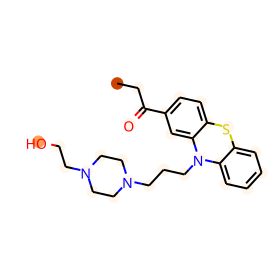

BBBP:1
prediction: [ 0.6512538  -0.94389534]
NS(=O)(=O)c1ccc(C(=O)O)cc1


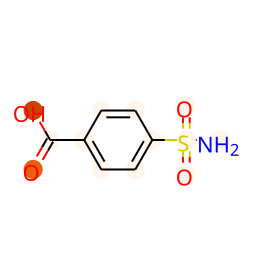

BBBP:1
prediction: [-1.0384066   0.96118474]
C[C@H](N)C(=O)c1ccccc1


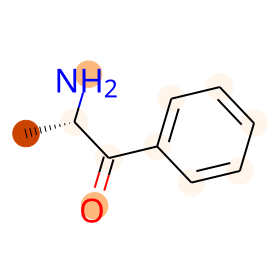

BBBP:1
prediction: [-1.48129    1.4136784]
O=C1CN(C(=O)CN2CC(c3ccc(Cl)cc3)CC2=O)CCN1


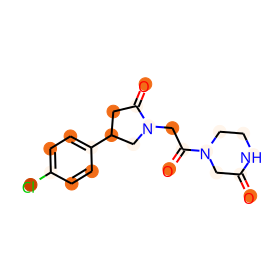

BBBP:1
prediction: [-2.2577965  1.2813814]
OC1OC(COCCOC(O)C(Cl)(Cl)Cl)C(OC2OC(COCCOCCOC(O)C(Cl)(Cl)Cl)CC(OC(O)C(Cl)(Cl)Cl)C2O)C(OCCOCCOC(O)C(Cl)(Cl)Cl)C1O


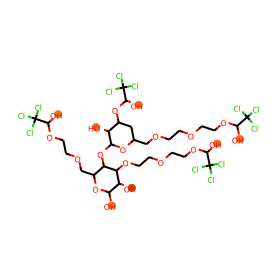

BBBP:1
prediction: [ 1.8109689 -2.4768016]
COCc1c(C(C)C)nc(C(C)C)c(/C=C/[C@@H](O)C[C@@H](O)CC(=O)O)c1-c1ccc(F)cc1


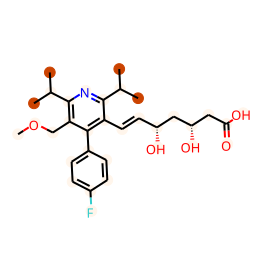

BBBP:1
prediction: [-0.4377966   0.31330696]
Cc1cc(C)c(=O)[nH]n1


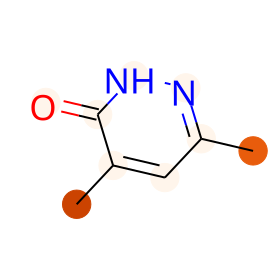

BBBP:1
prediction: [ 0.08976611 -0.38461885]
CC(=O)c1ccc(C(O)C(CO)NC(=O)C(Cl)Cl)cc1


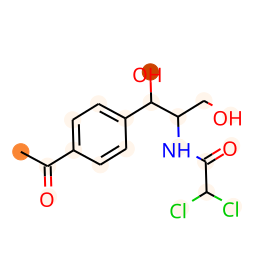

BBBP:1
prediction: [-2.1709929  2.016195 ]
CCOC(=O)OCC/C(SC(=O)OCC)=C(\C)N(C=O)Cc1cnc(C)nc1N


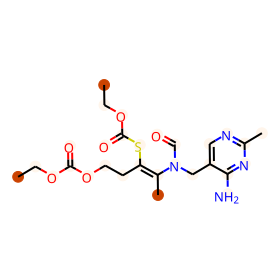

BBBP:1
prediction: [ 0.25264725 -0.6126897 ]
OC[C@@H](O)[C@H]1OC2O[C@H](C(Cl)(Cl)Cl)O[C@@H]2[C@H]1O


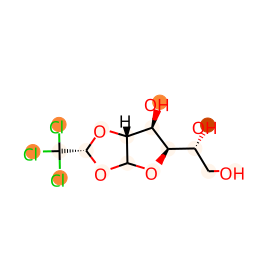

BBBP:1
prediction: [-2.1091843  1.9222984]
CC(CC(C)(C)O)OC(O)C(Cl)(Cl)Cl


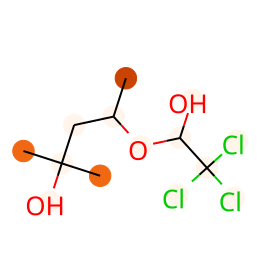

BBBP:1
prediction: [-1.6605804  1.6011043]
ClC(Cl)Cl


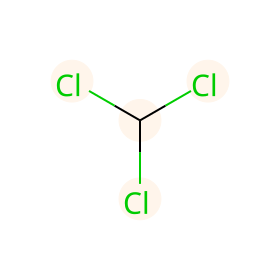

BBBP:1
prediction: [ 0.32868966 -0.5366498 ]
O=C(O)c1cc(=O)c2ccccc2o1


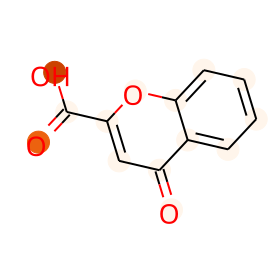

BBBP:1
prediction: [-5.3203917  4.9516215]
CC(=O)OCC(=O)[C@@]12OC(C)(C)O[C@@H]1C[C@H]1C3CC(C#N)=C4C=C(OCCCl)CCC4(C)[C@@]3(F)C(O)CC12C


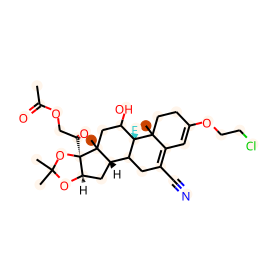

BBBP:1
prediction: [-1.037695   0.8410177]
CC(C)N[C@H]1C2CCC(CC2)[C@]1(O)c1ccc(Cl)c(Cl)c1


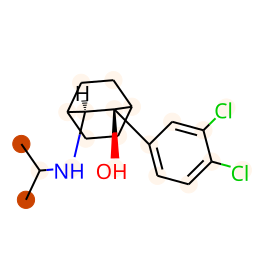

BBBP:1
prediction: [-1.6557205  1.5742468]
COCC1CN(c2ccc(OCc3cccc(C#N)c3)cc2)C(=O)O1


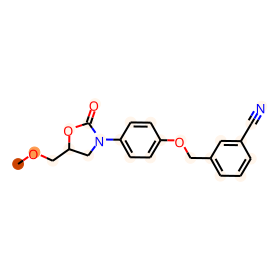

BBBP:1
prediction: [-1.3173473  1.1702832]
COc1cc(/C=C/C(=O)N2CCCCCCC2)cc(OC)c1OC


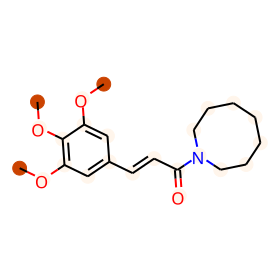

BBBP:1
prediction: [-1.5412632  1.3943805]
N#CCCN1C(=O)C(O)N=C(c2ccccc2F)c2cc(Cl)ccc21


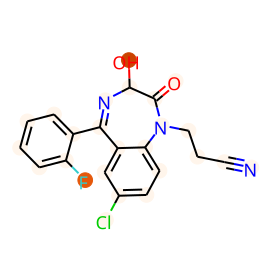

BBBP:1
prediction: [-1.2073146  1.0553143]
CN(C(=O)CNC1CC1)c1ccc(Cl)cc1C(=O)c1ccccc1Cl


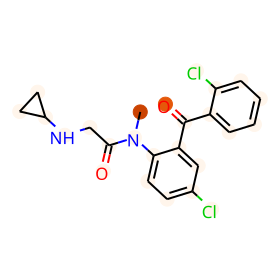

BBBP:1
prediction: [-4.5189285  4.178908 ]
CC1(C)O[C@@H]2C[C@H]3C4C[C@H](F)C5=CC(=O)C=C[C@]5(C)[C@@]4(F)[C@@H](O)C[C@]3(C)[C@]2(C(=O)COC(=O)C2CC2)O1


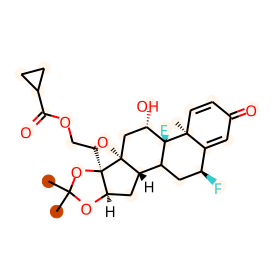

BBBP:1
prediction: [-2.8161206  2.7886755]
CN1CCC2=C(CC1)c1cc(C#N)ccc1Sc1ccccc12


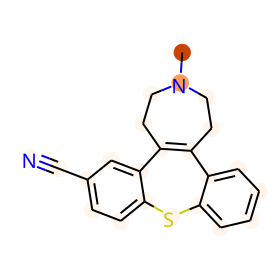

BBBP:1
prediction: [-2.3345149  2.2579918]
COc1cc(N)c(Cl)cc1C(=O)NC1CCN(Cc2ccccc2)CC1


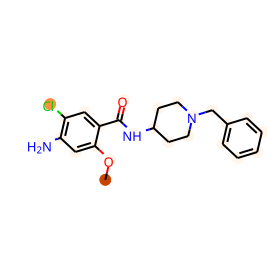

BBBP:1
prediction: [-1.4323021  1.3852835]
Clc1cccc(Cl)c1NC1=NCCO1


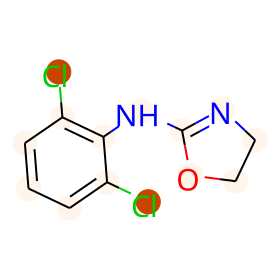

BBBP:1
prediction: [-3.491332   3.4384744]
NC(=O)C1(N2CCCCC2)CCN(CCCN2c3ccccc3CCc3ccc(Cl)cc32)CC1


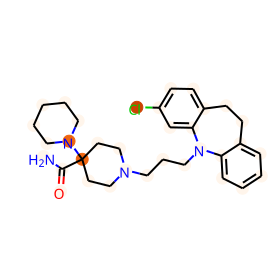

BBBP:1
prediction: [-4.0363364  3.7326748]
C[C@@H]1CC2C3C[C@H](F)C4=CC(=O)C=CC4(C)[C@@]3(Cl)C(O)CC2(C)C1C(=O)CO


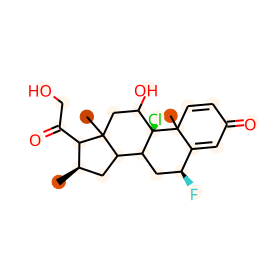

BBBP:1
prediction: [-3.1365185  2.8294418]
CC(=O)OCC(=O)[C@H]1[C@H](C)C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)C3(Cl)[C@@H](O)C[C@@]21C


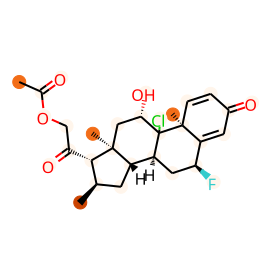

BBBP:1
prediction: [-4.9852104  4.5677447]
C[C@@H]1CC2C3C[C@H](F)C4=CC(=O)C=CC4(C)[C@@]3(Cl)C(O)CC2(C)C1C(=O)COC(=O)C(C)(C)C


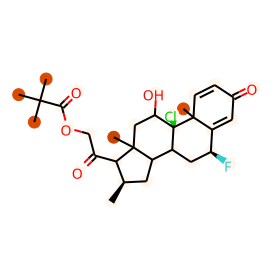

BBBP:1
prediction: [-2.0945005  1.9811006]
CN(C)CCCn1c(=O)n(-c2ccccc2)c2cc(Cl)ccc21


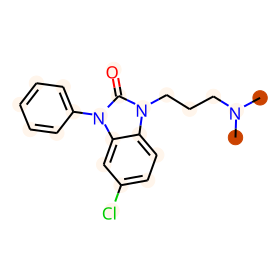

BBBP:1
prediction: [-2.7614646  2.7202978]
OCCN1CCN(CC/C=C2/c3ccccc3Sc3ccc(Cl)cc32)CC1


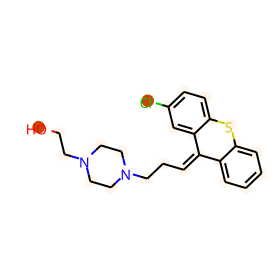

BBBP:1
prediction: [-1.2457229  1.1234237]
O=c1[nH]c2ccccc2c(=O)n1CCCN1CCN(c2cccc(Cl)c2)CC1


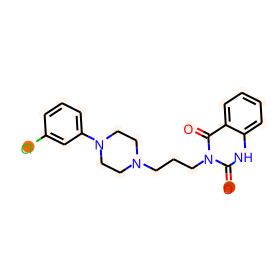

BBBP:1
prediction: [-1.1161078   0.79008925]
C[C@]12C[C@H](O)[C@H]3[C@@H](C=C(Cl)C4=CC(=O)C=C[C@@]43C)[C@@H]1CC[C@]2(O)C(=O)CO


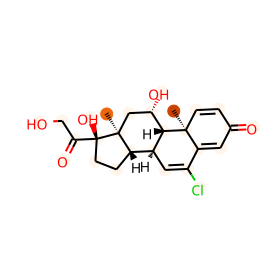

BBBP:1
prediction: [-3.7566552  3.6999528]
O=C(OCC(Cl)(Cl)Cl)OCC(Cl)(Cl)Cl


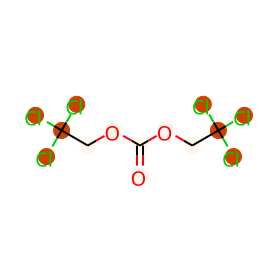

BBBP:1
prediction: [-2.1711373  2.123326 ]
C#CCN(C)CCCOc1ccc(Cl)cc1Cl


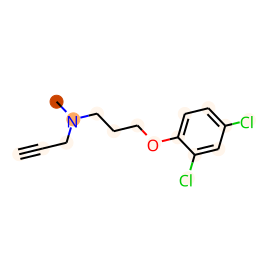

BBBP:1
prediction: [-1.7364223  1.6374481]
O=C(CCCN1CCC(C(=O)c2ccc(Cl)cc2)CC1)c1ccc(F)cc1


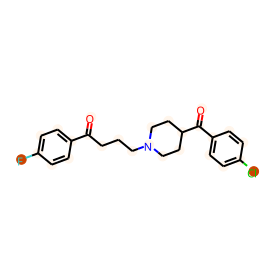

BBBP:1
prediction: [-3.2441845  3.1999767]
CN1CCN(C2Cc3ccccc3Sc3ccc(Cl)cc32)CC1


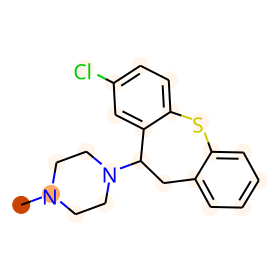

BBBP:1
prediction: [-4.4588675  4.122294 ]
CCC(=O)O[C@]1(C(=O)SCCl)[C@H](C)C[C@H]2C3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


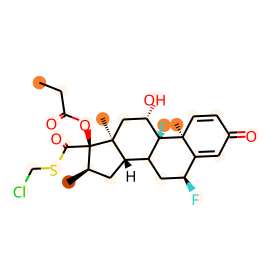

BBBP:1
prediction: [-3.1895576  3.1238835]
CNC(=O)CCN1CCN(CCC=C2c3ccccc3Sc3ccc(Cl)cc32)CC1


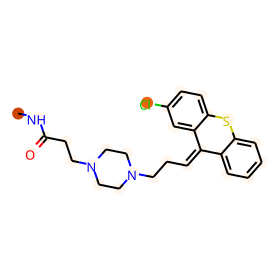

BBBP:1
prediction: [-1.8287598  1.6401439]
CCC12CCN(CC3CCC3)C(Cc3ccc(O)cc31)C2(C)C


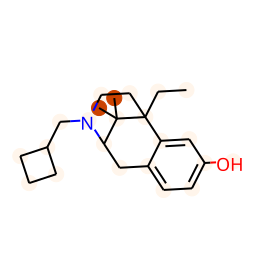

BBBP:1
prediction: [-3.024012   2.8994977]
CC[C@H]1CC(=O)[C@@H]2Oc3c(OC)ccc4c3[C@@]23CCN(CC2CC2)C(C4)[C@H]13


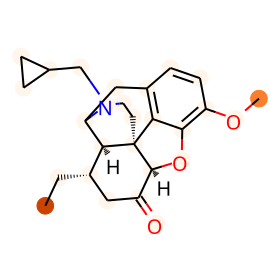

BBBP:1
prediction: [-4.085755   3.7154279]
CC1CC2C3CC(F)(F)C4=CC(=O)C=C[C@]4(C)C3(F)C(O)CC2(C)C1(O)C(=O)CO


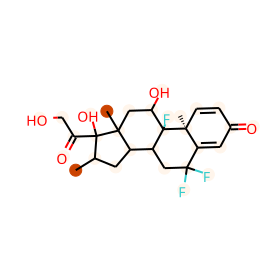

BBBP:1
prediction: [-2.2937875  2.0727117]
CC(=O)OCC(=O)[C@@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)CC[C@]4(C)[C@H]3C(=O)C[C@@]21C


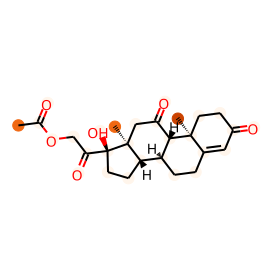

BBBP:1
prediction: [-1.7797006  1.246842 ]
CC1=C[C@H]2[C@@H]3C[C@@H](C)[C@](O)(C(=O)COC(=O)c4cccc(S(=O)(=O)O)c4)[C@@]3(C)C[C@H](O)[C@@H]2[C@@]2(C)Cc3cnn(-c4ccccc4)c3C=C12


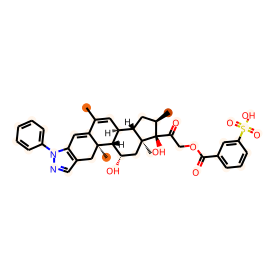

BBBP:1
prediction: [-3.3953176  3.019646 ]
CC(=O)OCC(=O)[C@@]1(O)[C@H](C)C[C@H]2[C@@H]3C=C(C)C4=Cc5c(cnn5-c5ccccc5)C[C@]4(C)[C@H]3[C@@H](O)C[C@@]21C


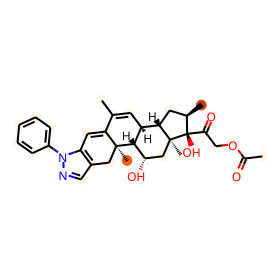

BBBP:1
prediction: [-1.277958   1.2313873]
CN1C(=O)CCC1c1cccnc1


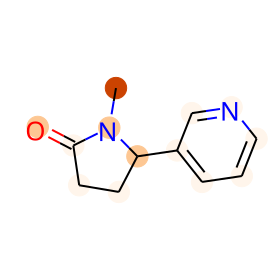

BBBP:1
prediction: [-2.7353454  2.683888 ]
CN(C)CC(=O)C=C1c2ccccc2CCc2ccccc21


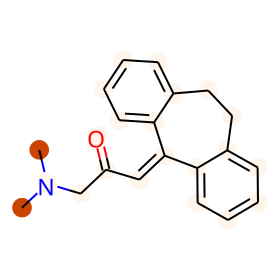

BBBP:1
prediction: [-1.6435877  1.5043037]
CC1CC(OC(=O)C2CCC(=O)N2)CC(C)(C)C1


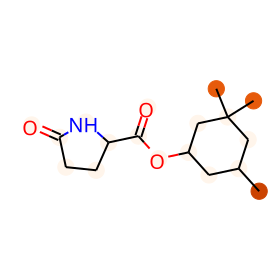

BBBP:1
prediction: [-1.7215279  1.5881131]
C/C=C/C(=O)N(CC)C(CC)C(=O)N(C)C


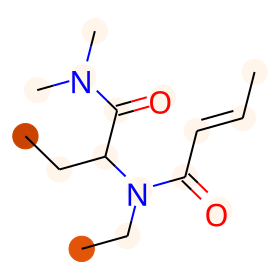

BBBP:1
prediction: [-1.248699   1.1777999]
O=C(Nc1ccccc1)OCC1(COC(=O)Nc2ccccc2)CCCC1


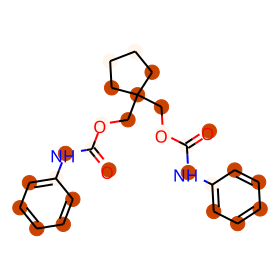

BBBP:1
prediction: [-2.3839054  2.334562 ]
CN(C)C1CCc2[nH]c3ccccc3c2C1


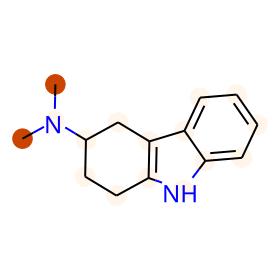

BBBP:1
prediction: [-1.2970523  1.2080107]
CCC1(C2=CCCCC2)C(=O)NC(=O)NC1=O


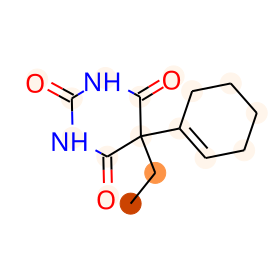

BBBP:1
prediction: [-2.649403   2.5994956]
CN(C)CCC=C1c2ccccc2C=Cc2ccccc21


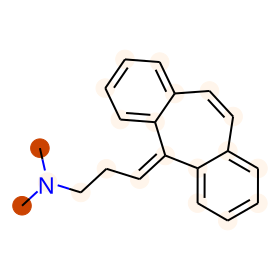

BBBP:1
prediction: [-3.0444005  2.868893 ]
CC(=O)[C@H]1CC[C@H]2[C@@H]3C[C@@H](O)C45CC4CC[C@]5(C)[C@H]3CC[C@]12C


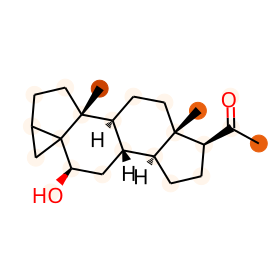

BBBP:1
prediction: [-2.3432393  2.3560865]
NC(=O)C1c2ccccc2CCc2ccccc21


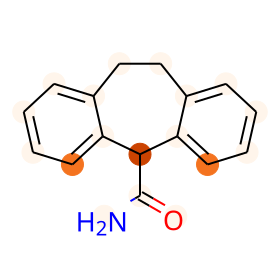

BBBP:1
prediction: [-2.3661613  2.3419693]
O=C1NC(=O)C2(c3ccc(Cl)cc3)CC12


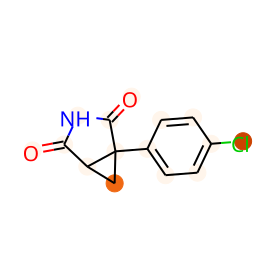

BBBP:1
prediction: [ 0.5961885 -0.7995658]
OC(C1=NCCN1)(c1ccc(Cl)cc1)c1ccccn1


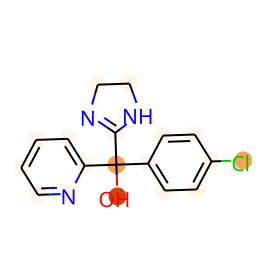

BBBP:1
prediction: [-1.8703675  1.779343 ]
CCCCCCCCCCOc1c(OC)cc(C(N)=O)cc1OC


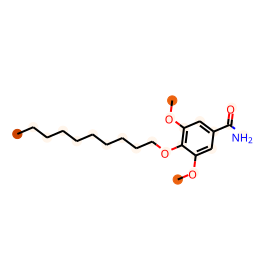

BBBP:1
prediction: [-0.20356052  0.08670717]
Cc1ccc(Cc2ccccc2)c(N2CCNCC2)c1


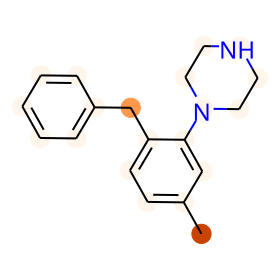

BBBP:1
prediction: [-1.4015058  1.3420506]
O=C1CN(O)C(c2ccccc2)=c2cc(Cl)ccc2=N1


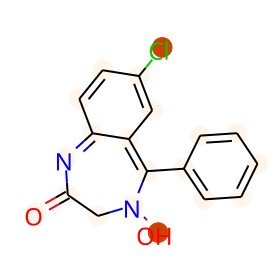

BBBP:1
prediction: [-2.0003998  1.880321 ]
CCCCn1c(=O)c2c(ncn2CC(C)=O)n(CCCC)c1=O


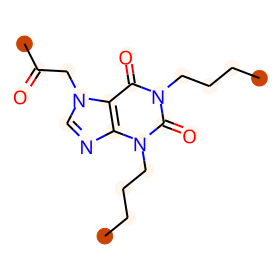

BBBP:1
prediction: [-3.4991207  3.2876847]
CC(=O)C1(O)CCC2C3CCC4=CC(=O)C=CC4(C)C3C(O)CC21C


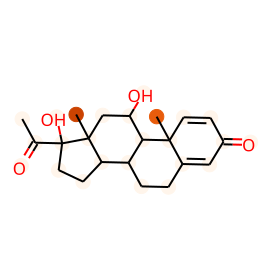

BBBP:1
prediction: [-0.8034475   0.71889824]
Nc1ncc2ncn(COCCO)c2n1


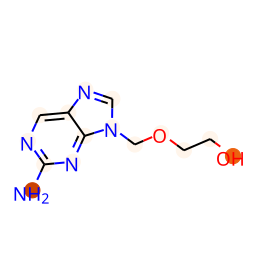

BBBP:1
prediction: [-1.5826272  1.271133 ]
CC(=O)[C@@]1(O)[C@H](O)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


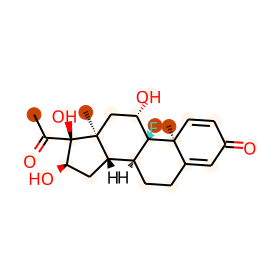

BBBP:1
prediction: [-1.7205883  1.4181714]
C[C@@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@H]1C(=O)CO


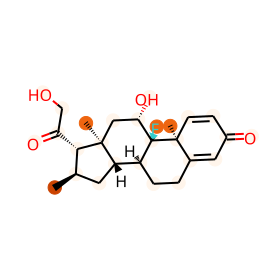

BBBP:1
prediction: [ 0.57093513 -0.7930875 ]
Cc1cccc(Cc2cnc[nH]2)c1C


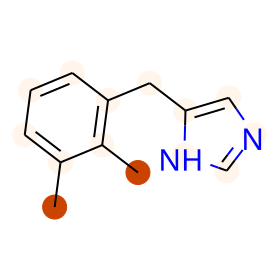

BBBP:1
prediction: [-1.8616848  1.8673667]
c1ccc([C@@H]2CN3CCSC3=N2)cc1


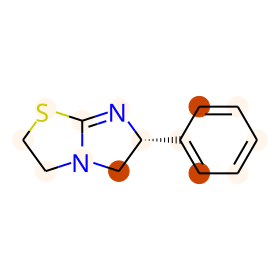

BBBP:1
prediction: [-0.35261974  0.27443653]
c1ccc(C2CN=C3NCCN32)cc1


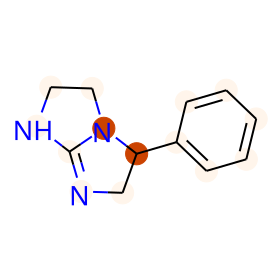

BBBP:1
prediction: [-1.7227036  1.6850541]
c1ccc(C2(c3ccccc3)OC[C@H]([C@@H]3CCCCN3)O2)cc1


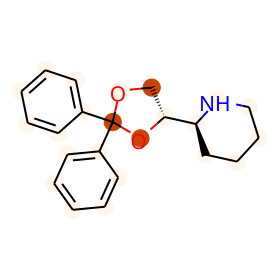

BBBP:1
prediction: [-3.792865  3.550268]
CC12CC(Cl)[C@@]3(Cl)C(CCC4=CC(=O)C=CC43C)C1CC[C@]2(O)C(=O)CO


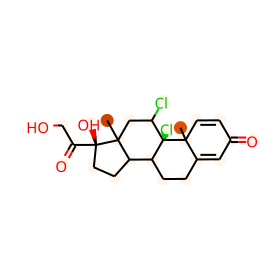

BBBP:1
prediction: [-5.0243053  4.779717 ]
CC(=O)OCC(=O)[C@@]1(O)CCC2C3CCC4=CC(=O)C=CC4(C)[C@@]3(Cl)C(Cl)CC21C


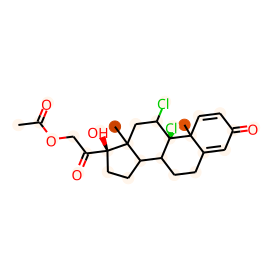

BBBP:1
prediction: [-2.398717  2.292343]
CCN(CC)CCNC(=O)c1cc(Cl)cc(Cl)c1OC


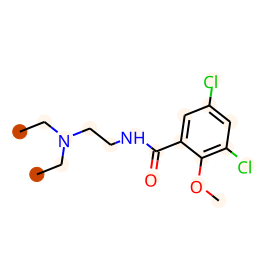

BBBP:1
prediction: [-1.4832174  1.170219 ]
CC(=O)O[C@H]1C[C@@H]2C(COC(=O)CC(C)C)=CO[C@@H](OC(=O)CC(C)C)[C@@H]2[C@@]12CO2


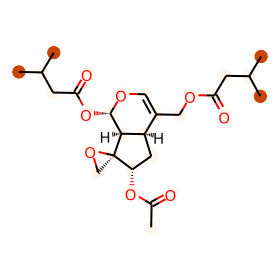

BBBP:1
prediction: [-3.2315357  3.0485928]
CCCCOCC(CN1C(=O)N(CC(COCCCC)OC(N)=O)C(=O)C(CC)(c2ccccc2)C1=O)OC(N)=O


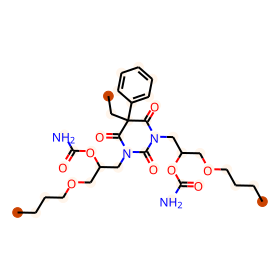

BBBP:1
prediction: [-4.0535355  3.7424784]
C[C@@H]1CC2C3C[C@H](F)C4=CC(=O)C=CC4(C)[C@@]3(F)C(O)CC2(C)C1C(=O)CO


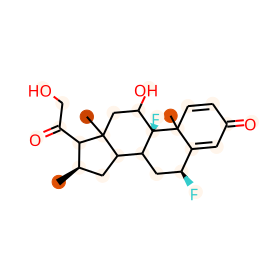

BBBP:1
prediction: [-3.3007436  2.895448 ]
C[C@@H]1C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@H]1C(=O)COC(=O)C(C)(C)C


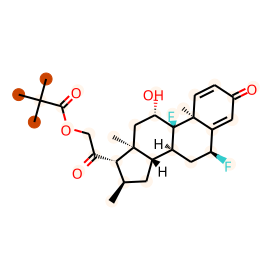

BBBP:1
prediction: [-3.132374   3.0788677]
CN1CCC(C)(CN2c3ccccc3Sc3ccccc32)C1


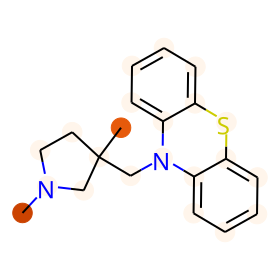

BBBP:1
prediction: [-2.0892944  1.946581 ]
CN(C)CCn1cnc2c1c(=O)n(C)c(=O)n2C


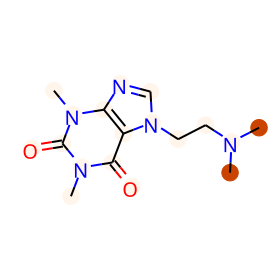

BBBP:1
prediction: [-1.8420278  1.7657559]
CC(Cc1ccccc1)N(C)C


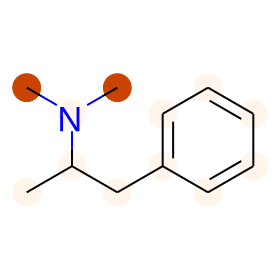

BBBP:1
prediction: [-1.1185981  1.0705101]
O=C1CN2C(=O)CCC2N1


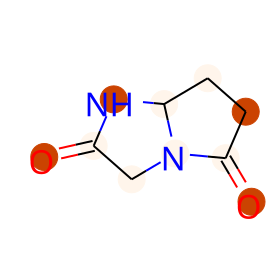

BBBP:1
prediction: [-2.9191108  2.8804007]
CCCCCCCCCC1(C)OCC(COC(N)=O)O1


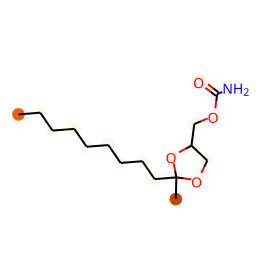

BBBP:1
prediction: [-0.9836209   0.81279725]
CCc1c(OC)nc2nc(C(=O)c3ccccc3)cn2c1C


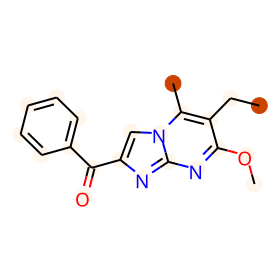

BBBP:1
prediction: [-3.1734612  2.929947 ]
CCCC(=O)O[C@]1(C(C)=O)CCC[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]21C


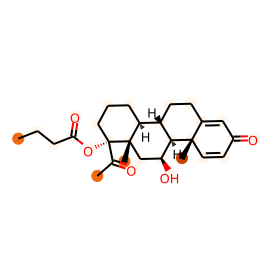

BBBP:1
prediction: [-2.5764732  2.5314803]
CCN1CC(CCN2CCOCC2)C(c2ccccc2)(c2ccccc2)C1=O


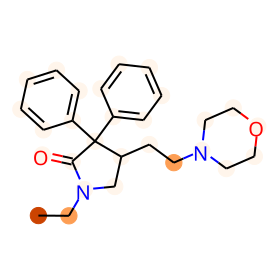

BBBP:1
prediction: [-2.2283278  2.214474 ]
CNCCC(Oc1cccc2ccccc12)c1cccs1


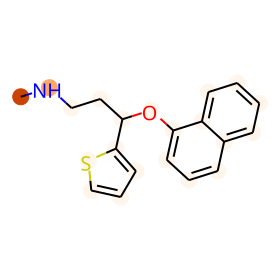

BBBP:1
prediction: [-4.1280293  3.9690502]
O=C(c1ccc(F)cc1)C1CCN(CCCN2c3ccccc3Sc3ccc(C(F)(F)F)cc32)CC1


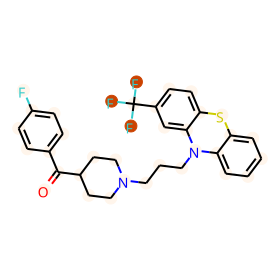

BBBP:1
prediction: [-2.440462   2.2867525]
CCC(=O)N(c1ccc(Cl)c(Cl)c1)[C@@H]1CCC[C@H]1N(C)C


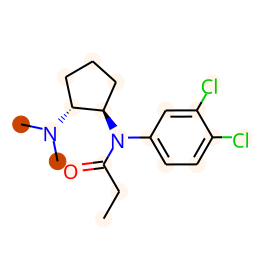

BBBP:1
prediction: [-2.1802833  2.1759443]
CC1=NN(c2ccccc2)C(=O)C1


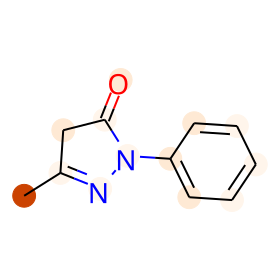

BBBP:1
prediction: [-1.6943444  1.630353 ]
Cc1nccn1C(C)c1ccccc1


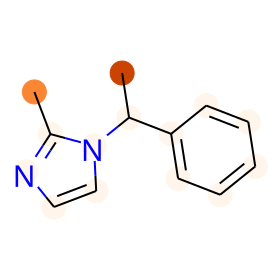

BBBP:1
prediction: [-2.3699574  2.290857 ]
CCN(CC)C/C=C1/c2ccccc2Nc2cc(Cl)ccc21


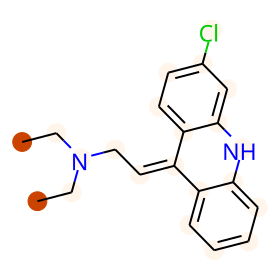

BBBP:1
prediction: [-2.2171621  2.1133587]
CCS(=O)(=O)CCN1C(=O)CN=C(c2ccccc2F)c2cc(Cl)ccc21


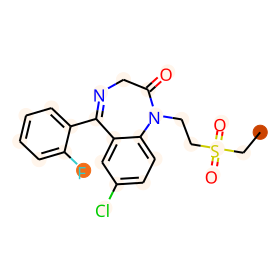

BBBP:1
prediction: [-2.1947389  2.1532073]
Fc1ccc(-c2ccc(CN3CCN(c4cccc5ccoc45)CC3)[nH]2)cc1


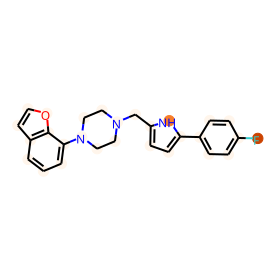

BBBP:1
prediction: [-1.1676649  1.0408466]
CCC(CC)(CNC(=O)CCCO)c1cccc(OC)c1


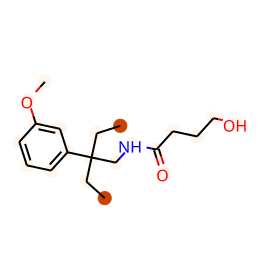

BBBP:1
prediction: [-0.8232202   0.55868983]
COc1ccccc1N1CCN(CC(O)COc2cc(OC)c(OC)c(OC)c2)CC1


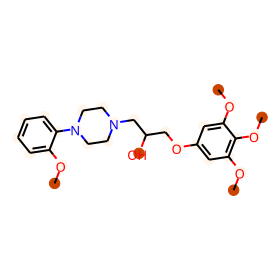

BBBP:1
prediction: [-1.7569522  1.7357806]
CCOC(=O)N(Cc1ccccc1)C1CC1


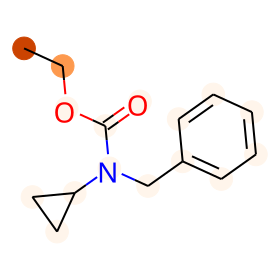

BBBP:1
prediction: [-2.5493684  2.5288935]
OC1CCN(c2ccc(-c3ccc(Cl)cc3Cl)nn2)CC1


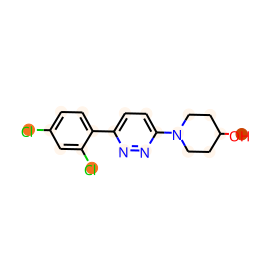

BBBP:1
prediction: [-3.2706077  3.0256813]
CC(=O)C1CCC2C3CC(C)C4=CC(=O)C=CC4(C)C3C(O)CC12C


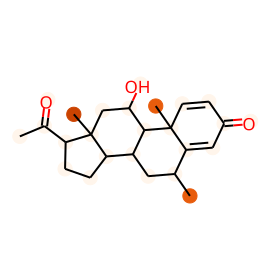

BBBP:1
prediction: [-1.789117   1.6745672]
CC1OC2(CCCCC2Oc2cccc(Cl)c2)NC1=O


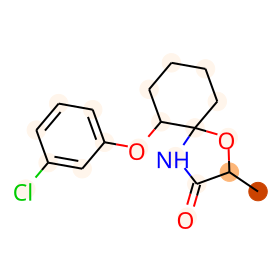

BBBP:1
prediction: [-3.1337883  3.1082718]
CN1CCC2=C(CC1)c1ccccc1N(C)c1ccccc12


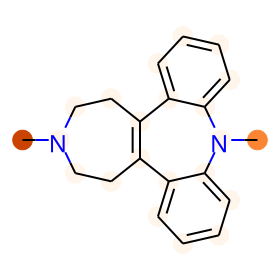

BBBP:1
prediction: [-2.533874   2.4338498]
CCN1CCCC1CNC(=O)c1cc(C(C)=O)ccc1OC


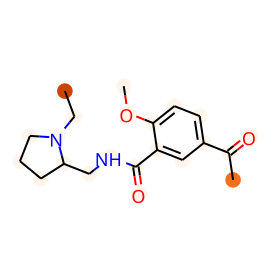

BBBP:1
prediction: [-2.2096648  2.0730767]
CCN(CC)CCn1cnc2c1c(=O)n(C)c(=O)n2C


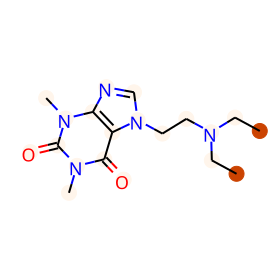

BBBP:1
prediction: [-1.239436   1.1504847]
CCNC1=Nc2ccc(Cl)cc2C(c2ccccc2)S1


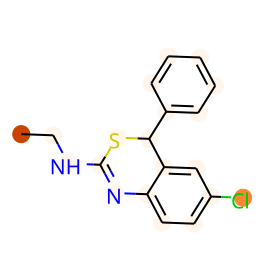

BBBP:1
prediction: [-2.1799116  2.1388476]
CCCCNCC1COc2cccc(OCC)c2O1.[Cl-].[H+]


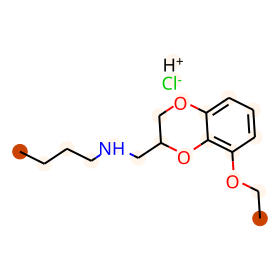

BBBP:1
prediction: [-1.2759702  1.2191772]
CCCl


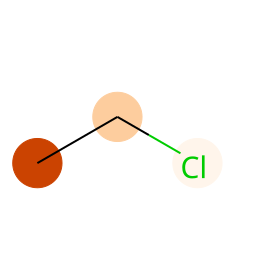

BBBP:1
prediction: [-1.0504657  0.9996915]
C=C


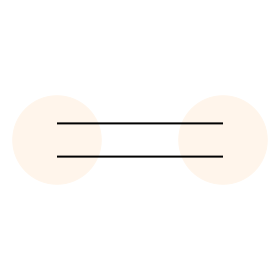

BBBP:1
prediction: [-1.5883464  1.4309757]
O=C(O)/C=C/C(=O)O.OCCOCCOCCN1CCN(C(c2ccccc2)c2ccc(Cl)cc2)CC1


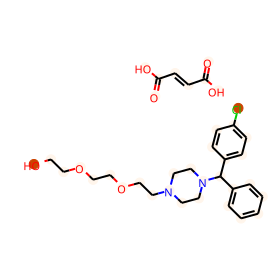

BBBP:1
prediction: [-2.5537648  2.4747896]
CCc1nn(CCCN2CCN(c3cccc(Cl)c3)CC2)c(=O)n1CC


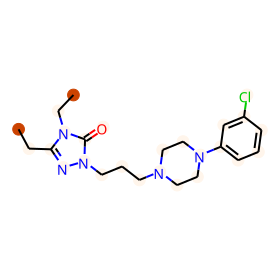

BBBP:1
prediction: [-3.7326736  3.4491813]
CCCC(C)(O)C1CC23C=CC1(OC)C1Oc4c(O)ccc5c4C12CCN(C)C3C5


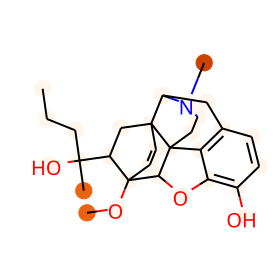

BBBP:1
prediction: [-2.6738648  2.6404097]
CCC1(c2ccccc2)OCC(C2CCCCN2)O1


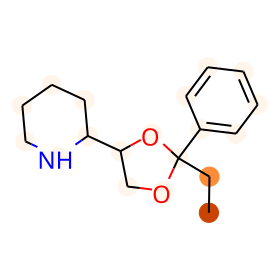

BBBP:1
prediction: [-1.8763088  1.7743251]
CC(=O)OCC(CCn1cnc2cnc(N)nc21)COC(C)=O


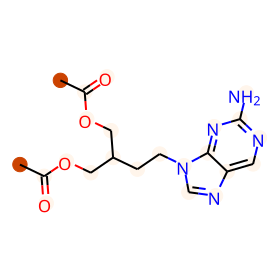

BBBP:1
prediction: [-2.2713952  2.1980236]
CN(C)CCCn1c(=O)c2ccccc2c2ccccc21


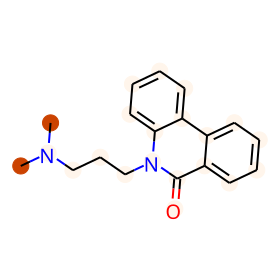

BBBP:1
prediction: [-2.5020938  2.4050386]
CCc1c(OC)nc2nc(-c3noc(C)n3)cn2c1C


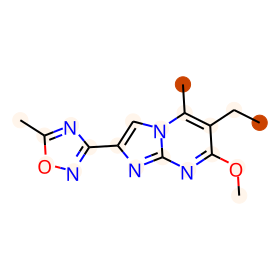

BBBP:1
prediction: [-1.2696537  1.2226627]
O=C1CC[C@H](C(=O)N2CCCCC2)N1


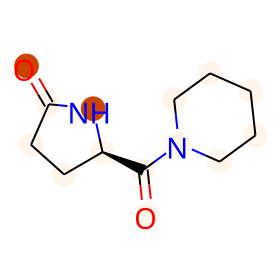

BBBP:1
prediction: [-2.8266714  2.729886 ]
CCCCOCC(CN1C(=O)NC(=O)C(CC)(c2ccccc2)C1=O)OC(N)=O


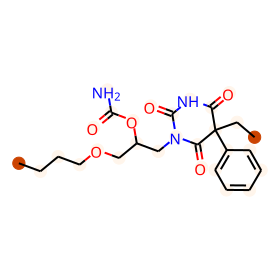

BBBP:1
prediction: [-1.8837062  1.8740582]
NC(=O)OCC(COC(N)=O)c1ccccc1


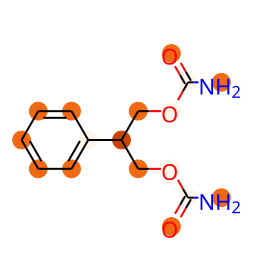

BBBP:1
prediction: [-2.294621   2.2295911]
COc1ccc(OCC2CN(C)CCC2c2ccccc2)cc1


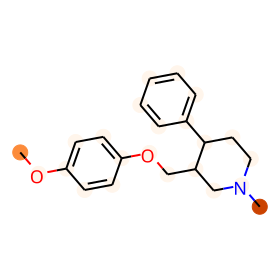

BBBP:1
prediction: [-2.2146     2.1537645]
O=C(CCCN1CCN(C(=O)OC2CCCCC2)CC1)c1ccc(F)cc1


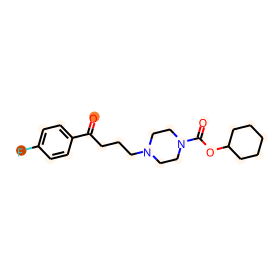

BBBP:1
prediction: [-1.6615648  1.5299258]
CCC(C(=O)OCCN1CCOC(c2ccccc2)C1C)c1ccccc1


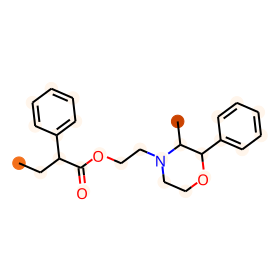

BBBP:1
prediction: [-1.5506431  1.492748 ]
CCNC1C2CCC(C2)C1c1ccccc1


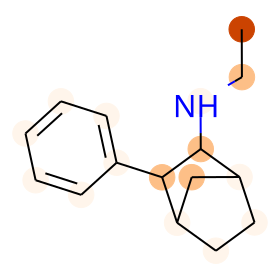

BBBP:1
prediction: [-2.7454653  2.7128322]
CCCCN/C(=C1/C=C(Cl)C=CC1=O)c1ccccc1Cl


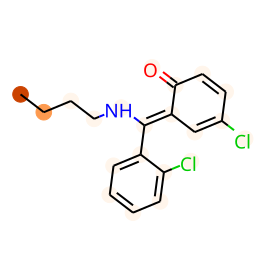

BBBP:1
prediction: [-1.4149768  1.3862505]
c1ccc(CC2NCCc3c2[nH]c2ccccc32)cc1


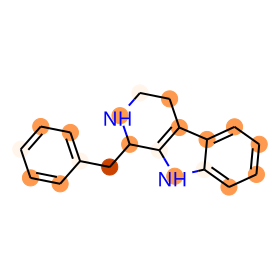

BBBP:1
prediction: [-2.3129795  2.2540653]
CCC1C(=O)NC(=O)C1(C)c1ccccc1


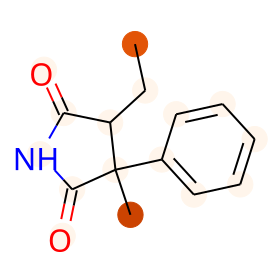

BBBP:1
prediction: [-0.8505189  0.7730408]
Clc1ccc(OCC2=NCCN2)cc1Cl


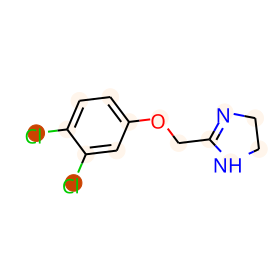

BBBP:1
prediction: [-1.5526785  1.5009451]
CC1NC(=O)COC1c1ccccc1


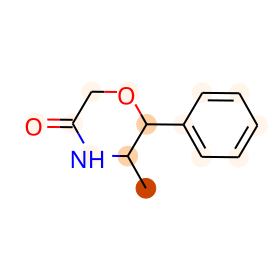

BBBP:1
prediction: [-1.2514083  1.1623938]
CN1CC(=O)N=C1NC(=O)Nc1cccc(Cl)c1


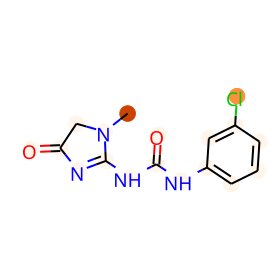

BBBP:1
prediction: [-1.9707565  1.9506623]
CCNC1=NC(=O)C(c2ccccc2)O1


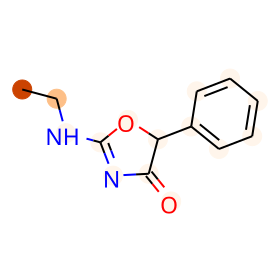

BBBP:1
prediction: [-1.8313216  1.7048216]
CC(C)(O)CC(C)(O)c1ccc(Cl)cc1


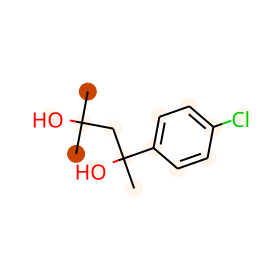

BBBP:1
prediction: [-0.44192153  0.27834597]
Cn1nc(-c2cccnc2)nc1-c1ccccc1CO


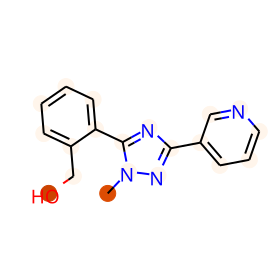

BBBP:1
prediction: [-2.5258455  2.508427 ]
O=C(COc1ccc(Cl)cc1)N1CCN(Cc2ccc3c(c2)OCO3)CC1


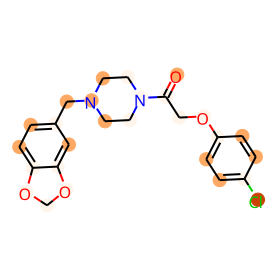

BBBP:1
prediction: [-0.06922371 -0.17078027]
CC(C)(C)NCC(O)c1ccccc1F


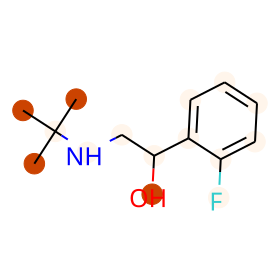

BBBP:1
prediction: [ 0.9071355 -1.329469 ]
CS(=O)(=O)c1ccc([C@@H](O)[C@@H](CF)NC(=O)C(Cl)Cl)cc1


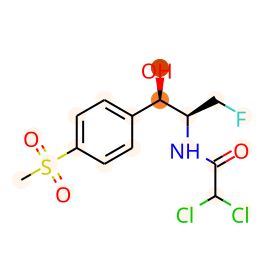

BBBP:1
prediction: [-5.0411577  4.7410827]
CC(=O)OCC(=O)C12N=C(C)OC1CC1C3CCC4=CC(=O)C=CC4(C)[C@@]3(F)C(O)CC12C


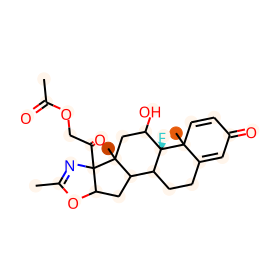

BBBP:1
prediction: [-3.1162589  2.962378 ]
CCOC(=O)N(CCN(C)C)c1cccc(C(F)(F)F)c1


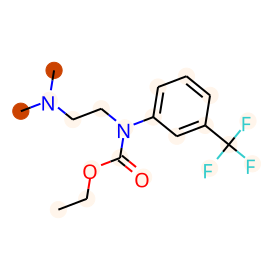

BBBP:1
prediction: [-1.5285511  1.33846  ]
COc1ccc(S(N)(=O)=O)cc1C(=O)NCC1CCCN1Cc1ccc(F)cc1


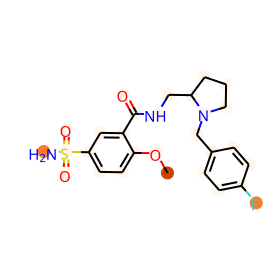

BBBP:1
prediction: [-3.0505424  2.982033 ]
Cc1cc2c(s1)=Nc1ccc(F)cc1NC=2N1CCN(C)CC1


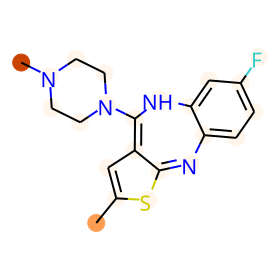

BBBP:1
prediction: [-3.5307198  3.1961462]
CCCCOC(=O)C(=O)C1C(C)CC2C3CC(F)C4=CC(=O)C=CC4(C)C3C(O)CC21C


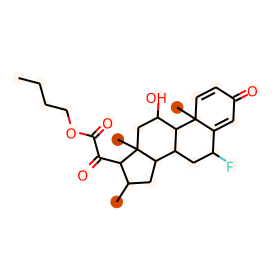

BBBP:1
prediction: [-3.6982946  3.366974 ]
CCCCCC(=O)OCC(=O)C1C(C)CC2C3CC(F)C4=CC(=O)C=CC4(C)C3C(O)CC21C


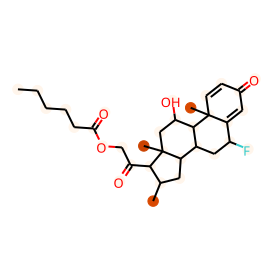

BBBP:1
prediction: [-1.4655771  1.4063613]
CCS(=O)(=O)c1ccc(F)cc1


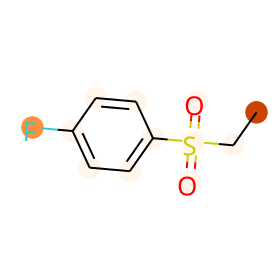

BBBP:1
prediction: [-3.6113427  3.313966 ]
CC(=O)O[C@]1(C(C)=O)CC[C@H]2[C@@H]3C[C@H](C)C4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


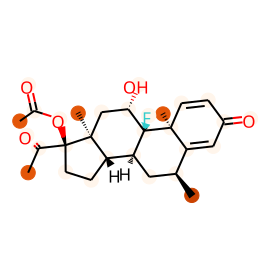

BBBP:1
prediction: [-3.1422803  3.0575602]
CNCCC(Oc1ccc(C(F)(F)F)cc1)c1ccccc1


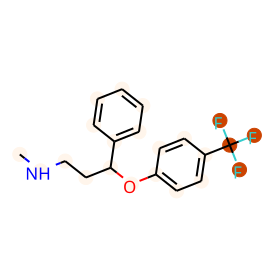

BBBP:1
prediction: [-4.6181736  4.477843 ]
CCCCCCC(=O)OCCN1CCN(CCCN2c3ccccc3Sc3ccc(C(F)(F)F)cc32)CC1


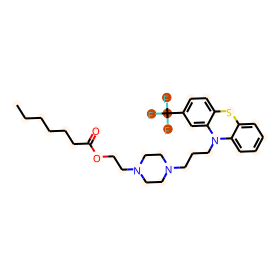

BBBP:1
prediction: [-3.848836   3.7430263]
OCCOC1CCN(CCCN2c3ccccc3Sc3ccc(C(F)(F)F)cc32)CC1


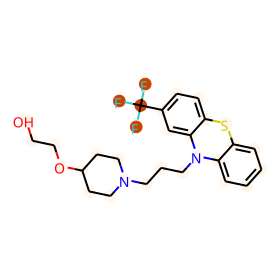

BBBP:1
prediction: [-3.4229896  3.3630369]
NC(=O)NCCN1CCN(c2cccc(C(F)(F)F)c2)CC1


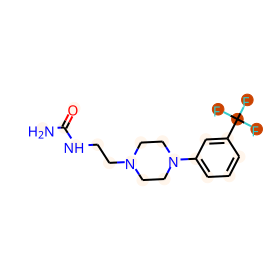

BBBP:1
prediction: [-1.7372516  1.5823815]
O=C1NCN(c2ccccc2)C12CCN(CCCC(c1ccc(F)cc1)c1ccc(F)cc1)CC2


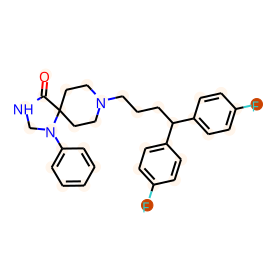

BBBP:1
prediction: [-3.219182   3.1494377]
O=C1CN2CCOC2(c2ccccc2F)c2cc(Cl)ccc2N1CCO


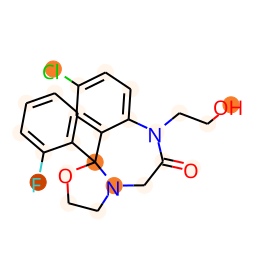

BBBP:1
prediction: [-2.8963027  2.8256013]
CN1C(=O)C(O)N=C(c2ccccc2F)c2cc(Cl)ccc21


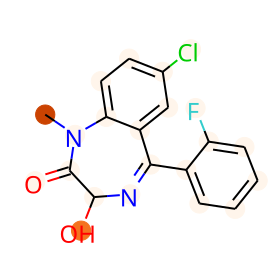

BBBP:1
prediction: [-4.8980694  4.548473 ]
CC1CC2C3CC(F)C4=CC(=O)C=CC4(C)C3(F)C(O)CC2(C)C1(O)C(=O)SCF


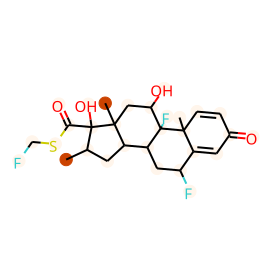

BBBP:1
prediction: [-4.278903  3.934746]
CCC(=O)O[C@]1(C(=O)SCF)[C@H](C)C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


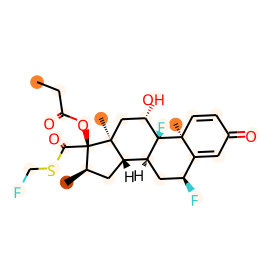

BBBP:1
prediction: [-1.6707053  1.5568919]
CCOC(=O)c1cncn1C(C)c1ccc(F)cc1


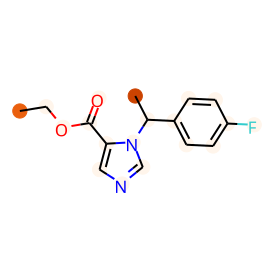

BBBP:1
prediction: [-1.7435254  1.5019326]
OC(CCCN1CCc2c(c3cc(F)ccc3n2-c2ccc(F)cc2)C1)c1ccc(F)cc1


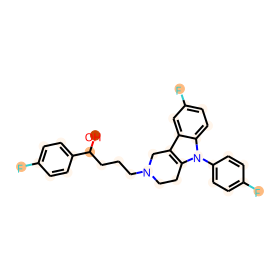

BBBP:1
prediction: [ 0.7461786 -1.2167025]
CC(C)n1c(/C=C/[C@@H](O)C[C@H](O)CC(=O)O)c(-c2ccc(F)cc2)c2ccccc21


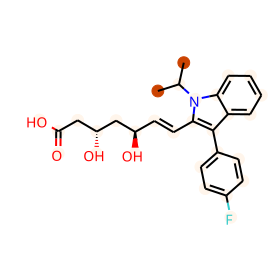

BBBP:1
prediction: [-2.3742354  2.1987743]
COCCCC/C(=N\OCCN)c1ccc(C(F)(F)F)cc1.O=C(O)/C=C\C(=O)O


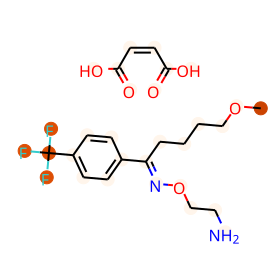

BBBP:1
prediction: [-2.3610644  2.2484148]
CNC(=O)N1CC(Oc2cccc(C(F)(F)F)c2)C1


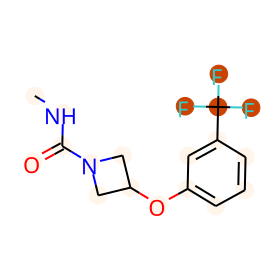

BBBP:1
prediction: [ 0.95896536 -1.4621404 ]
Nc1nc(=O)c2nc(CNc3ccc(C(=O)N[C@@H](CCC(=O)O)C(=O)O)cc3)cnc2[nH]1


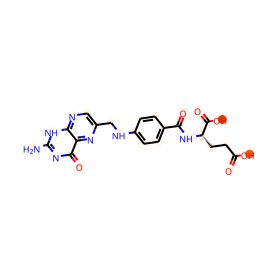

BBBP:1
prediction: [-5.5319405  5.1590543]
CC(=O)OCC(=O)[C@@]12OC(C)(C)O[C@@H]1CC1C3CC(C=O)=C4C=C(OCCCl)CCC4(C)[C@@]3(F)C(O)CC12C


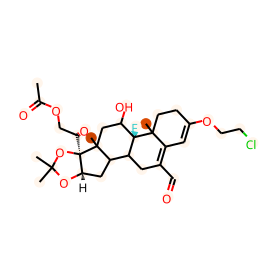

BBBP:1
prediction: [-3.058538  2.985854]
CP(C)(=O)CN1C(=O)CN=C(c2ccccc2)c2cc(Cl)ccc21


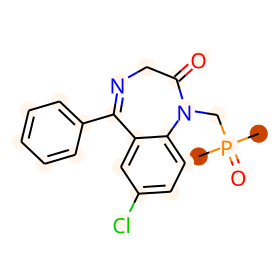

BBBP:1
prediction: [-1.2285241  1.1746304]
NNC(=O)CP(=O)(c1ccccc1)c1ccccc1


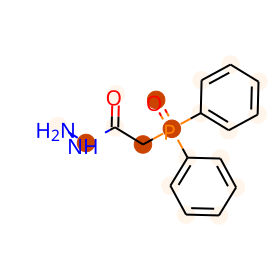

BBBP:1
prediction: [-1.3660048  1.2804592]
C[C@@H]1O[C@@H]1P(=O)(O)O


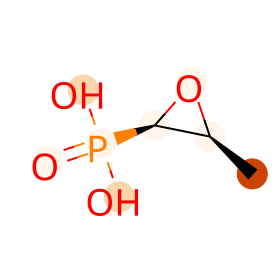

BBBP:1
prediction: [-2.3910577  2.3398807]
O=C1NC(c2ccccc2)(c2ccccc2)C(=O)N1COP(=O)(O)O


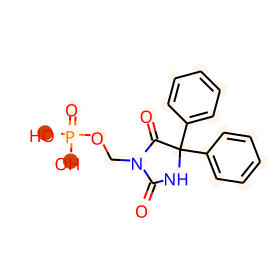

BBBP:1
prediction: [-4.528884  4.40238 ]
CN1CCN(CCC(=O)N2c3ccccc3Sc3ccc(C(F)(F)F)cc32)CC1


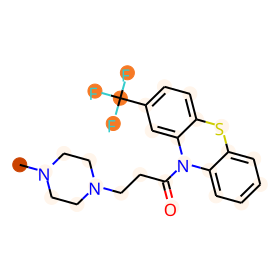

BBBP:1
prediction: [-4.1324644  4.0178995]
O=C(CCN1CCN(CCO)CC1)N1c2ccccc2Sc2ccc(C(F)(F)F)cc21


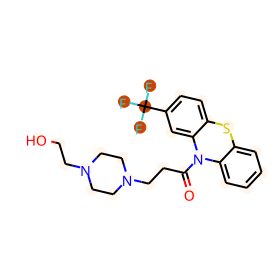

BBBP:1
prediction: [-3.4110918  3.3642647]
O=C1OCCC1C1(O)CCN(CCCN2c3ccccc3Sc3ccc(Cl)cc32)CC1


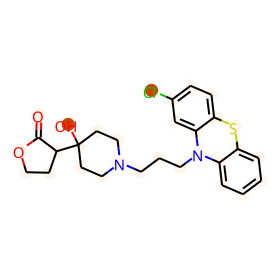

BBBP:1
prediction: [-0.6228343   0.55866444]
O=c1[nH]oc2c1CCNC2


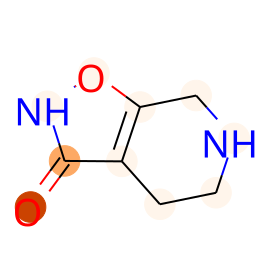

BBBP:1
prediction: [-0.74607944  0.44958192]
CC(=O)[C@H]1CC[C@H]2[C@@H]3CC[C@H]4C[C@](C)(O)CC[C@]4(C)[C@H]3CC[C@]12C


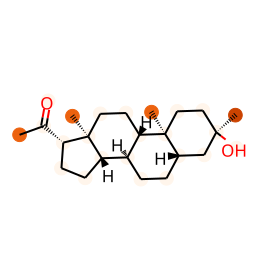

BBBP:1
prediction: [-1.1290681  0.9004065]
COCc1c(C(=O)OC(C)C)ncc2[nH]c3cccc(Oc4ccc(Cl)cc4)c3c12


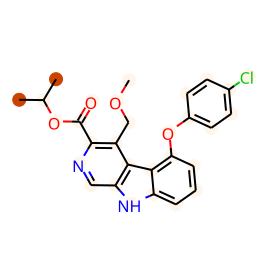

BBBP:1
prediction: [-1.9370302  1.7630559]
CCC12CCN(CC3CC3)C(Cc3ccc(O)cc31)C2(C)C


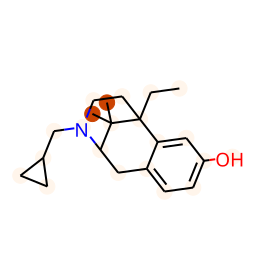

BBBP:1
prediction: [-4.0742435  3.8034093]
CC1(C)O[C@@H]2C[C@H]3[C@@H]4CCC5=CC(=O)CC[C@]5(C)[C@@]4(F)[C@@H](O)C[C@]3(C)[C@]2(C(=O)CCl)O1


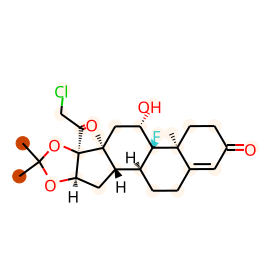

BBBP:1
prediction: [-2.178287   1.8493114]
C[C@@H]1C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)C3(Cl)[C@@H](F)C[C@]2(C)[C@H]1C(=O)CO


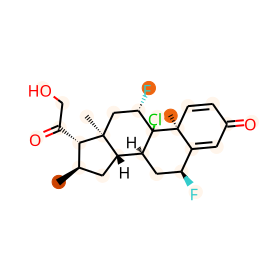

BBBP:1
prediction: [-1.9489172  1.8207493]
O=C(NCCN1CCC(n2c(=O)[nH]c3cc(Cl)ccc32)CC1)c1ccc(F)cc1


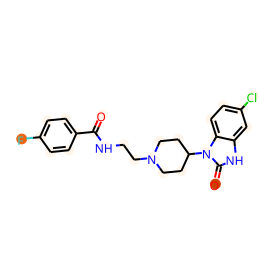

BBBP:1
prediction: [-3.3227372  3.0369723]
C[C@]12C=C(Br)C(=O)C=C1[C@H](F)C[C@H]1[C@@H]3CCC(O)(C(=O)CO)[C@@]3(C)C[C@H](O)C12F


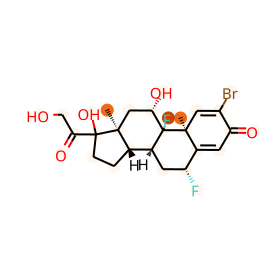

BBBP:1
prediction: [-3.2606916  3.212153 ]
O=C1CN2CCOC2(c2ccccc2F)c2cc(Br)ccc2N1


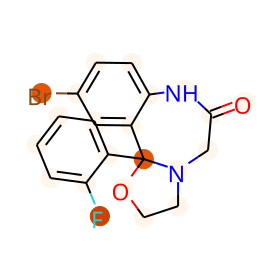

BBBP:1
prediction: [ 1.2555363 -1.6510367]
CC(C)(CO)[C@@H](O)C(=O)NCCCC(=O)O


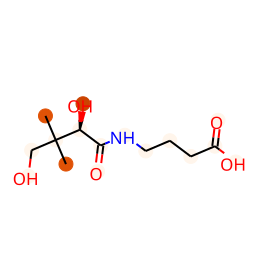

BBBP:1
prediction: [-3.510335   3.2686522]
CC12CCC(=O)C=C1CCC1C2C(O)CC2(C)C1CCC2(O)C(=O)COC(=O)CCC1CCCC1


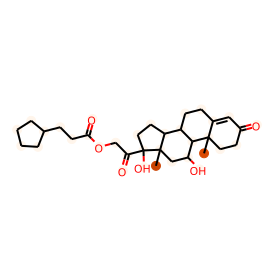

BBBP:1
prediction: [-1.716952   1.5538162]
CN1CC[C@]23c4c5ccc(O)c4O[C@H]2[C@@H](O)CC[C@@]3(O)[C@H]1C5


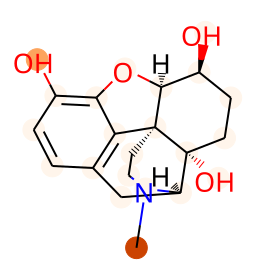

BBBP:1
prediction: [ 0.41800022 -0.6677829 ]
COc1ccc(Cn2c(C)c(CCN)c3cc(O)ccc32)cc1


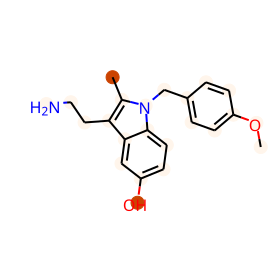

BBBP:1
prediction: [-2.0539546  1.9558822]
CCC(Br)(C(N)=O)C(C)C


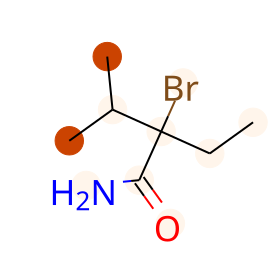

BBBP:1
prediction: [ 0.445095  -0.6931789]
Cc1cccc(O[C@H]2CCNC[C@H]2O)c1C


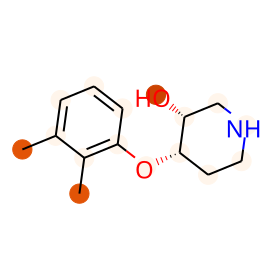

BBBP:1
prediction: [-1.7219753  1.7007751]
O=C(/C=C/c1ccc2c(c1)OCO2)N1CCCCC1


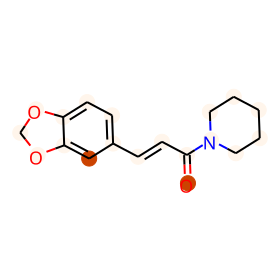

BBBP:1
prediction: [-3.0060937  2.9023364]
COc1cc(C(C)=O)ccc1OCCCN1CCC(c2noc3cc(F)ccc23)CC1


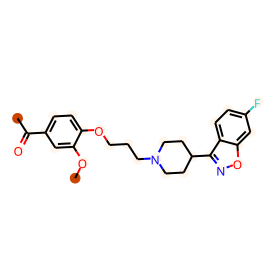

BBBP:1
prediction: [-3.8625607  3.8179357]
CN1CCN(CCN2CCN(CCCN3c4ccccc4Sc4ccc(Cl)cc43)CC2)C1=O


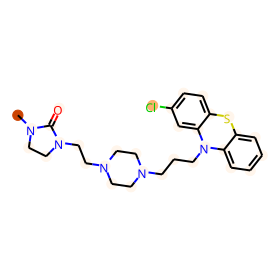

BBBP:1
prediction: [-2.4353824  2.3774083]
CN(C)CCN1CCN(c2cccc(Cl)c2)C1=O


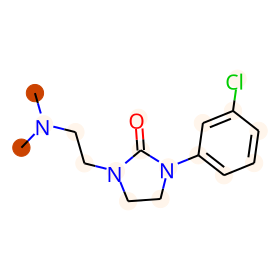

BBBP:1
prediction: [-0.3620805   0.08840928]
C[N+](C)([O-])CCCN1c2ccccc2CCc2ccccc21


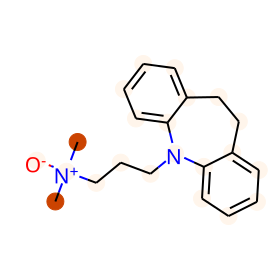

BBBP:1
prediction: [-2.134146   2.1389878]
C1=Cc2cccc(OCC3CNCCO3)c2C1


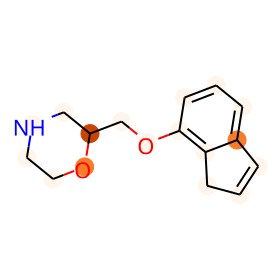

BBBP:1
prediction: [ 0.66207176 -1.0554487 ]
COc1ccc2c(c1)c(CC(=O)O)c(C)n2C(=O)c1ccc(Cl)cc1


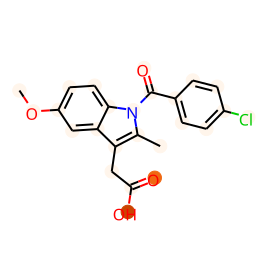

BBBP:1
prediction: [-2.887319   2.8436677]
CN(C)CCC1(c2ccccc2)C=Cc2ccccc21


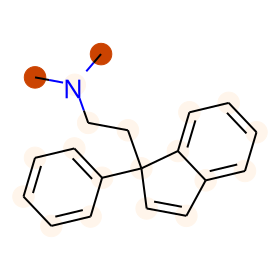

BBBP:1
prediction: [-1.4114656  1.3198254]
CC(C)NNC(=O)COc1ccc(Cl)cc1


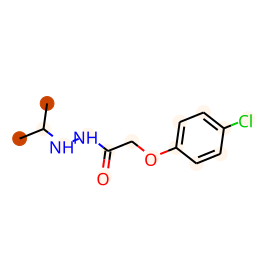

BBBP:1
prediction: [-2.4441783  2.3090994]
CSc1c(Cl)nc(NC(C)C)nc1N1CCN(C)CC1


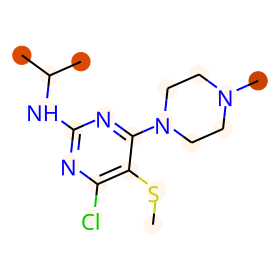

BBBP:1
prediction: [-3.6196816  3.3773425]
CC12C=CC(=O)C=C1CCC1C3CCC(O)(C(=O)CO)C3(C)CC(O)C12F


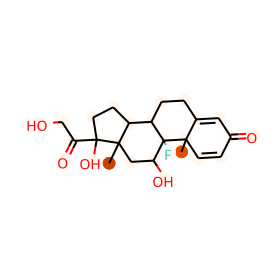

BBBP:1
prediction: [-2.782921  2.519347]
CC(=O)OCC(=O)[C@@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


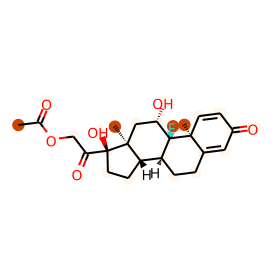

BBBP:1
prediction: [-1.6564246  1.5844679]
C=C[C@@H]1CNCC[C@H]1CCCc1ccnc2ccc(OC)cc12


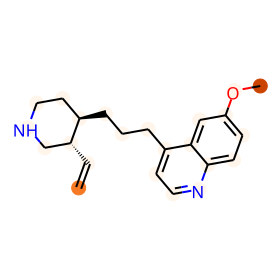

BBBP:1
prediction: [-1.8489151  1.688132 ]
CC1[C@H]2C(=O)c3ccc(O)cc3[C@]1(C)CCN2CC1CC1


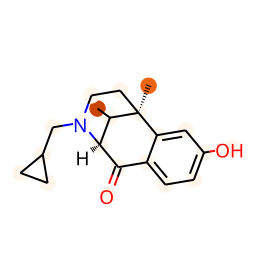

BBBP:1
prediction: [-2.544938   2.5639505]
Clc1cnn(CCCCN2CCN(c3ncccn3)CC2)c1


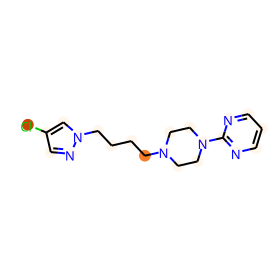

BBBP:1
prediction: [-1.8099369  1.7756383]
O=C1N(c2ccccc2)c2ccccc2C1(Cc1ccncc1)Cc1ccncc1


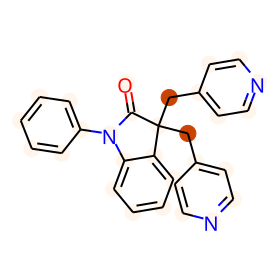

BBBP:1
prediction: [-2.511641   2.3784616]
CCN(CC)C(=O)N[C@H]1C=C2c3cccc4[nH]cc(c34)C[C@H]2N(C)C1


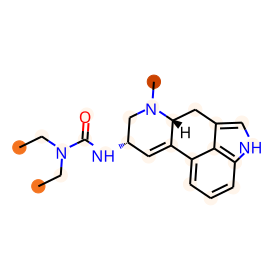

BBBP:1
prediction: [-2.6668954  2.599203 ]
CNCCC=C1c2ccccc2C(C)(C)c2ccccc21


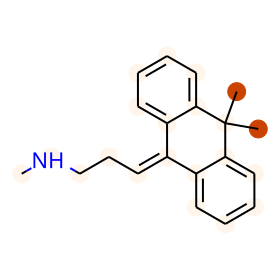

BBBP:1
prediction: [-2.1471033  2.1375635]
O=C1CCNc2ccc(Cl)cc2N1c1ccccc1


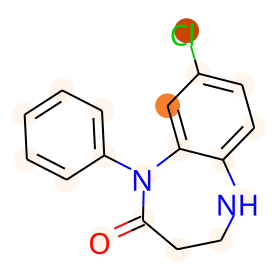

BBBP:1
prediction: [-1.8504676  1.686084 ]
CCC(=O)N(c1ccccc1)[C@]1(C(=O)OC)CCN(CCc2ccccc2)C[C@@H]1C


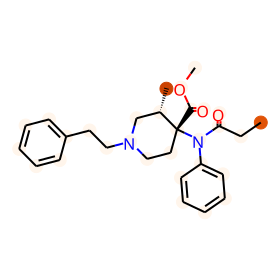

BBBP:1
prediction: [-2.438582   2.3452752]
CN(CCCN1c2ccccc2CCc2ccccc21)CC(=O)c1ccc(Cl)cc1.[Cl-].[H+]


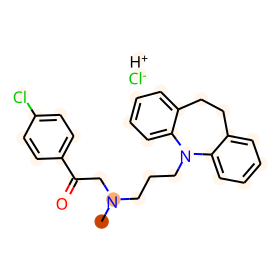

BBBP:1
prediction: [-2.469129   2.4198678]
O=C1Nc2ccc(Cl)nc2C(c2ccccc2Cl)=NC1O


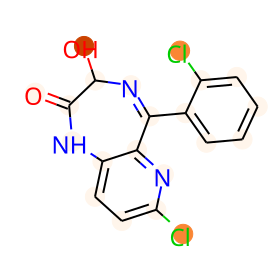

BBBP:1
prediction: [-2.8966956  2.8767722]
CCOC(=O)N1CCC(=C2c3ccc(Cl)cc3CCc3cccnc32)CC1


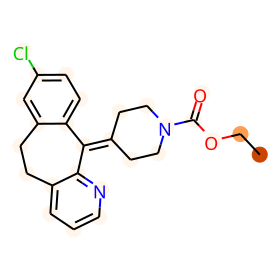

BBBP:1
prediction: [-2.7660637  2.6979647]
CN1C(=O)C(O)N=C(c2ccccc2Cl)c2cc(Cl)ccc21


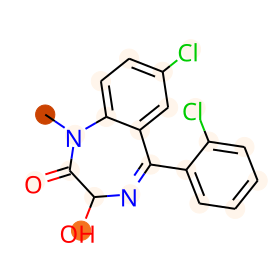

BBBP:1
prediction: [-3.5533671  3.4479373]
FC(F)(F)c1cccc(N2CCN(CCc3nnc4n3C[C@H]3CCC[C@@H]43)CC2)c1


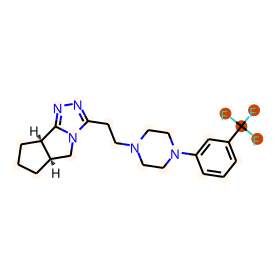

BBBP:1
prediction: [-1.2205156  1.077174 ]
CN1CC[C@]23NC(=O)CC(c4cc(Cl)ccc4O2)C3C1


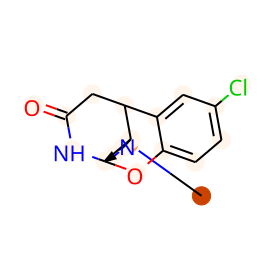

BBBP:1
prediction: [-0.4425038   0.27070317]
COC1=CC(=O)OC1C(O)c1ccccc1Cl


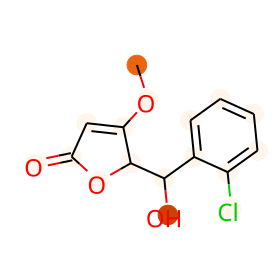

BBBP:1
prediction: [-3.7480335  3.5067112]
CCOC(=O)OC1(C(=O)OCCl)CCC2C3CCC4=CC(=O)C=CC4(C)C3C(O)CC21C


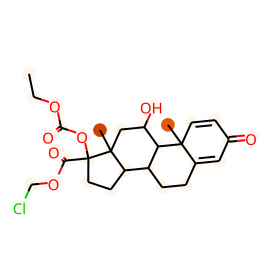

BBBP:1
prediction: [-2.9268029  2.9060042]
CN1CCN(C2=Nc3ccccc3Oc3ccc(Cl)cc32)CC1


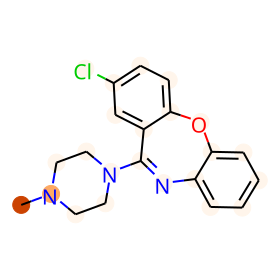

BBBP:1
prediction: [-1.2625071  1.173972 ]
OC1(c2ccc(Cl)cc2)c2ccccc2C2=NCCN21


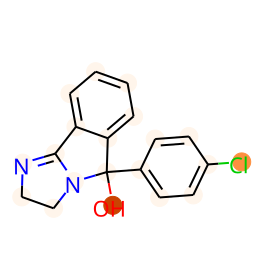

BBBP:1
prediction: [-2.952389  2.68226 ]
CN1CCN(CC(=O)[C@@]2(O)CC[C@H]3[C@@H]4CCC5=CC(=O)C=C[C@]5(C)[C@H]4[C@@H](O)C[C@@]32C)CC1


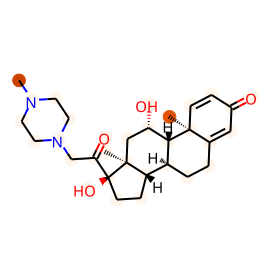

BBBP:1
prediction: [-0.8897558   0.80991924]
CC(NN)c1ccccc1


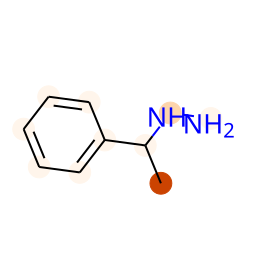

BBBP:1
prediction: [-1.9500178  1.8535286]
CCC(C)C(C)(COC(N)=O)COC(N)=O


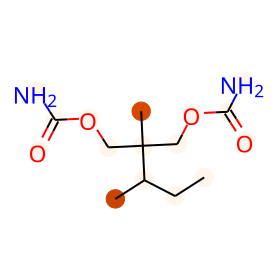

BBBP:1
prediction: [-1.6386833  1.5323114]
C[C@@H]1N=C(c2ccccc2Cl)c2cc([N+](=O)[O-])ccc2NC1=O


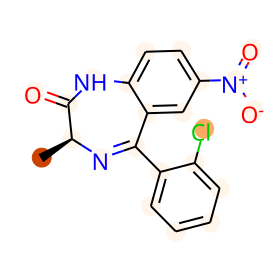

BBBP:1
prediction: [-2.2162225  2.1245   ]
CNC(=O)NC(O)C(Cl)(Cl)Cl


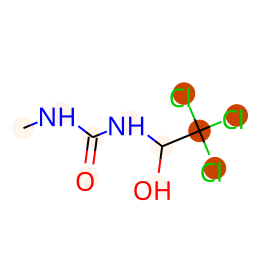

BBBP:1
prediction: [-4.2368174  3.9464011]
C[C@@H]1CC2C3CCC4=CC(=O)C=CC4(C)[C@@]3(Cl)C(Cl)CC2(C)[C@@]1(O)C(=O)CO


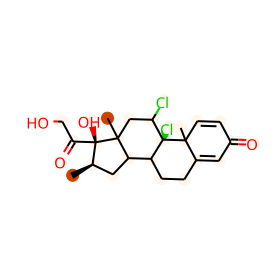

BBBP:1
prediction: [-1.7165233  1.6097702]
CCN(CC)CCNC(=O)COc1ccc(OC)cc1.[Cl-].[H+]


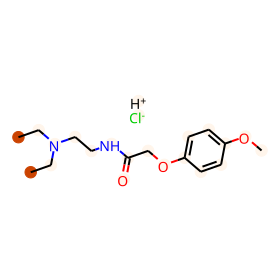

BBBP:1
prediction: [-2.7934184  2.6719434]
CN(C)CCC=C1c2ccccc2C(C)(C)c2ccccc21


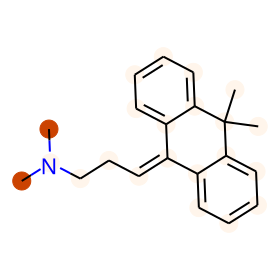

BBBP:1
prediction: [-2.0917819  2.0376813]
CC1CCN(CCCC(=O)c2ccc(F)cc2)CC1


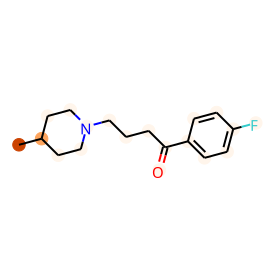

BBBP:1
prediction: [-2.0041327  1.9099574]
CC12CC3CC(C)(C1)CC(N)(C3)C2


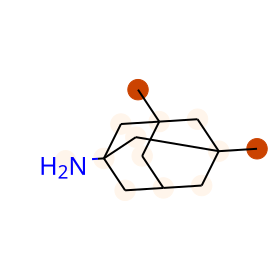

BBBP:1
prediction: [-1.3926693  1.3417491]
COc1ccccc1OCC1CNC(=O)O1


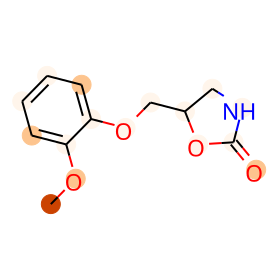

BBBP:1
prediction: [-2.7178993  2.605222 ]
COc1ccc2c(c1)C(O)(CCCN(C)C)c1ccccc1S2


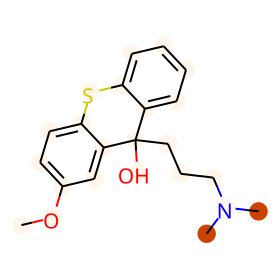

BBBP:1
prediction: [-0.31637323  0.19705653]
CC(=O)Nc1cccc(O)c1


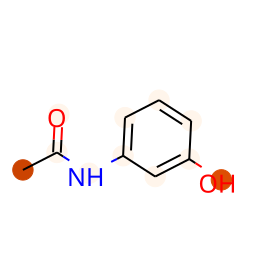

BBBP:1
prediction: [-1.8605746  1.7361042]
CC(C)(O)C(C)(O)c1cccc(Cl)c1


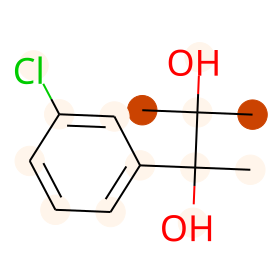

BBBP:1
prediction: [-0.7710011  0.6605047]
CN(C)CCN(Cc1cccs1)c1ccccn1


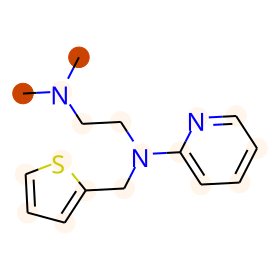

BBBP:1
prediction: [-2.1893518  2.1192014]
CCC1(CC)C(=O)NC(=O)N(C)C1=O


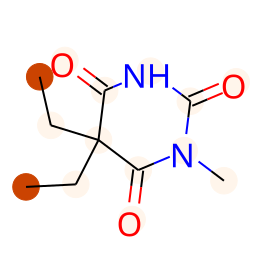

BBBP:1
prediction: [-1.5003278  1.365107 ]
CCCC(C)C1(CCSC)C(=O)NC(=S)NC1=O


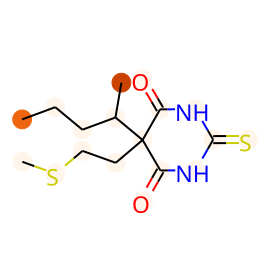

BBBP:1
prediction: [-2.4850717  2.3502457]
CC1=CCC2C3Cc4ccc(O)c5c4C2(CCN3C)C1O5


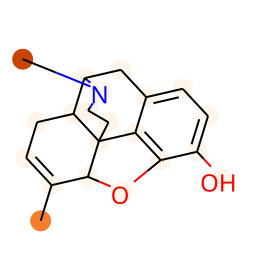

BBBP:1
prediction: [-2.4951854  2.3635314]
CO[C@H]1CC[C@H]2[C@H]3Cc4ccc(O)c5c4[C@@]2(CCN3C)[C@H]1O5


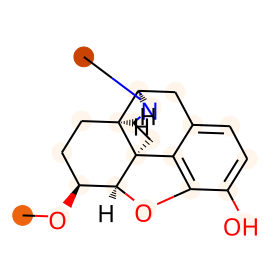

BBBP:1
prediction: [-3.3174965  3.0167782]
CCC(=O)O[C@]1(C(=O)COC(C)=O)CC[C@H]2[C@@H]3C[C@H](C)C4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]21C


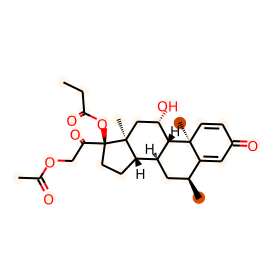

BBBP:1
prediction: [-3.0492494  3.0149288]
Cc1ccc2c(c1)C(N1CCN(C)CC1)=Nc1ccccc1S2


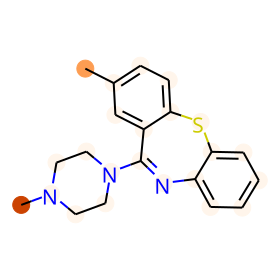

BBBP:1
prediction: [-3.0518756  2.8646696]
COc1cc(C(=O)OCCN2CCN(CCCN3c4ccccc4Sc4ccc(Cl)cc43)CC2)cc(OC)c1OC


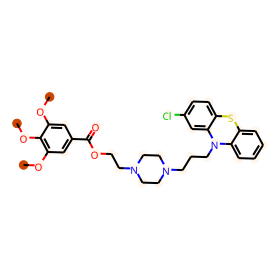

BBBP:1
prediction: [-3.1816235  3.1158931]
CS(=O)(=O)c1ccc2c(c1)N(CCCN1CCC(C(N)=O)CC1)c1ccccc1S2


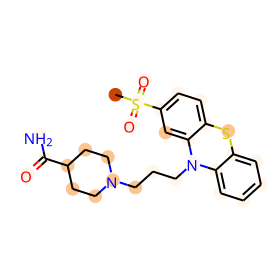

BBBP:1
prediction: [-3.052577   2.9357576]
CN1CC[C@]23c4c5ccc(O)c4O[C@@]2(C)C(=O)CC[C@H]3[C@H]1C5


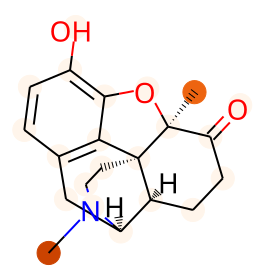

BBBP:1
prediction: [-2.5803413  2.3394997]
COC(=O)C1C2CC3c4[nH]c5cc(OC)ccc5c4CCN3CC2CC(OC)C1OC


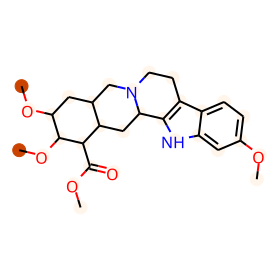

BBBP:1
prediction: [-2.790214   2.7466261]
COc1ccc2c(c1)C(N1CCN(C)CC1)=Cc1ccccc1O2


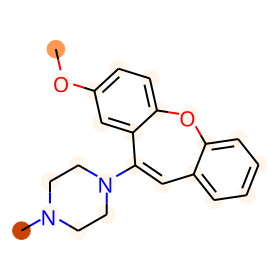

BBBP:1
prediction: [-2.615749   2.5782268]
COc1ccc2c(c1)c1c3n2CCN(C)C3=NCC1


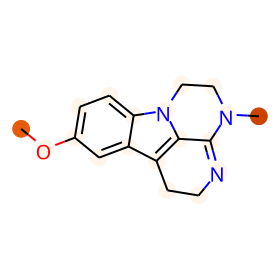

BBBP:1
prediction: [ 0.3640621  -0.73056144]
CC[C@H](C)C(=O)O[C@H]1CCC=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@@H](O)CC(=O)O3)[C@H]21


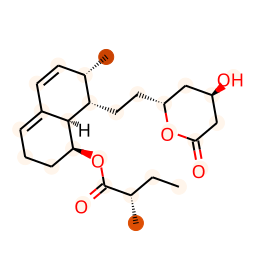

BBBP:1
prediction: [-2.9977922  2.8943555]
CC1COC2(c3ccccc3Cl)c3cc(Cl)ccc3NC(=O)CN12


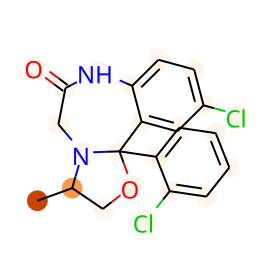

BBBP:1
prediction: [-2.6271796  2.5495636]
CNc1nc(Cl)c(SC)c(N2CCN(C)CC2)n1


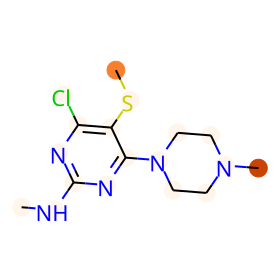

BBBP:1
prediction: [-0.4306718   0.23236194]
Clc1ccc(COC(Cn2ccnc2)c2ccc(Cl)cc2Cl)c(Cl)c1


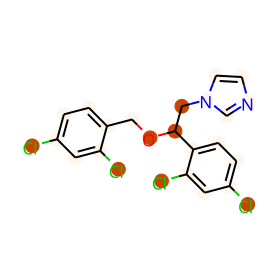

BBBP:1
prediction: [-6.606826   6.2937064]
NC1=NC(C(F)(F)F)(C(F)(F)F)NC1(C(F)(F)F)C(F)(F)F


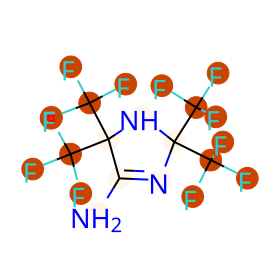

BBBP:1
prediction: [-1.7028054  1.686272 ]
CCCCCNCC(N)=O


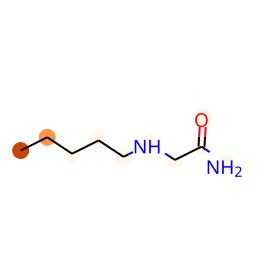

BBBP:1
prediction: [-1.3722576  1.2971387]
CO/N=C/C1=CCCN(C)C1


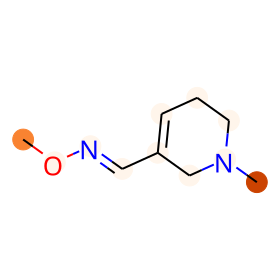

BBBP:1
prediction: [-2.160034   2.1293468]
Cc1cc(-c2ccccc2)nnc1NCCN1CCOCC1


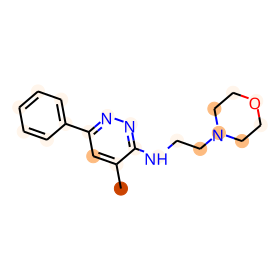

BBBP:1
prediction: [-1.4571553  1.1008221]
CCO[C@H]1C[C@@]2(C)[C@@H](CC[C@H]3[C@@H]4CC[C@H](C(C)=O)[C@@]4(C)C[C@@H](N(C)C)[C@@H]32)C[C@@H]1O


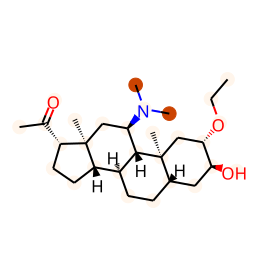

BBBP:1
prediction: [-2.4368267  2.2992313]
CN1[C@H]2CC[C@@H]1CC(NC(=O)c1cn(C3CCCCC3)c3ccccc3c1=O)C2


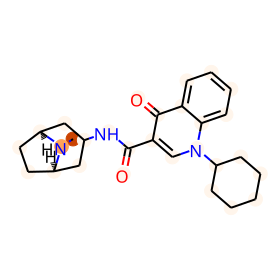

BBBP:1
prediction: [-2.2892609  2.2794101]
O=C(NCCN1CCOCC1)c1ccc(Cl)cc1


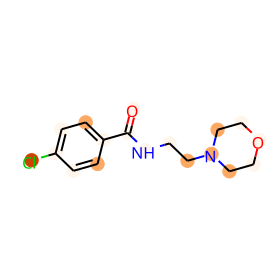

BBBP:1
prediction: [-3.4589581  3.203353 ]
C[C@@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(Cl)[C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)CCl


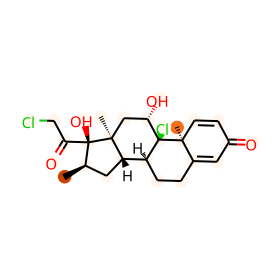

BBBP:1
prediction: [-2.8029895  2.7442763]
CNCCCN1c2ccccc2C(C)(C)c2ccccc21


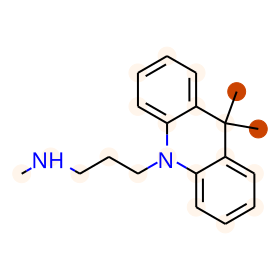

BBBP:1
prediction: [-3.1935105  3.1713047]
CC1(c2ccccc2)CC(=O)N(CN2CCOCC2)C1=O


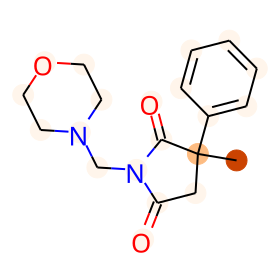

BBBP:1
prediction: [-3.6126735  3.5521414]
O=C1NC2CCCCN2C12CCN(CCCN1c3ccccc3CCc3ccc(Cl)cc31)CC2


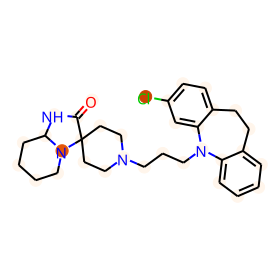

BBBP:1
prediction: [-2.3381948  2.292991 ]
COCN1C(=O)CN=C(c2ccccc2)c2cc([N+](=O)[O-])ccc21


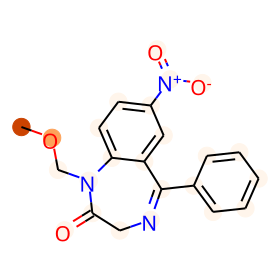

BBBP:1
prediction: [-2.5958595  2.4977384]
CNC(=O)O[C@H]1OC(=O)[C@]2(C)[C@@H]3C=C[C@@H](C3)[C@H]12


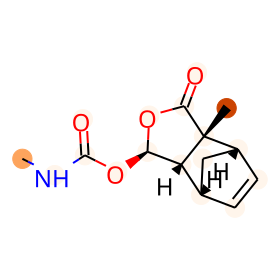

BBBP:1
prediction: [-1.8516623  1.7684991]
CC1=CC(=C2C=CC(=O)C=C2)NN=C1NCCN1CCOCC1


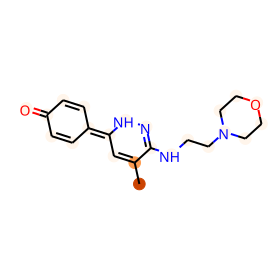

BBBP:1
prediction: [-3.6269798  3.4761064]
CCCCCCCCCCCCCC(=O)O[C@H]1C=C[C@H]2[C@H]3Cc4ccc(OCc5ccccc5)c5c4[C@@]2(CCN3C)[C@H]1O5


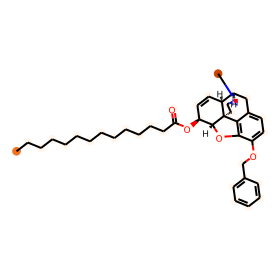

BBBP:1
prediction: [-2.1772566  1.8275702]
CCCCCC(C)C(C)c1cc(OC(=O)CCCN2CCCCCC2)c2c(c1)OC(C)(C)C1=C2CC(C)CC1


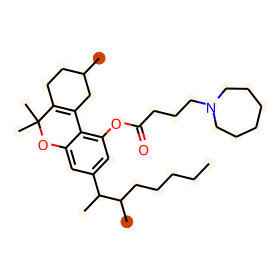

BBBP:1
prediction: [-1.9897541  1.7592833]
CCCCCCC(C)(C)c1cc(O)c2c(c1)OC(C)(C)[C@@H]1CCC(=O)C[C@@H]21


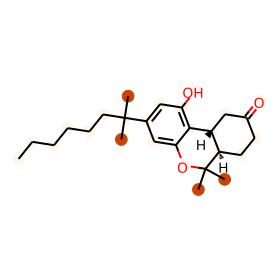

BBBP:1
prediction: [-0.26931122  0.16579953]
O=C(Cn1ccnc1)c1ccc2ccccc2c1


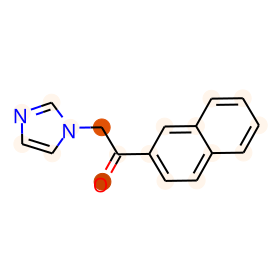

BBBP:1
prediction: [-1.4517808  1.1243232]
C[C@]12C[C@H](O)[C@@]3(F)[C@@H](CCC4=CC(=O)C=C[C@@]43C)[C@@H]1C[C@H]1Cc3ccccc3C[C@]12C(=O)CO.O


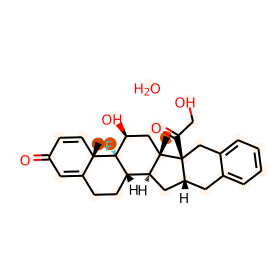

BBBP:1
prediction: [-2.5739374  2.4173121]
Oc1ccc2c3c1OC1C(O)CCC4(O)C(C2)N(CC2CCC2)CCC314


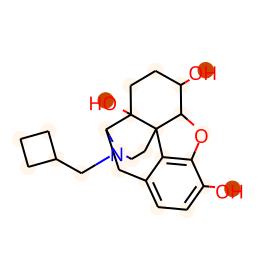

BBBP:1
prediction: [-1.6859895  1.5542927]
C=C1CC[C@@]2(O)[C@H]3Cc4ccc(O)c5c4[C@@]2(CCN3CC2CC2)[C@H]1O5


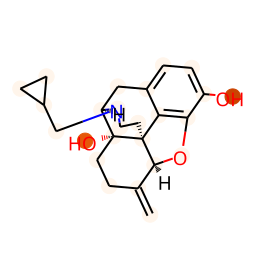

BBBP:1
prediction: [-2.1852312  2.014632 ]
CC(C)=CCN1CC[C@]23c4c5ccc(O)c4O[C@H]2C(=O)CC[C@@]3(O)[C@H]1C5


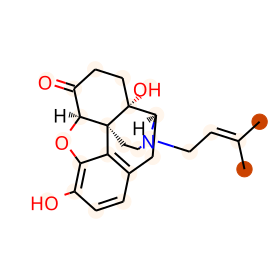

BBBP:1
prediction: [-0.975412  0.894114]
CN=C(Cc1ccc2ccccc2c1)[NH2+]C.[Cl-]


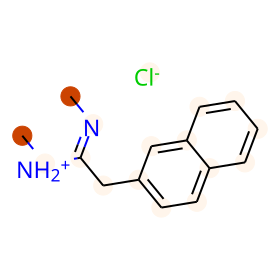

BBBP:1
prediction: [-0.38943723  0.25387135]
CC(Oc1cccc2ccccc12)/C(N)=N/O


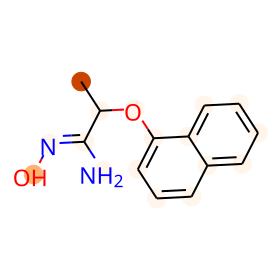

BBBP:1
prediction: [-1.6060799  1.5980457]
O=C(CCNNC(=O)c1ccncc1)NCc1ccccc1


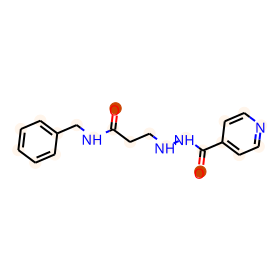

BBBP:1
prediction: [-2.5886092  2.5249798]
CC(CCN1CCN(c2ccc(F)cc2)CC1)NC(=O)c1cccnc1


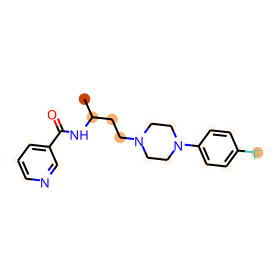

BBBP:1
prediction: [-2.9376159  2.774464 ]
CN1CC[C@]23c4c5ccc(OC(=O)c6cccnc6)c4O[C@H]2[C@@H](OC(=O)c2cccnc2)C=C[C@H]3[C@H]1C5


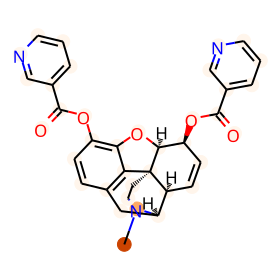

BBBP:1
prediction: [-1.6383208  1.6358463]
O=C(c1cccnc1)N1CCOCC1


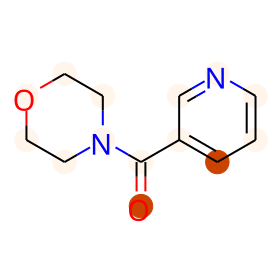

BBBP:1
prediction: [-1.1294869  1.0963637]
NC(=O)c1cccnc1


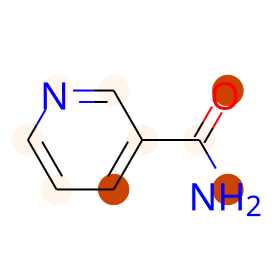

BBBP:1
prediction: [-1.6656469  1.6256092]
CCN(CC)C(=O)c1cccnc1


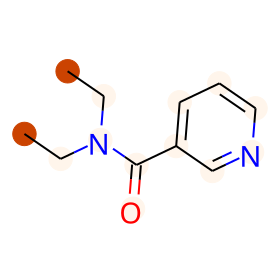

BBBP:1
prediction: [-2.2377756  2.2005794]
CN1C(=O)CN=C(c2ccccc2)c2cc([N+](=O)[O-])ccc21


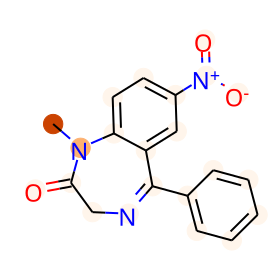

BBBP:1
prediction: [-1.992369   1.8112712]
CCC(C)C(C)(COC(N)=O)COC(=O)NC(C)C


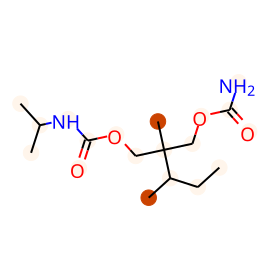

BBBP:1
prediction: [-2.0071206  1.9686666]
CNCCC(Oc1ccccc1OC)c1ccccc1


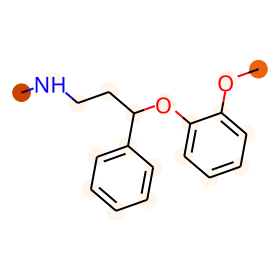

BBBP:1
prediction: [-1.5388185  1.5007037]
N=C(N)c1ccc(-c2ccccc2[N+](=O)[O-])o1


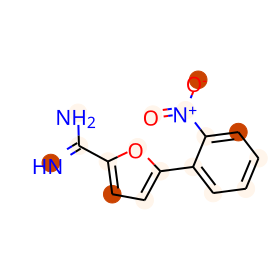

BBBP:1
prediction: [-2.4141638  2.1861556]
C#C[C@]1(O)CC[C@H]2C3CCC4=Cc5c(cnn5-c5ccc(F)cc5)CC4(C)[C@H]3CCC21C


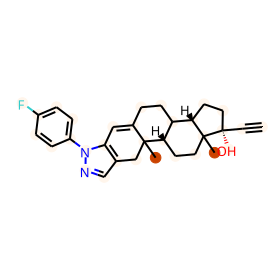

BBBP:1
prediction: [-2.0329075  2.009806 ]
CNC/C=C(/c1ccc(Br)cc1)c1cccnc1


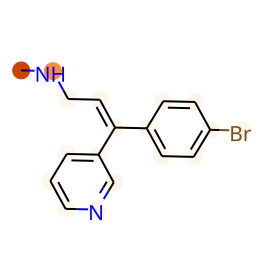

BBBP:1
prediction: [-2.2597935  2.2262266]
CN1Cc2c(N)cccc2C(c2ccccc2)C1


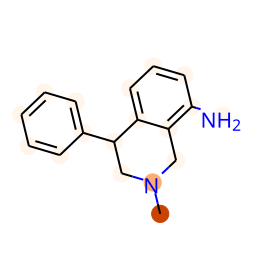

BBBP:1
prediction: [-1.3618388  1.3272802]
CCCCCCCCCNc1ncnc2[nH]ccc12


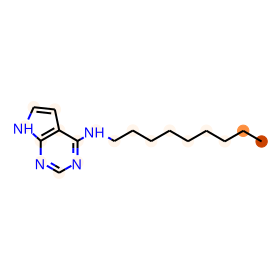

BBBP:1
prediction: [-2.4711962  2.410969 ]
FCC(F)(F)F


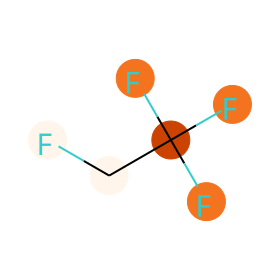

BBBP:1
prediction: [-2.1393712  2.0371678]
Oc1ccc2c3c1OC1C(O)C=CC4C(C2)NCCC341


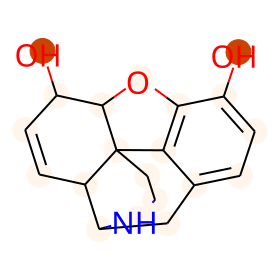

BBBP:1
prediction: [-1.4695985  1.4086871]
O=C1CN=C(C2=CCCCC2)c2cc(Cl)ccc2N1


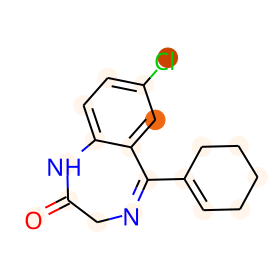

BBBP:1
prediction: [-2.5876136  2.3992636]
COc1ccc2c(c1OC)C(=O)O[C@@H]2[C@H]1c2c(cc3c(c2OC)OCO3)CCN1C


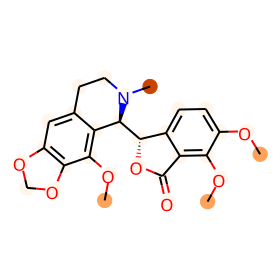

BBBP:1
prediction: [-2.571598   2.5294397]
CN(C)CCON=C1c2ccccc2CCc2ccccc21


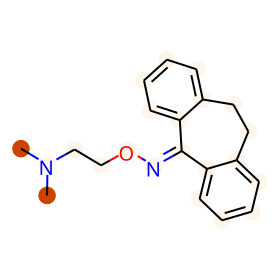

BBBP:1
prediction: [-3.0018284  2.9765592]
Clc1ccc2c(c1)/C(=C/C1CN3CCC1CC3)c1ccccc1S2


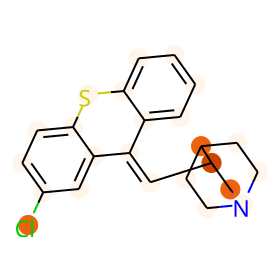

BBBP:1
prediction: [-3.3025656  3.185999 ]
Cc1nc2c(C)cccn2c(=O)c1CCN1CCC(c2noc3cc(F)ccc23)CC1


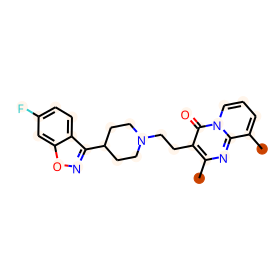

BBBP:1
prediction: [-1.0050024  0.9207277]
O=C(c1ccccn1)c1cnn2c(-c3ccncc3)ccnc12


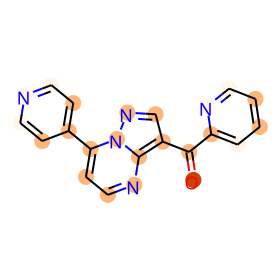

BBBP:1
prediction: [-1.0514177  0.9690721]
CCCCCCC(C)NN


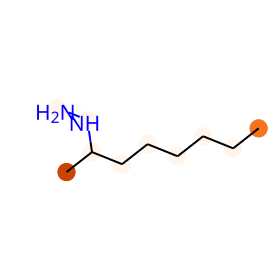

BBBP:1
prediction: [-2.797432  2.776379]
CNCCC=C1c2ccccc2C2CC2c2ccccc21


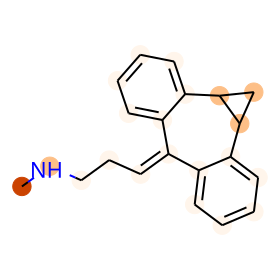

BBBP:1
prediction: [-1.6852871  1.5273042]
O=C(CN1CC[C@H](c2ccc(F)cc2)[C@@H](COc2ccc3c(c2)OCO3)C1)c1ccc(F)cc1


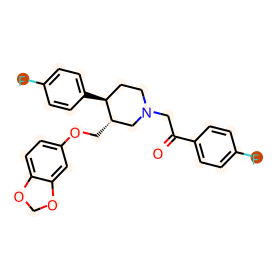

BBBP:1
prediction: [-3.675228   3.5495512]
CC(C)N1CCOC(c2ccc(C(F)(F)F)cc2)C1


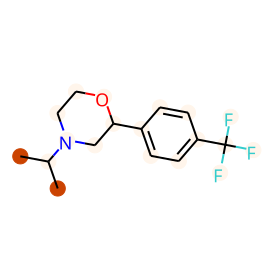

BBBP:1
prediction: [-2.7419682  2.7595208]
NC(=O)N1c2ccccc2CC(=O)c2ccccc21


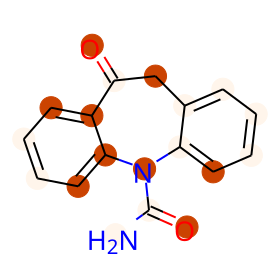

BBBP:1
prediction: [-2.0296638  1.971214 ]
CC(Cc1ccccc1)[N+](C)([O-])Cc1ccccc1


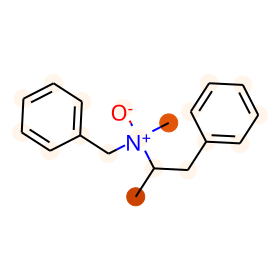

BBBP:1
prediction: [ 0.6524006 -1.0248553]
NC(Cc1c[nH]c2ccc(O)cc12)C(=O)O


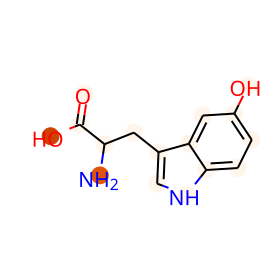

BBBP:1
prediction: [-2.6242564  2.5912554]
CN(C)C(=O)COC1c2ccccc2CCc2ccccc21


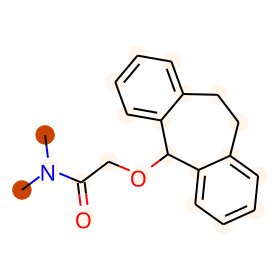

BBBP:1
prediction: [-1.7471582  1.567534 ]
CC(C)CCC(=O)CC1c2ccccc2C(=O)N1c1ccc2ccc(Cl)nc2n1


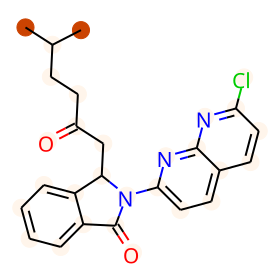

BBBP:1
prediction: [-2.2508435  2.1331716]
CC(C)n1c(=O)c2c(-c3noc(C4CC4)n3)ncn2c2ccccc21


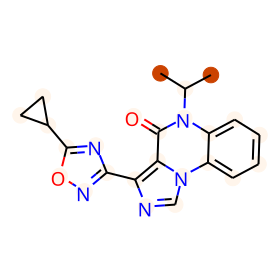

BBBP:1
prediction: [-1.8709097  1.7496963]
COc1ccc(N2C[C@H](CN3CCC(O)(c4ccc5c(c4)OCO5)CC3)OC2=O)cc1


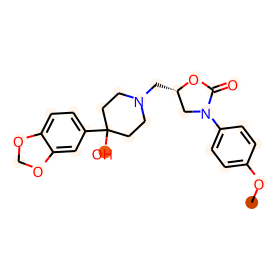

BBBP:1
prediction: [-2.4051952  2.3687334]
O=C(NC(=O)c1ccccc1)NC1CCN(Cc2ccc3ccccc3c2)CC1


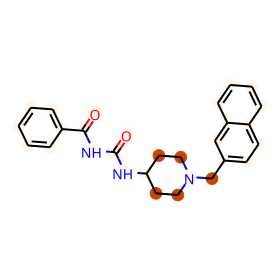

BBBP:1
prediction: [-3.2995706  2.9875402]
CC(=O)OCC(=O)[C@@]1(O)[C@H](C)C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]21C


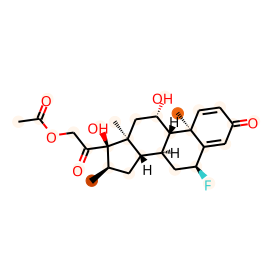

BBBP:1
prediction: [-1.9567022  1.9434649]
C#CCN(C)Cc1ccccc1


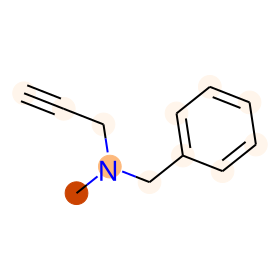

BBBP:1
prediction: [-2.5860066  2.487606 ]
O=C(CC1c2ccccc2C(=O)N1c1ccc2ccc(Cl)nc2n1)N1CCC2(CC1)OCCO2


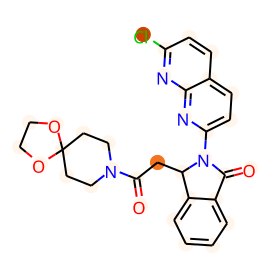

BBBP:1
prediction: [-3.0837202  2.8320296]
OC1(c2ccc(Cl)c(C(F)(F)F)c2)CCN(CCCC(c2ccc(F)cc2)c2ccc(F)cc2)CC1


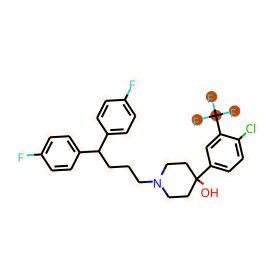

BBBP:1
prediction: [-1.5473124  1.4111031]
CC(OC(N)=O)C(C)C(C)OC(N)=O


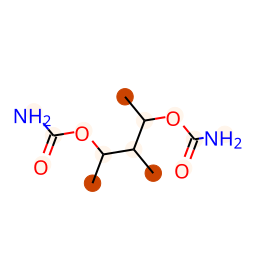

BBBP:1
prediction: [-3.0086818  2.8712425]
CCCCCN[C@@]12C=CC(=O)[C@@H]3Oc4c(O)ccc5c4[C@@]31CCN(C)[C@@H]2C5


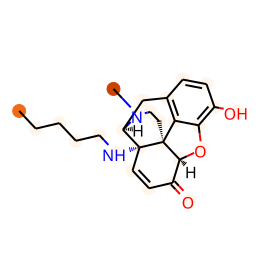

BBBP:1
prediction: [-3.1738658  3.1818478]
CN1CCN(C2=Nc3ccccc3Sc3nccn32)CC1


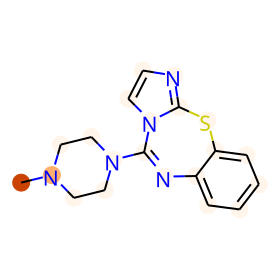

BBBP:1
prediction: [-2.0592303  1.9789801]
O=C1[C@H]2CCCC[C@H]2C(=O)N1CCCCN1CCN(c2nsc3ccccc23)CC1


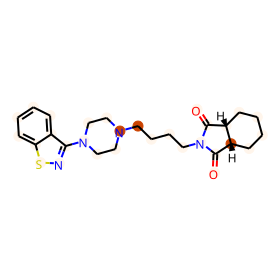

BBBP:1
prediction: [-2.927711   2.8963444]
OCCN1CCN(CCCN2c3ccccc3Sc3ccc(Cl)cc32)CC1


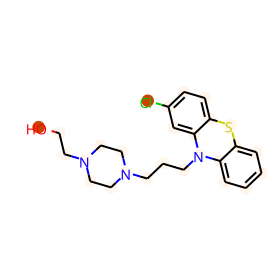

BBBP:1
prediction: [-3.7855668  3.2994168]
OC(OCC(COC(O)C(Cl)(Cl)Cl)(COC(O)C(Cl)(Cl)Cl)COC(O)C(Cl)(Cl)Cl)C(Cl)(Cl)Cl


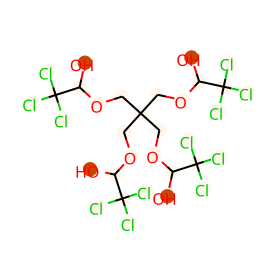

BBBP:1
prediction: [-1.0554689  1.0117638]
NC(=O)NC(=O)Cc1ccccc1


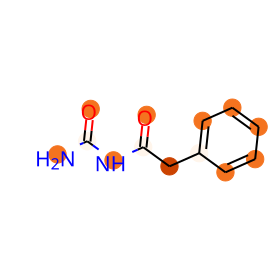

BBBP:1
prediction: [-1.6646328  1.503865 ]
CC1C2Cc3ccc(O)cc3C1(C)CCN2CCc1ccccc1


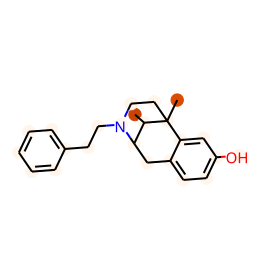

BBBP:1
prediction: [-0.9990635  0.9190472]
CCC(C(=O)NC(N)=O)c1ccccc1


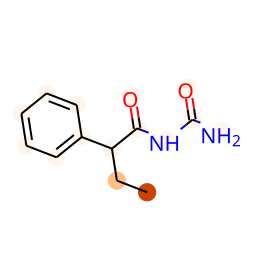

BBBP:1
prediction: [-1.6789538  1.6425374]
CC1NCCOC1c1ccccc1


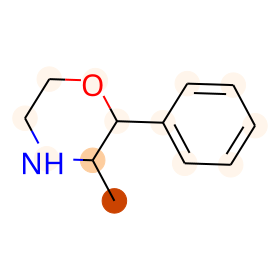

BBBP:1
prediction: [-0.9406104  0.8719774]
CC(COc1ccccc1)NN


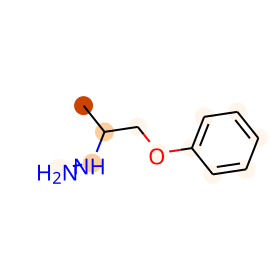

BBBP:1
prediction: [-2.0654042  2.049503 ]
CN1C(=O)CC(c2ccccc2)C1=O


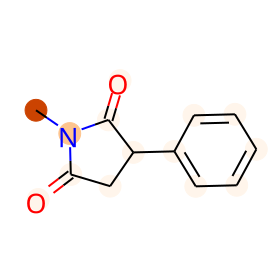

BBBP:1
prediction: [-1.5201904  1.4888421]
O=C1NC(=O)C(c2ccccc2)(c2ccccc2)N1


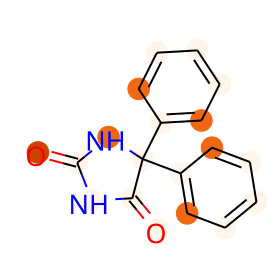

BBBP:1
prediction: [-2.4397378  2.3914254]
CCC1(CC)C(=O)NC(=O)N(c2ccccc2)C1=O


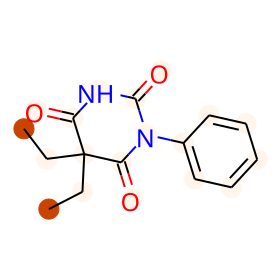

BBBP:1
prediction: [-2.776105   2.8194106]
O=C(c1ccccn1)N1CCN(Cc2ccccc2)CC1


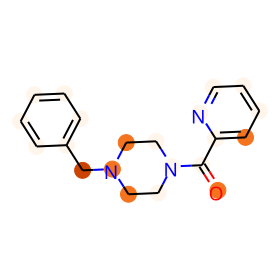

BBBP:1
prediction: [-0.5078017   0.37950245]
CC(=O)Nc1ccc(OC(=O)[C@@H]2CCC(=O)N2)cc1


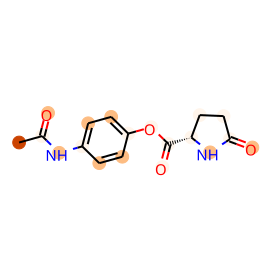

BBBP:1
prediction: [-2.2353175  2.2429914]
c1ccc(-c2cc(CCC3CCNCC3)c3ccccc3n2)cc1


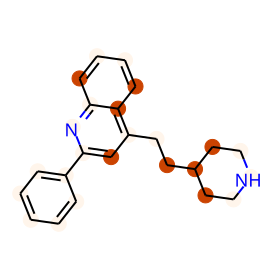

BBBP:1
prediction: [-2.623704   2.5502875]
CC(=O)c1ccc2c(c1)N(CCCN1CCC(CCO)CC1)c1ccccc1S2


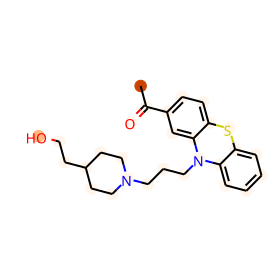

BBBP:1
prediction: [-3.1121094  3.0899692]
CN1CCN(c2cc3c(nn2)Oc2ccccc2N3C)CC1


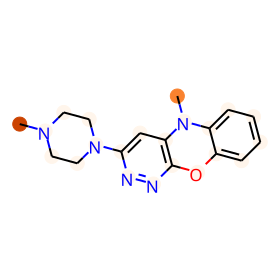

BBBP:1
prediction: [-2.8804507  2.6851714]
CCCCCCCCCCCCCCCC(=O)OCCC1CCN(CCCN2c3ccccc3Sc3ccc(S(=O)(=O)N(C)C)cc32)CC1


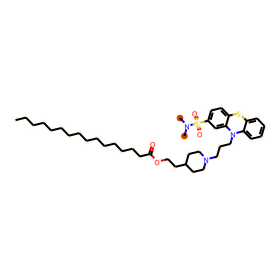

BBBP:1
prediction: [-2.0576854  1.9948406]
Cc1ccccc1-n1c(/C=C/c2ccccn2)nc2ccccc2c1=O


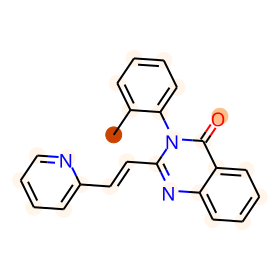

BBBP:1
prediction: [-1.4653429  1.328376 ]
N#CC(CCN1CCC(C(N)=O)(N2CCCCC2)CC1)(c1ccccc1)c1ccccc1


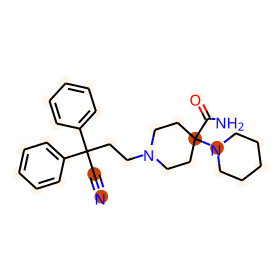

BBBP:1
prediction: [-2.4729376  2.4391515]
Cc1ccc2c(c1)c1c3n2CCNC3CCC1.[Cl-].[H+]


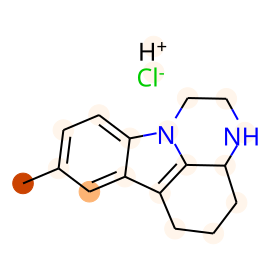

BBBP:1
prediction: [ 0.36960667 -0.60478413]
CC(C)(C)C(=O)NCCCC(=O)O


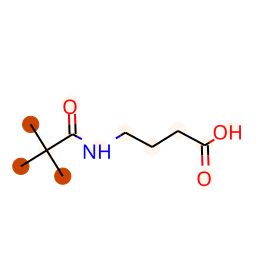

BBBP:1
prediction: [-2.2366621  2.0892642]
CC(C)(C)C(=O)OC1N=C(c2ccccc2)c2cc(Cl)ccc2NC1=O


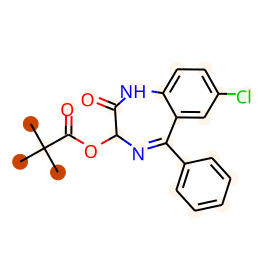

BBBP:1
prediction: [-1.2240678  1.1408801]
O=C1NC(=O)C(CC2CCCCN2)(c2ccccc2)C(=O)N1


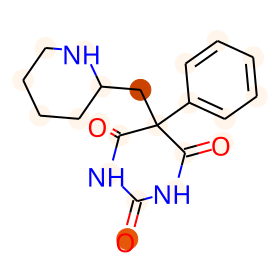

BBBP:1
prediction: [-3.2934885  3.0393322]
CCOC(=O)O[C@]1(C(=O)COC(=O)CC)CC[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]21C


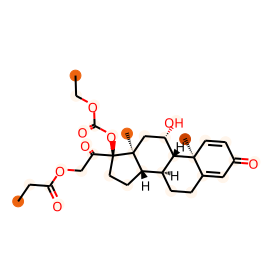

BBBP:1
prediction: [-3.8340478  3.5395653]
CCN(CC)CC(=O)OCC(=O)C1(O)CCC2C3CCC4=CC(=O)C=CC4(C)C3C(O)CC21C


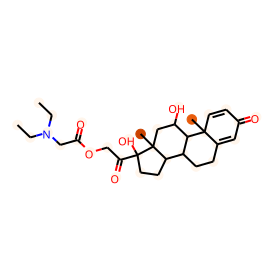

BBBP:1
prediction: [-2.83833    2.5501716]
CCCCCCCCCCCCCCCCCC(=O)OCC(=O)OCC(=O)[C@@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]21C


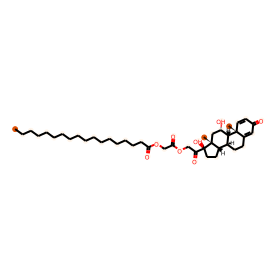

BBBP:1
prediction: [-2.3222778  1.975004 ]
CC(C)(C)CC(=O)OCC(=O)[C@@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]21C


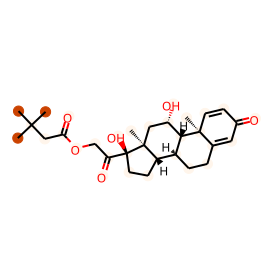

BBBP:1
prediction: [-2.58454    2.3341386]
C=C1CC2C3CCC4=CC(=O)C=CC4(C)C3C(O)CC2(C)C1(O)C(=O)CO


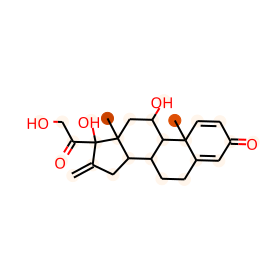

BBBP:1
prediction: [ 0.79598415 -1.0622895 ]
CC(C)C[C@H](CN)CC(=O)O


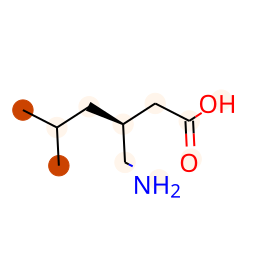

BBBP:1
prediction: [-1.5294031  1.4310806]
CNNCc1ccc(C(=O)NC(C)C)cc1


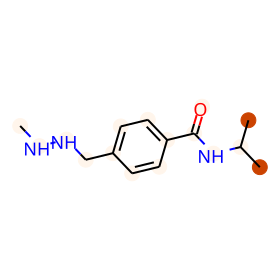

BBBP:1
prediction: [-0.92050016  0.6962453 ]
O=C1CN=C(c2ccccc2F)c2cc(Cl)ccc2N1CC(O)CO


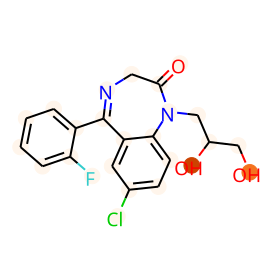

BBBP:1
prediction: [-2.695588  2.658826]
NC(=O)CCCN/C(=C1\C=C(F)C=CC1=O)c1ccc(Cl)cc1


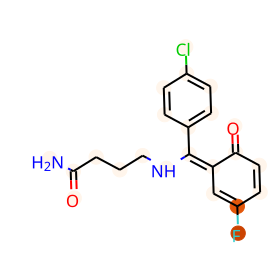

BBBP:1
prediction: [-2.1701407  2.152672 ]
CCCC(Cc1ccccc1)N1CCCC1


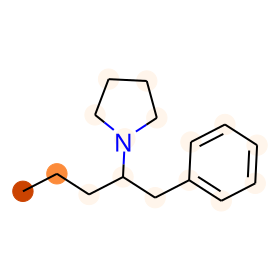

BBBP:1
prediction: [-1.6090403  1.4549387]
CC(C)C1(C(C)C)OCC(CO)O1


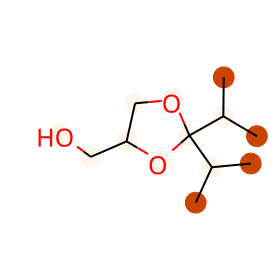

BBBP:1
prediction: [-1.8171623  1.7157717]
CCN(CC)CC(=O)Oc1ccc(NC(C)=O)cc1


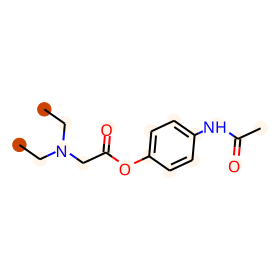

BBBP:1
prediction: [-1.2140723  1.1530597]
[CH2-][CH-]C


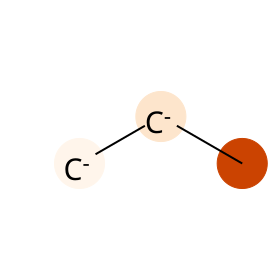

BBBP:1
prediction: [-2.477008   2.3601165]
CC(CN1C(=O)c2cccnc2Nc2ccccc21)N(C)C


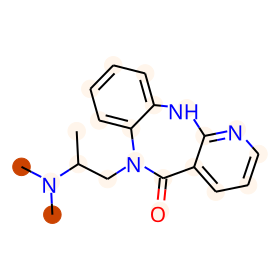

BBBP:1
prediction: [-0.73430336  0.5516548 ]
CC(C)c1cccc(C(C)C)c1O


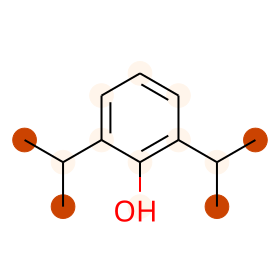

BBBP:1
prediction: [-2.6469436  2.5593116]
CCC(=O)C1(N2CCCCC2)CCN(CCCC(=O)c2ccc(F)cc2)CC1


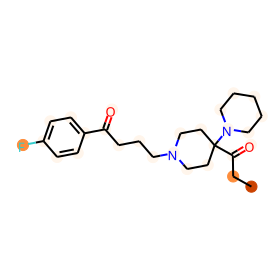

BBBP:1
prediction: [-2.667158   2.6210754]
CN(C)CCC=C1c2ccccc2Sc2ccccc21


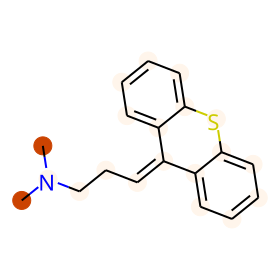

BBBP:1
prediction: [-1.2159884  1.0936747]
C=CCC1(CC(C)O)C(=O)NC(=O)NC1=O


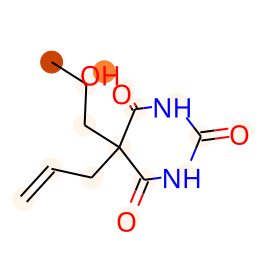

BBBP:1
prediction: [-1.4732102  1.3075148]
CC(O)Cn1cnc2c1c(=O)n(C)c(=O)n2C


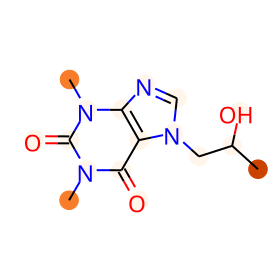

BBBP:1
prediction: [-2.4121883  2.3349202]
CN(C)CCc1c[nH]c2cccc(OP(=O)(O)O)c12


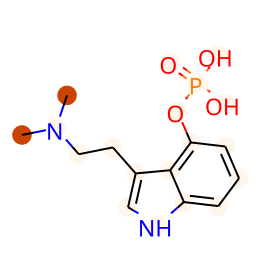

BBBP:1
prediction: [-1.866689   1.8850993]
c1ccc2oc(-c3ccncc3)cc2c1


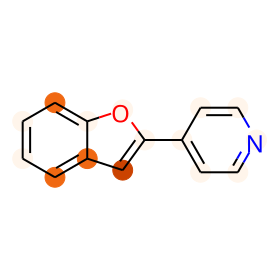

BBBP:1
prediction: [-2.715      2.7162917]
OCCOCCN1CCN(C2=Nc3ccccc3Sc3ccccc32)CC1


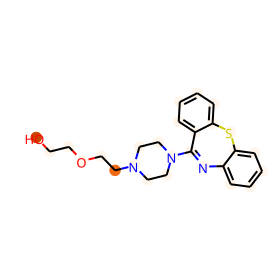

BBBP:1
prediction: [-2.7060204  2.5743458]
CN1CC[C@@]2(C)c3cc(OC(=O)N4CCc5ccccc5C4)ccc3N(C)[C@@H]12


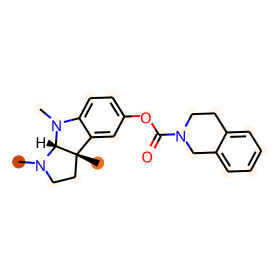

BBBP:1
prediction: [-0.41838437  0.11939379]
CCCN1CC(NS(=O)(=O)N(CC)CC)CC2Cc3c(O)cccc3CC21


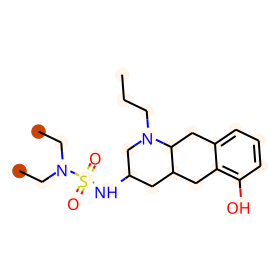

BBBP:1
prediction: [-3.441625   3.2700799]
CN(C)CCOC1(Cc2ccccc2)CC2CCC1(C)C2(C)C


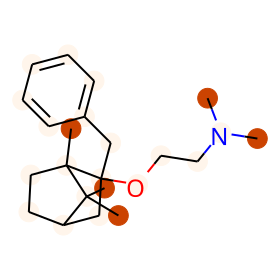

BBBP:1
prediction: [-1.6693329  1.6555991]
C#CCN[C@@H]1CCc2ccccc21


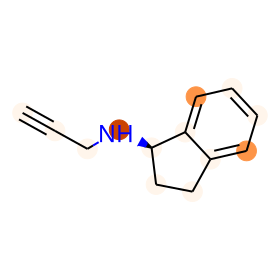

BBBP:1
prediction: [-1.7599499  1.711693 ]
CC(Cc1ccccc1)(NC(=O)CN)c1ccccc1


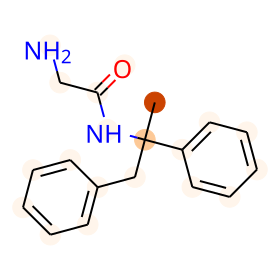

BBBP:1
prediction: [-2.5966587  2.5030487]
CCC(=O)N(c1ccccc1)C1(C(=O)OC)CCN(CCC(=O)OC)CC1


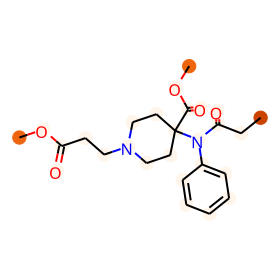

BBBP:1
prediction: [-0.8372604  0.7054422]
CCOC(=O)Nc1ccc(NCc2ccc(F)cc2)cc1N


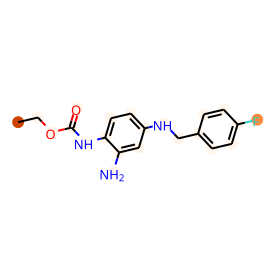

BBBP:1
prediction: [-3.0837226  2.967771 ]
CN1[C@H]2CC[C@@H]1CC(NC(=O)N1CC(C)(C)c3ccccc31)C2


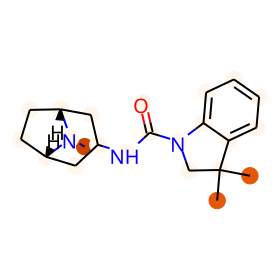

BBBP:1
prediction: [-0.73146844  0.46573815]
CN(C)C(=O)c1nc(CNC(=O)CN)n(-c2ccc(Cl)cc2C(=O)c2ccccc2Cl)n1


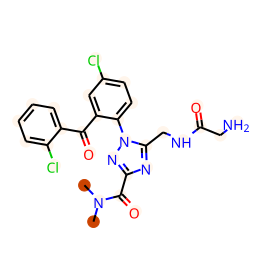

BBBP:1
prediction: [-2.820409   2.7334087]
CC1CN(CCCn2c3ccccc3c3ccccc32)CC(C)N1


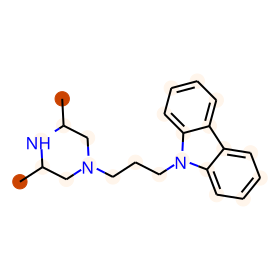

BBBP:1
prediction: [-2.9223146  2.6649752]
CCC(=O)[C@@]1(C)[C@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]21C


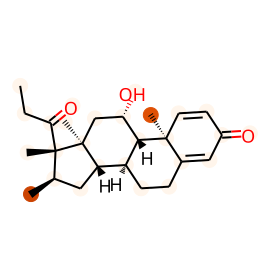

BBBP:1
prediction: [-2.2463574  2.1896613]
CCn1nc(C)c2c1C(c1ccccc1)=NCC(=O)N2


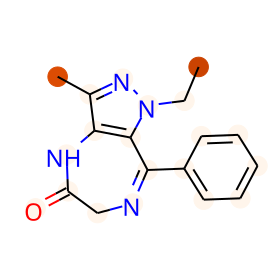

BBBP:1
prediction: [-1.9376965  1.7847452]
CCN(C)C(=O)Oc1cccc([C@H](C)N(C)C)c1


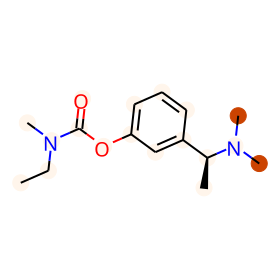

BBBP:1
prediction: [-3.089542   3.0396724]
NC(=O)c1ccc(F)c2c1C[C@@H](N(C1CCC1)C1CCC1)CO2


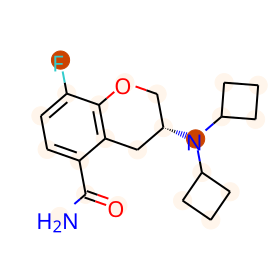

BBBP:1
prediction: [-1.1849749  0.9557323]
CC(C)OCC(COC(C)C)OCn1cnc2cnc(N)nc21


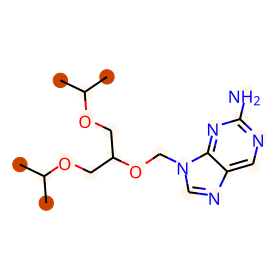

BBBP:1
prediction: [-2.136012   2.1470277]
O=C1CCN=C2CC(c3ccccc3)CN12


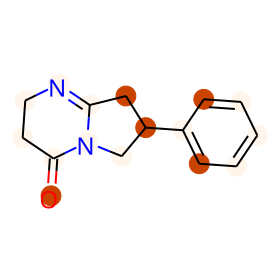

BBBP:1
prediction: [-2.574344   2.2276828]
CCC[C@@H]1O[C@@H]2C[C@H]3[C@@H]4C[C@H](F)C5=CC(=O)CC[C@]5(C)[C@@]4(F)[C@@H](O)C[C@]3(C)[C@]2(C(=O)CO)O1


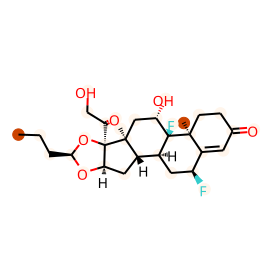

BBBP:1
prediction: [-1.4067839  1.3272088]
COc1ccc(C2CNC(=O)C2)cc1OC1CCCC1


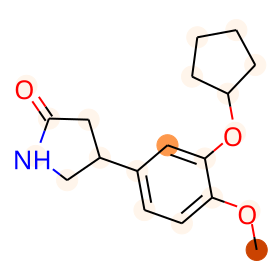

BBBP:1
prediction: [-2.2570987  2.136867 ]
CN1C[C@H](CN2CC(=O)NC(=O)C2)C=C2c3cccc4[nH]cc(c34)C[C@H]21


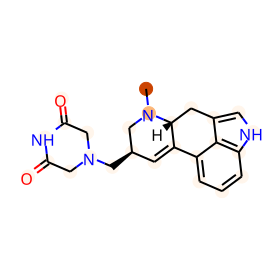

BBBP:1
prediction: [-2.049639   1.9919505]
CCCN(CCC)CCc1cccc2c1CC(=O)N2


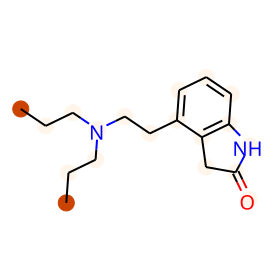

BBBP:1
prediction: [-2.7875688  2.729767 ]
CN1C(=O)CC2(CCN(CCCC(=O)c3ccc(F)cc3)CC2)C1=O


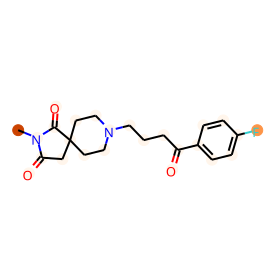

BBBP:1
prediction: [-2.2341952  2.2074401]
CON=C(C#N)C1CN2CCC1CC2


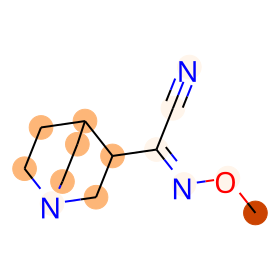

BBBP:1
prediction: [ 0.54557014 -1.18402   ]
OCc1ccccc1O[C@@H]1O[C@H](CO)[C@@H](O)[C@H](O)[C@H]1O


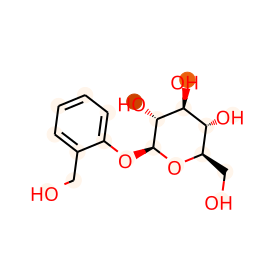

BBBP:1
prediction: [-0.6804211  0.6044776]
NC(=O)c1ccccc1O


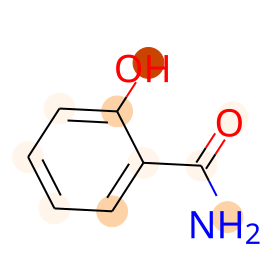

BBBP:1
prediction: [ 0.57669795 -0.84357196]
O=C(Oc1ccccc1C(=O)O)c1ccccc1O


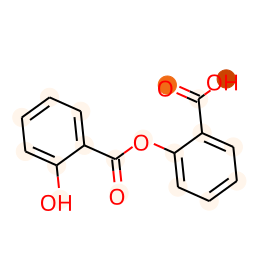

BBBP:1
prediction: [-2.7324743  2.6741023]
CCCC(=O)N(C)Cc1c(-c2ccc(Cl)cc2)nc2ccccn12


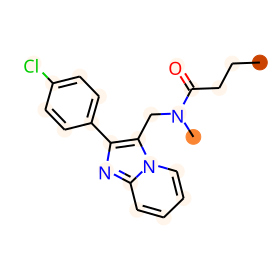

BBBP:1
prediction: [-2.6701932  2.639068 ]
N#Cc1ccc2c(c1)C1=C(CCN(CC3CCCC3)CC1)c1ccccc1O2


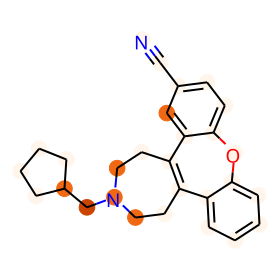

BBBP:1
prediction: [-2.1167512  2.0646422]
C#CCN(C)[C@H](C)Cc1ccccc1


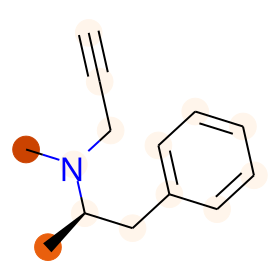

BBBP:1
prediction: [-2.2621894  2.1324341]
COCCN1CC[C@]23c4c5ccc(O)c4O[C@H]2C(=O)CC[C@@]3(O)[C@H]1C5


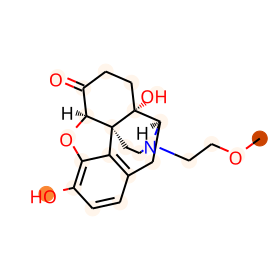

BBBP:1
prediction: [-3.1226385  3.0541523]
O=C1NCCN1CCN1CCC(c2cn(-c3ccc(F)cc3)c3ccc(Cl)cc23)CC1


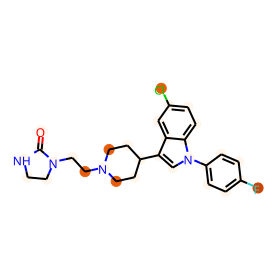

BBBP:1
prediction: [-1.7527292  1.7244058]
O.c1cncc(CC2(Cc3ccncc3)c3cccnc3-c3ncccc32)c1


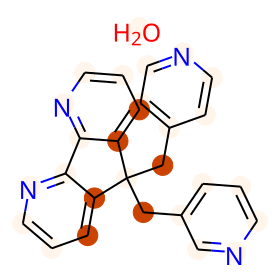

BBBP:1
prediction: [-2.2794437  2.1180823]
CC(C)CC(N(C)C)C1(c2ccc(Cl)cc2)CCC1


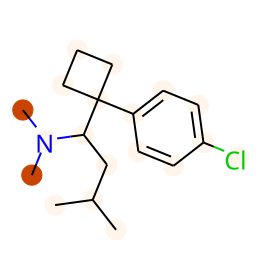

BBBP:1
prediction: [-1.3149165  1.2594372]
CN1CCN(c2ccccc2Cc2ccccc2)CC1


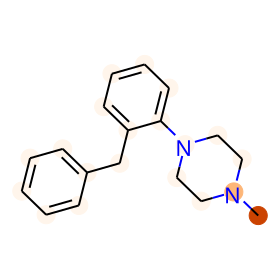

BBBP:1
prediction: [-0.1049499 -0.3091999]
CCC(C)(C)C(=O)O[C@H]1C[C@@H](C)C=C2C=C[C@H](C)[C@H](CC[C@@H]3C[C@@H](O)CC(=O)O3)[C@H]21


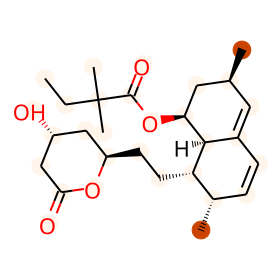

BBBP:1
prediction: [-1.961573   1.8814764]
Cc1cc(NC(=O)c2c(C)cccc2C)no1


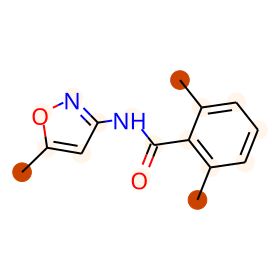

BBBP:1
prediction: [-2.4158206  2.2776525]
CN(C(=O)Cc1ccc(Cl)c(Cl)c1)[C@H]1CC[C@@]2(CCCO2)C[C@@H]1N1CCCC1


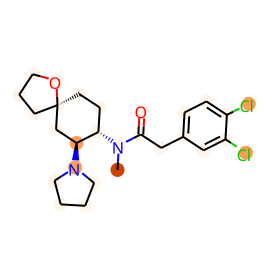

BBBP:1
prediction: [-2.697752   2.6713138]
O=C1NCN(c2ccccc2)C12CCN(CCCOc1ccc(F)cc1)CC2


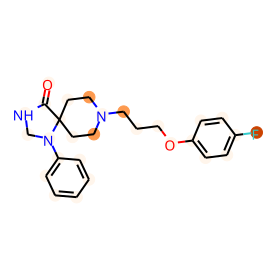

BBBP:1
prediction: [-2.9955459  2.9396389]
C/C(=C/CCN1CCC2(CC1)C(=O)NCN2c1ccccc1)c1ccc(F)cc1


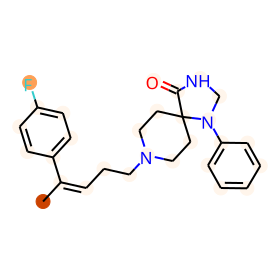

BBBP:1
prediction: [-3.3551955  3.2888641]
CN(C)CC1COC2(O1)c1ccccc1COc1ccccc12


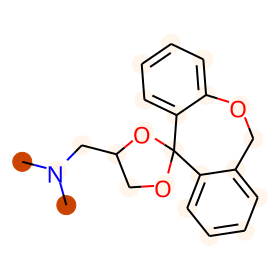

BBBP:1
prediction: [-2.7915661  2.6050332]
CCN(CC)C(=O)N1CCN(CCCc2nc3c(c(=O)n(C)c(=O)n3C)n2C)CC1


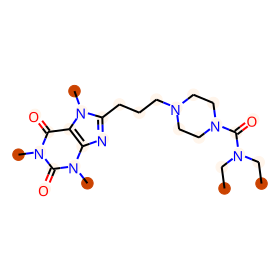

BBBP:1
prediction: [-1.6176661  1.4885079]
CC(C)(C)C(O)/C=C/c1ccc2c(c1)OCO2


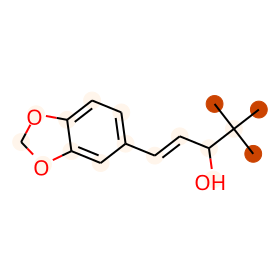

BBBP:1
prediction: [-1.1849421  1.0416763]
NS(=O)(=O)c1ccc(N2C(=O)CC(c3ccccc3)C2=O)c(Cl)c1


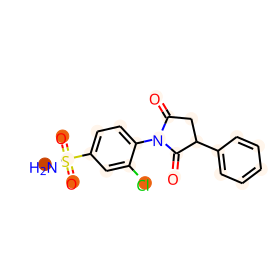

BBBP:1
prediction: [ 0.36648926 -0.58799815]
Cc1cc(NS(=O)(=O)c2ccc(N)cc2)no1


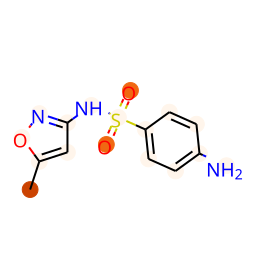

BBBP:1
prediction: [-1.1598936  1.0198644]
CCS(=O)(=O)C(C)(C)S(=O)(=O)CC


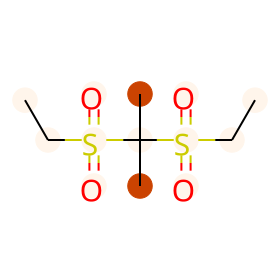

BBBP:1
prediction: [-1.0245906  0.8382251]
COc1ccc(S(N)(=O)=O)cc1C(=O)NCC1CCCN1C


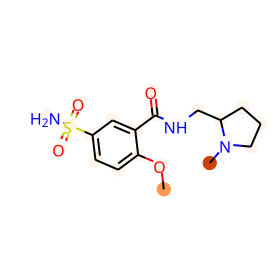

BBBP:1
prediction: [ 0.7469413 -1.0795126]
NS(=O)(=O)c1ccc(N2CCCCS2(=O)=O)cc1


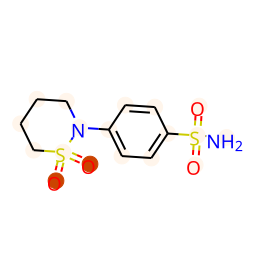

BBBP:1
prediction: [-1.8206054  1.6790711]
CCN1CCCC1CNC(=O)c1cc(S(=O)(=O)CC)ccc1OC


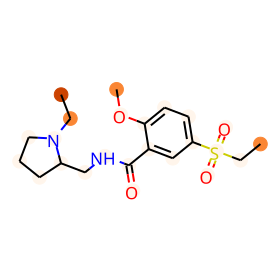

BBBP:1
prediction: [-1.0043144  0.8392938]
CSCC[C@H](NC(C)=O)C(=O)Oc1ccc(NC(C)=O)cc1


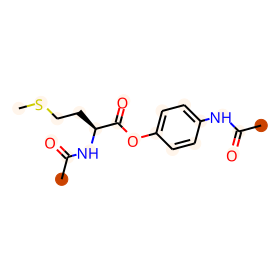

BBBP:1
prediction: [-3.3804593  3.3992927]
O=C1CCC(=O)N1CC1CCC2CN(c3ncccn3)CCN2C1


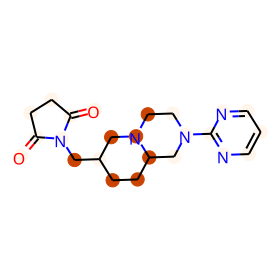

BBBP:1
prediction: [-1.8515396  1.7019043]
CCC(=O)N1CCN(C(=O)OC2C3=C(SCCS3)C(=O)N2c2ccc3ccc(Cl)nc3n2)CC1


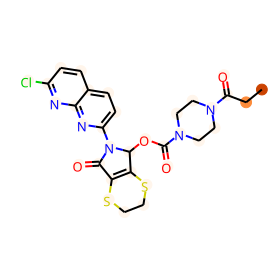

BBBP:1
prediction: [-2.7446966  2.642112 ]
CN1CCN(C(=O)OC2C3=C(SCCS3)C(=O)N2c2ccc3ccc(Cl)nc3n2)CC1


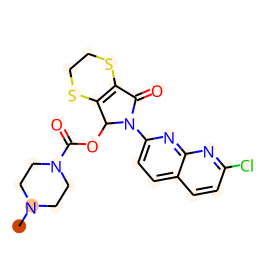

BBBP:1
prediction: [-2.4496355  2.3948164]
Cn1nc(-c2cccc(F)c2)n(C)c1=S


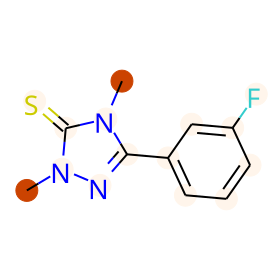

BBBP:1
prediction: [-1.8898473  1.8077471]
O=C1CCC(N2C(=O)C3C4CCC(C4)C3C2=O)C(=O)N1


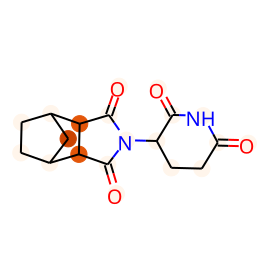

BBBP:1
prediction: [-3.0447426  2.982309 ]
CNCCCC1(c2ccccc2)OC(C)(C)c2ccccc21


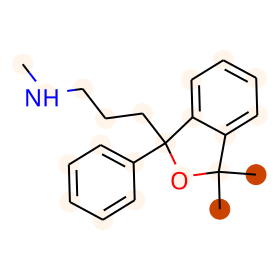

BBBP:1
prediction: [-2.3997962  2.391505 ]
CNC1CCC(c2ccccc2)c2ccccc21


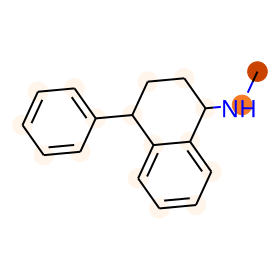

BBBP:1
prediction: [-0.95939225  0.83214366]
CCNCc1c(CSC)cnc(C)c1O


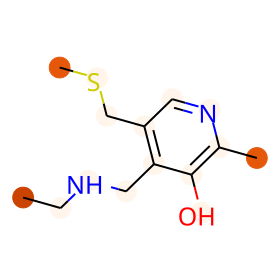

BBBP:1
prediction: [-0.27568108 -0.00333654]
COc1ccc(C(O)CN2CCN(C(c3ccccc3)c3ccccc3)CC2)cc1OC


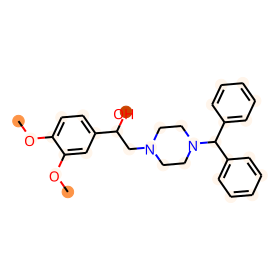

BBBP:1
prediction: [-3.090736   3.0380661]
CN(C)CCCN1c2ccccc2C(c2ccccc2)=Nc2cccnc21


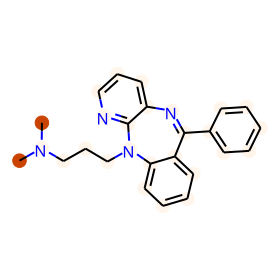

BBBP:1
prediction: [-3.1223402  3.0011547]
CCn1c2c(c3ccccc31)CCSC2(C)CCN(C)C


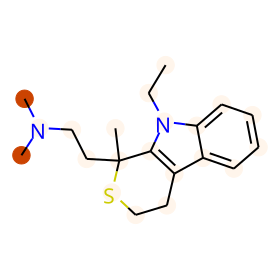

BBBP:1
prediction: [ 0.29578912 -0.9565536 ]
O=C(O)CC(O)(CC(=O)O)C(=O)O.O=C1[C@H]2[C@@H]3CC[C@@H](C3)[C@H]2C(=O)N1CCCCN1CCN(c2ncccn2)CC1


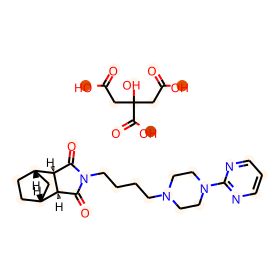

BBBP:1
prediction: [-2.4260173  2.3683476]
COc1nc2nc(-c3noc(C)n3)cn2c2c1CCCC2


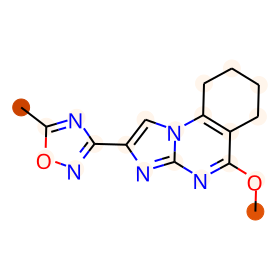

BBBP:1
prediction: [ 0.15915446 -0.4771364 ]
Cc1nc(C)c2c(n1)N(Cc1ccc(-c3ccccc3-c3nn[nH]n3)cc1)C(=O)CC2


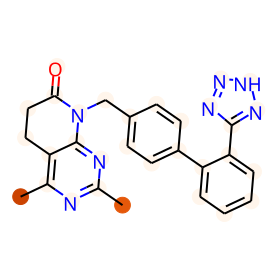

BBBP:1
prediction: [-1.4641446  1.3810353]
CCCCCCSc1nsnc1C1=CCCN(C)C1


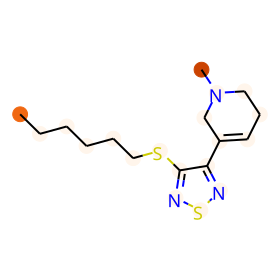

BBBP:1
prediction: [-4.2596498  4.1211457]
OCCN1CCN([C@@H]2C[C@@H](c3ccc(F)cc3)c3ccc(C(F)(F)F)cc32)CC1


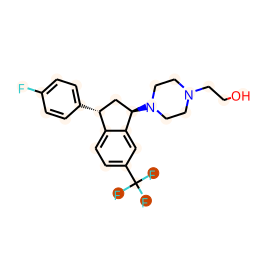

BBBP:1
prediction: [-0.6104033  0.5462086]
O=C1NCCNC1c1cccs1


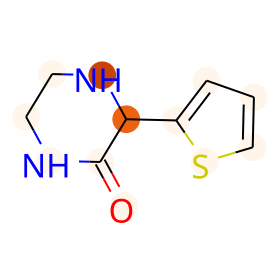

BBBP:1
prediction: [-2.4052048  2.375902 ]
CCCN1CC=C(c2c[nH]c3ccc(Cl)cc23)CC1


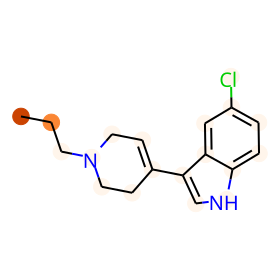

BBBP:1
prediction: [-1.4712788  1.3479232]
CCCC(CC)C1(CC)C(=O)NC(=O)NC1=O


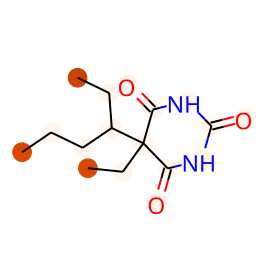

BBBP:1
prediction: [-2.7229319  2.5712156]
COc1cc2c(cc1OC)C1CC(=O)C(CC(C)C)CN1CC2


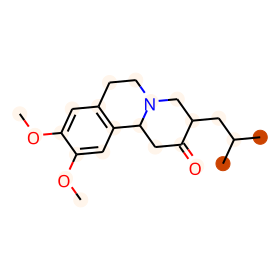

BBBP:1
prediction: [-1.4197332  1.3730954]
O=C1NC(=O)C2(CCc3ccccc3C2)N1


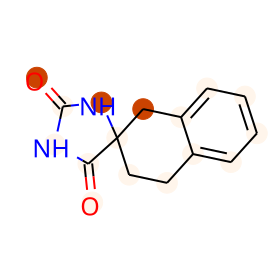

BBBP:1
prediction: [-2.2926142  2.2683814]
O=C1CCC(N2C(=O)c3ccccc3C2=O)C(=O)N1


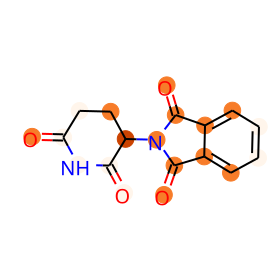

BBBP:1
prediction: [-3.6004138  3.4644706]
COc1ccc2c3c1OC1C(OC(C)=O)=CCC4C(C2)N(C)CCC314


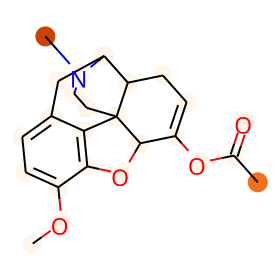

BBBP:1
prediction: [-1.6929818  1.6275969]
C=CCC1(C2C=CCCC2)C(=O)NC(=S)NC1=O


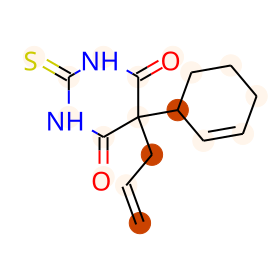

BBBP:1
prediction: [-1.6436342  1.5373366]
C=CCC1(C(C)CCC)C(=O)NC(=S)NC1=O


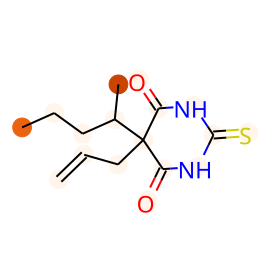

BBBP:1
prediction: [-2.270137  2.189699]
CN(C)CCN1C(=O)CC(c2ccccc2)Sc2ccccc21


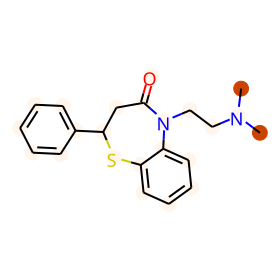

BBBP:1
prediction: [-3.4649892  3.4136431]
CC(=O)OCCN1CCN(CCCN2c3ccccc3Sc3ccc(Cl)cc32)CC1


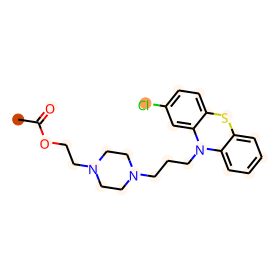

BBBP:1
prediction: [-3.0394213  2.8878977]
CN1CCN(CCCN2c3ccccc3Sc3ccc(S(=O)(=O)N(C)C)cc32)CC1


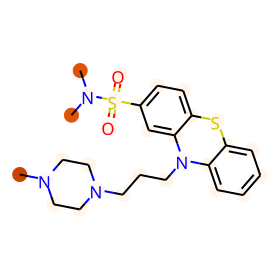

BBBP:1
prediction: [-2.3137538  2.2837303]
CN(C)C1=NC(=O)C(c2ccccc2)O1


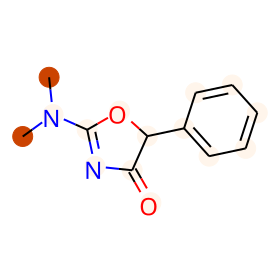

BBBP:1
prediction: [-1.3423753  1.1747948]
Cc1ccsc1C(=CCCN1CCC[C@@H](C(=O)O)C1)c1sccc1C


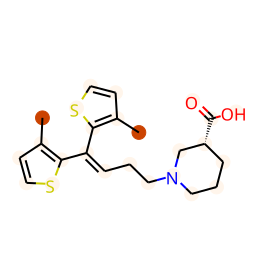

BBBP:1
prediction: [ 0.58046484 -0.96298313]
CN1c2ccccc2C(NCCCCCCC(=O)O)c2ccc(Cl)cc2S1(=O)=O


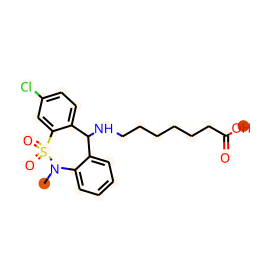

BBBP:1
prediction: [-1.3117939  1.2842016]
S=C1NCCC(COc2ccccc2)O1


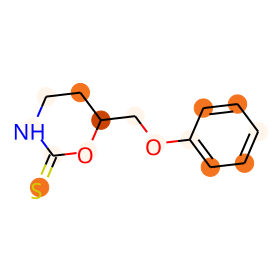

BBBP:1
prediction: [-2.6198652  2.508397 ]
CCOC(=O)C1(c2ccccc2)CCC=CC1N(C)C.[Cl-].[H+]


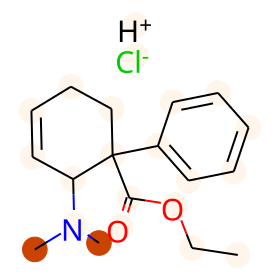

BBBP:1
prediction: [-3.1232045  3.0906627]
CN1CCN2c3cc(F)ccc3C(c3cccs3)=NCC2C1


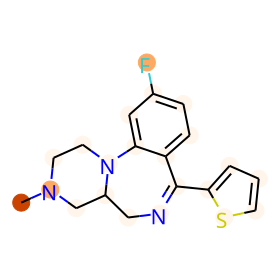

BBBP:1
prediction: [-1.5915986  1.4784365]
O=C(CCCN1CCC(n2c(=S)[nH]c3ccccc32)CC1)c1ccc(F)cc1


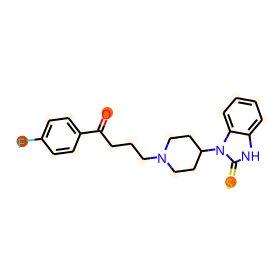

BBBP:1
prediction: [-1.6428533  1.6042652]
N=C1SCCN1c1ccc(Cl)cc1N


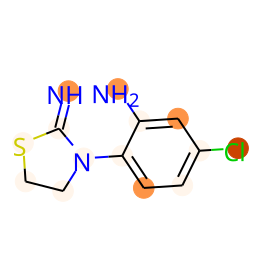

BBBP:1
prediction: [-3.0125356  2.6902637]
CSC(=O)C1(OC(C)=O)[C@@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)C3(F)[C@@H](O)C[C@@]21C


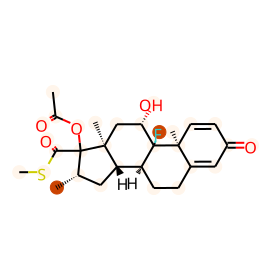

BBBP:1
prediction: [-0.95233876  0.787403  ]
CCCSc1ccccc1N1CCN(CCCCn2c(=O)[nH]c3ccccc3c2=O)CC1


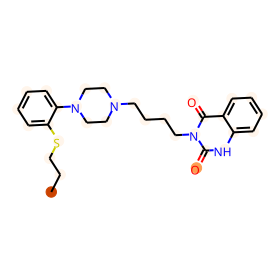

BBBP:1
prediction: [-3.434145  3.428737]
O=C1CC2(CCCC2)CC(=O)N1CCCCN1CCN(c2nsc3ccccc23)CC1


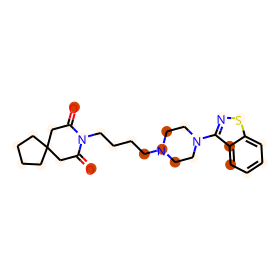

BBBP:1
prediction: [-2.387255   2.1076982]
CCS[C@]1(SC)CC[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


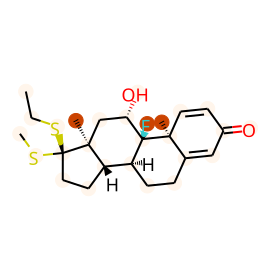

BBBP:1
prediction: [-0.7628739   0.39030445]
COc1cc2c(cc1OC)S(=O)(=O)OC(C(=O)NC(C)CC(C)(C)N(C)C)C2


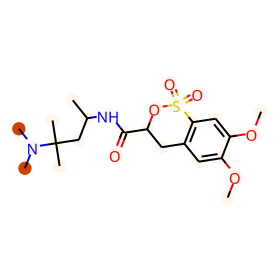

BBBP:1
prediction: [-2.3887014  2.344395 ]
CC(Cc1ccccc1)NCCC1c2ccccc2Sc2ccccc21


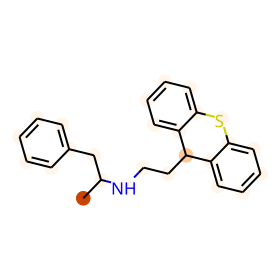

BBBP:1
prediction: [-2.669033   2.4062831]
Cc1ccccc1OCC(COC(O)C(Cl)(Cl)Cl)OC(O)C(Cl)(Cl)Cl


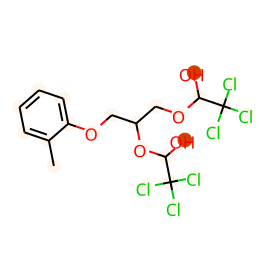

BBBP:1
prediction: [-1.3756014  1.2845714]
Cc1cccc(N2CCN(CCc3cc(C)[nH]n3)CC2)c1


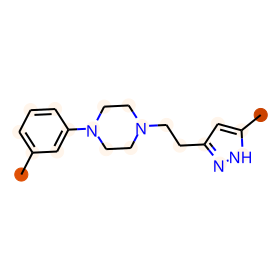

BBBP:1
prediction: [-2.704478  2.636862]
CCC1(O)CCN2CCc3ccc(C)cc3C2C1


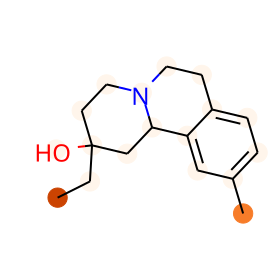

BBBP:1
prediction: [-1.9643009  1.8162334]
Cc1ccc(S(=O)(=O)CCN2C(=O)CN=C(c3ccccc3Cl)c3cc(Cl)ccc32)cc1


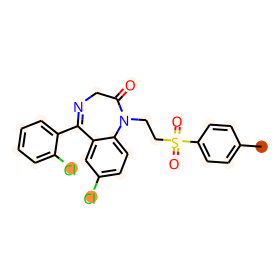

BBBP:1
prediction: [-2.4248052  2.3176427]
CCCCNc1c(C(=O)OCC)c(C)nc2c1cnn2CC


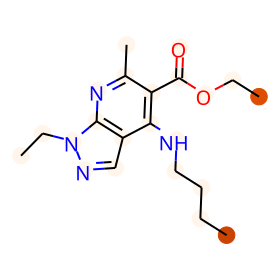

BBBP:1
prediction: [-2.2604368  2.175379 ]
CC1Oc2ccccc2CC1N(C)C


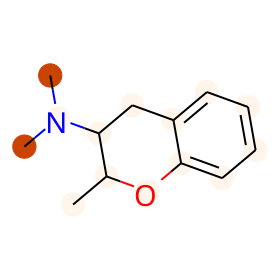

BBBP:1
prediction: [-2.782723  2.638583]
CCC(=O)N(c1ccccc1F)C1(c2ccccc2)CCN(CCn2nnn(CC)c2=O)CC1.[Cl-].[H+]


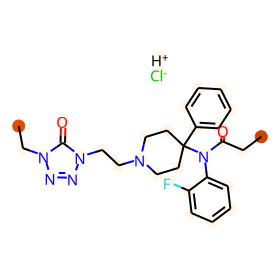

BBBP:1
prediction: [-3.7264934  3.313071 ]
CC(CNC(=O)c1ccccc1)C(=O)OCC(=O)[C@@]12OC(C)(C)O[C@@H]1C[C@H]1[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]12C


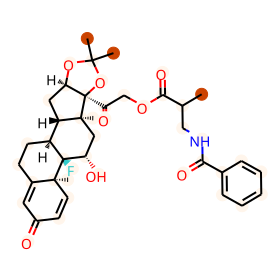

BBBP:1
prediction: [-3.928782   3.5878966]
CC1(C)O[C@@H]2C[C@H]3[C@@H]4CCC5=CC(=O)C=C[C@]5(C)[C@@]4(F)[C@@H](O)C[C@]3(C)[C@]2(C(=O)COC(=O)c2cc3ccccc3o2)O1


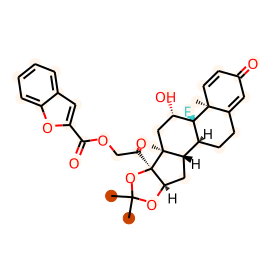

BBBP:1
prediction: [-1.9129037  1.8585837]
OC(Br)(Br)CBr


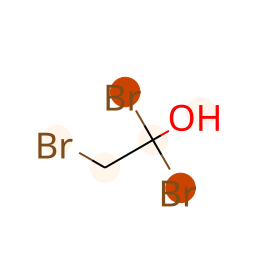

BBBP:1
prediction: [-2.2038152  2.0694356]
CCN(CC)C(=O)CNC(=O)c1cc(OC)c(OC)c(OC)c1


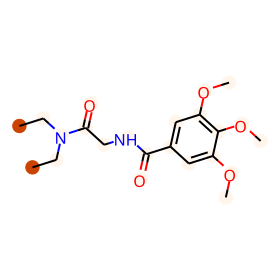

BBBP:1
prediction: [-1.9386523  1.8066264]
O=C1N(C(O)C(Cl)(Cl)Cl)CNC1(c1ccccc1)c1ccccc1


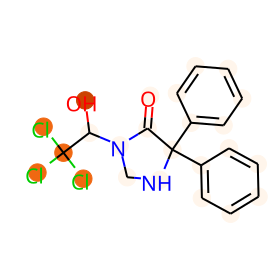

BBBP:1
prediction: [-2.295068  2.232245]
O=P(O)(O)OCC(Cl)(Cl)Cl


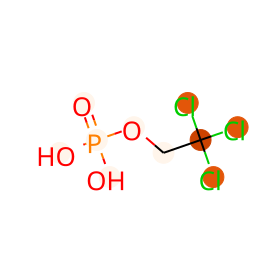

BBBP:1
prediction: [-0.02087537 -0.26402274]
COc1cc(NCc2ccc3nc(N)nc(N)c3c2C)cc(OC)c1OC


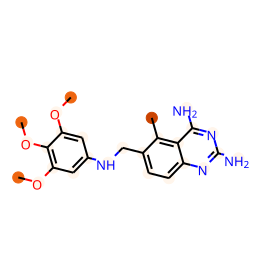

BBBP:1
prediction: [-1.4680265  1.3423767]
COc1cc(C(=O)N2CCCCCCC2)cc(OC)c1OC


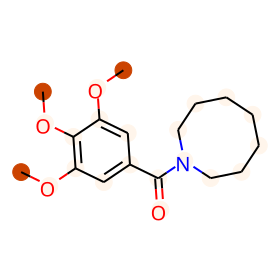

BBBP:1
prediction: [ 0.32402855 -0.614611  ]
N[C@@H](Cc1c[nH]c2ccccc12)C(=O)O


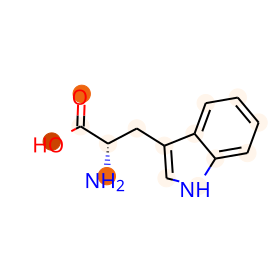

BBBP:1
prediction: [-3.5327184  3.348551 ]
CCCCN1C(=O)C2C(=O)N(CCCCN3CCN(c4ccccc4OC)CC3)C(=O)C(C1=O)C2(C)C


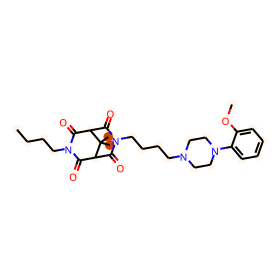

BBBP:1
prediction: [-1.2797517  1.2307035]
CCOC(N)=O


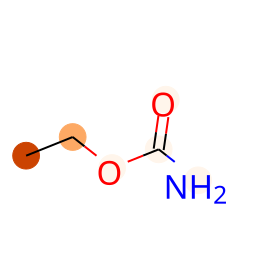

BBBP:1
prediction: [ 0.00784591 -0.2676185 ]
CC(C)[C@H](N)C(=O)OCCOCn1cnc2c(=O)nc(N)[nH]c21


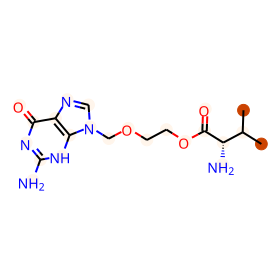

BBBP:1
prediction: [-2.0215707  1.9683468]
CCCC(CCC)(CCC)C(N)=O


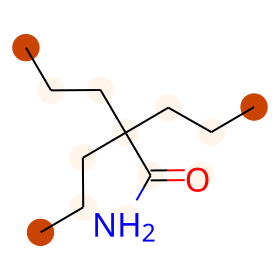

BBBP:1
prediction: [ 0.5189188  -0.85803264]
CC(C)[C@H](N)C(=O)OCC(CO)OCn1cnc2c(=O)nc(N)[nH]c21


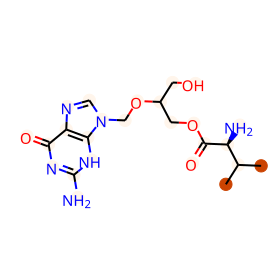

BBBP:1
prediction: [-2.1407695  2.0162842]
CCCC(CCC)C(=O)OCOC(=O)C(C)(C)C


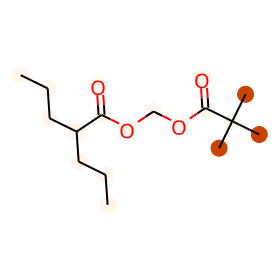

BBBP:1
prediction: [-1.932069   1.6379216]
CC(=O)OCC1=CO[C@@H](OC(=O)CC(C)C)[C@H]2C1=C[C@H](OC(=O)CC(C)C)[C@]21CO1


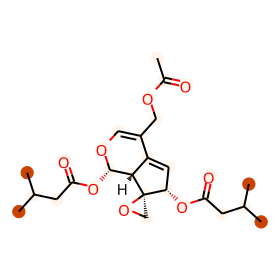

BBBP:1
prediction: [-1.9286155  1.8935304]
Nc1c2c(nc3ccccc13)CCCC2O


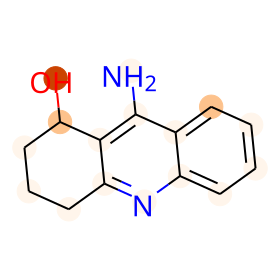

BBBP:1
prediction: [-1.5049232  1.3589767]
COc1ccc(C(CN(C)C)C2(O)CCCCC2)cc1


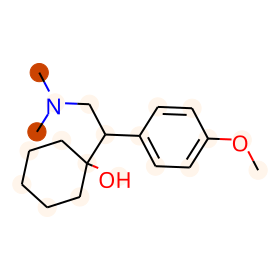

BBBP:1
prediction: [-1.1506282   0.94704384]
C=CCN1CCCC1CNC(=O)c1cc(S(N)(=O)=O)cc(OC)c1OC


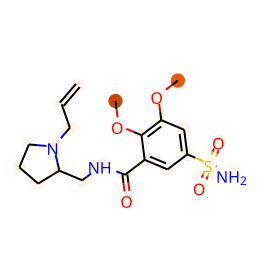

BBBP:1
prediction: [ 0.02235021 -0.1796008 ]
C=CC(N)CCC(=O)O


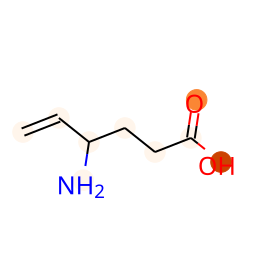

BBBP:1
prediction: [-1.3911135  1.3628118]
C=COC=C


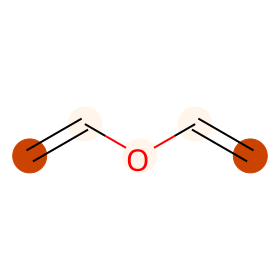

BBBP:1
prediction: [-2.1016254  1.728329 ]
Cc1c(C)c2c(c(C)c1O)CC[C@@](C)(CCC[C@H](C)CCC[C@H](C)CCCC(C)C)O2


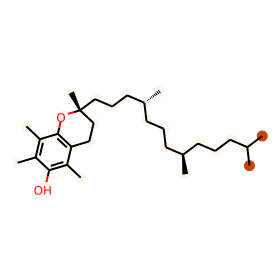

BBBP:1
prediction: [-1.3288463  1.249763 ]
Cc1cccc(C)c1NC1=NCCCS1


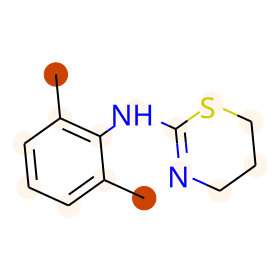

BBBP:1
prediction: [ 0.1759202  -0.44456026]
CC(C)C(CCCCCC(=O)O)NCc1ccc(F)cc1


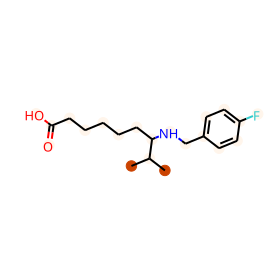

BBBP:1
prediction: [-1.8176719  1.672817 ]
O=C1[C@H]2[C@H]3C=C[C@H]([C@@H]4C=C[C@@H]43)[C@H]2C(=O)N1CCCCN1CCN(c2ncccn2)CC1


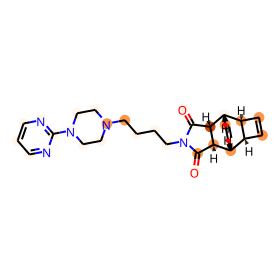

BBBP:1
prediction: [-2.7561216  2.6956112]
CC1(C)CN(CCN2CCN(c3cccc(Cl)c3)C2=O)C1


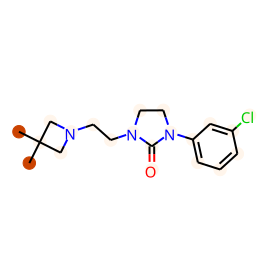

BBBP:1
prediction: [-2.835226   2.8101008]
O=C1Cc2cc(CCN3CCN(c4nsc5ccccc45)CC3)c(Cl)cc2N1


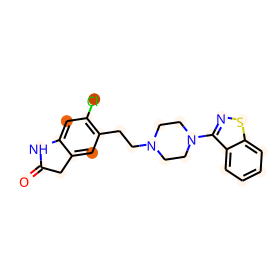

BBBP:1
prediction: [-3.283829   3.2093787]
Cc1nn(C)c2c1C(c1ccccc1F)=NCC(=O)N2C


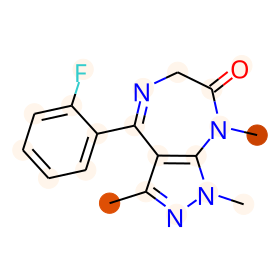

BBBP:1
prediction: [-0.82635343  0.64699304]
COc1ccccc1N1CCN(CCc2oc(=O)[nH]c2-c2ccc(F)cc2)CC1


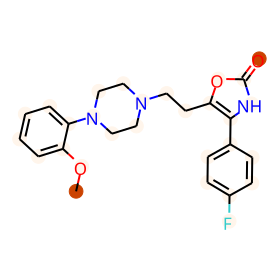

BBBP:1
prediction: [-1.153402   1.0552297]
CC(c1noc2ccc(Cl)cc12)n1ccnc1


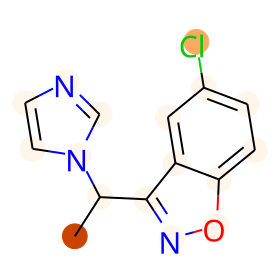

BBBP:1
prediction: [-3.0650516  3.0078902]
CN1CCN(C(=O)OC2c3nccnc3C(=O)N2c2ccc(Cl)cn2)CC1


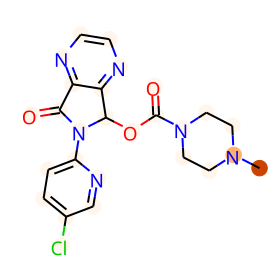

BBBP:1
prediction: [-2.505692  2.425823]
CN(C)CCOC1=Cc2ccccc2Sc2ccc(Cl)cc21


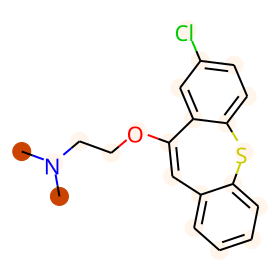

BBBP:1
prediction: [-1.8029114  1.7628795]
CCN[C@H](Cc1ccccc1)[C@H]1CCCO1


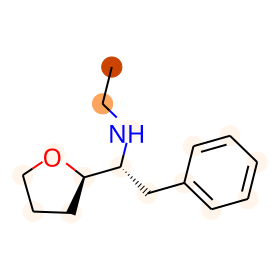

BBBP:1
prediction: [-3.0016024  2.9200017]
CN(C)Cc1nnc2n1-c1ccc(Cl)cc1C(c1ccccc1)=NC2


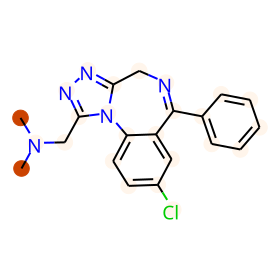

BBBP:1
prediction: [-1.9918076  1.9106798]
C=CCN1C(=O)C(CC(C)C)NC1=S


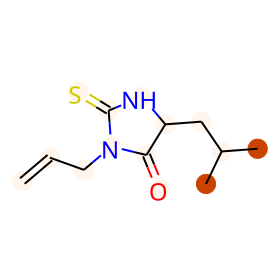

BBBP:1
prediction: [-1.9854548  1.6383326]
C[C@@H]1C[C@H]2[C@H]3[C@H]([C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)CO)[C@@]1(C)C=CC(=O)C=C1C[C@H]3Cl


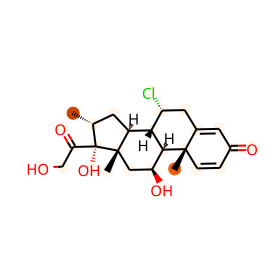

BBBP:1
prediction: [-1.2120167  1.1746452]
C=CCC(N)Cc1ccccc1


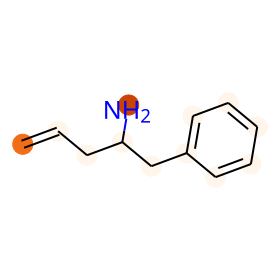

BBBP:1
prediction: [-2.3971958  2.2794445]
CCOC(=O)c1[nH]c2cc(OC)c(OC)cc2c1CCN1CCN(c2ccccc2)CC1


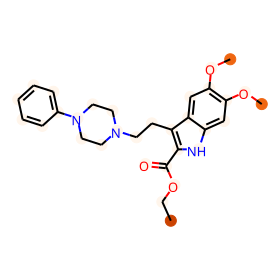

BBBP:1
prediction: [-2.038755   1.9170939]
CCCN(CCC)C(=O)Cc1c(-c2ccc(Cl)cc2)nc2ccc(Cl)cn12


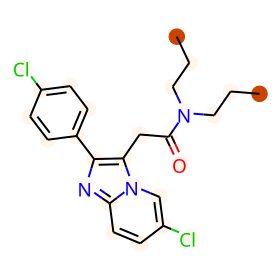

BBBP:1
prediction: [-3.0052302  2.9688098]
CNCCCC1(C)C(=O)N(c2ccccc2)c2ccccc21


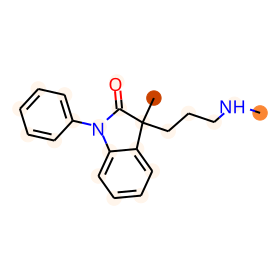

BBBP:1
prediction: [ 0.8926079 -1.2300397]
CCn1cc(C(=O)O)c(=O)c2ccc(Cc3ccccc3)nc21


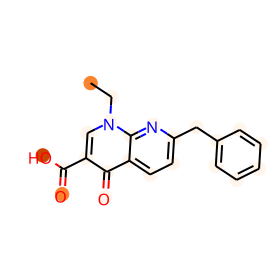

BBBP:1
prediction: [ 0.59028256 -1.4251678 ]
Cc1cc(N(C)C)ccc1C[C@H](C)N.O=C(O)[C@H](O)[C@@H](O)C(=O)O


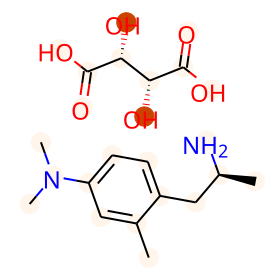

BBBP:1
prediction: [-1.2455508  1.1621913]
CCC1(c2ccc(N)cc2)CCC(=O)NC1=O


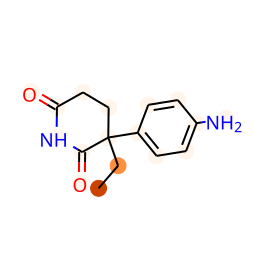

BBBP:1
prediction: [-1.818011   1.7917585]
Clc1ccc2c(c1)C(N1CCNCC1)=Nc1ccccc1O2


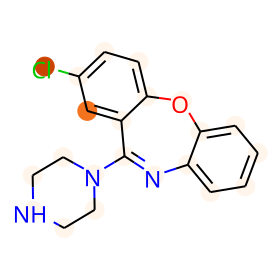

BBBP:1
prediction: [-0.87224007  0.68109304]
COc1ccccc1N1CCN(CCCC(O)c2ccc(F)cc2)CC1


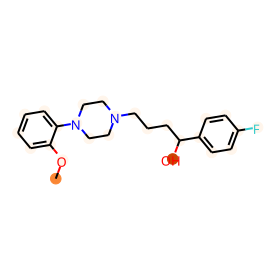

BBBP:1
prediction: [-2.9956164  2.9409025]
CN1CCN2c3ccccc3Cn3cccc3C2C1.O=C(O)/C=C\C(=O)O


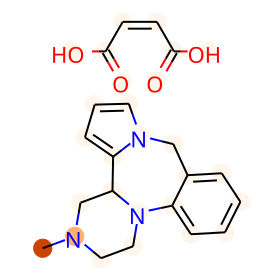

BBBP:1
prediction: [-2.866965  2.841972]
CCOC(=O)N1CCC(=O)N(c2ccccc2)c2cc(Cl)ccc21


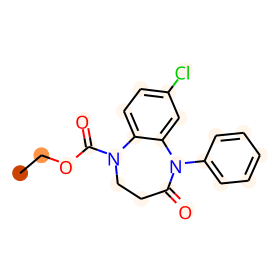

BBBP:1
prediction: [-0.14381127 -0.08900215]
CN(C(=O)C(c1ccccc1)c1ccccc1)[C@H](CN1CC[C@H](O)C1)c1ccccc1


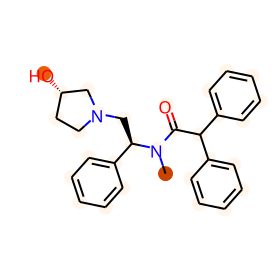

BBBP:1
prediction: [-1.4910437  1.3113531]
Cc1c(C)c2ccc(OCc3nnc(C(C)C)s3)cc2oc1=O


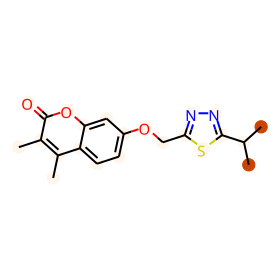

BBBP:1
prediction: [-0.37882635  0.152713  ]
CN1C2CCC1CC(OC(=O)C(CO)c1ccccc1)C2


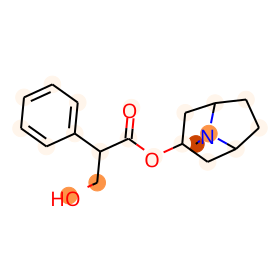

BBBP:1
prediction: [-2.0932603  2.0767486]
N#Cc1cc(-c2ccccc2)nnc1NCCN1CCOCC1


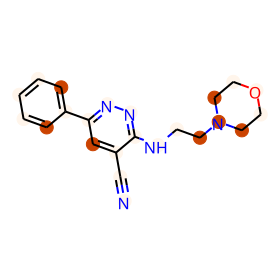

BBBP:1
prediction: [-3.5102031  3.1896155]
CCC(=O)OCC(=O)[C@@]1(OC(=O)CC)[C@@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(Cl)[C@@H](O)C[C@@]21C


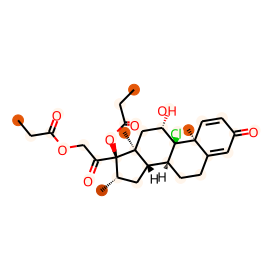

BBBP:1
prediction: [-1.9145659  1.8868102]
CC(NNC(=O)c1ccccc1)c1ccccc1


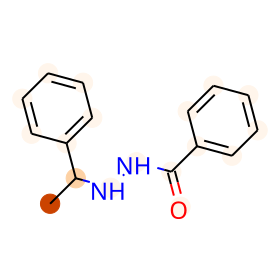

BBBP:1
prediction: [-2.686642   2.6443357]
CCC1(c2ccccc2)C(=O)NC(=O)N(C(=O)c2ccccc2)C1=O


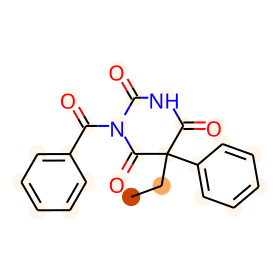

BBBP:1
prediction: [-2.598357   2.6100895]
O=C(OC1CN2CCC1CC2)c1ccccc1


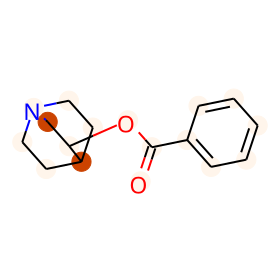

BBBP:1
prediction: [-2.7618418  2.7626479]
CNCC12CCC(c3ccccc31)c1ccccc12


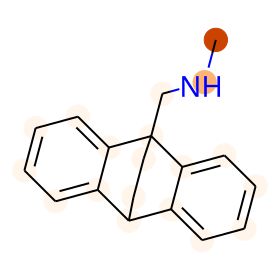

BBBP:1
prediction: [-2.1414967  2.0947297]
CC(Cc1ccccc1)N(C)Cc1ccccc1


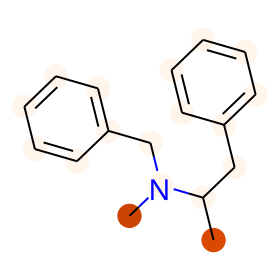

BBBP:1
prediction: [-1.3583773  1.3035384]
CCCN(c1ccncc1)n1ccc2ccccc21.[Cl-].[H+]


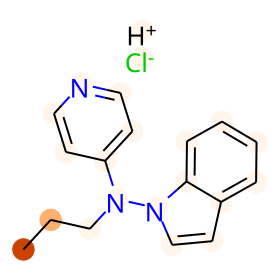

BBBP:1
prediction: [-3.4198575  3.0254915]
CC(=O)OCC(=O)[C@@]1(OC(=O)C(C)C)[C@@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


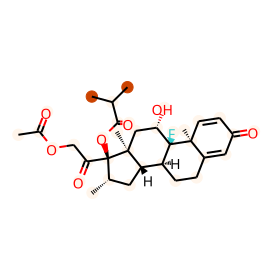

BBBP:1
prediction: [-2.0964131  1.7552762]
CC(=O)OCC(=O)[C@@]1(O)[C@@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


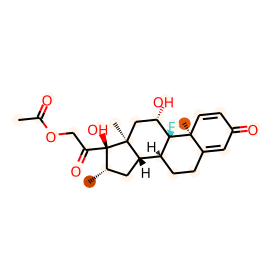

BBBP:1
prediction: [-3.5725636  3.246041 ]
CCC(=O)OCC(=O)[C@@]1(OC(=O)CC)[C@@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


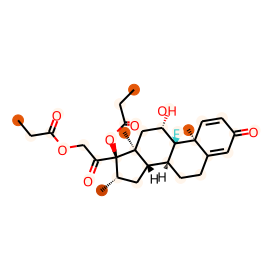

BBBP:1
prediction: [-2.7217283  2.6434262]
CN(C)CCN(C)n1cc(-c2ccccc2)c2ccccc21


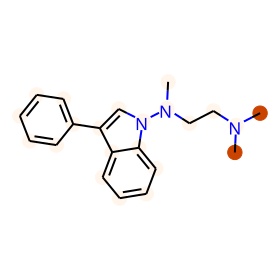

BBBP:1
prediction: [-1.8199251  1.7652113]
C=CCC1(CC(=C)Br)C(=O)NC(=O)NC1=O


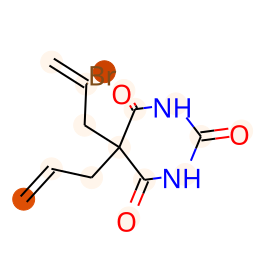

BBBP:1
prediction: [-2.048195   1.8459139]
CCn1nnn(CCN2CC[C@H](N(C(=O)COC)c3ccccc3F)[C@H](C)C2)c1=O


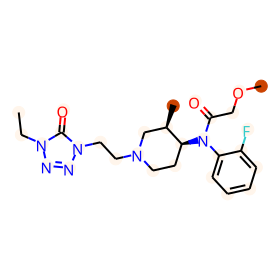

BBBP:1
prediction: [-2.0639663  2.0222507]
COc1cc(Br)c2oc(C3CCNCC3)cc2c1


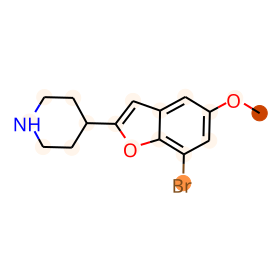

BBBP:1
prediction: [-1.5426726  1.4721997]
CN(C)C(=O)CCNc1ccc(Br)cc1


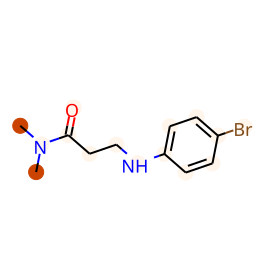

BBBP:1
prediction: [-2.060668   1.9460444]
CCN(CC)CCNC(=O)c1cc(Br)c(N)cc1OC


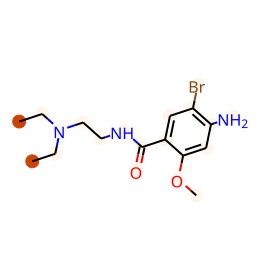

BBBP:1
prediction: [-2.809684   2.7450147]
CC(C)(C)N1CCC(c2ccccc2)(c2ccccc2)CC1


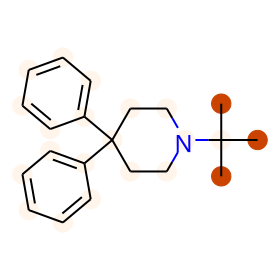

BBBP:1
prediction: [-3.2472906  3.2571177]
O=C1CC2(CCCC2)CC(=O)N1CCCCN1CCN(c2ncccn2)CC1


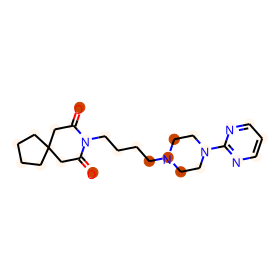

BBBP:1
prediction: [-1.3937095  1.2776697]
C=CCC1(CC(C)C)C(=O)NC(=O)NC1=O


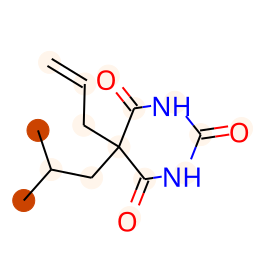

BBBP:1
prediction: [-2.1053853  2.102289 ]
CCCCNCC1COc2ccccc2O1


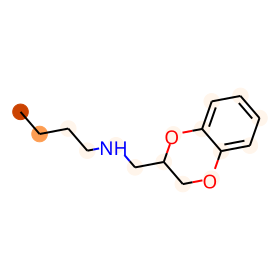

BBBP:1
prediction: [-2.429605   2.3219154]
CC(CC1c2ccccc2CCc2ccccc21)CN(C)C


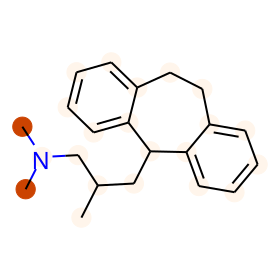

BBBP:1
prediction: [-1.5809158  1.5178668]
CCOC(=O)NNC(C)c1ccccc1


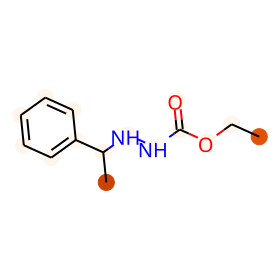

BBBP:1
prediction: [-2.4246304  2.3431578]
CCOC(=O)NC(O)C(Cl)(Cl)Cl


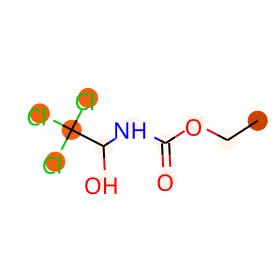

BBBP:1
prediction: [-1.9569145  1.8857415]
CCC(Br)(CC)C(=O)NC(N)=O


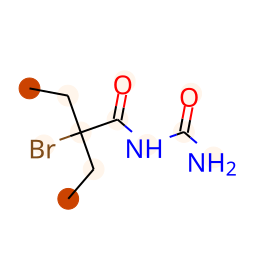

BBBP:1
prediction: [-2.4185853  2.3492117]
CCC(=O)N(c1ccccc1)C1(C(=O)OC)CCN(CCc2ccccc2)CC1


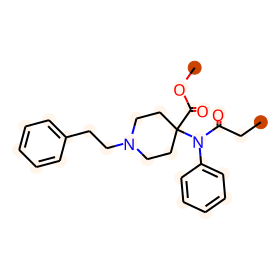

BBBP:1
prediction: [-3.5090957  3.484881 ]
NC(=O)C1(N2CCCCC2)CCN(CCCN2c3ccccc3CCc3ccccc32)CC1


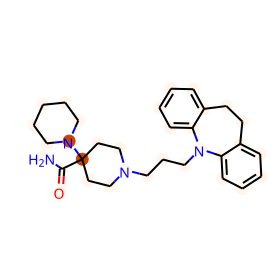

BBBP:1
prediction: [-2.5809207  2.5785093]
Fc1ccc2[nH]c3c(c2c1)CN(CCc1ccncc1)CC3


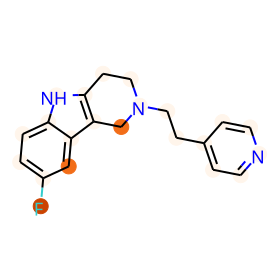

BBBP:1
prediction: [-2.6619475  2.5479672]
CN(C)C(C)(CO)Cc1ccc(Cl)c(Cl)c1.[Cl-].[H+]


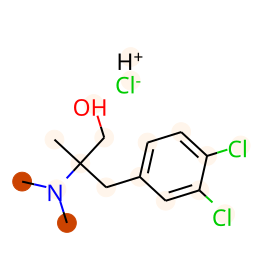

BBBP:1
prediction: [-2.3301497  2.2799342]
CN1CCN(C(c2ccccc2)c2ccc(Cl)cc2)CC1


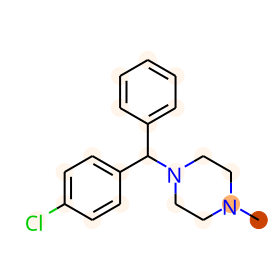

BBBP:1
prediction: [-1.5236461  1.4596245]
CCCC(O)Cl


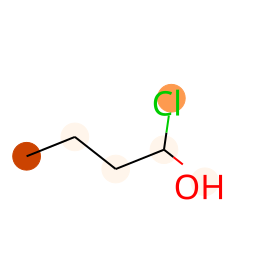

BBBP:1
prediction: [-2.170742   1.8003744]
COC(=O)[C@H]1[C@H]2C[C@@H]3c4[nH]c5ccc(Cl)cc5c4CCN3C[C@H]2C[C@@H](OC(=O)c2cc(OC)c(OC)c(OC)c2)[C@@H]1OC


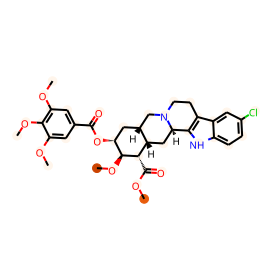

BBBP:1
prediction: [-0.6929824  0.5795592]
NC(=O)OCC(O)COc1ccc(Cl)cc1


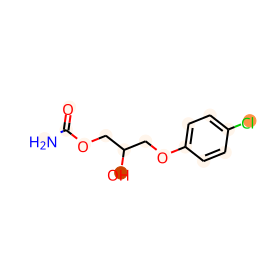

BBBP:1
prediction: [-1.8894145  1.8678887]
O=C1NC(CCCl)Oc2ccccc21


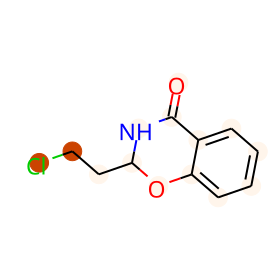

BBBP:1
prediction: [-2.5961576  2.5299613]
CN(C)CCCN1c2ccccc2CCc2ccc(C#N)cc21


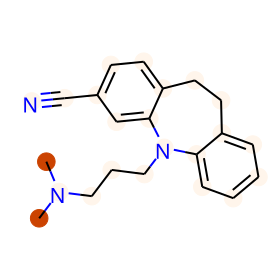

BBBP:1
prediction: [-2.0455537  1.992276 ]
OC1(c2cccc(Cl)c2)C2=NCCCN2c2ccccc21


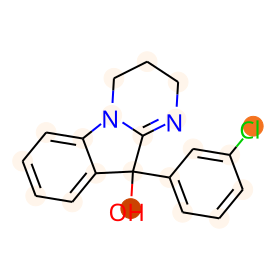

BBBP:1
prediction: [-2.7884874  2.7868214]
CNC1CCN2c3ccccc3CCc3cccc1c32


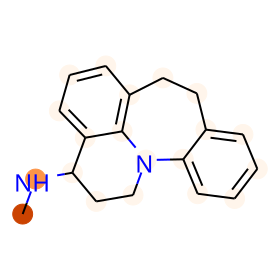

BBBP:1
prediction: [-2.593217   2.5475779]
CN(C)CCC=C1c2ccccc2COc2ccccc21


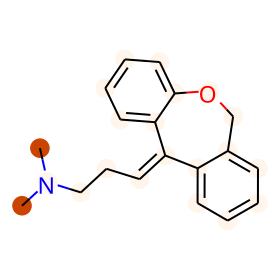

BBBP:1
prediction: [-0.80361295  0.60805726]
COc1ccc([C@H](O)CN2CCN(c3cccccc3=O)CC2)cc1OC


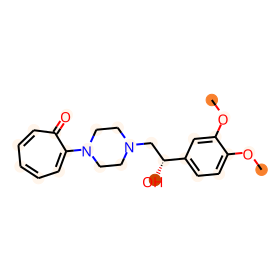

BBBP:1
prediction: [-1.546292   1.3987651]
CCOc1cc(N)c([N+](=O)[O-])cc1C(=O)NC1CCN(CC2CC=CCC2)CC1


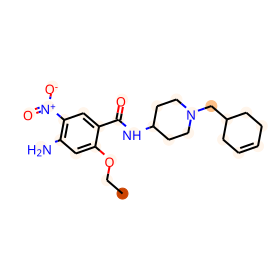

BBBP:1
prediction: [-2.3704422  2.3224263]
O=C1CCC(c2ccccc2)(C2CCN(C/C=C/c3ccccc3)CC2)C(=O)N1


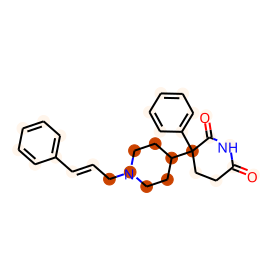

BBBP:1
prediction: [-1.7172052  1.6783049]
CCNC(=O)/C=C/c1cccc(Br)c1


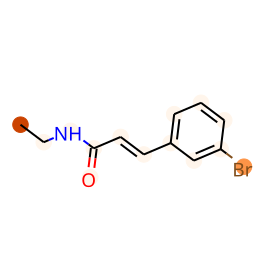

BBBP:1
prediction: [-1.6159443  1.5172633]
COc1cc(/C=C/C(N)=O)cc(OC)c1OC


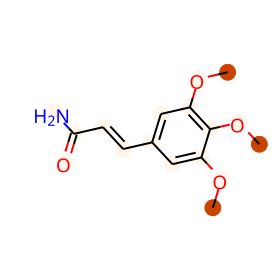

BBBP:1
prediction: [-2.5696    2.542431]
O=C(CCCN1CCN(c2cc3ccccc3cn2)CC1)c1ccc(F)cc1


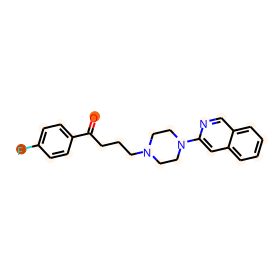

BBBP:1
prediction: [-3.2124567  3.1208818]
CN(C)CCCC1(c2ccc(F)cc2)OCc2cc(C#N)ccc21


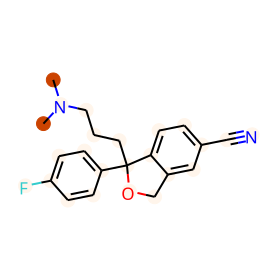

BBBP:1
prediction: [-2.3502512  2.3575232]
NC(=O)C1c2ccccc2C=Cc2ccccc21


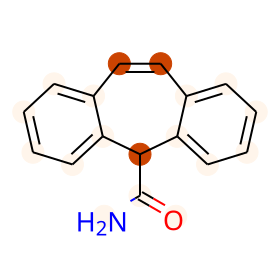

BBBP:1
prediction: [-2.97197    2.9289896]
Cc1ncc2n1-c1ccc(Cl)cc1C(c1ccccc1Cl)=NC2


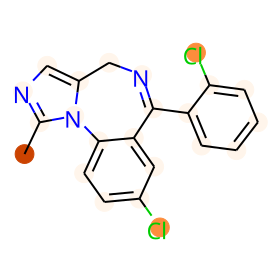

BBBP:1
prediction: [-4.7220325  4.445065 ]
CC1CC2C3CCC4=CC(=O)C=CC4(C)[C@@]3(F)C(O)CC2(C)[C@@]1(O)C(=O)CCl


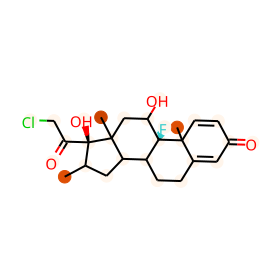

BBBP:1
prediction: [-3.728462  3.441353]
CCC(=O)O[C@]1(C(=O)CCl)[C@@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


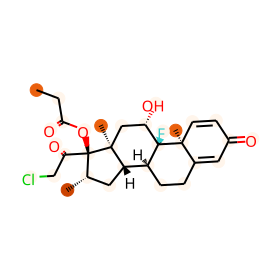

BBBP:1
prediction: [-1.84943    1.7746731]
CCN(CC)CCNC(=O)COc1ccc(Cl)cc1


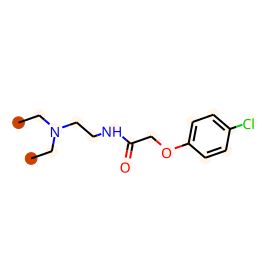

BBBP:1
prediction: [-2.2920272  2.198806 ]
CN(C)CCCC1c2ccccc2Nc2ccc(Cl)cc21


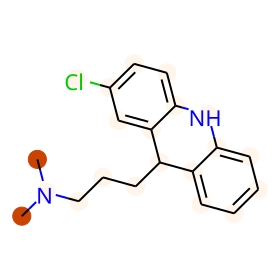

BBBP:1
prediction: [-3.0337224  3.0135562]
CN1CCN(C2=Nc3ccccc3Sc3ccc(Cl)cc32)CC1


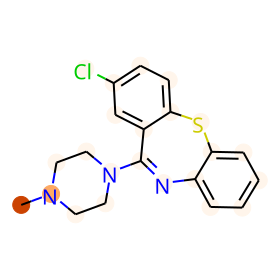

BBBP:1
prediction: [-1.1284456  1.0560076]
COCCCC/C(=N\OCCN)c1ccc(Cl)cc1


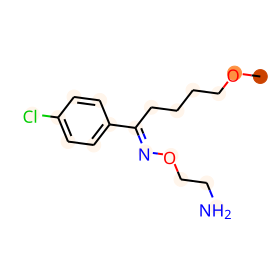

BBBP:1
prediction: [-2.980411   2.9298403]
O=C1CN2CCOC2(c2ccccc2Cl)c2cc(Cl)ccc2N1


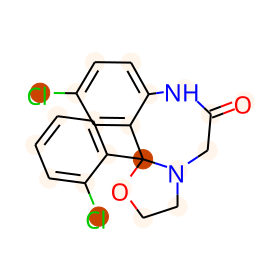

BBBP:1
prediction: [-3.0421252  3.0137327]
OCCN1CCN(CCCN2c3ccccc3Sc3cc(Cl)cnc32)CC1


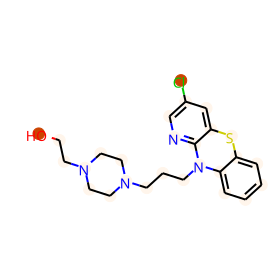

BBBP:1
prediction: [-5.457061   5.0668178]
CC(=O)OCC(=O)C1(O)C(C)CC2C3CC(F)(F)C4=CC(=O)C=CC4(C)C3(F)C(O)CC21C


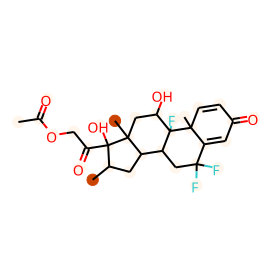

BBBP:1
prediction: [-1.6908668  1.5536176]
C/C=C/C(=O)N(CCC)C(CC)C(=O)N(C)C


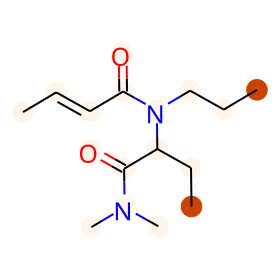

BBBP:1
prediction: [-2.0232015  2.0144975]
O=C1N=C(NC2CC2)OC1c1ccccc1


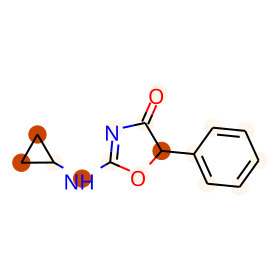

BBBP:1
prediction: [-1.7413133  1.7278783]
NC1CCCC1c1ccccc1


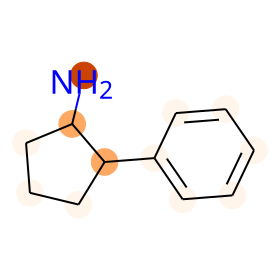

BBBP:1
prediction: [-1.1993433  1.1140242]
ON1CC(=NCC2CC2)N=c2ccc(Cl)cc2=C1c1ccccc1


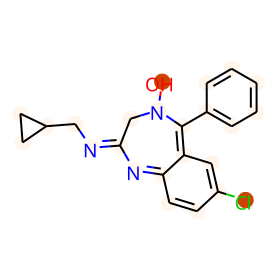

BBBP:1
prediction: [-2.3268795  2.315107 ]
CN1CCCc2cccc(OCC3CNCCO3)c21


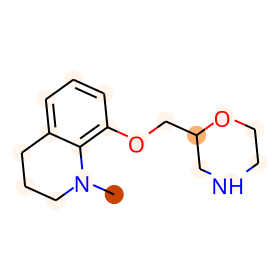

BBBP:1
prediction: [-2.8796163  2.8579547]
CNCCCC1(C)CN(c2ccccc2)c2ccccc21


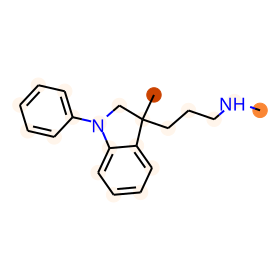

BBBP:1
prediction: [-2.5831485  2.5379348]
CN(C)CC1=Cc2ccccc2Sc2ccccc21


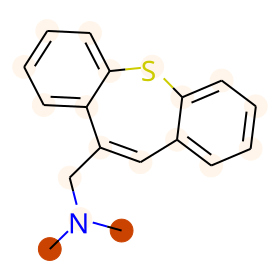

BBBP:1
prediction: [-2.5825438  2.53808  ]
CN1CCC(=C2c3ccccc3C(O)c3ccccc32)CC1


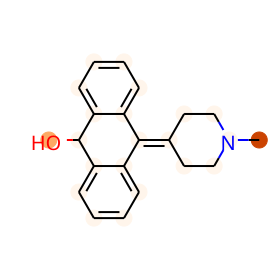

BBBP:1
prediction: [-2.1562698  2.092294 ]
CN(C)[C@@H](CCOc1cccc2ccccc12)c1ccccc1


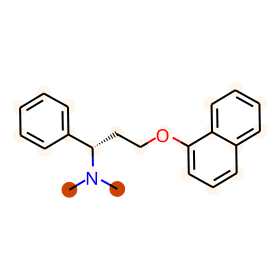

BBBP:1
prediction: [-1.3206472  1.116896 ]
CCC(=O)O[C@](Cc1ccccc1)(c1ccccc1)[C@H](C)CN(C)C.[Cl-].[H+]


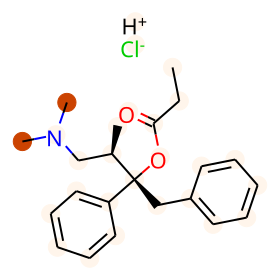

BBBP:1
prediction: [-1.8824574  1.8325775]
CC1=Nc2ccccc2CC(c2ccccc2)N1C


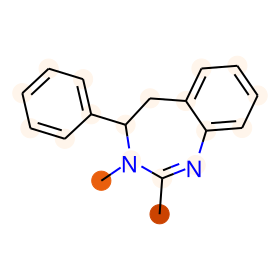

BBBP:1
prediction: [-1.4296867  1.3022535]
O=C(c1ccc(F)cc1)C1CCN(CCCn2c(=O)[nH]c3ccccc32)CC1


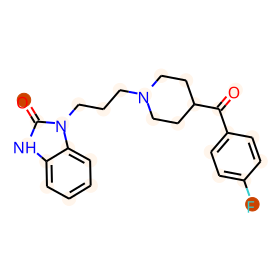

BBBP:1
prediction: [-2.6917667  2.4146144]
CC(=O)OCC(=O)[C@@]12N=C(C)O[C@@H]1C[C@H]1[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]12C


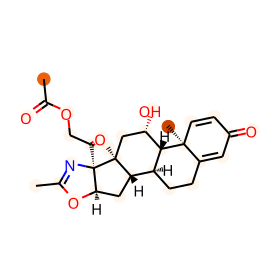

BBBP:1
prediction: [-1.915299   1.8693507]
O=C1CN=C(c2ccccc2Cl)c2cc(Cl)ccc2N1


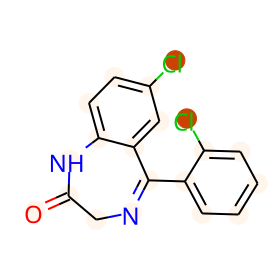

BBBP:1
prediction: [-2.355302   2.3578305]
CNCCON=c1c2ccccc2ccc2ccccc12


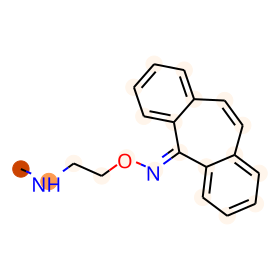

BBBP:1
prediction: [ 0.6963039  -0.95966595]
OC(Cn1ccnc1)c1ccc(CCc2ccccc2)cc1


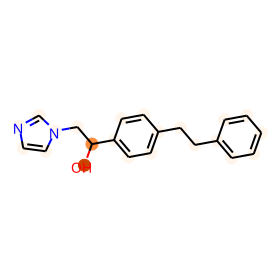

BBBP:1
prediction: [-2.8009481  2.761224 ]
CN(C)CCCN1c2ccccc2C=Cc2ccccc21


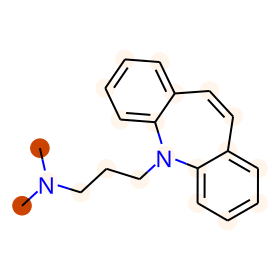

BBBP:1
prediction: [-3.411092   3.3002362]
FC(F)OC(F)C(F)(F)F


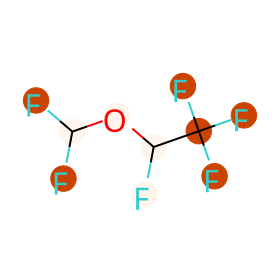

BBBP:1
prediction: [-2.3197868  2.2126226]
CN1CCC23c4c5ccc(O)c4OC2CCCC3C1C5


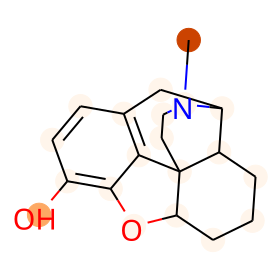

BBBP:1
prediction: [-3.0337164  2.903091 ]
CC(C)[C@@]1(O)CCN2C[C@@H]3c4ccccc4CCc4cccc(c43)[C@H]2C1


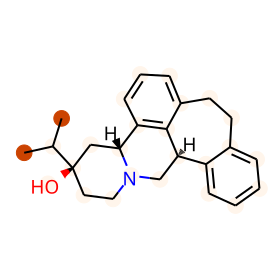

BBBP:1
prediction: [-1.7741951  1.6748762]
CC(CN1CCOCC1)C(C(=O)N1CCCC1)(c1ccccc1)c1ccccc1


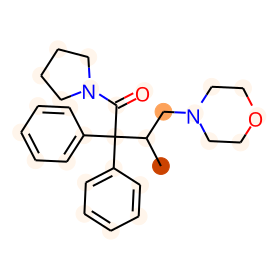

BBBP:1
prediction: [-2.4250076  2.340106 ]
NC(=O)N1CC(Oc2cccc(C(F)(F)F)c2)C1


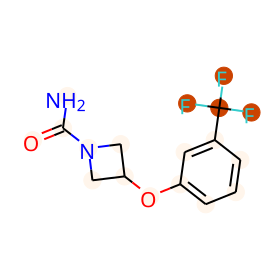

BBBP:1
prediction: [-1.1413505   0.99694335]
CC12CCCCCC(Cc3ccc(O)cc31)C2N


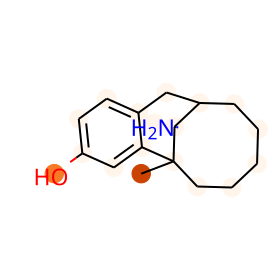

BBBP:1
prediction: [-3.9021797  3.760097 ]
C=CCN1CCC23c4c5ccc(OC(C)=O)c4OC2C(OC(C)=O)C=CC3C1C5


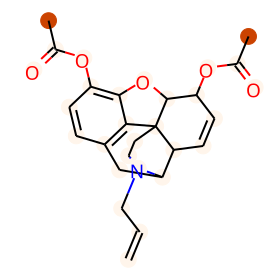

BBBP:1
prediction: [-3.0303411  2.95337  ]
CN(C)CCN1C(=O)c2ccccc2N(C)c2ccccc21


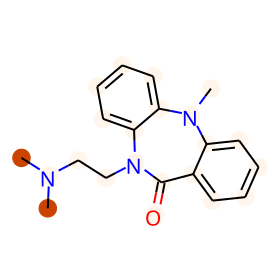

BBBP:1
prediction: [-2.24972    2.1809123]
Cc1ccc2c(c1)C1CN(C)CCC1N2


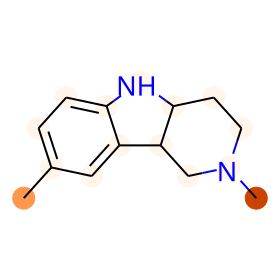

BBBP:1
prediction: [-2.8464184  2.765804 ]
COc1ccc2c(c1)CN(C)CC2c1ccc(Cl)c(Cl)c1


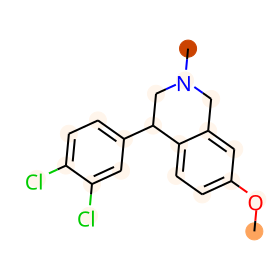

BBBP:1
prediction: [-3.8976295  3.5387642]
CC(=O)OCC(=O)[C@@]1(OC(C)=O)[C@@H](C)C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


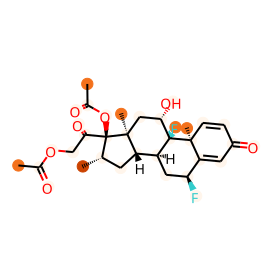

BBBP:1
prediction: [-4.062282   3.7547526]
CCCC(=O)O[C@]1(C(=O)COC(C)=O)CC[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


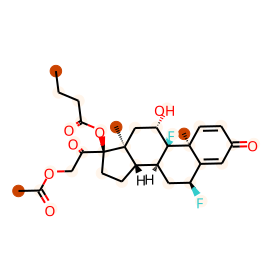

BBBP:1
prediction: [-2.0731184  1.7535249]
C[C@@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@@]1(C)C(=O)CO


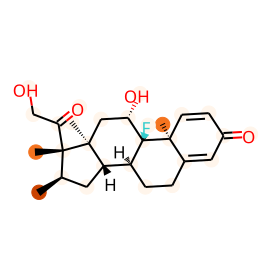

BBBP:1
prediction: [-2.9468582  2.8361123]
CN(C)CCCN1c2ccccc2C(C)(C)c2ccccc21


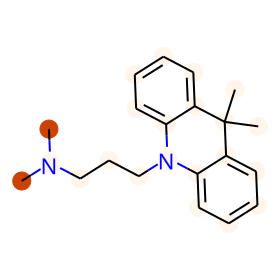

BBBP:1
prediction: [-2.6235452  2.5613344]
CN(C)CC/C=C1/c2ccccc2CSc2ccccc21.[Cl-].[H+]


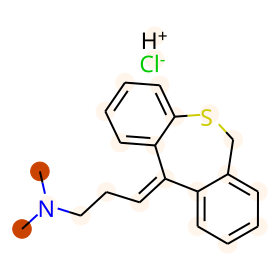

BBBP:1
prediction: [-2.1650517  2.0689895]
O=C1C(O)N=C(c2ccccc2F)c2cc(Cl)ccc2N1CCO


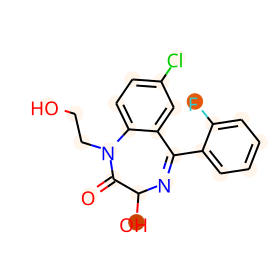

BBBP:1
prediction: [-1.5364516  1.5265963]
O=C1NCNC1(c1ccccc1)c1ccccc1


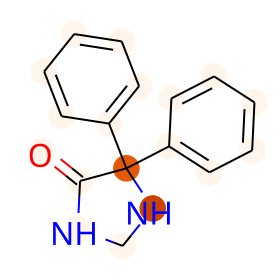

BBBP:1
prediction: [-2.2899873  1.9876461]
CC(=O)[C@@]1(O)[C@@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


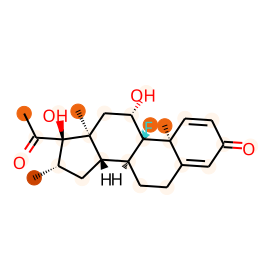

BBBP:1
prediction: [-3.9825988  3.6757586]
CC1(C)O[C@@H]2C[C@H]3C4CCC5CC(=O)CCC5(C)[C@@]4(F)[C@@H](O)CC3(C)[C@]2(C(=O)CO)O1


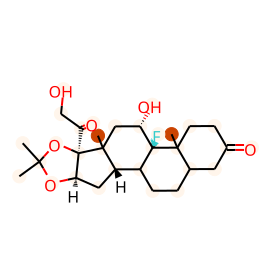

BBBP:1
prediction: [-2.8527277  2.851608 ]
Cn1cc(CCN2CCN(c3ccccc3Cl)CC2)cn1


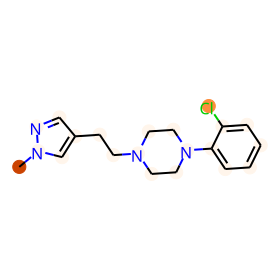

BBBP:1
prediction: [-2.8877869  2.8459795]
C=C1c2ccccc2CN(CCCN(C)C)c2ccccc21


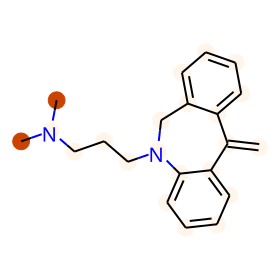

BBBP:1
prediction: [-1.4018418  1.2688535]
CN1CCC2(C)CC(Cc3ccc(O)cc32)C1


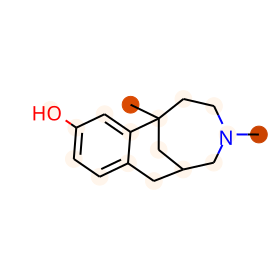

BBBP:1
prediction: [-3.0827985  3.0115516]
CCC1(c2ccccc2)C(=O)N(COC)C(=O)N(COC)C1=O


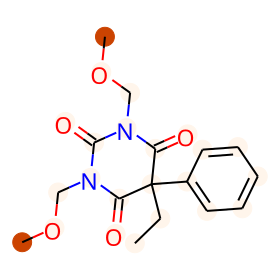

BBBP:1
prediction: [-2.7672434  2.6962807]
CCOC(=O)C1N=C(c2ccccc2F)c2cc(Cl)ccc2NC1=O


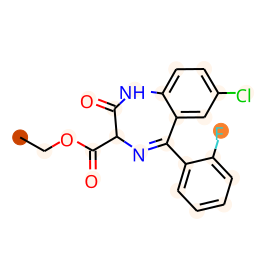

BBBP:1
prediction: [-3.1458983  3.0978339]
CCc1cc2c(s1)-n1c(C)nnc1CN=C2c1ccccc1Cl


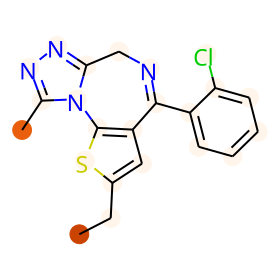

BBBP:1
prediction: [-1.3045183  1.2475872]
CCC(N)Cc1c[nH]c2ccccc12


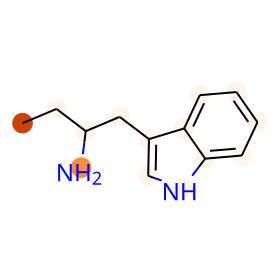

BBBP:1
prediction: [-1.5345117  1.5221381]
O=C(CCCl)NCCc1ccccc1


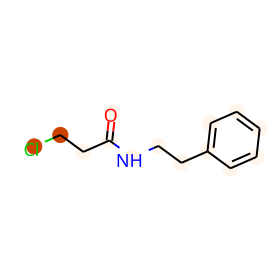

BBBP:1
prediction: [-1.0983379  1.0520952]
O=C1C=CC=C/C1=C1/NN=CO1


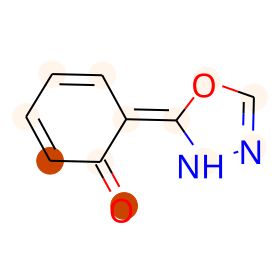

BBBP:1
prediction: [-2.18107    2.1225784]
CN(C)CCCn1cc(-c2ccccc2)c(-c2ccccc2)n1


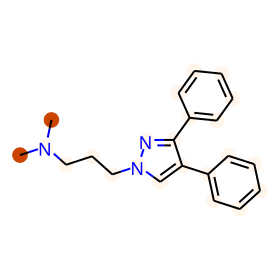

BBBP:1
prediction: [-3.8237789  3.7340178]
Fc1ccccc1C1=NCCN(CC(F)(F)F)c2ccc(Cl)cc21


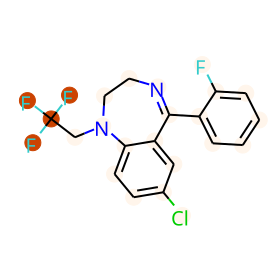

BBBP:1
prediction: [-2.3342104  2.2831967]
COc1ccccc1N1CCN(CCCC(=O)c2ccc(F)cc2)CC1


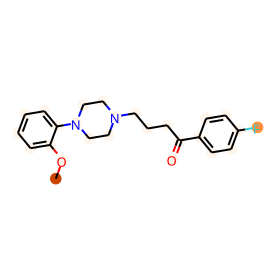

BBBP:1
prediction: [-3.0578904  2.971758 ]
CN(C)C1CCc2[nH]c3c(F)cc(F)cc3c2C1


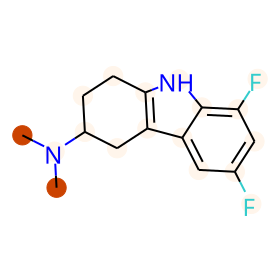

BBBP:1
prediction: [-1.4536866  1.3126805]
C#CC1(OCC(O)CN2CCN(c3ccc(F)cc3)CC2)CCCCC1


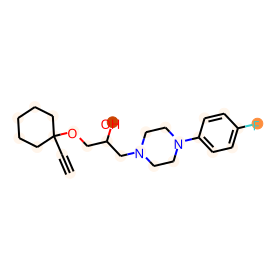

BBBP:1
prediction: [-2.9374657  2.9000638]
CN1C(=O)CN=C(c2ccccc2F)c2cc(Cl)ccc21


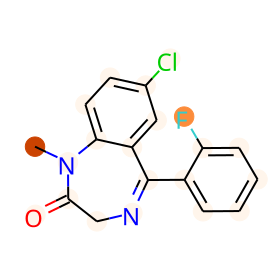

BBBP:1
prediction: [-2.118351   1.7521772]
C[C@@H]1C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)CO


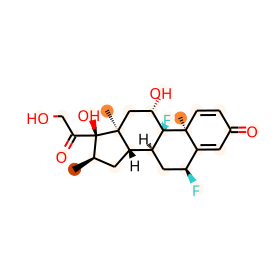

BBBP:1
prediction: [-5.074104   4.6411805]
C[C@@H]1C[C@H]2C3C[C@H](F)C4=CC(=O)C=CC4(C)[C@@]3(F)[C@@H](O)CC2(C)[C@@]1(O)C(=O)COC(=O)C(C)(C)C


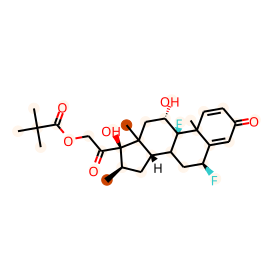

BBBP:1
prediction: [-2.2222614  1.3382502]
CC1(C)O[C@@H]2CC3[C@@H]4C[C@H](F)C5=CC(=O)C=CC5(C)[C@H]4[C@@H](O)C[C@]3(C)[C@]2(C(=O)CO)O1.CC1(C)O[C@@H]2CC3[C@@H]4C[C@H](F)C5=CC(=O)C=CC5(C)[C@H]4[C@@H](O)C[C@]3(C)[C@]2(C(=O)CO)O1.O


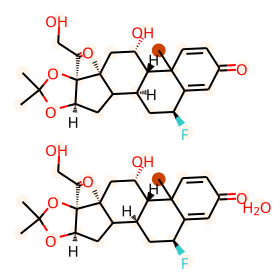

BBBP:1
prediction: [-0.3648244  -0.06830541]
C[C@]12C[C@H](O)[C@@]3(F)[C@@H](C[C@H](F)C4=CC(=O)C=C[C@@]43C)[C@@H]1C[C@@H](O)[C@]2(O)C(=O)CO


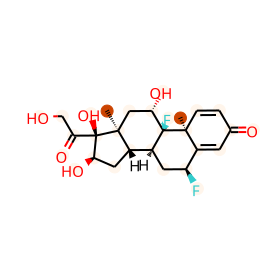

BBBP:1
prediction: [-2.6909828  2.3836567]
CCCCOC(=O)C(=O)[C@H]1[C@H](C)C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]21C


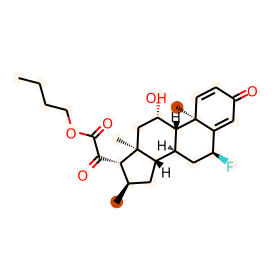

BBBP:1
prediction: [-1.585224   1.2655286]
C[C@@H]1C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@]2(C)[C@H]1C(=O)CO


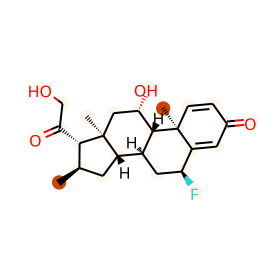

BBBP:1
prediction: [-2.7242112  2.4358199]
CC(=O)[C@@]1(O)CC[C@H]2[C@@H]3C[C@H](C)C4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


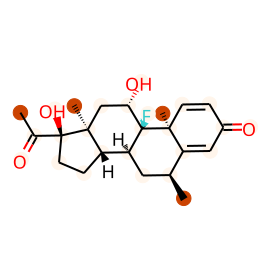

BBBP:1
prediction: [-3.350788   3.3397076]
CN1CCN(C2=Nc3cc(F)ccc3Cc3ccccc32)CC1


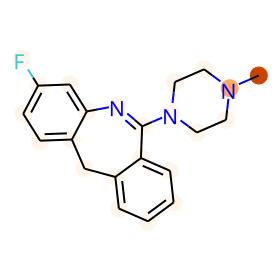

BBBP:1
prediction: [-2.5342412  2.2019641]
CC(=O)O[C@@H](C)C(=O)[C@@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


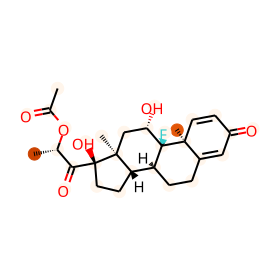

BBBP:1
prediction: [-0.8226564   0.45496336]
C=C1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)C(O)C[C@]2(C)[C@@]1(O)C(=O)CO


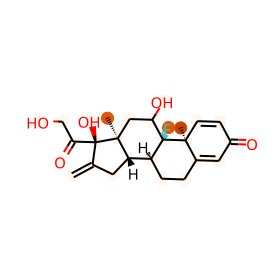

BBBP:1
prediction: [-1.0117427   0.67382556]
C[C@]12C[C@H](O)[C@H]3[C@@H](C[C@H](F)C4=CC(=O)C=C[C@@]43C)[C@@H]1CC[C@]2(O)C(=O)CO


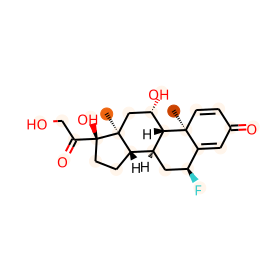

BBBP:1
prediction: [-3.2881775  2.976057 ]
CCCCC(=O)O[C@]1(C(=O)CO)CCC2C3CC(F)C4=CC(=O)C=CC4(C)C3C(O)CC21C


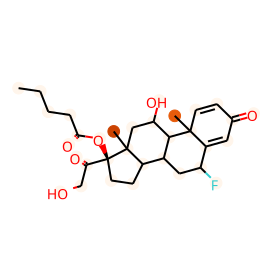

BBBP:1
prediction: [-2.4508786  2.4211526]
CNCCSC1=Cc2cc(F)ccc2Oc2ccccc21


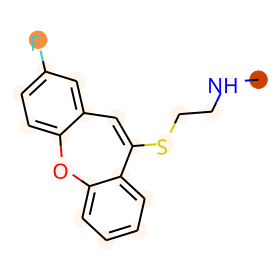

BBBP:1
prediction: [-1.9758955  1.6049792]
CC1(C)O[C@@H]2C[C@H]3[C@@H]4C[C@H](F)C5=CC(=O)CC[C@]5(C)[C@H]4[C@@H](O)C[C@]3(C)[C@]2(C(=O)CO)O1


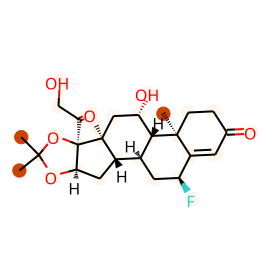

BBBP:1
prediction: [-2.1126256  2.067428 ]
CC(Cc1ccccc1)N(C)Cc1ccco1


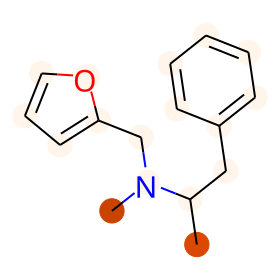

BBBP:1
prediction: [-1.4964393  1.4000448]
CN(C)CCC(c1ccccc1)C1CCCCC1


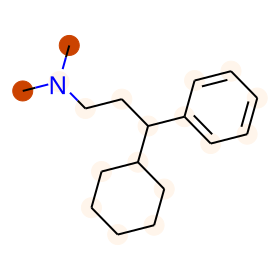

BBBP:1
prediction: [-1.113542   1.0774577]
N=C(N)NCCCOc1ccccc1


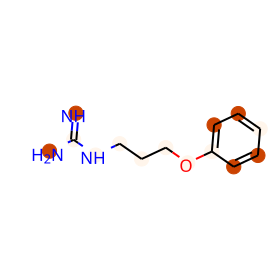

BBBP:1
prediction: [-3.8225217  3.7510896]
O=C1CN=C(c2ccccc2)c2cc(Cl)ccc2N1CC(F)(F)F


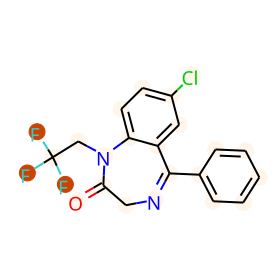

BBBP:1
prediction: [-2.9803913  2.6221044]
C[C@@H]1CC2[C@@H]3C[C@H](F)C4=CC(=O)C(Cl)=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)CO


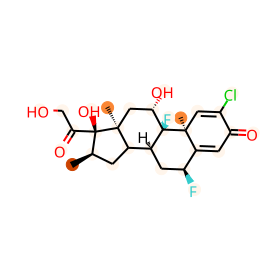

BBBP:1
prediction: [-1.2197515  1.1210487]
CCC1(C2=CCCCCC2)C(=O)NC(=O)NC1=O


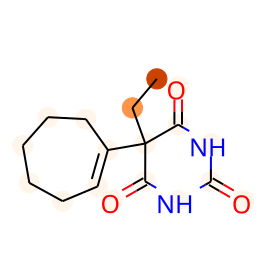

BBBP:1
prediction: [-2.7937527  2.7693508]
CN1CCC(OC2c3ccccc3CCc3ccccc32)CC1


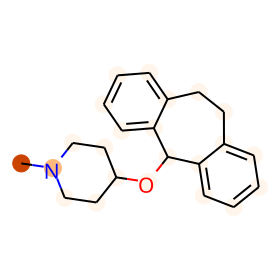

BBBP:1
prediction: [-2.2644444  2.2070296]
CN1CCCN(C(c2ccccc2)c2ccc(Cl)cc2)CC1


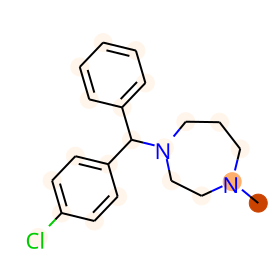

BBBP:1
prediction: [-4.0220103  3.9127307]
OCCN1CCCN(CCCN2c3ccccc3Sc3ccc(C(F)(F)F)cc32)CC1


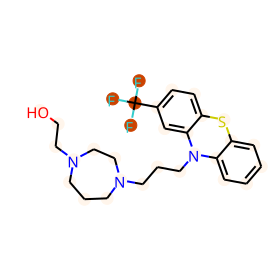

BBBP:1
prediction: [-2.6656437  2.5787485]
CN1CC[C@]23c4c5ccc(O)c4O[C@H]2C(=O)CC[C@H]3[C@H]1C5


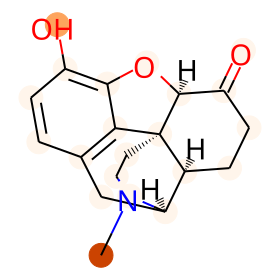

BBBP:1
prediction: [-4.116582   3.8039572]
CCCC(=O)O[C@]1(C(=O)COC(C)=O)[C@H](C)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(Cl)[C@@H](O)C[C@@]21C


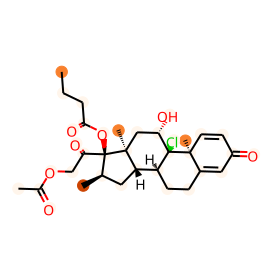

BBBP:1
prediction: [-1.6043469  1.5552702]
CCC1(c2ccccc2)NCC(=O)NC1=O


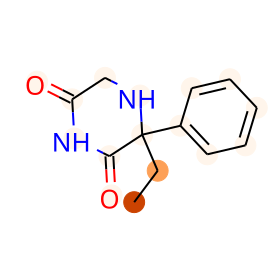

BBBP:1
prediction: [-1.7773441  1.7819712]
c1ccc2c(CCC3CCNCC3)c[nH]c2c1


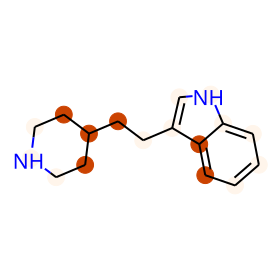

BBBP:1
prediction: [-2.6751738  2.6268353]
CN(C)CC#CC=C1c2ccccc2C=Cc2ccccc21


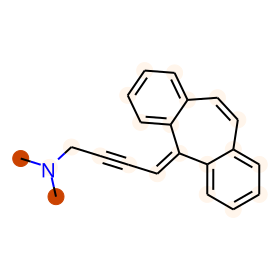

BBBP:1
prediction: [-2.2997386  2.222071 ]
CN(C)CCCn1c2c(c3ccccc31)CCCCCC2


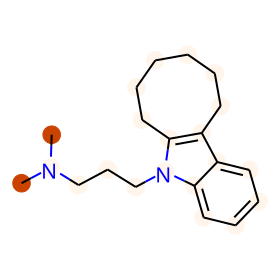

BBBP:1
prediction: [-1.498758   1.4353359]
CC(C)NNC(=O)c1ccncc1


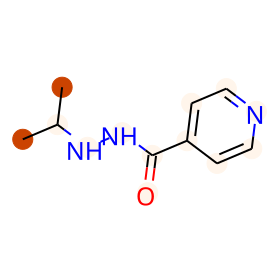

BBBP:1
prediction: [-1.5515136  1.2383723]
C=C1CC2C3C=CC4=CC(=O)CCC4(C)C3C(O)CC2(C)[C@@]1(O)C(=O)CO


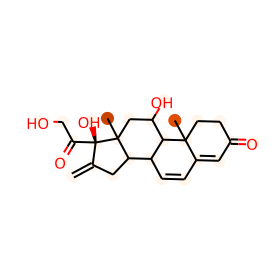

BBBP:1
prediction: [-2.934715  2.893573]
CN(C)CCCN1c2ccccc2CC(=O)c2ccccc21


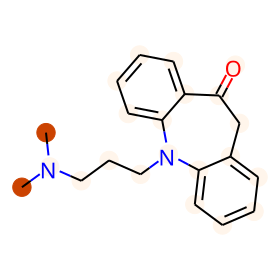

BBBP:1
prediction: [-2.0380013  1.9549781]
O=C1CC[C@H]2[C@H]3Cc4cccc(O)c4[C@@]2(CCN3CC2CC2)C1


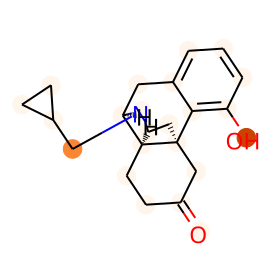

BBBP:1
prediction: [ 0.7698035 -1.218938 ]
N[C@@H](Cc1ccc(O)c(O)c1)C(=O)O


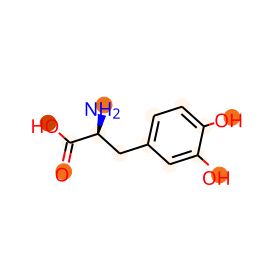

BBBP:1
prediction: [-0.3003369   0.09608897]
CNC[C@H](O)CC12CCC(c3ccccc31)c1ccccc12


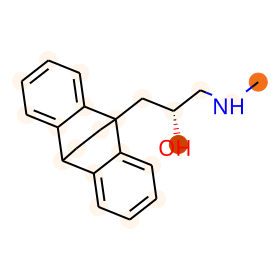

BBBP:1
prediction: [-1.6188926  1.4729891]
CCO[C@H]1CCN(C(=O)c2cc(-c3ccccc3)c(=O)n3c2-c2cc(Cl)ccc2CC3)C1


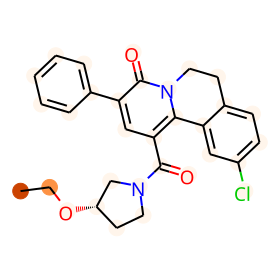

BBBP:1
prediction: [-1.8448087  1.8463283]
c1ccc2cc(COC3CCNCC3)ccc2c1


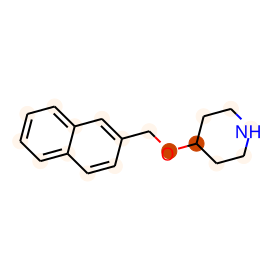

BBBP:1
prediction: [-2.5649838  2.5695002]
OC1CCN(c2ccc(-c3ccccc3Cl)nn2)CC1


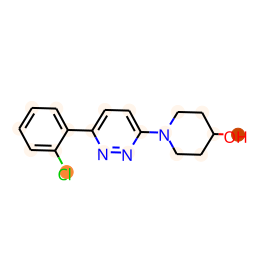

BBBP:1
prediction: [-2.5206766  2.5297902]
Clc1ccc(N2CCN(C/C=C/c3ccccc3)CC2)nn1


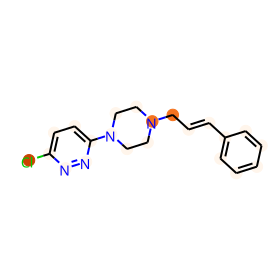

BBBP:1
prediction: [-1.9990861  1.9569662]
Cl/C(=C\n1cncn1)c1ccc(Cl)cc1Cl


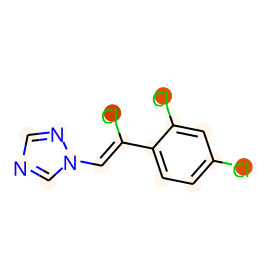

BBBP:1
prediction: [-0.61057556  0.44675437]
CN1C[C@@H]2[C@@H](Cc3ccc(Cl)cc3[C@H]2c2ccccc2)C1


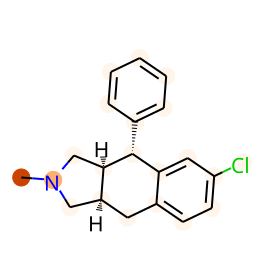

BBBP:1
prediction: [-2.8915365  2.8951275]
CN1CCC2=C(CC1)c1ccccc1Oc1ccccc12


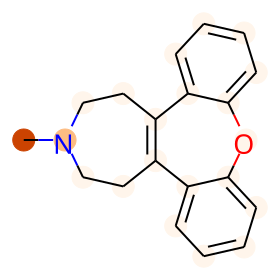

BBBP:1
prediction: [ 0.8516485 -1.3749256]
CC(C)Oc1ccccc1N1CCN(Cc2cccc(C(=O)N3CCCCC3)c2)CC1.O=C(O)CCC(=O)O


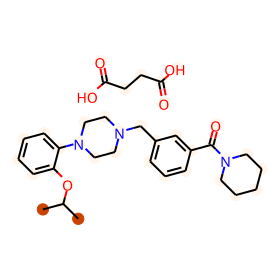

BBBP:1
prediction: [-1.9889809  1.9229352]
CN1C(=O)CN=C(C2=CCCCC2)c2cc([N+](=O)[O-])ccc21


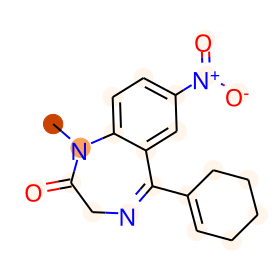

BBBP:1
prediction: [-2.4444172  2.396229 ]
CCC1(c2ccccc2)C(=O)NC(=O)N(C)C1=O


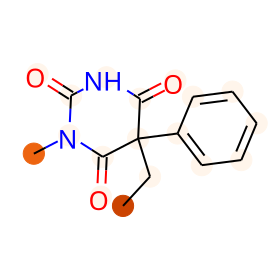

BBBP:1
prediction: [-1.36231    1.2850847]
Cc1cc(CCN2CCN(c3cccc(Cl)c3)CC2)n[nH]1


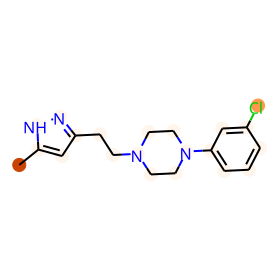

BBBP:1
prediction: [-2.6655188  2.5865533]
COCC1CN=C(c2ccccc2Cl)c2cc(Br)ccc2N1C


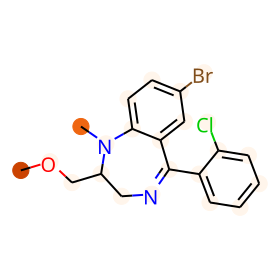

BBBP:1
prediction: [-1.5069438  1.4038846]
CC(C(=O)c1ccccc1)N(C)C


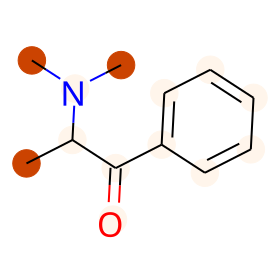

BBBP:1
prediction: [-2.5715384  2.542011 ]
CNC1Cc2ccccc2N(C)c2ccccc21


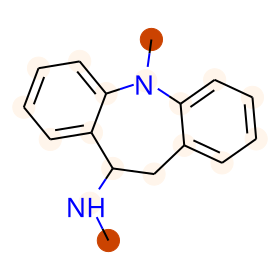

BBBP:1
prediction: [-1.2850882  1.1892376]
Cc1cc(C)cc(OCC2CNC(=O)O2)c1


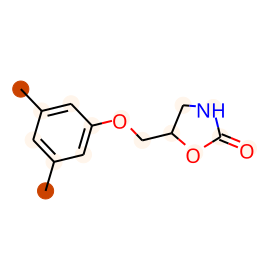

BBBP:1
prediction: [-2.7054367  2.6765924]
CN1C(=O)CC(C)(c2ccccc2)C1=O


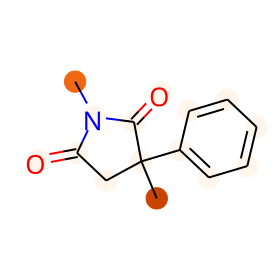

BBBP:1
prediction: [-0.6590549   0.29412434]
C[C@H]1C[C@H]2[C@@H]3CC[C@](O)(C(=O)CO)[C@@]3(C)C[C@H](O)[C@@H]2[C@@]2(C)C=CC(=O)C=C12


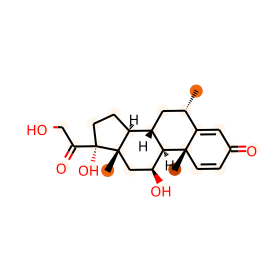

BBBP:1
prediction: [-2.281107   1.9788578]
CC(=O)OCC(=O)[C@@]1(O)CC[C@H]2[C@@H]3C[C@H](C)C4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]21C


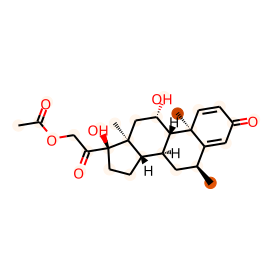

BBBP:1
prediction: [ 0.19404761 -0.7007499 ]
C[C@H]1C[C@H]2[C@@H]3CC[C@](O)(C(=O)COC(=O)CCC(=O)O)[C@@]3(C)C[C@H](O)[C@@H]2[C@@]2(C)C=CC(=O)C=C12


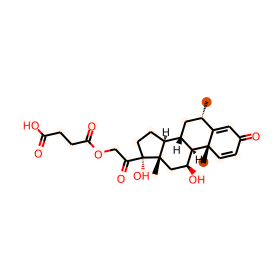

BBBP:1
prediction: [-3.333799   3.2724035]
CSc1ccc2c(c1)C(N1CCN(C)CC1)Cc1ccccc1S2


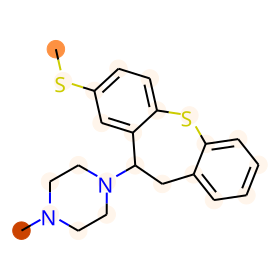

BBBP:1
prediction: [-1.3098053  1.2128305]
COC(=O)c1cncn1C(C)c1ccccc1


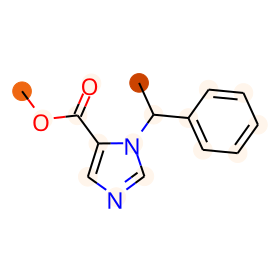

BBBP:1
prediction: [-2.690398   2.7124813]
CNCCCN1Cc2ccccc2Cc2ccccc21


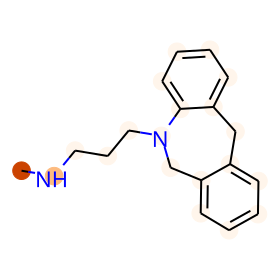

BBBP:1
prediction: [-3.0975878  3.0514762]
Cc1ncc2n1-c1ccc(Cl)cc1C(c1ccccc1F)=NC2


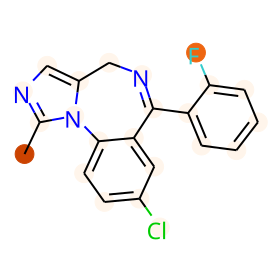

BBBP:1
prediction: [-1.3797199  1.2207799]
O=C(c1ccc(F)cc1)C1CCN(CCCn2c(=O)[nH]c3cc(Cl)ccc32)CC1


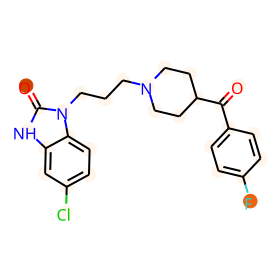

BBBP:1
prediction: [-2.542727   2.4090443]
COc1cc2[nH]c(C)c(CCN3CCN(c4ccccc4OC)CC3)c2cc1OC


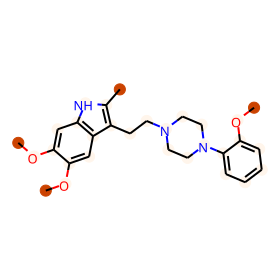

BBBP:1
prediction: [-0.4237908  0.2627704]
CCN(CC)C(=O)[C@]1(c2ccccc2)C[C@@H]1CN.[Cl-].[H+]


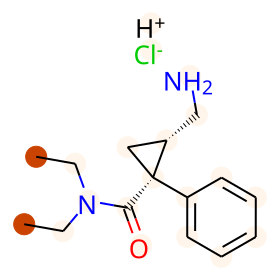

BBBP:1
prediction: [-2.211451   2.0755093]
COc1ccc2c(C3CCN(CCCC(=O)c4ccc(F)cc4)CC3)c(C)[nH]c2c1


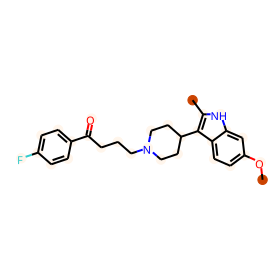

BBBP:1
prediction: [-1.6741177  1.6512764]
Cc1nccnc1N1CCCCC1


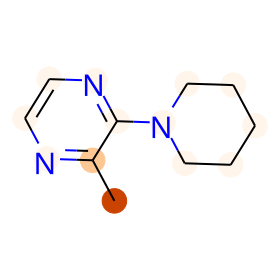

BBBP:1
prediction: [-0.8801818   0.78953874]
NC/C(=C/F)CCc1ccc(F)cc1


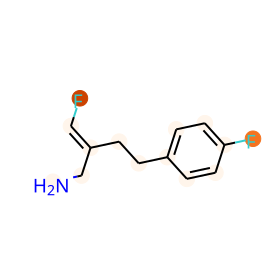

BBBP:1
prediction: [-2.6451194  2.5869386]
CCc1c(C)[nH]c2c1C(=O)C(CN1CCOCC1)CC2


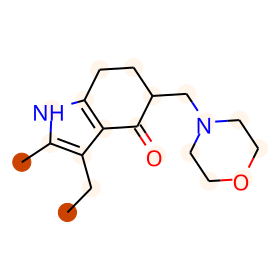

BBBP:1
prediction: [-2.2106562  2.1489956]
CN(C)CC[C@]1(c2ccccc2)CCc2ccccc2C1=O


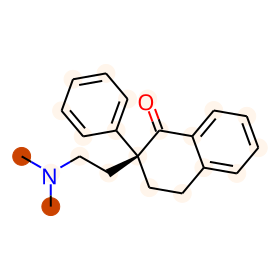

BBBP:1
prediction: [-3.2136424  3.1206229]
CC1CN(C)CC2Cc3c(ccc4ccccc34)OC12O


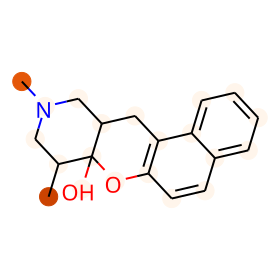

BBBP:1
prediction: [-1.5344995  1.4037353]
C=CCC1(CC(C)(C)C)C(=O)NC(=O)NC1=O


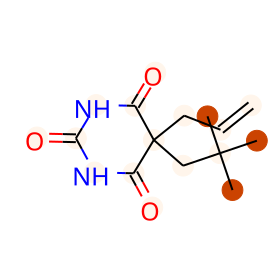

BBBP:1
prediction: [-1.7705437  1.7706271]
NCC1CC(=O)N(Cc2ccccc2)C1


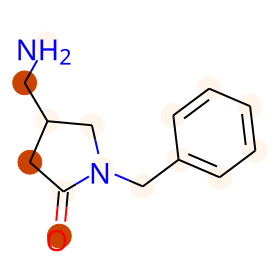

BBBP:1
prediction: [-2.5980415  2.5906298]
CN1CCOC(c2ccccc2)c2ccccc2C1


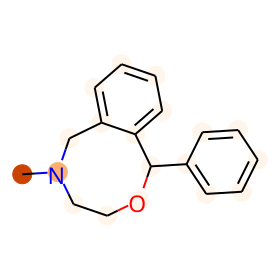

BBBP:1
prediction: [-2.925468   2.7789083]
CNc1cc(OC)c(C(=O)N[C@@H]2CCN(Cc3ccccc3)[C@@H]2C)cc1Cl


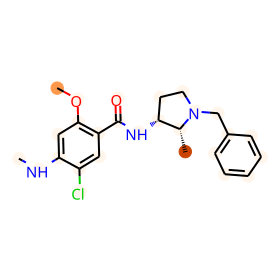

BBBP:1
prediction: [-3.3652418  3.22104  ]
COc1ccc2c3c1OC1C(OC(=O)c4cccnc4)CCC4C(C2)N(C)CCC341


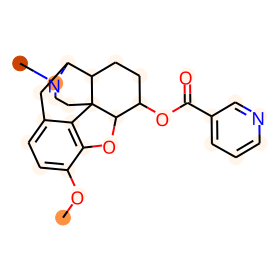

BBBP:1
prediction: [-3.1706467  3.0926185]
COc1ccc2c3c1OC1C(O)C=CC4C(C2)NCCC341


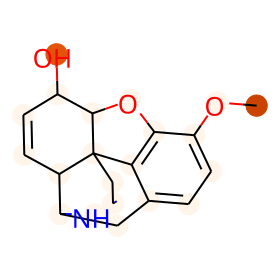

BBBP:1
prediction: [-2.6116593  2.5602477]
COCC(=O)N(c1ccccc1F)C1CCN(CCc2ccccc2)CC1


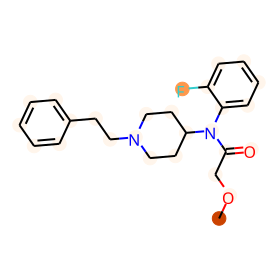

BBBP:1
prediction: [-0.5714467  0.3202399]
CC(=O)O.CN1CCc2cc(Cl)c(O)cc2[C@@H](c2cccc3c2OCC3)C1


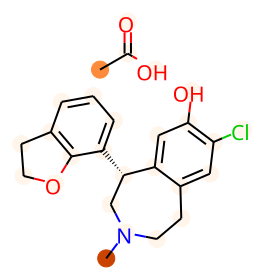

BBBP:1
prediction: [-2.7384143  2.6917863]
Cc1cc2c(s1)=Nc1ccccc1NC=2N1CCN(C)CC1


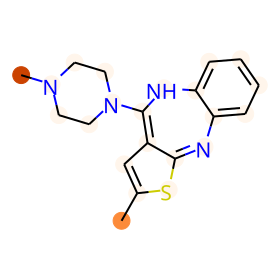

BBBP:1
prediction: [-2.5766296  2.4985006]
C[C@@H]1CN2CC(=O)Nc3ccc(Cl)cc3[C@]2(c2ccccc2)O1


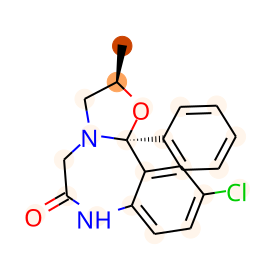

BBBP:1
prediction: [-0.92994124  0.76659817]
Oc1ccc2c(c1)[C@@]13CCCC[C@@]1(O)[C@@H](C2)N(CC1CC1)CC3


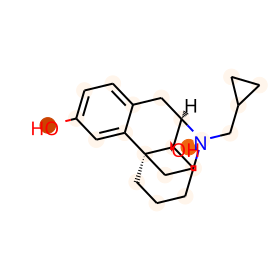

BBBP:1
prediction: [-2.5583954  2.4682052]
COc1cc2[nH]c(C)c(CCN3CCN(c4ccccc4)CC3)c2cc1OC


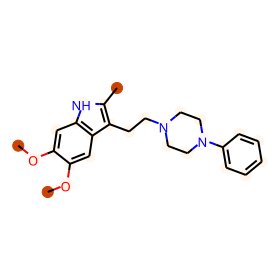

BBBP:1
prediction: [-0.39850882  0.2871987 ]
CC(=O)Nc1ccc(O)cc1


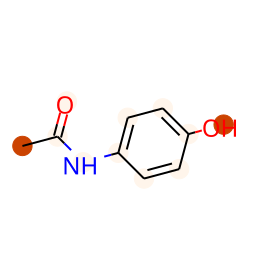

BBBP:1
prediction: [-1.6827362  1.3278097]
C[C@@H]1C[C@H]2[C@@H]3C[C@H](F)C4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@]2(C)[C@@]1(O)C(=O)CO


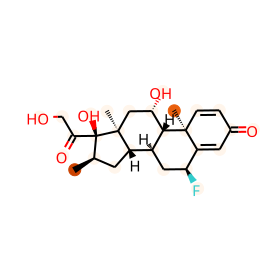

BBBP:1
prediction: [-0.32987064  0.2154916 ]
CCC(=O)Nc1ccc(O)cc1


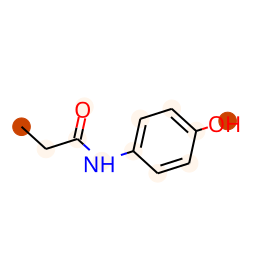

BBBP:1
prediction: [-2.3039856  2.314171 ]
NC(=O)CN1C(=O)COc2ccccc21


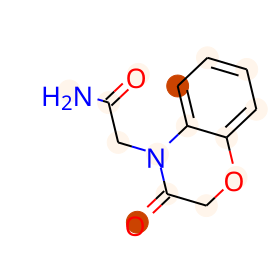

BBBP:1
prediction: [ 0.297649  -0.5338328]
Nc1nc(=O)c2ncn(CCC(CO)CO)c2[nH]1


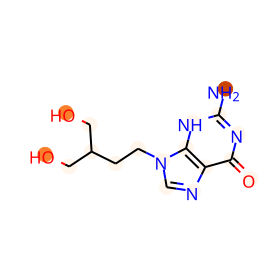

BBBP:1
prediction: [-2.0163906  1.9618359]
CC(C)CCNCC1COc2ccccc2O1


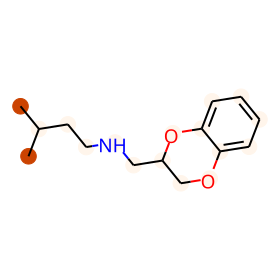

BBBP:1
prediction: [-1.26096    1.2363081]
C1CCc2nnnn2CC1


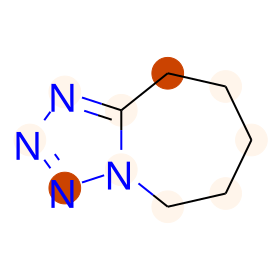

BBBP:1
prediction: [-2.9786339  2.9541047]
N#Cc1ccc2c(c1)N(CCCN1CCC(O)CC1)c1ccccc1S2


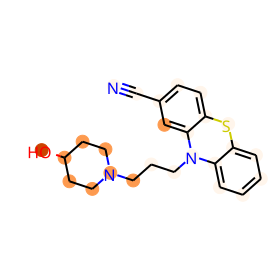

BBBP:1
prediction: [-2.8335876  2.7271373]
COc1ccc2c(c1)N(CC(C)CN1CCC(O)CC1)c1ccccc1S2


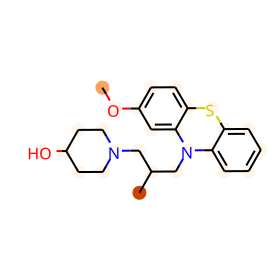

BBBP:1
prediction: [-0.25554752  0.0947145 ]
OC(CN1CCCCC1)c1cc(-c2ccccc2)on1


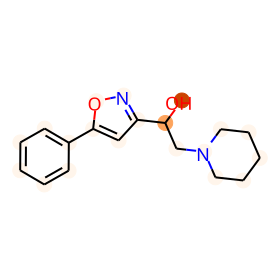

BBBP:1
prediction: [-1.9439194  1.9065957]
CC(=O)OC(c1ccccc1)C1CCCCN1


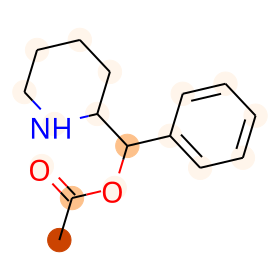

BBBP:1
prediction: [-1.8679951  1.7439275]
CC(C)(O)C(C)(O)c1ccc(Cl)cc1


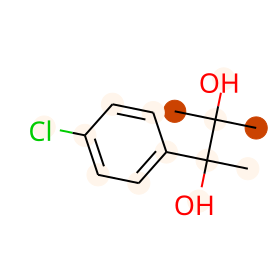

BBBP:1
prediction: [-2.0005014  1.9471027]
C[C@H]1[C@H](c2ccccc2)OCCN1C


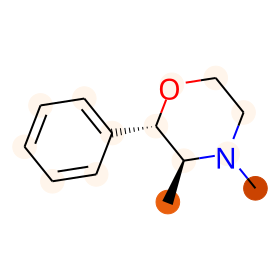

BBBP:1
prediction: [-0.34014827  0.26171717]
NNCCc1ccccc1.[Cl]


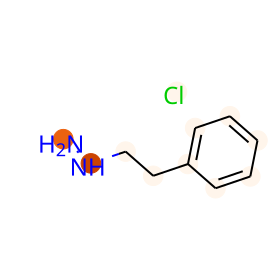

BBBP:1
prediction: [-0.9663795   0.89861405]
CC(Cc1ccccc1)NN


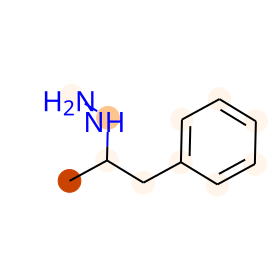

BBBP:1
prediction: [-1.825992   1.7225063]
Oc1ccc2c(c1)C13CCCCC1C(C2)N(CCc1ccccc1)CC3


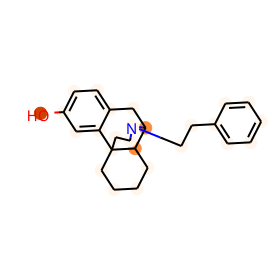

BBBP:1
prediction: [-2.1859257  2.1464016]
CCOC(=O)C1(c2ccccc2)CCN(CCCNc2ccccc2)CC1


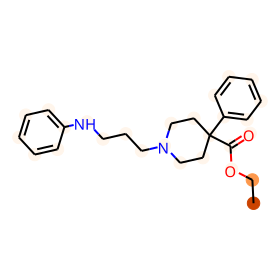

BBBP:1
prediction: [-2.4866333  2.4767091]
C#CCN1C(=O)CN=C(c2ccccc2)c2cc(Cl)ccc21


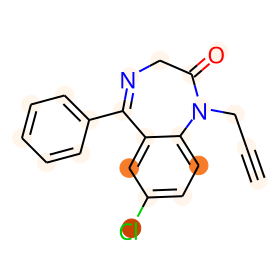

BBBP:1
prediction: [-2.1490726  1.9816711]
CN(C)S(=O)(=O)c1ccc2c(c1)N(CCCN1CCC(CCO)CC1)c1ccccc1S2


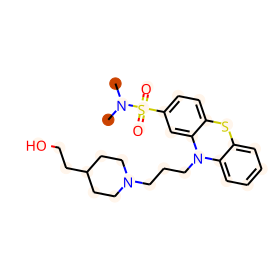

BBBP:1
prediction: [-0.1330474   0.00276339]
OC(c1ccccc1)(c1ccccc1)C1CCCCN1


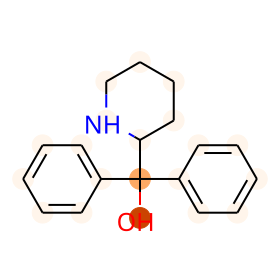

BBBP:1
prediction: [-2.675075  2.704825]
c1cnc(N2CCN(Cc3ccc4c(c3)OCO4)CC2)nc1


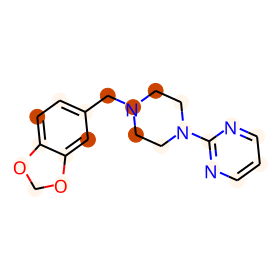

BBBP:1
prediction: [-2.9070983  2.9093258]
CN1CCC(=C2c3ccccc3CCc3sccc32)CC1


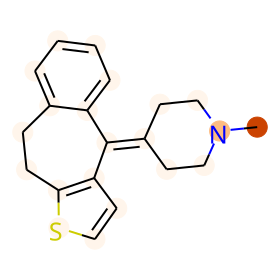

BBBP:1
prediction: [-2.7930462  2.7601564]
CN(C)CCCN1c2ccccc2CCc2ccccc21


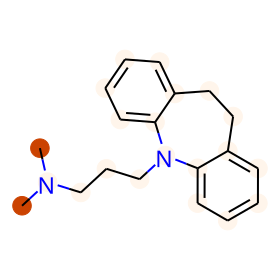

BBBP:1
prediction: [-2.3804517  2.1321099]
CC(=O)OCC(=O)[C@@]1(O)CC[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@H]3[C@@H](O)C[C@@]21C


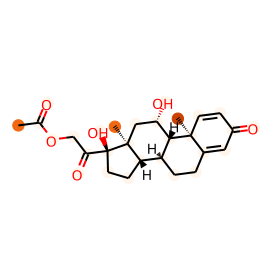

BBBP:1
prediction: [-2.2310884  1.9737308]
C[C@]12C[C@H](O)[C@H]3[C@@H](CCC4=CC(=O)C=C[C@@]43C)[C@@H]1CC[C@]2(O)C(=O)COC(=O)CCC(=O)[O-].[Na+]


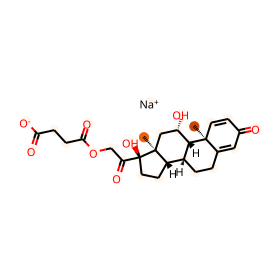

BBBP:1
prediction: [-2.7044249  2.428855 ]
CCCCC(=O)OC1(C(=O)CO)CCC2C3CCC4=CC(=O)C=CC4(C)C3C(O)CC21C


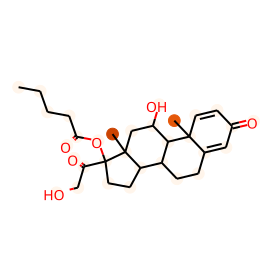

BBBP:1
prediction: [-1.9014364  1.8303722]
Cc1c2c(cn1C)NC(=O)CN=C2c1ccccc1


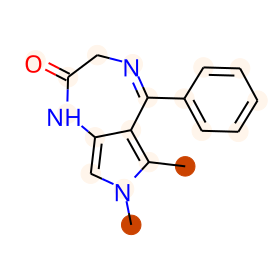

BBBP:1
prediction: [-2.1205304  1.9972041]
COc1ccc(C#N)cc1C(=O)NCCN1CCC(C(=O)c2ccc(F)cc2)CC1


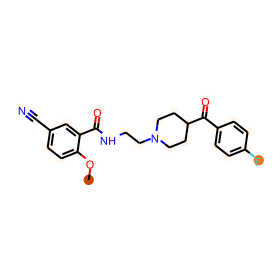

BBBP:1
prediction: [-1.3507931  1.2493274]
CCCOC(=O)c1cncn1C(C)c1ccccc1


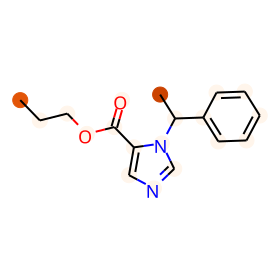

BBBP:1
prediction: [-1.1242901  0.9387671]
CCCN1CCCC1CNC(=O)c1cc(S(N)(=O)=O)ccc1OC


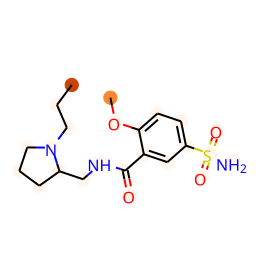

BBBP:1
prediction: [-2.9034615  2.8702073]
CN(C)CCCN1c2ccccc2Sc2cccnc21


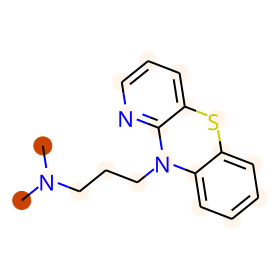

BBBP:1
prediction: [-1.7715297  1.6871417]
CCCC(C(=O)c1ccc(C)cc1)N1CCCC1


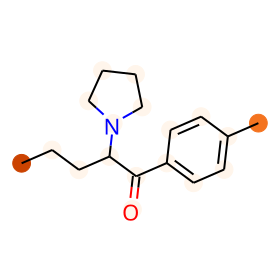

BBBP:1
prediction: [-3.13845    3.1529195]
c1ccc2c(c1)CCc1ccccc1N2C1CN2CCC1CC2


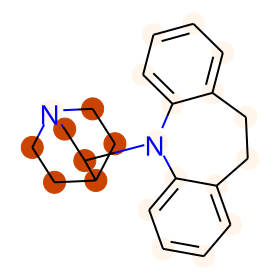

BBBP:1
prediction: [-2.5595357  2.518254 ]
Cc1[nH]nc2c1N(c1ccccc1)C(=O)CC(=O)N2C


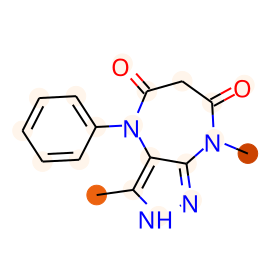

BBBP:1
prediction: [-1.257611   1.1904076]
CCOc1ccccc1O[C@@H](c1ccccc1)[C@@H]1CNCCO1


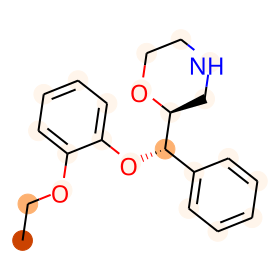

BBBP:1
prediction: [-2.4080021  2.3009582]
CCN1CCC[C@H]1CNC(=O)c1c(OC)ccc(Br)c1OC


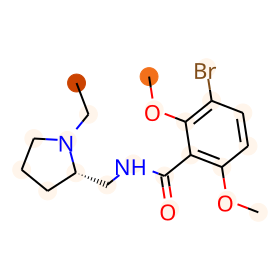

BBBP:1
prediction: [-0.8527345  0.7127421]
O=C1c2ccccc2S(=O)(=O)N1CCCN1CCN(c2ncccn2)CC1


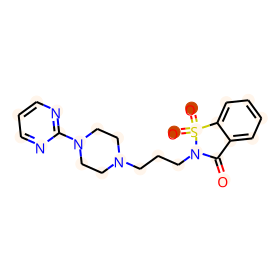

BBBP:1
prediction: [-3.0815039  3.0296547]
CN1CCN(C2=Cc3cc(Cl)ccc3/C(=C\C#N)c3ccccc32)CC1


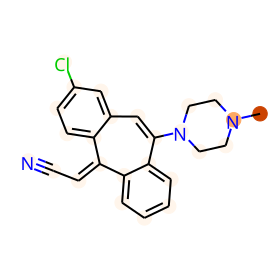

BBBP:1
prediction: [-2.3539581  2.2670987]
Nc1nc2ccc(OC(F)(F)F)cc2s1.[Cl-].[H+]


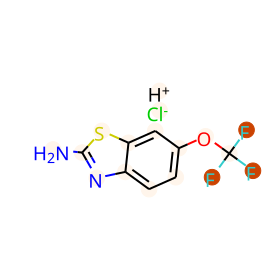

BBBP:1
prediction: [-2.7354274  2.6477022]
COC(F)(F)C(F)Br


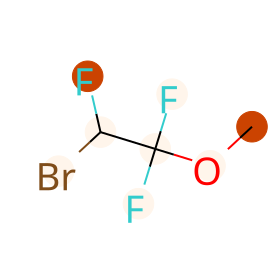

BBBP:1
prediction: [-1.8956223  1.7952008]
COc1cc(C(=O)/C=C/N2CC=CC2)cc(OC)c1OC


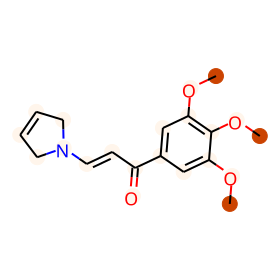

BBBP:1
prediction: [-2.0587943  2.0583608]
O=C1CCC2CCC(=O)N12


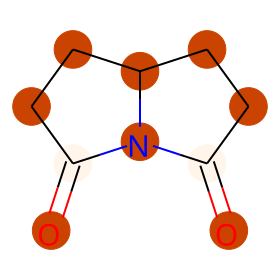

BBBP:1
prediction: [-1.8749291  1.8110404]
Cc1cccc(/C=N/N2CCN(C(c3ccccc3)c3ccccc3)CC2)n1


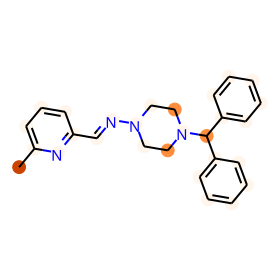

BBBP:1
prediction: [-1.2695745  1.1813893]
NC(=O)c1cn(Cc2c(F)cccc2F)nn1


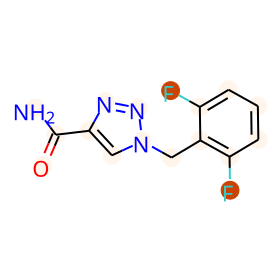

BBBP:1
prediction: [-1.6660004  1.4916185]
CN(c1nc2ccccc2s1)C1CCN(CC(O)COc2ccc(F)cc2)CC1


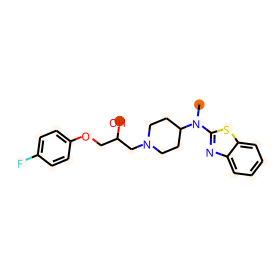

BBBP:1
prediction: [-2.9503498  2.8888729]
NCCC(Oc1ccc(C(F)(F)F)cc1)c1ccccc1


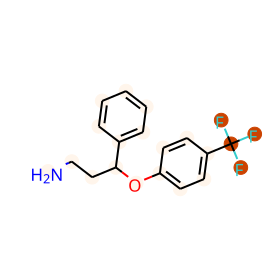

BBBP:1
prediction: [-2.6057606  2.5080872]
Cc1nc2n(c(=O)c1CCN1CCC(C(=O)c3ccc(F)cc3)CC1)CCS2


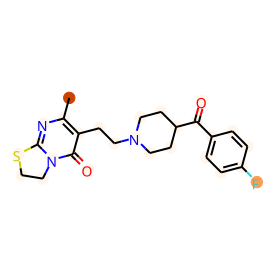

BBBP:1
prediction: [-2.6120567  2.5316584]
CN1CCN(c2ncc(-c3cc(Cl)cc(Cl)c3Cl)c(N)n2)CC1


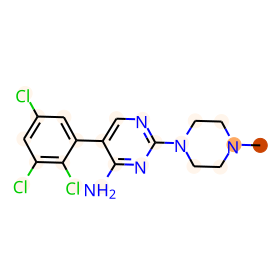

BBBP:1
prediction: [-1.9881909  1.9160056]
Clc1ccc([C@@H]2[C@H]3CC[C@@H](C3)C23CCC(N2CCOCC2)=N3)cc1


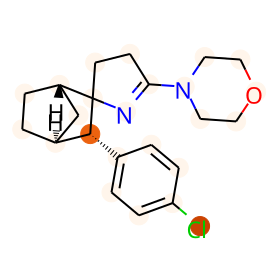

BBBP:1
prediction: [-2.6643908  2.6456666]
O=C1NCN(c2ccccc2)C12CCN(CC1COc3ccccc3O1)CC2


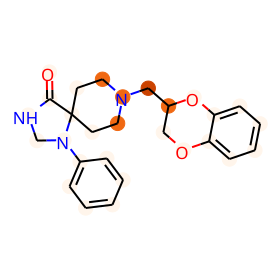

BBBP:1
prediction: [-2.6282172  2.608113 ]
CN1C(=S)CN=C(c2ccccc2)c2cc(Cl)ccc21


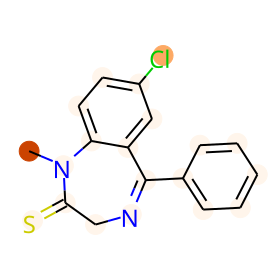

BBBP:1
prediction: [-0.9980561  0.8487568]
CCC(C)(S(=O)(=O)CC)S(=O)(=O)CC


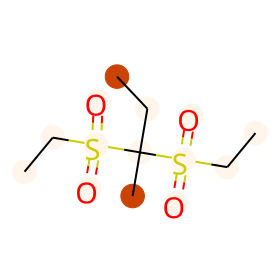

BBBP:1
prediction: [-1.0683174  0.8834908]
CCN1CCCC1CNC(=O)c1cc(S(N)(=O)=O)ccc1OC


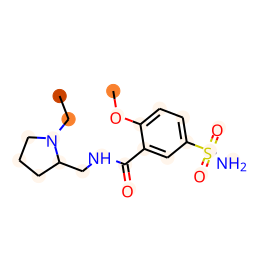

BBBP:1
prediction: [ 0.03962164 -0.2148205 ]
O=C1NCCCC1N1C(=O)c2ccccc2S1(=O)=O


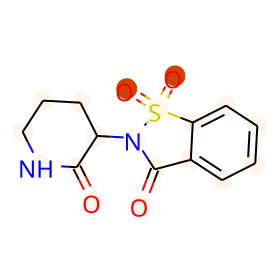

BBBP:1
prediction: [-2.9786997  2.9738975]
c1ccc2c(c1)CCc1cccc3c1C2CN1CCCCC31


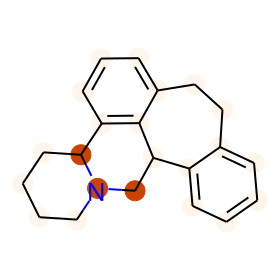

BBBP:1
prediction: [-1.4425827  1.3300891]
C=CCC1(C(C)CC)C(=O)NC(=O)NC1=O


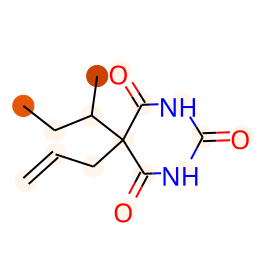

BBBP:1
prediction: [-2.9133594  2.8766997]
CN1CCN(C2=Nc3cscc3/C(=C/C#N)c3cscc32)CC1


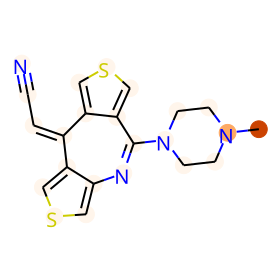

BBBP:1
prediction: [-0.8795643  0.7600557]
O=C(O)/C=C\C(=O)O.c1csc(Cc2ccccc2OCC2CNCCO2)c1


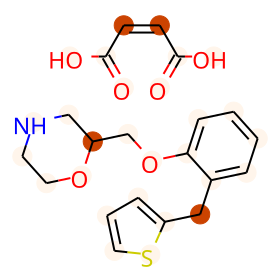

BBBP:1
prediction: [-2.3431401  2.294923 ]
CN1C(=O)CN=C(C2=CCCCC2)c2cc(Cl)ccc21


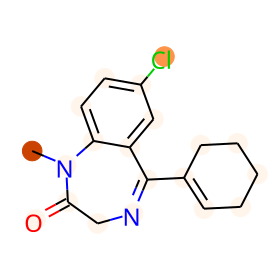

BBBP:1
prediction: [-1.5836695  1.4645214]
CCCC(CC)C1(CC)C(=O)NC(=S)NC1=O


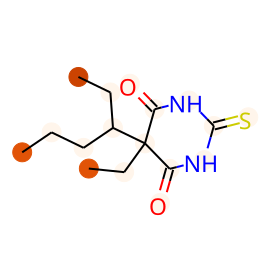

BBBP:1
prediction: [-2.166789  2.033052]
CCN(CC)CCNC(=O)c1cc(S(C)(=O)=O)ccc1OC


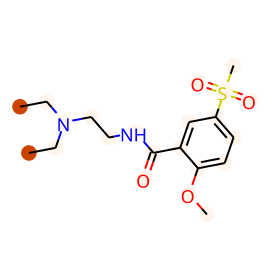

BBBP:1
prediction: [-4.975258   4.6225348]
CCC(=O)O[C@]1(C(=O)SC)[C@H](C)CC2C3C[C@H](F)C4=CC(=O)C=CC4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


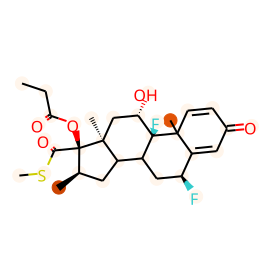

BBBP:1
prediction: [-2.8330746  2.7949352]
CN(C)CCCN1c2ccccc2C=Cc2sccc21


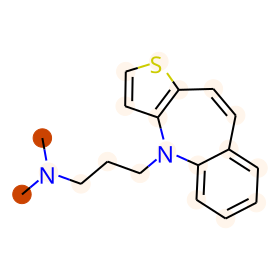

BBBP:1
prediction: [-2.2371454  2.2199414]
CCNC1(c2cccs2)CCCCC1=O


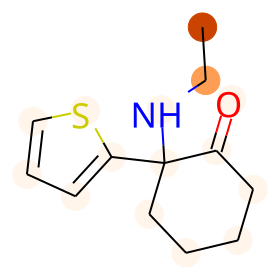

BBBP:1
prediction: [-4.2902565  3.9879415]
CSC(=O)C1(O)C(C)CC2C3CCC4=CC(=O)C=CC4(C)C3(F)C(O)CC21C


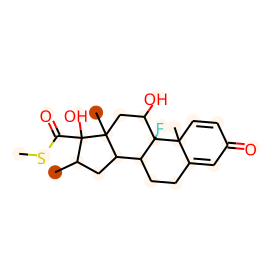

BBBP:1
prediction: [-2.3870444  2.3388708]
CCCC1(C)COB(c2ccc(C)cc2)OC1


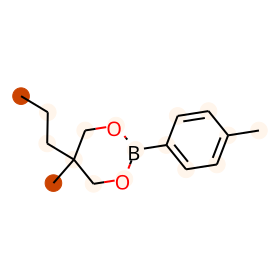

BBBP:1
prediction: [-1.4165202  1.350529 ]
Cc1cccc(N2CC(CO)OC2=O)c1


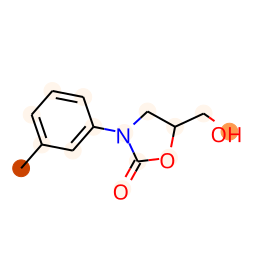

BBBP:1
prediction: [-1.8157936  1.7643069]
CNCC[C@@H](Oc1ccccc1C)c1ccccc1


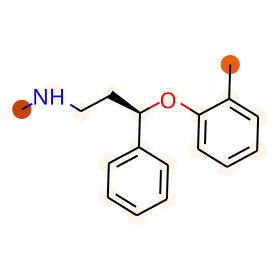

BBBP:1
prediction: [-2.5219965  2.5258076]
Cc1ccccc1N1CCN(CCCOc2ccccn2)CC1


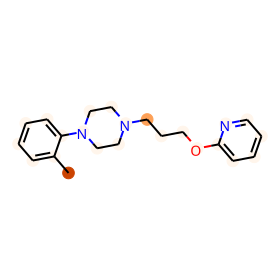

BBBP:1
prediction: [-1.867295   1.7560937]
COc1cc2c(cc1OC)[C@@H](c1ccccc1)CN(C)CC2


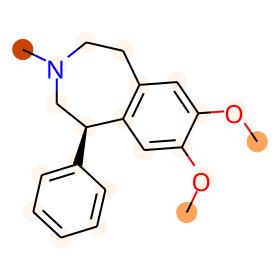

BBBP:1
prediction: [-3.285297   2.9854789]
CC(=O)OCC(=O)[C@@]1(O)[C@H](OC(C)=O)C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(F)[C@@H](O)C[C@@]21C


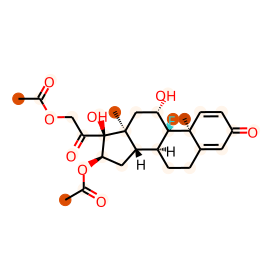

BBBP:1
prediction: [-1.2665824  1.1571829]
O=C(Nc1ccc(O)cc1)C(Cl)(Cl)Cl


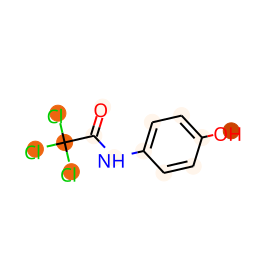

BBBP:1
prediction: [-4.497244  4.386575]
CN1CCN(CCCN2c3ccccc3Sc3ccc(C(F)(F)F)cc32)CC1


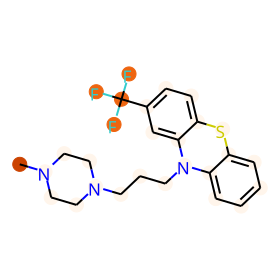

BBBP:1
prediction: [-2.6299763  2.5286155]
COc1cccc(C(=O)NC2C[C@@H]3CC[C@H](C2)N3Cc2ccccc2)c1OC


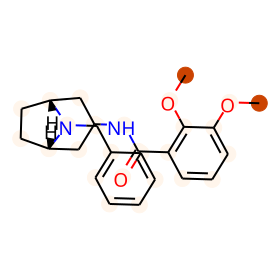

BBBP:1
prediction: [-3.0592349  3.012242 ]
CN1c2ccccc2C(c2ccccc2Cl)=NCC1(Cl)CO


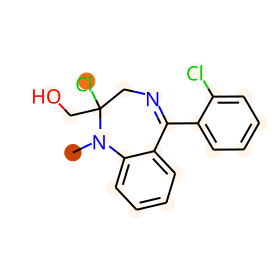

BBBP:1
prediction: [-5.0464983  4.7161326]
CC1CC2C3CC(F)C4=CC(=O)C=CC4(C)C3(F)C(O)CC2(C)C1(O)C(=O)CCl


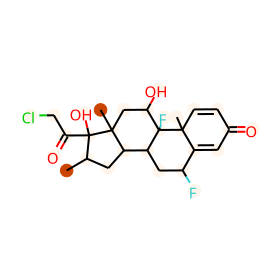

BBBP:1
prediction: [-1.8792222  1.8330339]
C=CCC(CC)(CC)C(N)=O


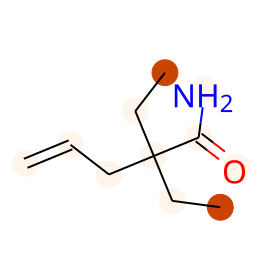

BBBP:1
prediction: [-1.4158686  1.3147609]
CCC(C)C(CC)C(N)=O


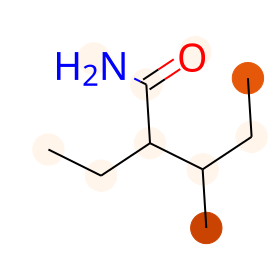

BBBP:1
prediction: [-1.423472   1.2046983]
CO[C@@H]1O[C@H]2O[C@]3(CN4CCCCC4)[C@@H](O)C[C@@H]([C@H]13)[C@H]2C


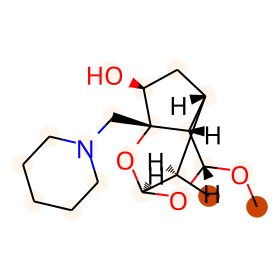

BBBP:1
prediction: [-1.6586784  1.6076294]
CCCC(CCC)C(N)=O


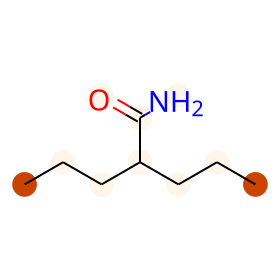

BBBP:1
prediction: [-1.3199697  1.1960032]
CC/C=C(\C)C1(CC)C(=O)NC(=O)NC1=O


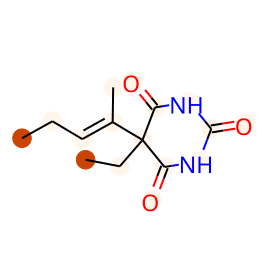

BBBP:1
prediction: [-1.5149695  1.4024612]
C=CC1(C(C)CCC)C(=O)NC(=O)NC1=O


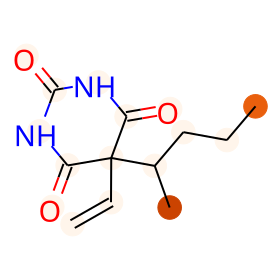

BBBP:1
prediction: [-2.4350753  2.3967755]
C=CC1CNCCC1CCCc1ccnc2ccc(OC)cc12


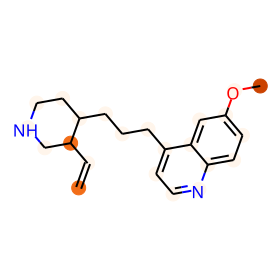

BBBP:1
prediction: [-2.2421632  2.1982627]
CCCCCCOc1nsnc1C1=CCCN(C)C1


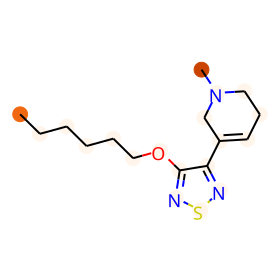

BBBP:1
prediction: [-2.1349618  2.0663116]
CN(C)C/C=C(/c1ccc(Br)cc1)c1cccnc1


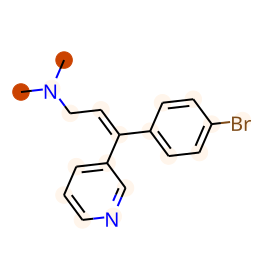

BBBP:1
prediction: [-1.6774927  1.5852363]
CC1=C2C(c3cccc(Cl)c3)=NCCN=C2N(C)N1


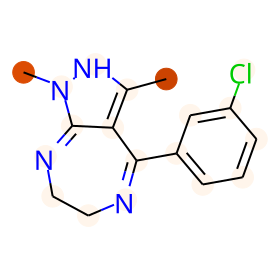

BBBP:1
prediction: [-0.13267735  0.03244854]
[N-]=[N+]=O


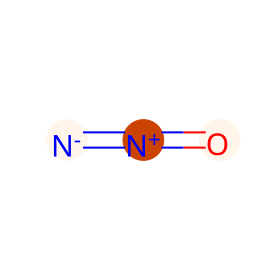

BBBP:1
prediction: [-0.12795965 -0.06176142]
O=c1[nH]c2cc(Cl)c(Cl)c([N+](=O)[O-])c2[nH]c1=O


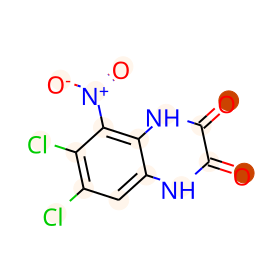

BBBP:1
prediction: [ 0.70833635 -1.2681398 ]
C[S+](CC[C@H](N)C(=O)[O-])C[C@H]1O[C@@H](n2cnc3c(N)ncnc32)[C@H](O)[C@@H]1O


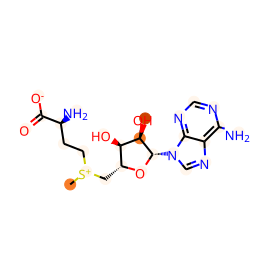

BBBP:1
prediction: [-0.3275048   0.17033133]
CC(Cc1ccccc1)n1cc([N-]C(=O)Nc2ccccc2)[o+]n1


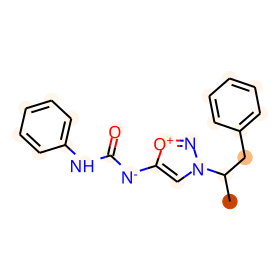

BBBP:1
prediction: [-1.9484116  1.7176156]
CCc1c(C)[n+]([NH-])c(-c2ccc(OC)c(OC)c2)c2cc(OC)c(OC)cc12


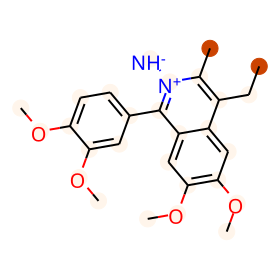

BBBP:1
prediction: [ 1.3520328 -1.7134898]
[N-]=[N+]=NCC(=O)N[C@H](CO)[C@H](O)c1ccc([N+](=O)[O-])cc1


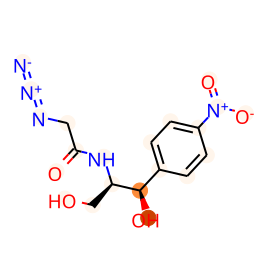

In [50]:
model_for_viz.eval()
test_MAE_list = []
test_MSE_list = []

out_feature_sorted = []
out_weight_sorted = []
mol_feature_sorted = []

dataset = train_df
test_MAE_list = []
test_MSE_list = []
valList = np.arange(0,dataset.shape[0])
batch_list = []
for i in range(0, dataset.shape[0], batch_size):
    batch = valList[i:i+batch_size]
    batch_list.append(batch) 
for counter, test_batch in enumerate(batch_list):
    batch_df = dataset.loc[test_batch,:]
    smiles_list = batch_df.cano_smiles.values
    y_val = batch_df[tasks[0]].values

    x_atom, x_bonds, x_atom_index, x_bond_index, x_mask, smiles_to_rdkit_list = get_smiles_array(smiles_list,feature_dicts)
    atom_feature_viz, atom_attention_weight_viz, mol_feature_viz, mol_feature_unbounded_viz, \
    mol_attention_weight_viz, mol_prediction = model_for_viz(
        torch.Tensor(x_atom), torch.Tensor(x_bonds),
        torch.cuda.LongTensor(x_atom_index),
        torch.cuda.LongTensor(x_bond_index),
        torch.Tensor(x_mask))

    mol_pred = np.array(mol_prediction.data.squeeze().cpu().numpy())
    atom_feature = np.stack([atom_feature_viz[L].cpu().detach().numpy() for L in range(radius+1)])
    atom_weight = np.stack([mol_attention_weight_viz[t].cpu().detach().numpy() for t in range(T)])
    mol_feature = np.stack([mol_feature_viz[t].cpu().detach().numpy() for t in range(T)])

    mol_feature_sorted.extend([mol_feature[:,i,:] for i in range(mol_feature.shape[1])])
    for i, smiles in enumerate(smiles_list):
        atom_num = i
        ind_mask = x_mask[i]
        ind_atom = smiles_to_rdkit_list[smiles]
        ind_feature = atom_feature[:, i]
        ind_weight = atom_weight[:, i]
        out_feature = []
        out_weight = []
        for j, one_or_zero in enumerate(list(ind_mask)):
            if one_or_zero == 1.0:
                out_feature.append(ind_feature[:,j])
                out_weight.append(ind_weight[:,j])
        out_feature_sorted.extend([out_feature[m] for m in np.argsort(ind_atom)])
        out_weight_sorted.extend([out_weight[m] for m in np.argsort(ind_atom)])        
        
        mol = Chem.MolFromSmiles(smiles)
        print('BBBP:'+str(y_val[i])+'\n'
             'prediction: '+str(mol_pred[atom_num]))
        print(smiles)
        
        weight_norm = min_max_norm([out_weight[m][0] for m in np.argsort(ind_atom)])

        norm = matplotlib.colors.Normalize(vmin=0,vmax=1.28)
        cmap = cm.get_cmap('Oranges')
        plt_colors = cm.ScalarMappable(norm=norm, cmap=cmap)
        atom_colors = {}
        weight_norm = np.array(weight_norm).flatten()
        threshold = weight_norm[np.argsort(weight_norm)[-2]]
        weight_norm = np.where(weight_norm < threshold, 0, weight_norm)

        for i in range(len(ind_atom)):
            atom_colors[i] = plt_colors.to_rgba(float(weight_norm[i]))
        rdDepictor.Compute2DCoords(mol)

        drawer = rdMolDraw2D.MolDraw2DSVG(280,280)
        drawer.SetFontSize(1)
        op = drawer.drawOptions()

        mol = rdMolDraw2D.PrepareMolForDrawing(mol)
        drawer.DrawMolecule(mol,highlightAtoms=range(0,len(ind_atom)),highlightBonds=[],
            highlightAtomColors=atom_colors)
        drawer.FinishDrawing()
        svg = drawer.GetDrawingText()
        svg2 = svg.replace('svg:','')
        svg3 = SVG(svg2)
        display(svg3)

In [ ]:
raw_filename = "../data/aromatic_adversarial.csv"
feature_filename = raw_filename.replace('.csv','.pickle')
filename = raw_filename.replace('.csv','')
prefix_filename = raw_filename.split('/')[-1].replace('.csv','')
smiles_tasks_df = pd.read_csv(raw_filename)
adversarial_list = smiles_tasks_df.smiles.values
canonical_adversarial_list = []
for smiles in adversarial_list:
    canonical_adversarial_list.append(Chem.MolToSmiles(Chem.MolFromSmiles(smiles), isomericSmiles=True))
if os.path.isfile(feature_filename):
    feature_dicts_adversarial = pickle.load(open(feature_filename, "rb" ))
else:
    feature_dicts_adversarial = save_smiles_dicts(canonical_adversarial_list,filename)


In [ ]:
x_atom, x_bonds, x_atom_index, x_bond_index, x_mask, smiles_to_rdkit_list = \
    get_smiles_array(canonical_adversarial_list,feature_dicts_adversarial)
atom_feature_viz, atom_attention_weight_viz, mol_feature_viz, mol_feature_unbounded_viz, \
mol_attention_weight_viz, mol_prediction = model_for_viz(
    torch.Tensor(x_atom), torch.Tensor(x_bonds),
    torch.cuda.LongTensor(x_atom_index),
    torch.cuda.LongTensor(x_bond_index),
    torch.Tensor(x_mask))

mol_pred = np.array(mol_prediction.data.squeeze().cpu().numpy())
atom_feature = np.stack([atom_feature_viz[L].cpu().detach().numpy() for L in range(radius+1)])
atom_weight = np.stack([mol_attention_weight_viz[t].cpu().detach().numpy() for t in range(T)])
mol_feature = np.stack([mol_feature_viz[t].cpu().detach().numpy() for t in range(T)])

mol_feature_sorted.extend([mol_feature[:,i,:] for i in range(mol_feature.shape[1])])
for i, smiles in enumerate(canonical_adversarial_list):
    atom_num = i
    ind_mask = x_mask[i]
    ind_atom = smiles_to_rdkit_list[smiles]
    ind_feature = atom_feature[:, i]
    ind_weight = atom_weight[:, i]
    out_feature = []
    out_weight = []
    for j, one_or_zero in enumerate(list(ind_mask)):
        if one_or_zero == 1.0:
            out_feature.append(ind_feature[:,j])
            out_weight.append(ind_weight[:,j])
    out_feature_sorted.extend([out_feature[m] for m in np.argsort(ind_atom)])
    out_weight_sorted.extend([out_weight[m] for m in np.argsort(ind_atom)])        

    mol = Chem.MolFromSmiles(smiles)

    aromatic_boolean = [int(mol.GetAtomWithIdx(i).GetIsAromatic()) for i in range(mol.GetNumAtoms())]
    
    weight_norm = min_max_norm([out_weight[m][0] for m in np.argsort(ind_atom)])

    print('aromatic atom count: '+str(np.sum(aromatic_boolean))+'\n'
         'prediction: '+str(mol_pred[atom_num]))
    print(smiles)
    norm = matplotlib.colors.Normalize(vmin=0,vmax=1.28)
    cmap = cm.get_cmap('Oranges')
    plt_colors = cm.ScalarMappable(norm=norm, cmap=cmap)
    atom_colors = {}
    weight_norm = np.array(weight_norm).flatten()
    threshold = weight_norm[np.argsort(weight_norm)[8]]
    weight_norm = np.where(weight_norm < threshold, 0, weight_norm)

    for i in range(len(ind_atom)):
        atom_colors[i] = plt_colors.to_rgba(float(weight_norm[i]))
    rdDepictor.Compute2DCoords(mol)

    drawer = rdMolDraw2D.MolDraw2DSVG(280,280)
    drawer.SetFontSize(1)
    op = drawer.drawOptions()

    mol = rdMolDraw2D.PrepareMolForDrawing(mol)
    drawer.DrawMolecule(mol,highlightAtoms=range(0,len(ind_atom)),highlightBonds=[],
        highlightAtomColors=atom_colors)
    drawer.FinishDrawing()
    svg = drawer.GetDrawingText()
    svg2 = svg.replace('svg:','')
    svg3 = SVG(svg2)
    display(svg3)